## Swin Transformer

Motivated from : https://medium.com/@olga.mindlina/vision-transformer-for-semantic-segmentation-on-medical-images-practical-uses-and-experiments-a2e3939d9870

Author: Seo Won Yi

In [1]:
!pip install torchvision
!pip install torchinfo
!pip install -q git+https://github.com/huggingface/transformers.git
!pip install torchmetrics
!pip install nibabel

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
  Using cached nvidia_nvjitlink_cu12-12.4.127-py3-none-m

In [2]:
from PIL import Image
from torchinfo import summary
import torch
from google.colab import drive
from transformers import AutoImageProcessor, Swinv2Model
import nibabel as nib
import matplotlib.pyplot as plt
import os
from torch.utils.data import Dataset, random_split, DataLoader
import matplotlib.cm as cm
import matplotlib.animation as animation
from matplotlib.animation import ArtistAnimation
import numpy as np
import torch.nn as nn
import torchvision.transforms as transforms
import torch.optim as optim
from torchmetrics.classification import Dice
import concurrent.futures
import random
from IPython.display import HTML
from IPython.display import Video
from sklearn.model_selection import train_test_split
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import time

In [3]:
drive.mount('/content/drive')
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

Mounted at /content/drive


In [4]:
image_processor = AutoImageProcessor.from_pretrained("microsoft/swinv2-large-patch4-window12-192-22k")
model = Swinv2Model.from_pretrained("microsoft/swinv2-large-patch4-window12-192-22k")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/240 [00:00<?, ?B/s]

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


config.json:   0%|          | 0.00/1.14M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/915M [00:00<?, ?B/s]

In [5]:
image_processor.do_rescale = False

In [6]:
summary(model=model, input_size=(1, 3, 256, 256), col_names=['input_size', 'output_size', 'num_params', 'trainable'])

Layer (type:depth-idx)                                            Input Shape               Output Shape              Param #                   Trainable
Swinv2Model                                                       [1, 3, 256, 256]          [1, 1536]                 --                        True
├─Swinv2Embeddings: 1-1                                           [1, 3, 256, 256]          [1, 4096, 192]            --                        True
│    └─Swinv2PatchEmbeddings: 2-1                                 [1, 3, 256, 256]          [1, 4096, 192]            --                        True
│    │    └─Conv2d: 3-1                                           [1, 3, 256, 256]          [1, 192, 64, 64]          9,408                     True
│    └─LayerNorm: 2-2                                             [1, 4096, 192]            [1, 4096, 192]            384                       True
│    └─Dropout: 2-3                                               [1, 4096, 192]            [1, 4096,

In [7]:
model.eval()

Swinv2Model(
  (embeddings): Swinv2Embeddings(
    (patch_embeddings): Swinv2PatchEmbeddings(
      (projection): Conv2d(3, 192, kernel_size=(4, 4), stride=(4, 4))
    )
    (norm): LayerNorm((192,), eps=1e-05, elementwise_affine=True)
    (dropout): Dropout(p=0.0, inplace=False)
  )
  (encoder): Swinv2Encoder(
    (layers): ModuleList(
      (0): Swinv2Stage(
        (blocks): ModuleList(
          (0-1): 2 x Swinv2Layer(
            (attention): Swinv2Attention(
              (self): Swinv2SelfAttention(
                (continuous_position_bias_mlp): Sequential(
                  (0): Linear(in_features=2, out_features=512, bias=True)
                  (1): ReLU(inplace=True)
                  (2): Linear(in_features=512, out_features=6, bias=False)
                )
                (query): Linear(in_features=192, out_features=192, bias=True)
                (key): Linear(in_features=192, out_features=192, bias=False)
                (value): Linear(in_features=192, out_features=19

In [8]:
image_path = "/content/drive/MyDrive/CSC413data/Task02_Heart/Task02_Heart/imagesTr/la_003.nii.gz"

image = nib.load(image_path).get_fdata()

In [9]:
image.shape

(320, 320, 130)

### Decoder Descriptions

In [11]:
# Original Code From https://medium.com/@olga.mindlina/vision-transformer-for-semantic-segmentation-on-medical-images-practical-uses-and-experiments-a2e3939d9870

"""
class Up_Linear(nn.Module):
    def __init__(self, in_ch, size, coef=0.5):
        super(Up_Linear, self).__init__()
        self.shuffle = nn.PixelShuffle(upscale_factor=2)

        n_ch = int(coef * in_ch)


        self.ln = nn.Sequential(
            nn.Linear(in_ch * 2, n_ch),
            nn.LeakyReLU(inplace=True),
            nn.Linear(n_ch, in_ch * 2),
            nn.LeakyReLU(inplace=True),
        )

        self.size = size

    def forward(self, x1, x2):
        x = torch.cat((x1, x2), 2)
        x = self.ln(x)
        x = x.permute(0, 2, 1)
        x = torch.reshape(x, (x.shape[0], x.shape[1], self.size, self.size))
        x = self.shuffle(x)
        x = torch.reshape(x, (x.shape[0], x.shape[1], self.size*self.size*4))
        x = x.permute(0, 2, 1)
        return x

class MRI_Seg(nn.Module):
    def __init__(self):
        super(MRI_Seg, self).__init__()

        self.ups3 = Up_Linear(1536, 6, 1)
        self.ups2 = Up_Linear(768, 12, 1)
        self.ups1 = Up_Linear(384, 24, 2)
        self.ups0 = Up_Linear(192, 48, 3)

        self.shuffle = nn.PixelShuffle(upscale_factor=2)

        self.out = nn.Sequential(
            nn.Conv2d(24, 1, kernel_size=1, stride=1),
            #nn.Sigmoid()
        )

    def forward(self, x0, x1, x2, x3, x4):
        x = self.ups3(x4, x3)
        x = self.ups2(x, x2)
        x = self.ups1(x, x1)
        x = self.ups0(x, x0)

        x = x.permute(0, 2, 1)
        x = torch.reshape(x, (x.shape[0], x.shape[1], 96, 96))
        x = self.shuffle(x)
        x = transforms.Resize((320, 320))(x)

        x = self.out(x)
        return x


net = MRI_Seg().to(device)
"""

'\nclass Up_Linear(nn.Module):\n    def __init__(self, in_ch, size, coef=0.5):\n        super(Up_Linear, self).__init__()\n        self.shuffle = nn.PixelShuffle(upscale_factor=2)\n\n        n_ch = int(coef * in_ch)\n\n\n        self.ln = nn.Sequential(\n            nn.Linear(in_ch * 2, n_ch),\n            nn.LeakyReLU(inplace=True),\n            nn.Linear(n_ch, in_ch * 2),\n            nn.LeakyReLU(inplace=True),\n        )\n\n        self.size = size\n\n    def forward(self, x1, x2):\n        x = torch.cat((x1, x2), 2)\n        x = self.ln(x)\n        x = x.permute(0, 2, 1)\n        x = torch.reshape(x, (x.shape[0], x.shape[1], self.size, self.size))\n        x = self.shuffle(x)\n        x = torch.reshape(x, (x.shape[0], x.shape[1], self.size*self.size*4))\n        x = x.permute(0, 2, 1)\n        return x\n\nclass MRI_Seg(nn.Module):\n    def __init__(self):\n        super(MRI_Seg, self).__init__()\n\n        self.ups3 = Up_Linear(1536, 6, 1)\n        self.ups2 = Up_Linear(768, 12, 1

In [12]:
"""
class SelfAttention(nn.Module):
    def __init__(self, in_channels):
        super(SelfAttention, self).__init__()
        self.query_conv = nn.Conv2d(in_channels, in_channels // 8, 1)
        self.key_conv = nn.Conv2d(in_channels, in_channels // 8, 1)
        self.value_conv = nn.Conv2d(in_channels, in_channels, 1)
        self.scale = (in_channels // 8) ** -0.5

    def forward(self, x):
        batch_size, channels, height, width = x.shape
        query = self.query_conv(x).view(batch_size, -1, height * width).permute(0, 2, 1)
        key = self.key_conv(x).view(batch_size, -1, height * width)
        value = self.value_conv(x).view(batch_size, -1, height * width)
        attention = torch.bmm(query, key) * self.scale
        attention = F.softmax(attention, dim=-1)
        out = torch.bmm(value, attention).view(batch_size, channels, height, width)
        return out
"""

class ChannelAttention(nn.Module):
    def __init__(self, in_channels, ratio=4):
        super(ChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.fc = nn.Sequential(
            nn.Conv2d(in_channels, in_channels // ratio, 1, bias=False),
            nn.BatchNorm2d(in_channels // ratio),
            nn.ReLU(),
            nn.Conv2d(in_channels // ratio, in_channels, 1, bias=False),
            nn.BatchNorm2d(in_channels)
        )
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.fc(self.avg_pool(x))
        max_out = self.fc(self.max_pool(x))
        out = self.sigmoid(avg_out + max_out)
        return out * x



class Up_Conv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(Up_Conv, self).__init__()
        #self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        #self.up = nn.ConvTranspose2d(in_ch//4, in_ch//4, 2, stride=2)
        self.up = nn.PixelShuffle(upscale_factor=2)
        self.attention = ChannelAttention(in_ch)

        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, in_ch, kernel_size=3, padding=1),
            nn.BatchNorm2d(in_ch),
            nn.ReLU(inplace=True)
        )
        self.shortcut = nn.Sequential()
        if in_ch != out_ch:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_ch, in_ch, kernel_size=1, stride=1, padding=0),
                nn.BatchNorm2d(in_ch)
            )

    def forward(self, x1, x2):
        x = torch.cat([x2, x1], dim=1)  # Concatenate along channel dimension
        x = self.attention(x)
        out = self.conv(x)
        out = out + self.shortcut(x)
        out = self.up(out)
        out = torch.reshape(out, (out.shape[0], out.shape[1], out.shape[2] * out.shape[3]))
        out = out.permute(0, 2, 1)
        return out

class MRI_Seg(nn.Module):
    def __init__(self):
        super(MRI_Seg, self).__init__()

        self.ups3 = Up_Conv(3072, 1536)  # x4 and x3 concatenated: 1536 each
        self.ups2 = Up_Conv(1536, 768)  # x and x2 concatenated: 768 each
        self.ups1 = Up_Conv(768, 384)   # x and x1 concatenated: 384 each
        self.ups0 = Up_Conv(384, 192)    # x and x0 concatenated: 192 each
        self.final_conv = nn.Sequential(
            nn.BatchNorm2d(24),
            nn.ReLU(inplace=True),
            nn.Conv2d(24, 1, kernel_size=1, stride=1),
            nn.Sigmoid()
        )
        self.shuffle = nn.PixelShuffle(upscale_factor=2)

    def forward(self, x0, x1, x2, x3, x4):
        x0 = x0.permute(0, 2, 1)
        x0 = x0.reshape(x0.shape[0], x0.shape[1], 48, 48)
        x1 = x1.permute(0, 2, 1)
        x1 = x1.reshape(x1.shape[0], x1.shape[1], 24, 24)
        x2 = x2.permute(0, 2, 1)
        x2 = x2.reshape(x2.shape[0], x2.shape[1], 12, 12)
        x3 = x3.permute(0, 2, 1)
        x3 = x3.reshape(x3.shape[0], x3.shape[1], 6, 6)
        x4 = x4.permute(0, 2, 1)
        x4 = x4.reshape(x4.shape[0], x4.shape[1], 6, 6)

        x = self.ups3(x4, x3)
        x = torch.reshape(x, (x2.shape[0], x2.shape[1], 12, 12))
        x = self.ups2(x, x2)
        x = torch.reshape(x, (x1.shape[0], x1.shape[1], 24, 24))
        x = self.ups1(x, x1)
        x = torch.reshape(x, (x0.shape[0], x0.shape[1], 48, 48))
        x = self.ups0(x, x0)
        x = x.permute(0, 2, 1)
        x = torch.reshape(x, (x.shape[0], x.shape[1], 96, 96))
        x = self.shuffle(x)
        x = F.interpolate(x, size=(320, 320), mode='bilinear', align_corners=True)
        return self.final_conv(x)

net = MRI_Seg().to(device)


In [13]:
summary(model=net, input_size=[(1, 2304, 192), (1, 576, 384), (1, 144, 768), (1, 36, 1536), (1, 36, 1536)], col_names=['input_size', 'output_size', 'num_params', 'trainable'])

Layer (type:depth-idx)                   Input Shape               Output Shape              Param #                   Trainable
MRI_Seg                                  [1, 2304, 192]            [1, 1, 320, 320]          --                        True
├─Up_Conv: 1-1                           [1, 1536, 6, 6]           [1, 144, 768]             --                        True
│    └─ChannelAttention: 2-1             [1, 3072, 6, 6]           [1, 3072, 6, 6]           --                        True
│    │    └─AdaptiveAvgPool2d: 3-1       [1, 3072, 6, 6]           [1, 3072, 1, 1]           --                        --
│    │    └─Sequential: 3-2              [1, 3072, 1, 1]           [1, 3072, 1, 1]           4,726,272                 True
│    │    └─AdaptiveMaxPool2d: 3-3       [1, 3072, 6, 6]           [1, 3072, 1, 1]           --                        --
│    │    └─Sequential: 3-4              [1, 3072, 1, 1]           [1, 3072, 1, 1]           (recursive)               True
│    │ 

Rescale the information in data.

In [ ]:
def linear_scale(data):
    min_value = data.min()
    max_value = data.max()
    scaled_data = (data - min_value) / (max_value - min_value)
    return scaled_data

In order to utilize the pre-trained encoder, transform the 1-channel image into 3-channel image.

In [14]:
def make_3_channel(img):
  single_image = []
  single_image.append(img)
  single_image.append(img)
  single_image.append(img)
  return np.array(single_image).reshape(-1, 3, 320, 320)

Utilize encoder and obtain important feature information.

In [15]:
def preprocess(img, device):
  img = image_processor(linear_scale(img), return_tensors="pt")
  img = img.to(device)
  #model.to(device)
  x = model.embeddings(**img)
  input_dimensions=x[1]
  im0 = x[0].detach()

  x = model.encoder.layers[0](x[0], input_dimensions=input_dimensions)
  im1 = x[0].detach()

  x = model.encoder.layers[1](x[0], input_dimensions=(input_dimensions[0]//2, input_dimensions[1]//2))
  im2 = x[0].detach()

  x = model.encoder.layers[2](x[0], input_dimensions=(input_dimensions[0]//4, input_dimensions[1]//4))
  im3 = x[0].detach()

  x = model.encoder.layers[3](x[0], input_dimensions=(input_dimensions[0]//8, input_dimensions[1]//8))
  x = model.layernorm(x[0])
  im4 = x.detach()

  return im0, im1, im2, im3, im4

### Loss Functions

In [16]:
class DiceLoss(nn.Module):
    def __init__(self):
        super(DiceLoss, self).__init__()

    def forward(self, predicted, target):
        # print(f"predicted shape {predicted.shape}")
        # print(f"target shape {target.shape}")
        # predicted = torch.sigmoid(predicted)
        predicted = predicted.view(predicted.size(0), -1)
        target = target.view(target.size(0), -1)

        intersection = (predicted * target).sum(dim=1)
        union = predicted.sum(dim=1) + target.sum(dim=1)
        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)

        return 1 - dice_score.mean()

In [17]:
"""
class FocalLoss(nn.Module):
    def __init__(self, alpha=0.75,
                 gamma=2., channel=0, reduction="mean"):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.channel = channel
        self.reduction = reduction

    def forward(self, inputs, targets):
        logits = inputs[:, self.channel, :, :]  # Select the specific channel logits
        targets = targets.float()  # Ensure targets are floats to match logits calculations
        targets = targets[:, self.channel, :, :]

        ce_loss = F.binary_cross_entropy_with_logits(logits, targets, reduction="none")

        p_t = torch.sigmoid(logits)  # Convert logits to probabilities for positive class
        p_t = p_t * targets + (1 - p_t) * (1 - targets)  # Compute the probability of the true class

        loss = ce_loss * ((1 - p_t) ** self.gamma)  # Modulate loss with the focusing parameter

        if self.alpha >= 0:
            alpha_t = self.alpha * targets + (1 - self.alpha) * (1 - targets)
            loss = alpha_t * loss

        if self.reduction == 'mean':
            return loss.mean()
        elif self.reduction == 'sum':
            return loss.sum()
        else:
            return loss
"""

'\nclass FocalLoss(nn.Module):\n    def __init__(self, alpha=0.75,\n                 gamma=2., channel=0, reduction="mean"):\n        super(FocalLoss, self).__init__()\n        self.alpha = alpha\n        self.gamma = gamma\n        self.channel = channel\n        self.reduction = reduction\n\n    def forward(self, inputs, targets):\n        logits = inputs[:, self.channel, :, :]  # Select the specific channel logits\n        targets = targets.float()  # Ensure targets are floats to match logits calculations\n        targets = targets[:, self.channel, :, :]\n\n        ce_loss = F.binary_cross_entropy_with_logits(logits, targets, reduction="none")\n\n        p_t = torch.sigmoid(logits)  # Convert logits to probabilities for positive class\n        p_t = p_t * targets + (1 - p_t) * (1 - targets)  # Compute the probability of the true class\n\n        loss = ce_loss * ((1 - p_t) ** self.gamma)  # Modulate loss with the focusing parameter\n\n        if self.alpha >= 0:\n            alpha_t

In [18]:
"""
class DiceFocalLoss(nn.Module):
    def __init__(self, alpha=0.75, gamma=2.0, dice_weight=0.8, focal_weight=0.2):
        super(DiceFocalLoss, self).__init__()
        self.dice_loss = DiceLoss()
        self.focal_loss = FocalLoss(alpha, gamma)
        self.dice_weight = dice_weight
        self.focal_weight = focal_weight

    def forward(self, inputs, targets):
        dice_loss = self.dice_loss(inputs, targets)
        focal_loss = self.focal_loss(inputs, targets)
        combined_loss = self.dice_weight * dice_loss + self.focal_weight * focal_loss
        return combined_loss
"""

'\nclass DiceFocalLoss(nn.Module):\n    def __init__(self, alpha=0.75, gamma=2.0, dice_weight=0.8, focal_weight=0.2):\n        super(DiceFocalLoss, self).__init__()\n        self.dice_loss = DiceLoss()\n        self.focal_loss = FocalLoss(alpha, gamma)\n        self.dice_weight = dice_weight\n        self.focal_weight = focal_weight\n\n    def forward(self, inputs, targets):\n        dice_loss = self.dice_loss(inputs, targets)\n        focal_loss = self.focal_loss(inputs, targets)\n        combined_loss = self.dice_weight * dice_loss + self.focal_weight * focal_loss\n        return combined_loss\n'

In [19]:
"""
class BinaryDiceBCELoss(nn.Module):
    def __init__(self, weight=None, alpha=0.4):
        super(BinaryDiceBCELoss, self).__init__()
        self.alpha = alpha
        self.bce_loss = nn.BCEWithLogitsLoss(weight=weight)

    def dice_loss(self, y_pred, y_true, smooth=1e-6):
        # y_pred: logits (N, 1, H, W) — before sigmoid
        # y_true: ground truth labels (N, H, W) with 0s and 1s
        y_pred = torch.sigmoid(y_pred[:, self.channel, :, :])
        y_pred = y_pred.view(y_pred.size(0), -1)
        y_true = y_true.view(y_true.size(0), -1)

        intersection = (y_pred * y_true).sum(dim=1)
        union = y_pred.sum(dim=1) + y_true.sum(dim=1)
        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)

        return 1 - dice_score.mean()

    def forward(self, y_pred, y_true):
        bce = self.bce_loss(y_pred, y_true)
        dice = self.dice_loss(y_pred, y_true)
        combined_loss = self.alpha * bce + (1 - self.alpha) * dice
        return combined_loss
"""

'\nclass BinaryDiceBCELoss(nn.Module):\n    def __init__(self, weight=None, alpha=0.4):\n        super(BinaryDiceBCELoss, self).__init__()\n        self.alpha = alpha\n        self.bce_loss = nn.BCEWithLogitsLoss(weight=weight)\n\n    def dice_loss(self, y_pred, y_true, smooth=1e-6):\n        # y_pred: logits (N, 1, H, W) — before sigmoid\n        # y_true: ground truth labels (N, H, W) with 0s and 1s\n        y_pred = torch.sigmoid(y_pred[:, self.channel, :, :])\n        y_pred = y_pred.view(y_pred.size(0), -1)\n        y_true = y_true.view(y_true.size(0), -1)\n\n        intersection = (y_pred * y_true).sum(dim=1)\n        union = y_pred.sum(dim=1) + y_true.sum(dim=1)\n        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)\n\n        return 1 - dice_score.mean()\n\n    def forward(self, y_pred, y_true):\n        bce = self.bce_loss(y_pred, y_true)\n        dice = self.dice_loss(y_pred, y_true)\n        combined_loss = self.alpha * bce + (1 - self.alpha) * dice\n        retur

In [20]:
"""
class BoundaryFocalDiceLoss(nn.Module):
    def __init__(self, alpha=0.25, gamma=1, beta=2, lambda_boundary=0.5):
        super(BoundaryFocalDiceLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.beta = beta
        self.lambda_boundary = lambda_boundary

    def dice_loss(self, y_pred, y_true, smooth=1e-6):
        y_pred = torch.sigmoid(y_pred)
        y_pred = y_pred.view(y_pred.size(0), -1)
        y_true = y_true.view(y_true.size(0), -1)

        intersection = (y_pred * y_true).sum(dim=1)
        union = y_pred.sum(dim=1) + y_true.sum(dim=1)
        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)

        return 1 - dice_score.mean()

    def boundary_loss(self, y_pred, y_true):
        y_pred = torch.sigmoid(y_pred)
        y_true = y_true.float()

        # Generate distance maps
        dist_map = torch.cdist(y_true.unsqueeze(0), (1 - y_true).unsqueeze(0), p=2)
        dist_map = dist_map / dist_map.max()  # Normalize for stability

        return torch.mean(dist_map * y_pred)

    def forward(self, inputs, targets):
        BCE_loss = F.binary_cross_entropy_with_logits(inputs, targets, reduction='none')
        pt = torch.exp(-BCE_loss)
        focal_loss = self.alpha * (1 - pt) ** self.gamma * BCE_loss

        dice_loss = self.dice_loss(inputs, targets)

        boundary_loss = self.boundary_loss(inputs, targets)

        combined_loss = (focal_loss.mean() + self.beta * dice_loss + self.lambda_boundary * boundary_loss)
        return combined_loss
"""

"\nclass BoundaryFocalDiceLoss(nn.Module):\n    def __init__(self, alpha=0.25, gamma=1, beta=2, lambda_boundary=0.5):\n        super(BoundaryFocalDiceLoss, self).__init__()\n        self.alpha = alpha\n        self.gamma = gamma\n        self.beta = beta\n        self.lambda_boundary = lambda_boundary\n\n    def dice_loss(self, y_pred, y_true, smooth=1e-6):\n        y_pred = torch.sigmoid(y_pred)\n        y_pred = y_pred.view(y_pred.size(0), -1)\n        y_true = y_true.view(y_true.size(0), -1)\n\n        intersection = (y_pred * y_true).sum(dim=1)\n        union = y_pred.sum(dim=1) + y_true.sum(dim=1)\n        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)\n\n        return 1 - dice_score.mean()\n\n    def boundary_loss(self, y_pred, y_true):\n        y_pred = torch.sigmoid(y_pred)\n        y_true = y_true.float()\n\n        # Generate distance maps\n        dist_map = torch.cdist(y_true.unsqueeze(0), (1 - y_true).unsqueeze(0), p=2)\n        dist_map = dist_map / dist_map.ma

In [21]:
"""
class FocalDiceBCELoss(nn.Module):
    def __init__(self):
        super(FocalDiceBCELoss, self).__init__()

    def dice_loss(self, y_pred, y_true):
        y_pred = torch.sigmoid(y_pred[:, 0, :, :])
        y_pred = y_pred.view(y_pred.size(0), -1)
        y_true = y_true.view(y_true.size(0), -1)

        intersection = (y_pred * y_true).sum(dim=1)
        union = y_pred.sum(dim=1) + y_true.sum(dim=1)
        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)

        return 1 - dice_score.mean()

    def focal_dice_loss(self, y_pred, y_true, gamma=3.0):
        focal_dice_loss = torch.pow(self.dice_loss(y_pred, y_true), gamma)
        return focal_dice_loss

    def forward(self, y_pred, y_true, alpha=0.25, gamma=3.0):
      bce_loss = F.binary_cross_entropy_with_logits(y_pred, y_true)
      dice = self.focal_dice_loss(y_pred, y_true, gamma)
      return alpha * bce_loss + (1 - alpha) * dice
"""

'\nclass FocalDiceBCELoss(nn.Module):\n    def __init__(self):\n        super(FocalDiceBCELoss, self).__init__()\n\n    def dice_loss(self, y_pred, y_true):\n        y_pred = torch.sigmoid(y_pred[:, 0, :, :])\n        y_pred = y_pred.view(y_pred.size(0), -1)\n        y_true = y_true.view(y_true.size(0), -1)\n\n        intersection = (y_pred * y_true).sum(dim=1)\n        union = y_pred.sum(dim=1) + y_true.sum(dim=1)\n        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)\n\n        return 1 - dice_score.mean()\n\n    def focal_dice_loss(self, y_pred, y_true, gamma=3.0):\n        focal_dice_loss = torch.pow(self.dice_loss(y_pred, y_true), gamma)\n        return focal_dice_loss\n\n    def forward(self, y_pred, y_true, alpha=0.25, gamma=3.0):\n      bce_loss = F.binary_cross_entropy_with_logits(y_pred, y_true)\n      dice = self.focal_dice_loss(y_pred, y_true, gamma)\n      return alpha * bce_loss + (1 - alpha) * dice\n'

In [22]:
"""
class FocalDiceLoss(nn.Module):
  def __init__(self):
    super(FocalDiceLoss, self).__init__()

  def forward(self, y_pred, y_true, alpha=0.25, gamma=2.5):
        y_pred = torch.sigmoid(y_pred[:, 0, :, :])
        y_pred = y_pred.view(y_pred.size(0), -1)
        y_true = y_true.view(y_true.size(0), -1)
        intersection = (y_pred * y_true).sum(dim=1)
        union = y_pred.sum(dim=1) + y_true.sum(dim=1)
        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)

        return -alpha * (1 - dice_score.mean())**gamma * torch.log(dice_score.mean() + 1e-6)
"""

'\nclass FocalDiceLoss(nn.Module):\n  def __init__(self):\n    super(FocalDiceLoss, self).__init__()\n\n  def forward(self, y_pred, y_true, alpha=0.25, gamma=2.5):\n        y_pred = torch.sigmoid(y_pred[:, 0, :, :])\n        y_pred = y_pred.view(y_pred.size(0), -1)\n        y_true = y_true.view(y_true.size(0), -1)\n        intersection = (y_pred * y_true).sum(dim=1)\n        union = y_pred.sum(dim=1) + y_true.sum(dim=1)\n        dice_score = (2. * intersection + 1e-6) / (union + 1e-6)\n\n        return -alpha * (1 - dice_score.mean())**gamma * torch.log(dice_score.mean() + 1e-6)\n'

In [23]:
def get_dice_score(model, data, device="cpu"):
    loader = torch.utils.data.DataLoader(data, batch_size=20)
    #model.to(device)
    model.eval()
    total_score = 0
    count = 0
    with torch.no_grad():
      for imgs, labels in loader:
          labels = labels.to(device).unsqueeze(1)
          imgs = torch.tensor(make_3_channel(imgs)).to(device)
          x0, x1, x2, x3, x4 = preprocess(imgs, device)
          pred = model(x0, x1, x2, x3, x4)
          pred = (pred > 0.5).float()
          pred = pred.view(pred.size(0), -1)
          labels = labels.view(labels.size(0), -1)

          intersection = (pred * labels).sum(dim=1)
          union = pred.sum(dim=1) + labels.sum(dim=1)
          dice_score = (2. * intersection + 1e-6) / (union + 1e-6)
          total_score += dice_score.mean()
          count += 1

    return total_score/count

In [24]:
def train_model(model, train_data, val_data, learning_rate=0.001, batch_size=12, num_epochs=10, plot=False):
    model.to(device)
    train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size)
    #criterion = FocalDiceBCELoss()
    #criterion = FocalDiceLoss()
    criterion = DiceLoss()
    optimizer = optim.AdamW(model.parameters(), lr=learning_rate)
    #scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=20, threshold=0.0001)
    iters, train_losses = [], []
    iter_count = 0
    #torch.autograd.set_detect_anomaly(True)
    for e in range(num_epochs):
        total_loss, total_samples = 0, 0
        model.train()
        for train_img, labels in train_loader:
            train_img = torch.tensor(make_3_channel(train_img)).to(device)
            labels = labels.to(device).unsqueeze(1)
            x0, x1, x2, x3, x4 = preprocess(train_img, device)

            optimizer.zero_grad()
            outputs = model(x0, x1, x2, x3, x4)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            total_samples += 1

        avg_loss = total_loss / total_samples
        va = get_dice_score(model, val_data, device)
        #model = model.to(device)
        print(f'Epoch [{e+1}/{num_epochs}]: Loss: {avg_loss} Validation Dice Coefficient: {va}')
        #scheduler.step(loss)
        #print(f"Current Learning Rate: {scheduler.get_last_lr()}")

In [25]:
class MedicalImageDataset(Dataset):
    def __init__(self, image_paths, label_paths, transform=None, data_augment=True):
        self.image_paths = image_paths
        self.label_paths = label_paths
        self.transform = transform
        self.cache = {}  # Cache for loaded videos
        self.number_of_paths = len(self.image_paths)
        self.data_augment = data_augment
        self.index_map = []
        total_frames = 0
        for image_path in image_paths:
            image = nib.load(image_path).get_fdata()
            total_frames += image.shape[2]
            self.index_map.append(total_frames)

        self.length = total_frames

    def __len__(self):
        return self.length

    def get_video(self, idx):
        if idx in self.cache:
            return self.cache[idx]

        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]
        image = nib.load(image_path).get_fdata()
        label = nib.load(label_path).get_fdata()

        self.cache[idx] = (image, label)
        return image, label

    def __getitem__(self, idx):
        if idx >= self.length:
            raise IndexError("Index out of range")

        video_index = next(i for i, total in enumerate(self.index_map) if total > idx)
        frame_index = idx - (self.index_map[video_index - 1] if video_index > 0 else 0)

        image, label = self.get_video(video_index)

        frame_image = image[:, :, frame_index]
        frame_label = label[:, :, frame_index]

        if self.data_augment:
            # Data augmentation
            if np.random.rand() > 0.5:
                # print(f'idx [{idx}], random flipped') # For Proof of Data Augmentation
                ax = np.random.choice([0,1])
                frame_image = np.flip(frame_image, axis=ax)
                frame_label = np.flip(frame_label, axis=ax)

            if np.random.rand() > 0.5:
                # print(f'idx [{idx}], random rotation') # For Proof of Data Augmentation
                rot = np.random.choice([1,2,3]) # 90, 180, or 270 degrees

                frame_image = np.rot90(frame_image, rot, axes=[0,1])
                frame_label = np.rot90(frame_label, rot, axes=[0,1])


        # Convert numpy arrays to torch tensors
        frame_image = torch.from_numpy(frame_image.copy()).float()
        frame_label = torch.from_numpy(frame_label.copy()).float()

        return frame_image, frame_label

    def log(self):
        image, label = self.get_video(0) # first data in this dataset

        # Convert tensors back to numpy arrays for visualization
        image_at_0 = image
        label_at_0 = label

        dataset_len = self.number_of_paths

        image_min = np.min(image_at_0)
        image_max = np.max(image_at_0)
        label_min = np.min(label_at_0)
        label_max = np.max(label_at_0)

        # Scan over the dataset
        for i in range(dataset_len):
            image, label = self.get_video(i)
            image_np = image
            label_np = label

            if image_np.shape != image_at_0.shape:
                print(f'image shape mismatch: {i}th: {image_np.shape} vs 0th: {image_at_0.shape}')
            if label_np.shape != label_at_0.shape:
                print(f'label shape mismatch: {i}th: {label_np.shape} vs 0th: {label_at_0.shape}')
            if image_np.shape != label_np.shape:
                print(f'{i}th pair shape mismatch: image: {image_np.shape} vs label: {label_np.shape}')

            if image_min > np.min(image_np):
                image_min = np.min(image_np)

            if image_max < np.max(image_np):
                image_max = np.max(image_np)

            if label_min > np.min(label_np):
                label_min = np.min(label_np)

            if label_max < np.max(label_np):
                label_max = np.max(label_np)


        # Log
        print(f'[Total] {dataset_len} pairs')
        print(f'[Image] min: {image_min}, max: {image_max}')
        print(f'[Label] min: {label_min}, max: {label_max}')

    def show_frame_3D(self, idx, dim2=0, is_label=False):
        image, label = self.get_video(idx)

        # Convert tensors back to numpy arrays for visualization
        image_np = image
        label_np = label

        # Visualize
        if not is_label:
            plt.figure(figsize=(6, 6))
            plt.imshow(image_np[:, :, dim2], cmap='gray')
            plt.title('Image')
            plt.show()
        else:
            plt.figure(figsize=(6, 6))
            plt.imshow(label_np[:, :, dim2], cmap='gray')
            plt.title('Label')
            plt.show()

    def show_frame_4D(self, idx, dim2=0, dim3=0, is_label=False):
        image, label = self.get_video(idx)

        # Convert tensors back to numpy arrays for visualization
        image_np = image
        label_np = label

        # Visualize
        if not is_label:
            plt.figure(figsize=(6, 6))
            plt.imshow(image_np[:, :, dim2, dim3], cmap='gray')
            plt.title('Image')
            plt.show()
        else:
            plt.figure(figsize=(6, 6))
            plt.imshow(label_np[:, :, dim2, dim3], cmap='gray')
            plt.title('Label')
            plt.show()

    def show_video_3D(self, idx, is_label=False):
        image, label = self.get_video(idx)

        # Convert tensors back to numpy arrays for visualization
        video_frames = label if is_label else image

        print(f"video_frames shape: {video_frames.shape}")

        frames = [] # for storing the generated images
        fig, ax = plt.subplots(figsize=(6, 6))  # Use subplots to get the axes

        for i in range(video_frames.shape[2]):
            frame = [plt.imshow(video_frames[:, :, i], cmap='gray', animated=True)]
            frames.append(frame)

        ani = ArtistAnimation(fig, frames, interval=50, blit=True, repeat_delay=1000)
        plt.close(fig)  # Prevents the static plot from showing

        return HTML(ani.to_jshtml())

    def show_video_4D(self, idx, last_dim=0, is_label=False):
        image, label = self.get_video(idx)

        # Convert tensors back to numpy arrays for visualization
        video_frames = label if is_label else image

        print(f"video shape: {video_frames.shape}")

        frames = [] # for storing the generated images
        fig, ax = plt.subplots(figsize=(6, 6))  # Use subplots to get the axes

        for i in range(video_frames.shape[2]):
            frame = [plt.imshow(video_frames[:, :, i, last_dim], cmap='gray', animated=True)]
            frames.append(frame)

        ani = ArtistAnimation(fig, frames, interval=50, blit=True, repeat_delay=1000)
        plt.close(fig)  # Prevents the static plot from showing

        return HTML(ani.to_jshtml())

In [26]:
def split_dataset(image_files, label_files, test_pct=0.2, val_pct=0.1, random_seed=42):
    """
    Splits the dataset into training, validation, and testing subsets.
    image_files: list of image file paths
    label_files: list of label file paths
    """
    # Split into training + val/test
    train_img, test_img, train_lbl, test_lbl = train_test_split(
        image_files, label_files, test_size=test_pct + val_pct, random_state=random_seed)

    # Split off validation set from the combined val/test set
    val_pct_adjusted = val_pct / (test_pct + val_pct)  # Adjust val_pct based on the reduced set size
    test_img, val_img, test_lbl, val_lbl = train_test_split(
        test_img, test_lbl, test_size=val_pct_adjusted, random_state=random_seed)

    return {
        'train': MedicalImageDataset(train_img, train_lbl),
        'val': MedicalImageDataset(val_img, val_lbl),
        'test': MedicalImageDataset(test_img, test_lbl)
    }

In [27]:
task_dir_name = 'Task02_Heart/Task02_Heart'
starts_with = 'la'
images_dir = '/content/drive/MyDrive/CSC413data/' + task_dir_name + '/imagesTr'
labels_dir = '/content/drive/MyDrive/CSC413data/' + task_dir_name + '/labelsTr'

image_files = sorted([os.path.join(images_dir, f) for f in os.listdir(images_dir) if f.endswith('.nii.gz') and f.startswith(starts_with)]) # List for file paths
label_files = sorted([os.path.join(labels_dir, f) for f in os.listdir(labels_dir) if f.endswith('.nii.gz') and f.startswith(starts_with)]) # List for file paths


datasets = split_dataset(image_files, label_files, test_pct=0.2, val_pct=0.1, random_seed=42)

# Accessing the split datasets
train_dataset = datasets['train']
val_dataset = datasets['val']
test_dataset = datasets['test']

In [28]:
print(time.time())
train_model(net, train_dataset, val_dataset, batch_size=32, num_epochs=150, learning_rate=0.001)
print(time.time())

1713541288.1919074
Epoch [1/150]: Loss: 0.9825840871384803 Validation Dice Coefficient: 0.04974232614040375
Epoch [2/150]: Loss: 0.9737388795994698 Validation Dice Coefficient: 0.08473952114582062
Epoch [3/150]: Loss: 0.9644350054416251 Validation Dice Coefficient: 0.07199770957231522
Epoch [4/150]: Loss: 0.9511158960930844 Validation Dice Coefficient: 0.05524687469005585
Epoch [5/150]: Loss: 0.9361984996085472 Validation Dice Coefficient: 0.040112607181072235
Epoch [6/150]: Loss: 0.9225150587710929 Validation Dice Coefficient: 0.08599264174699783
Epoch [7/150]: Loss: 0.9085258270831819 Validation Dice Coefficient: 0.007591679692268372
Epoch [8/150]: Loss: 0.897381492117618 Validation Dice Coefficient: 0.08471307158470154
Epoch [9/150]: Loss: 0.8835987423328643 Validation Dice Coefficient: 0.12317338585853577
Epoch [10/150]: Loss: 0.8735414160058853 Validation Dice Coefficient: 0.11551731824874878
Epoch [11/150]: Loss: 0.8638827851478089 Validation Dice Coefficient: 0.11683673411607742

In [29]:
#import gc
#torch.cuda.empty_cache()
#gc.collect()

In [30]:
#get_dice_score(net, t2_test_dataset, device)

0


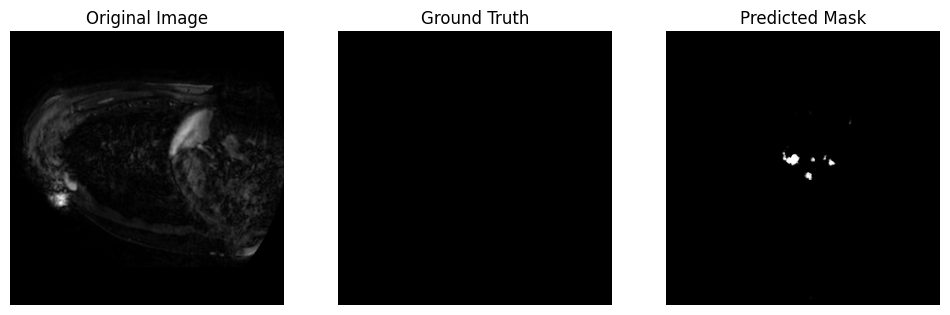

1


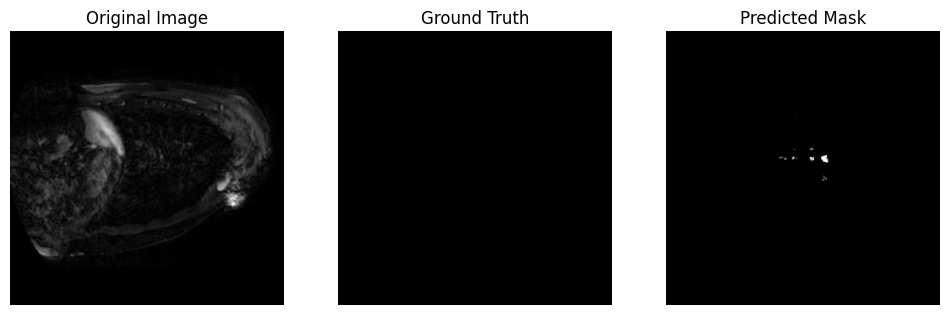

2


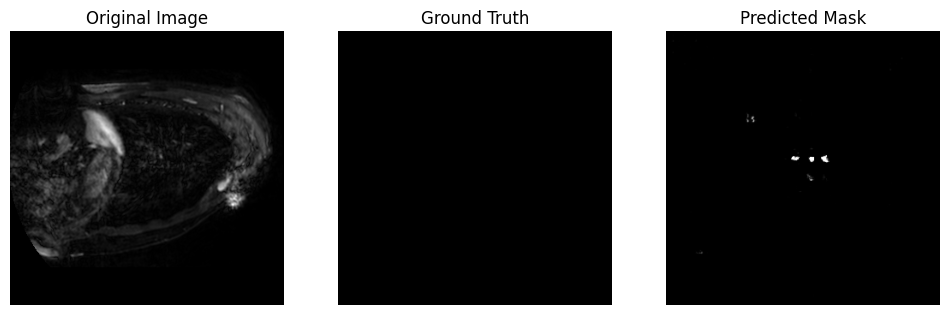

3


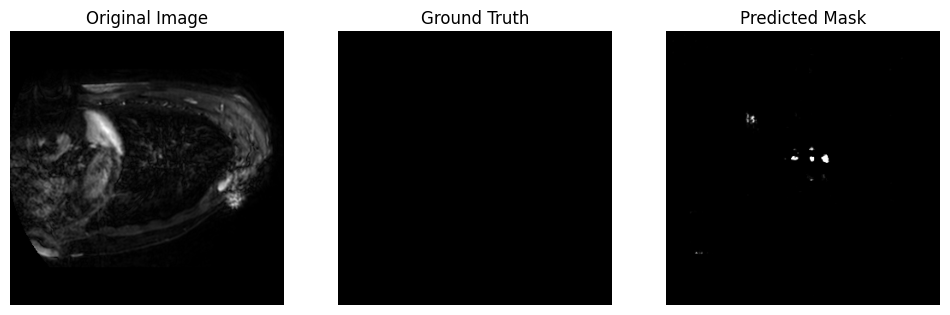

4


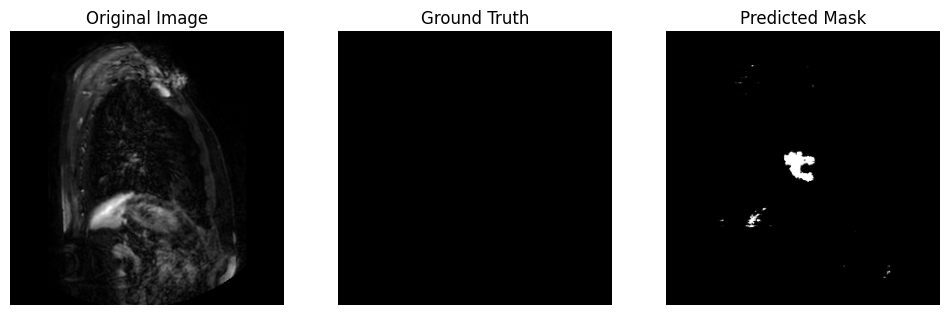

5


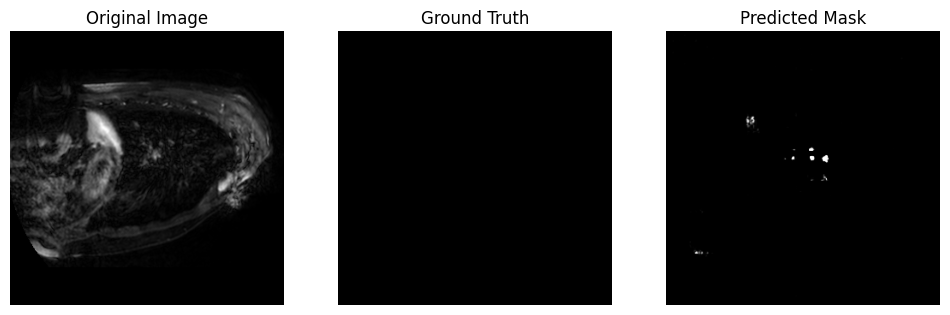

6


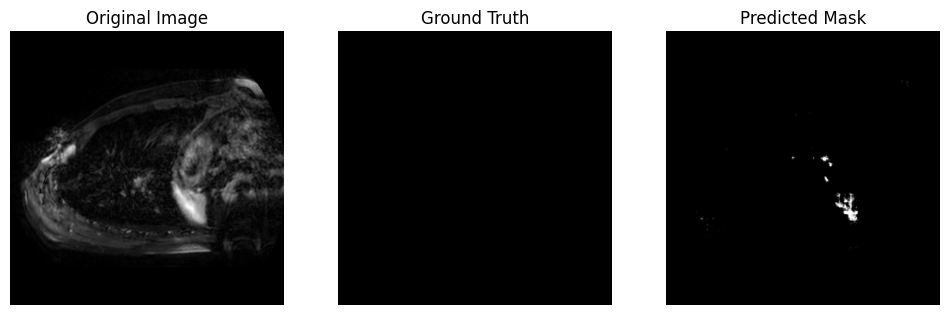

7


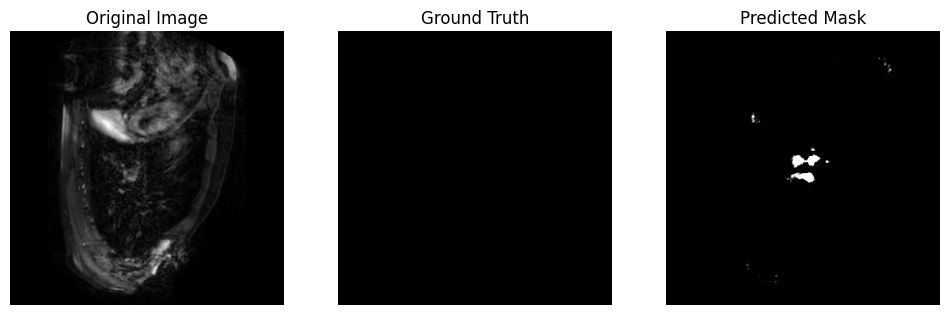

8


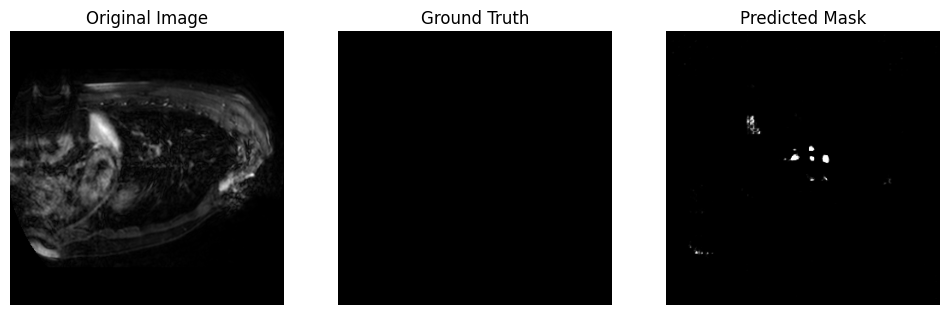

9


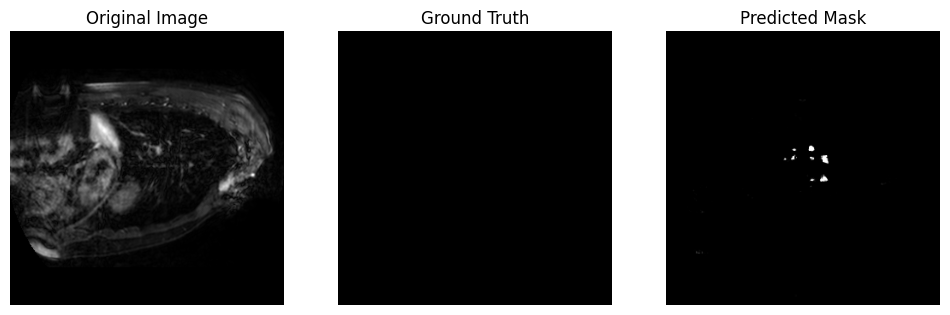

10


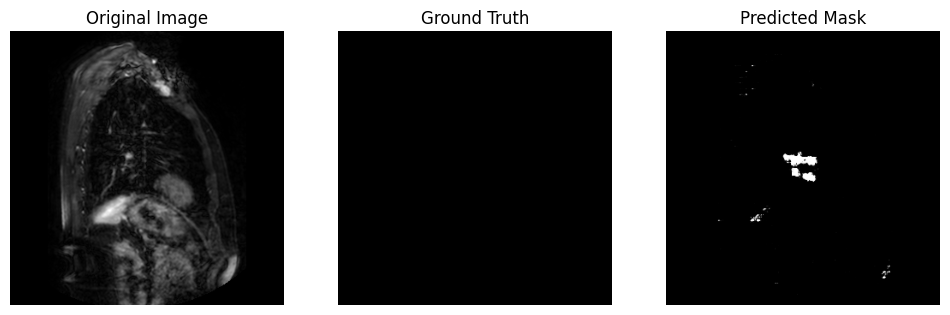

11


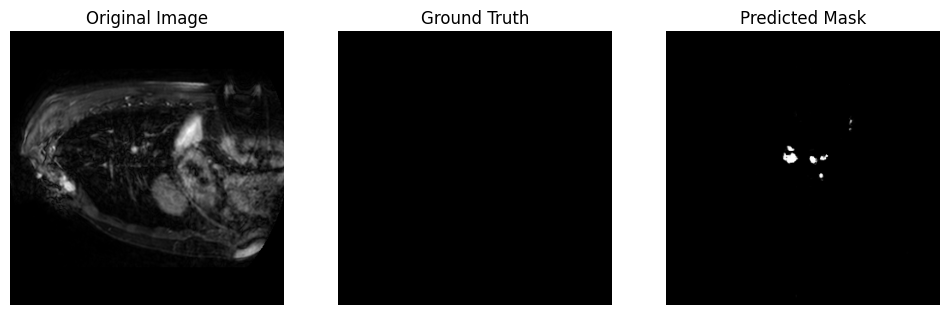

12


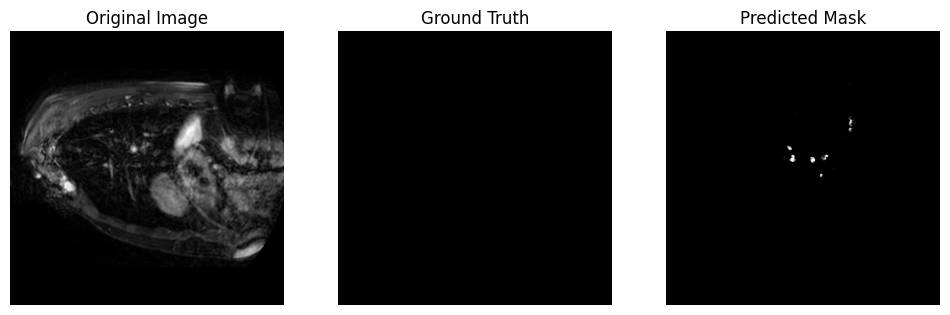

13


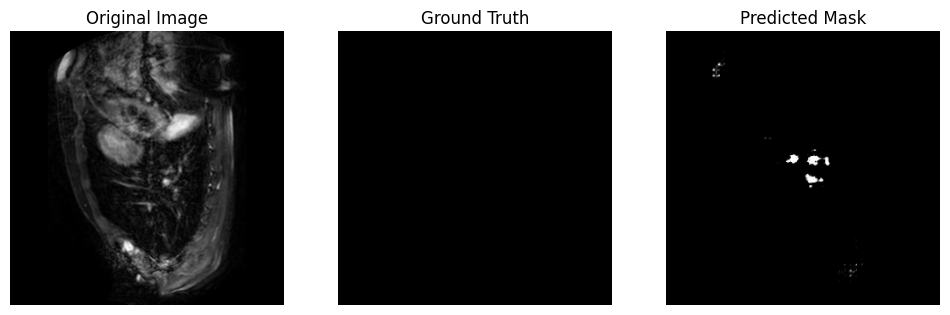

14


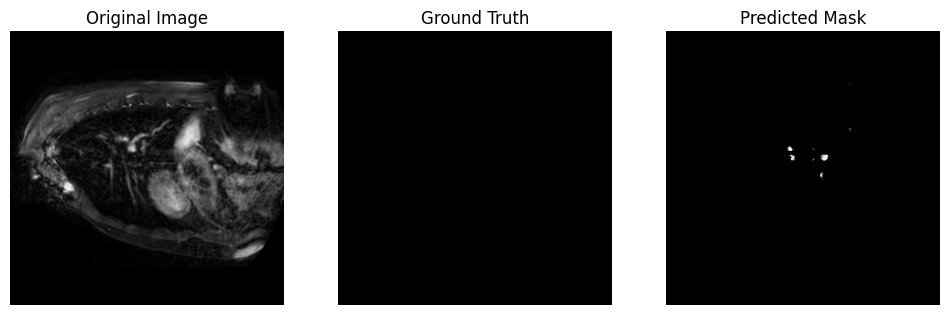

15


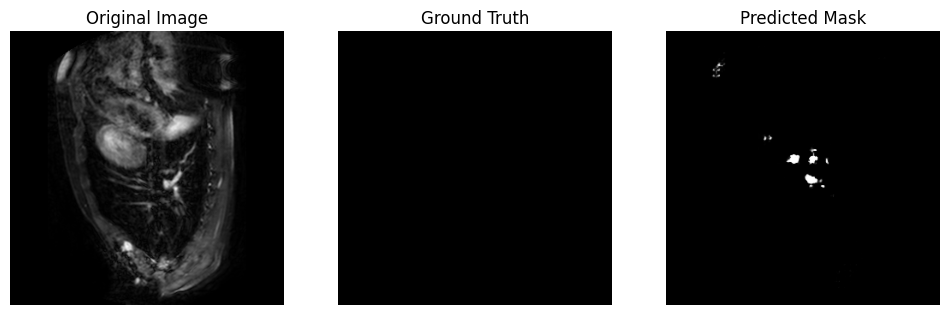

16


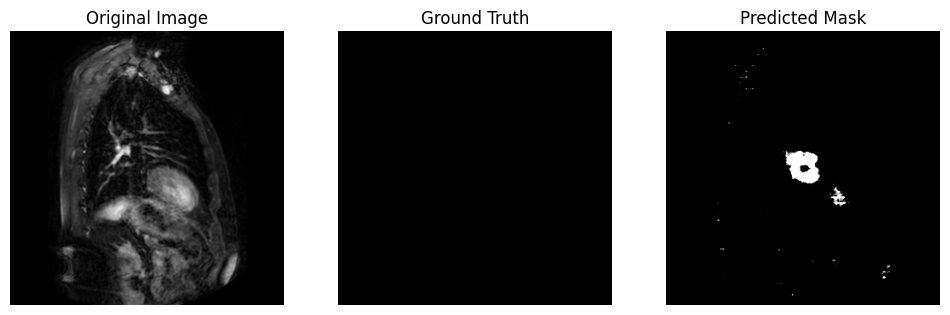

17


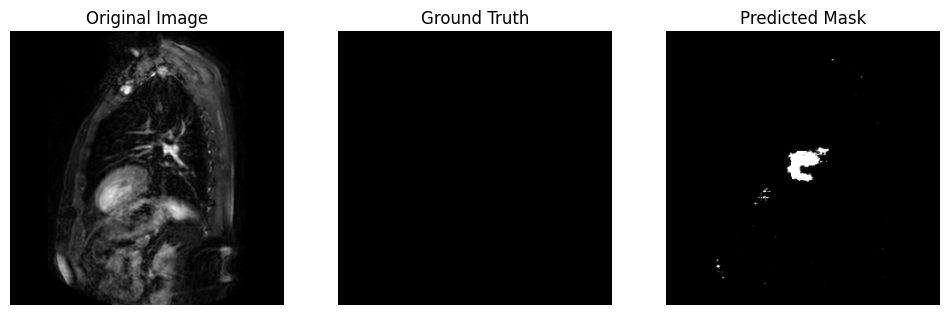

18


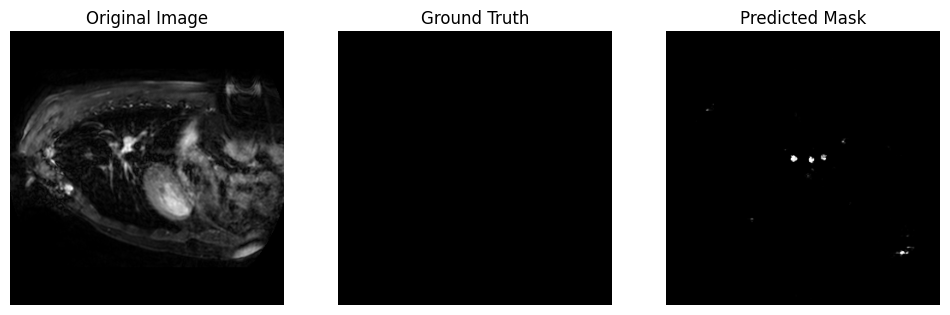

19


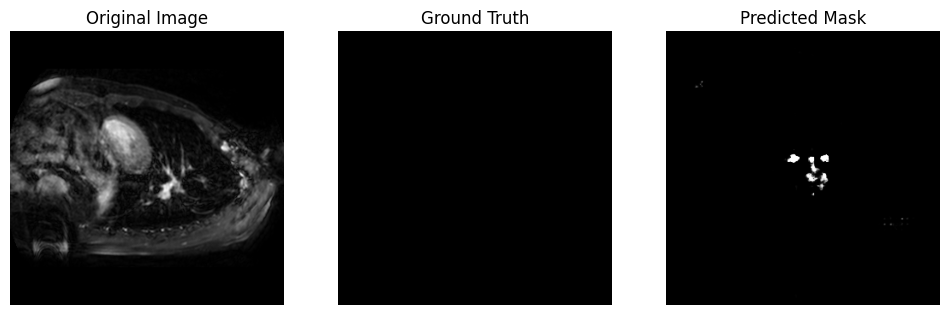

20


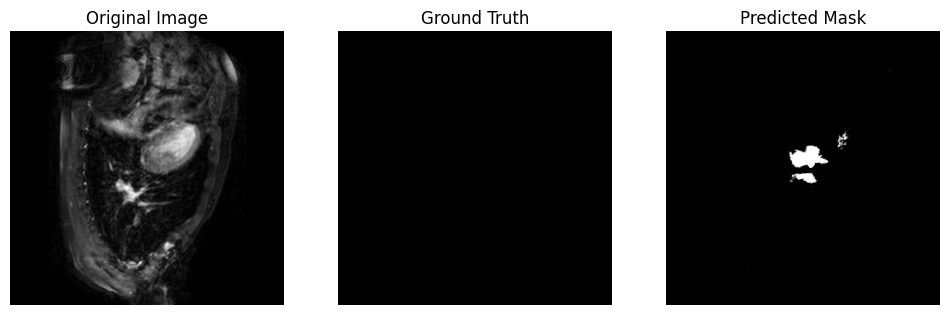

21


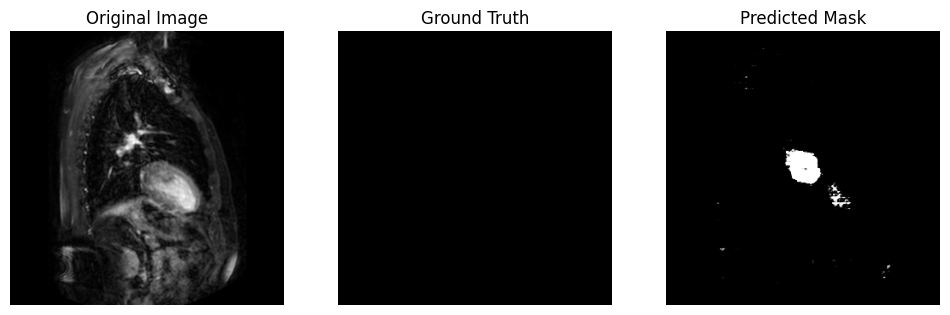

22


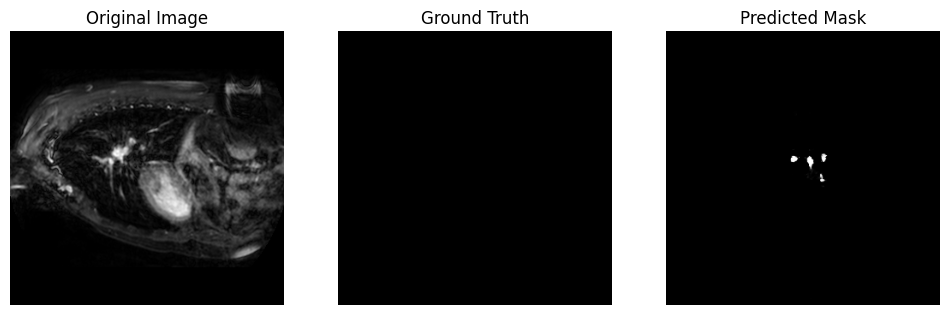

23


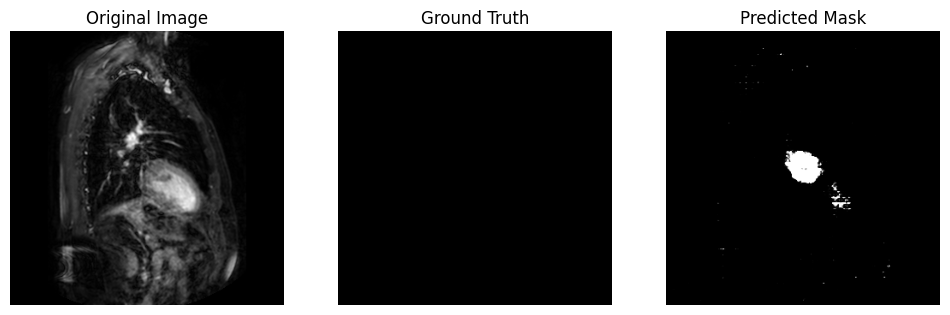

24


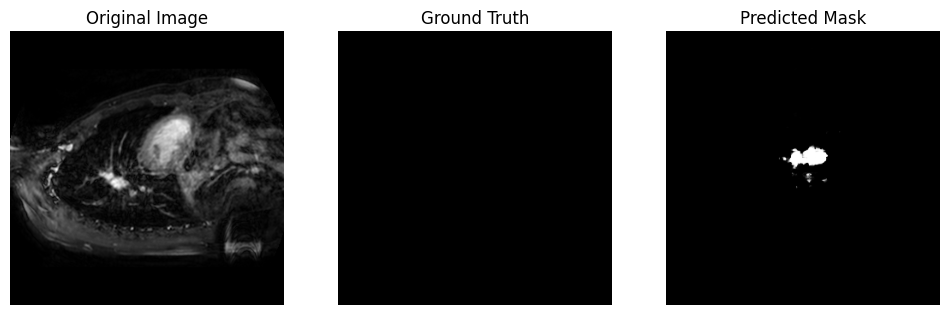

25


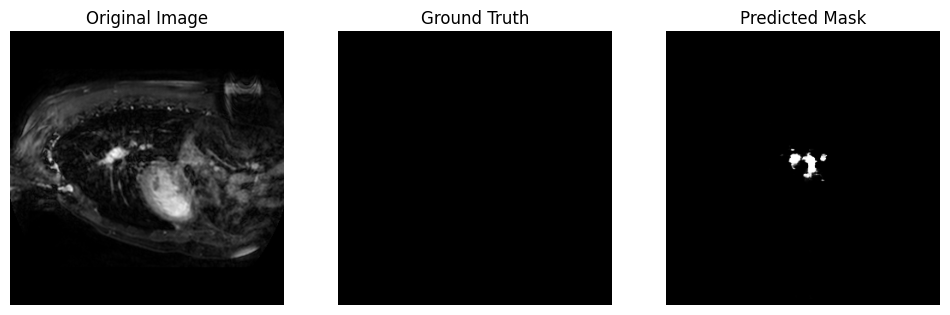

26


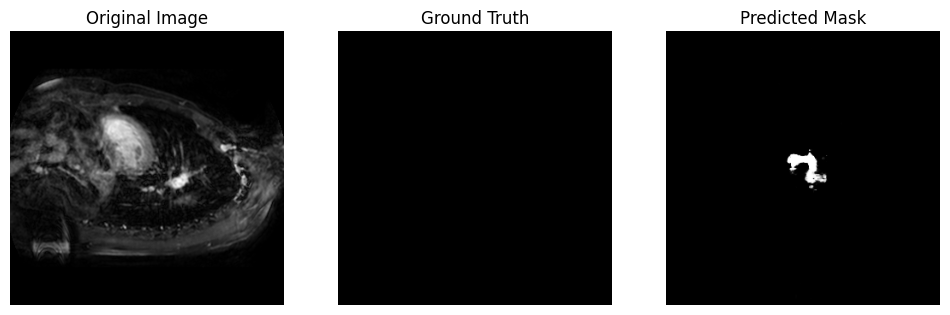

27


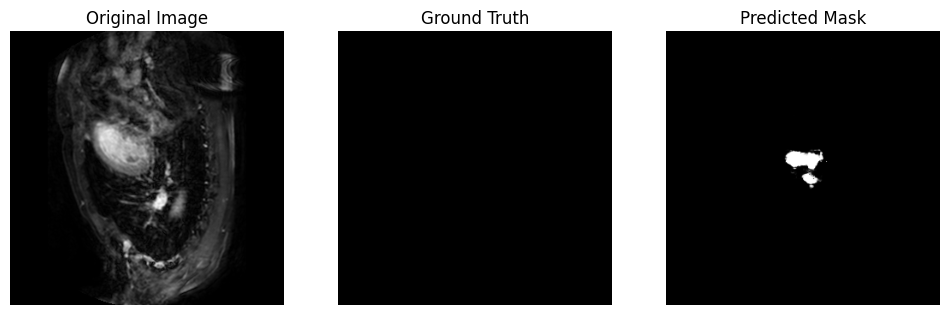

28


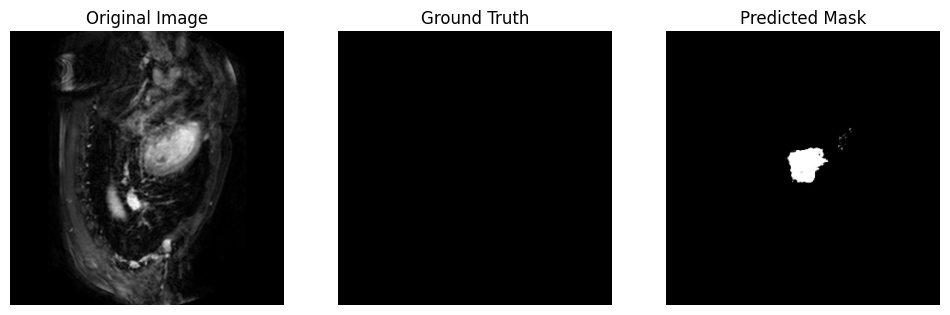

29


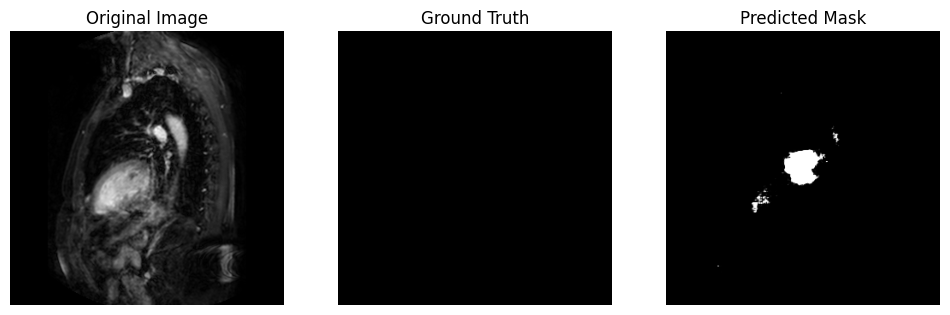

30


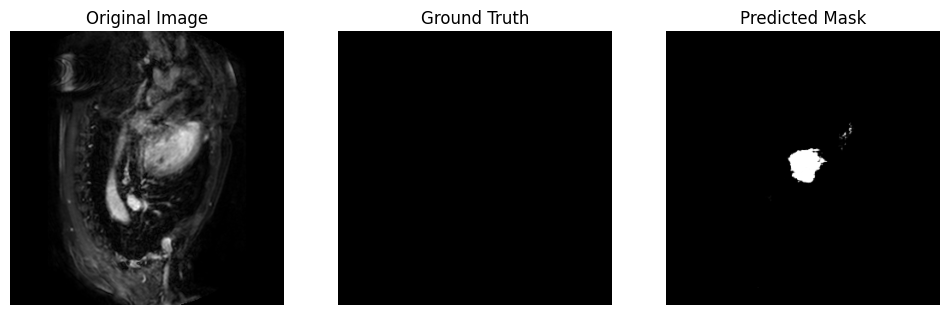

31


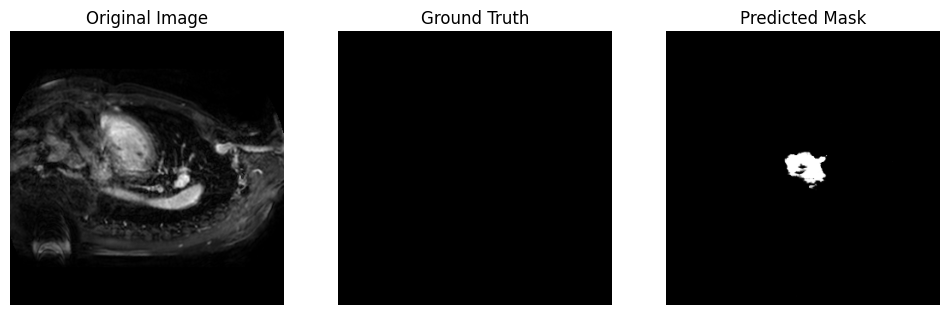

32


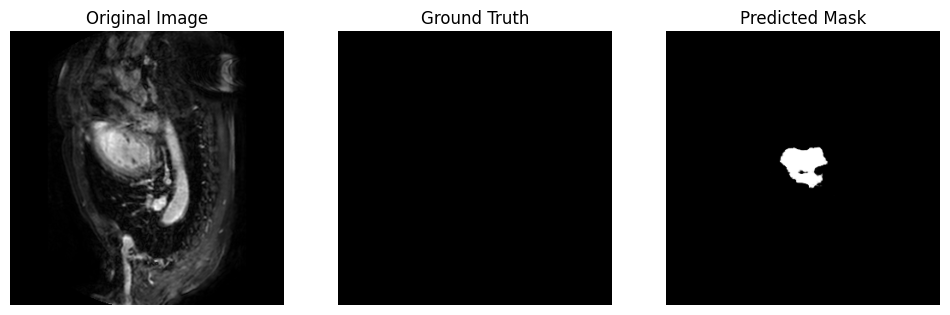

33


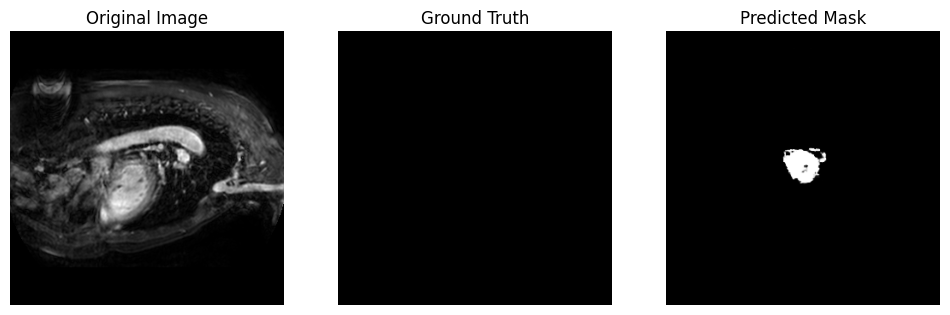

34


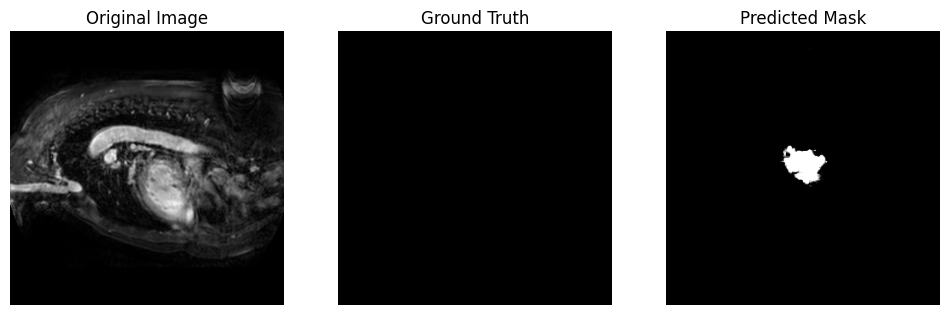

35


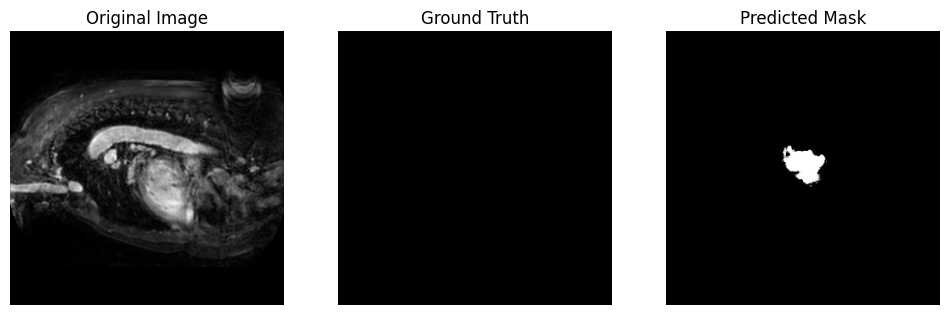

36


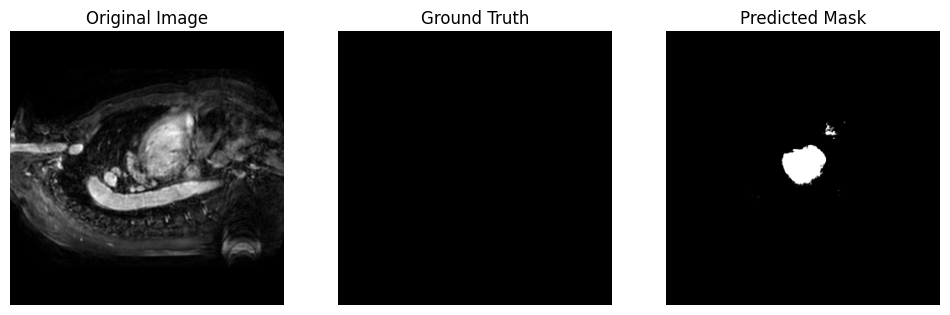

37


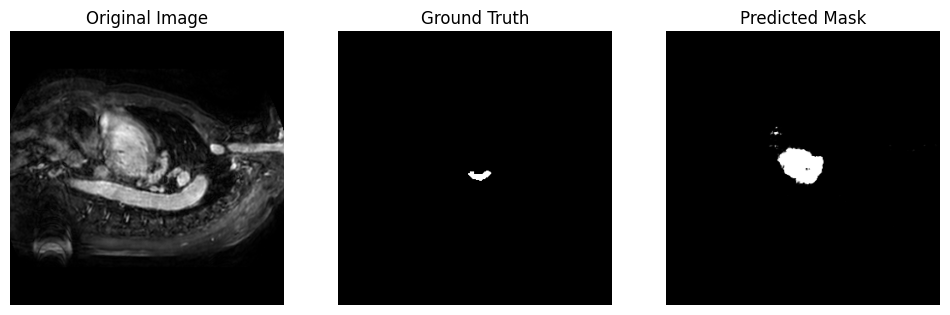

38


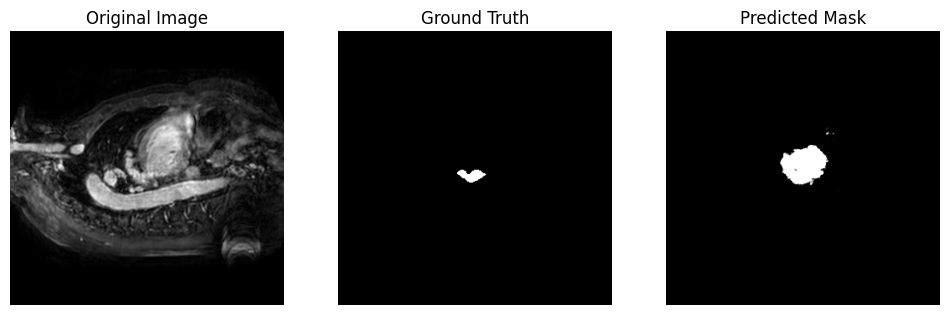

39


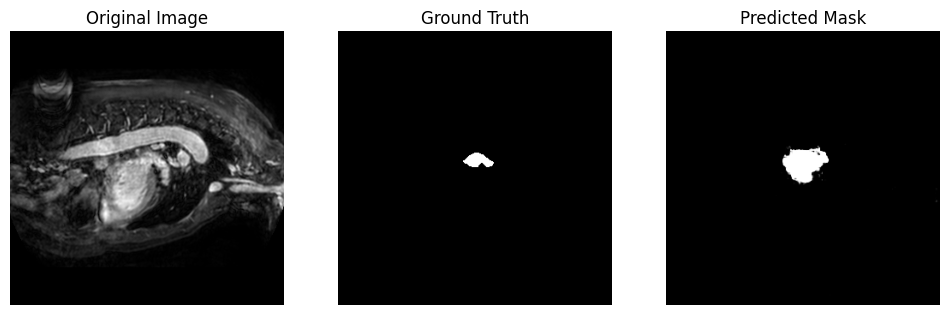

40


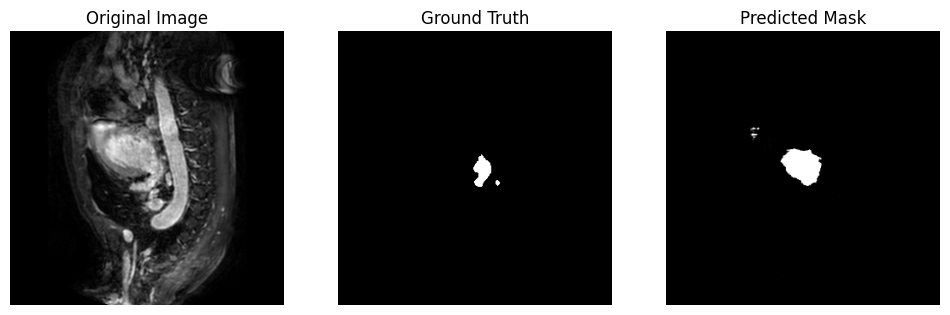

41


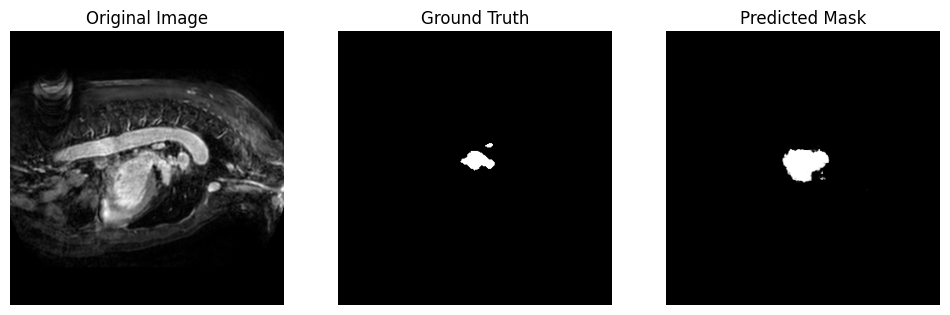

42


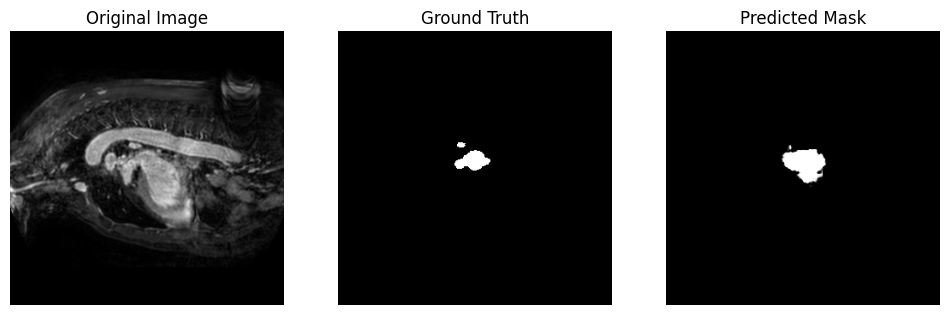

43


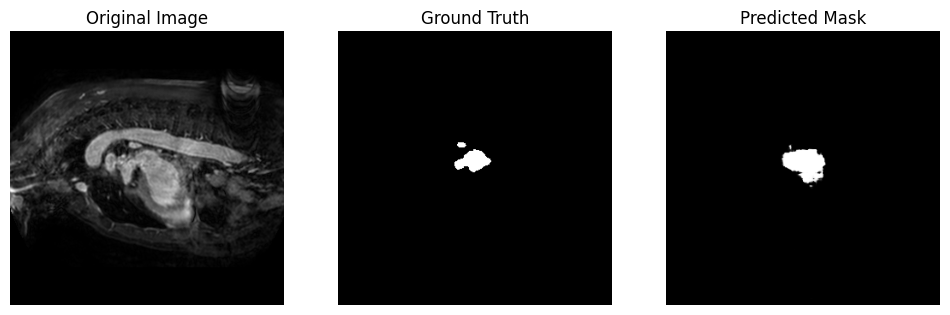

44


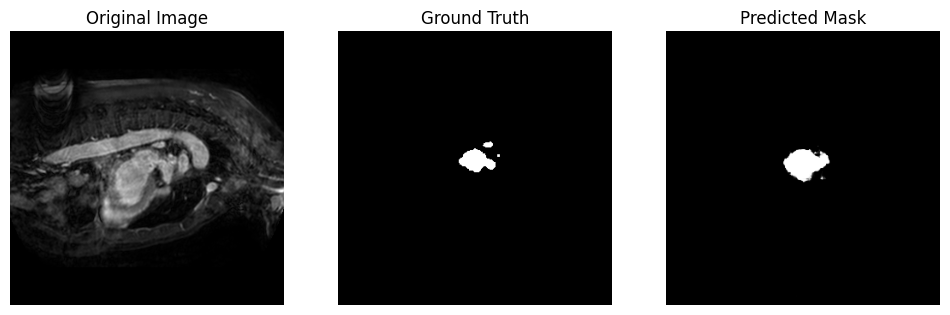

45


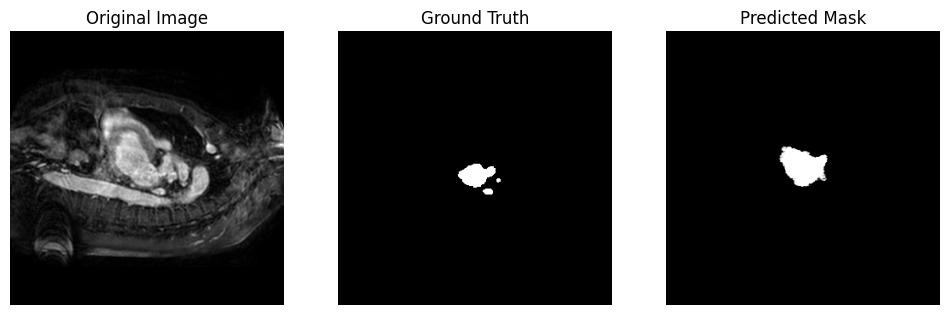

46


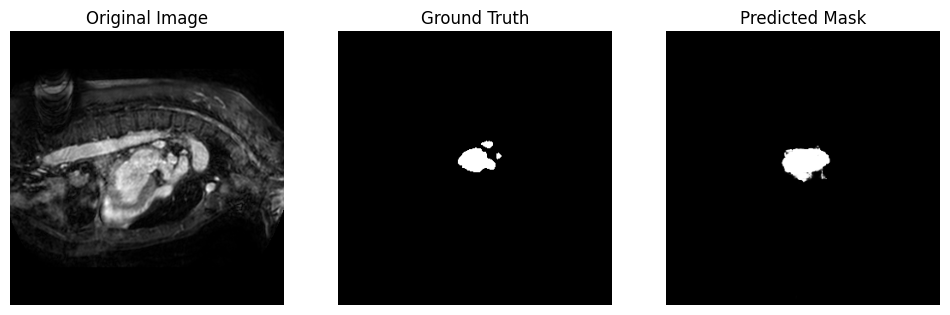

47


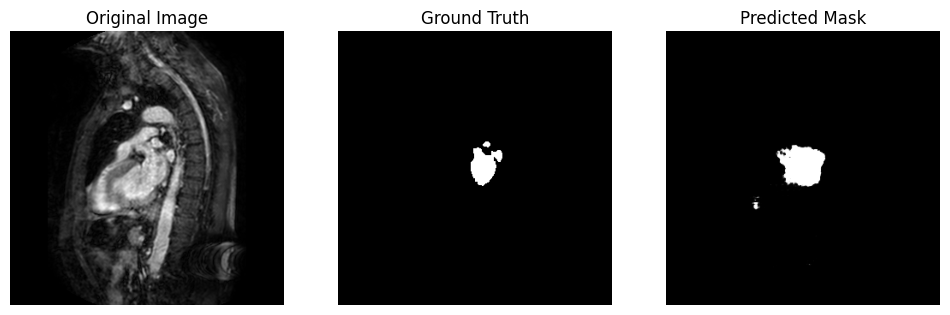

48


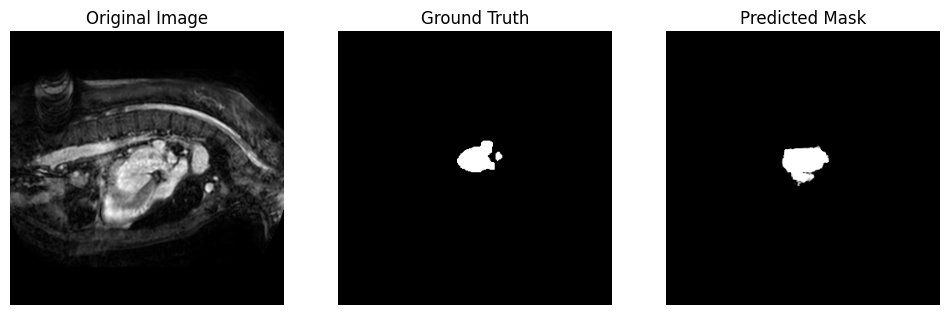

49


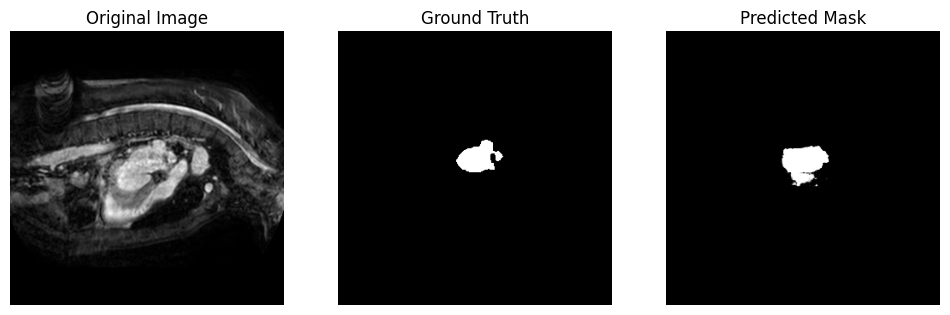

50


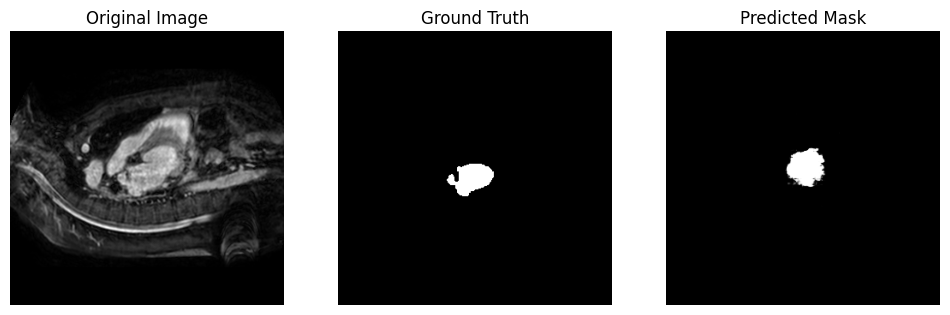

51


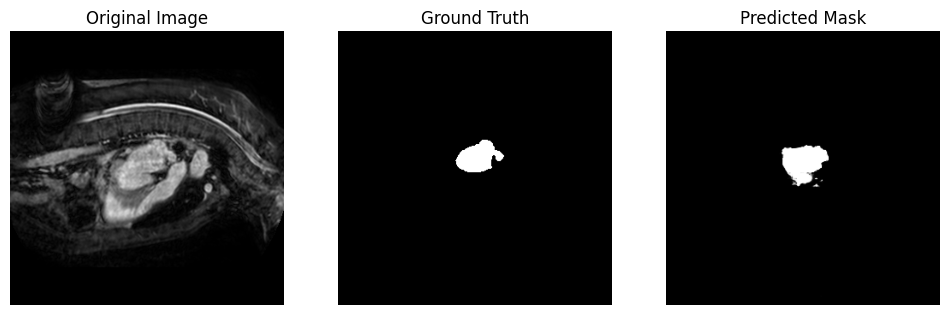

52


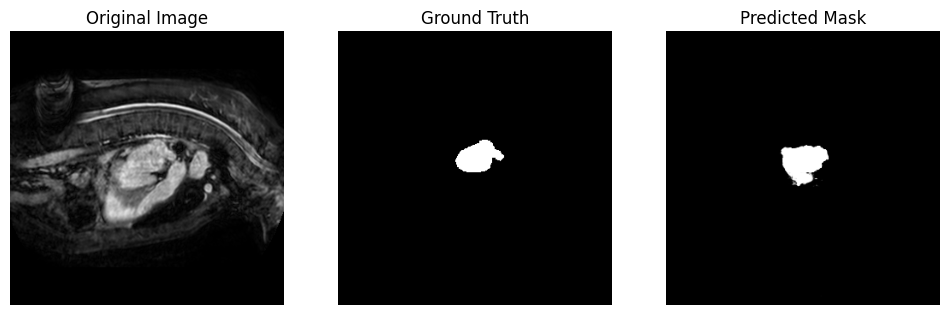

53


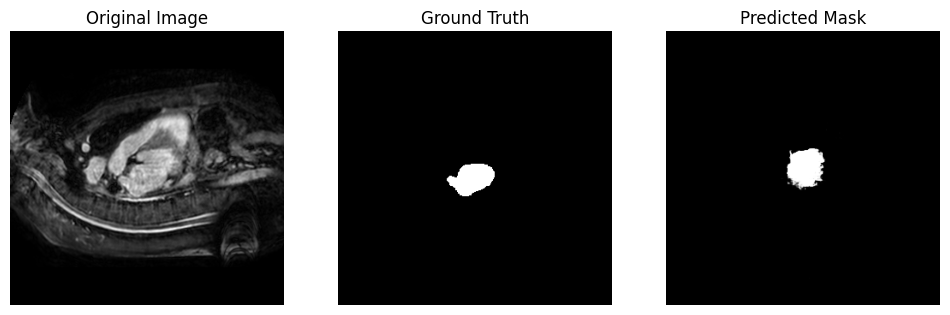

54


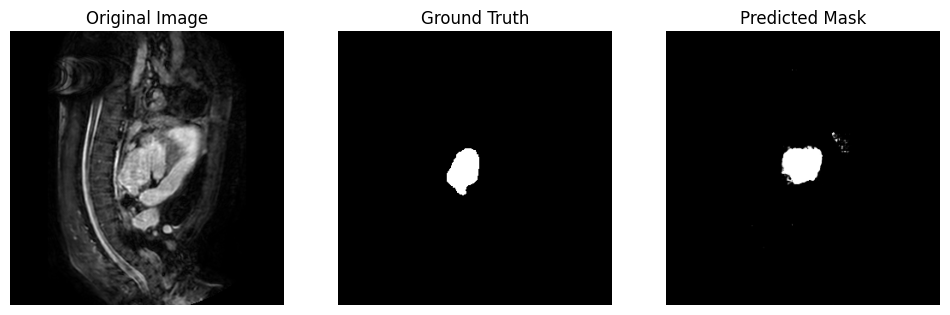

55


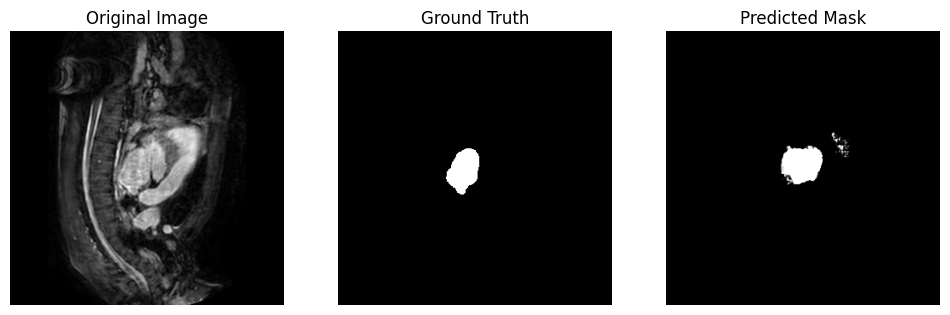

56


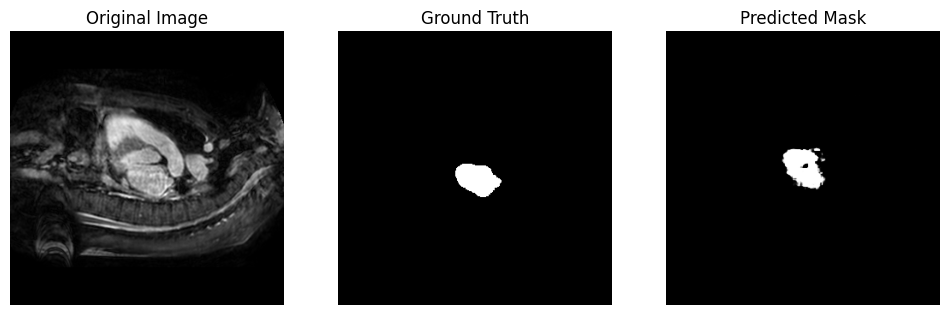

57


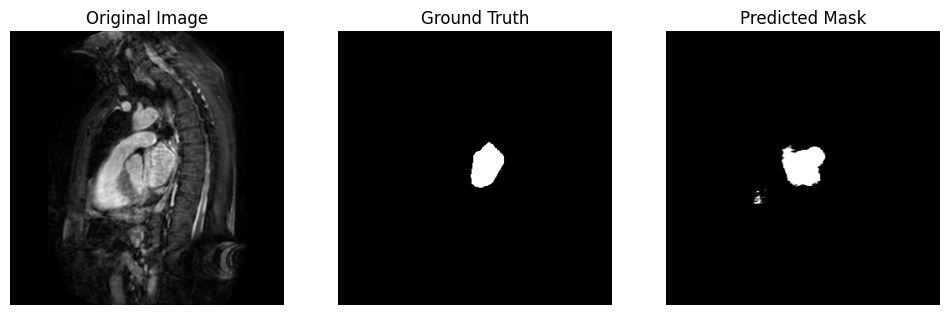

58


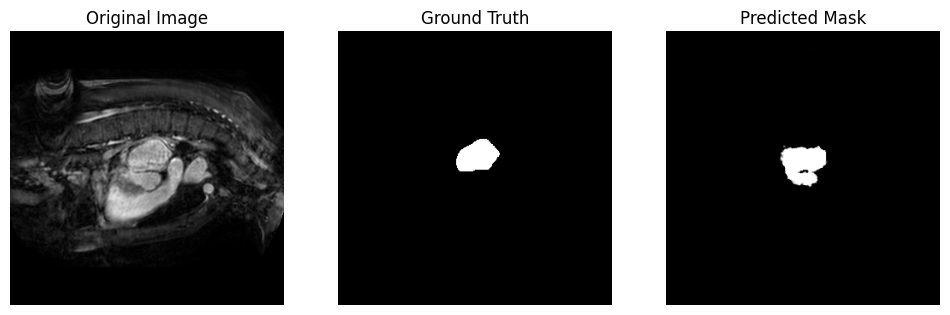

59


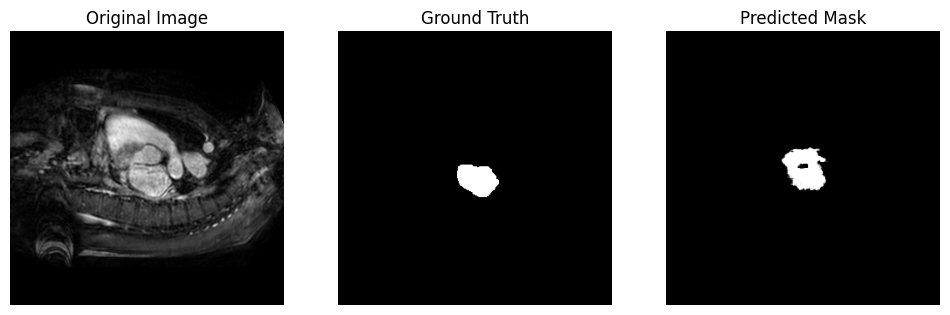

60


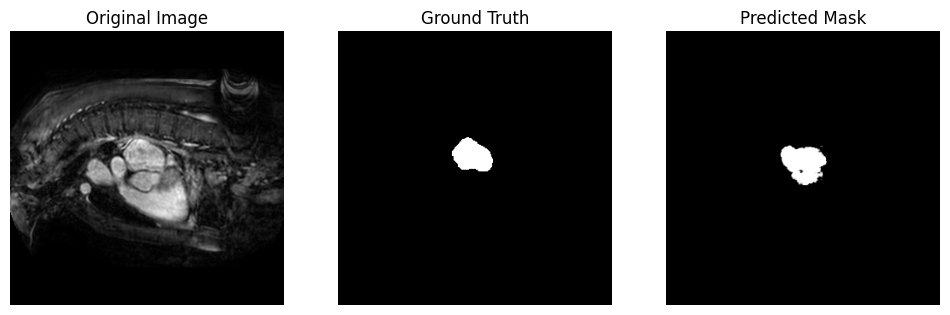

61


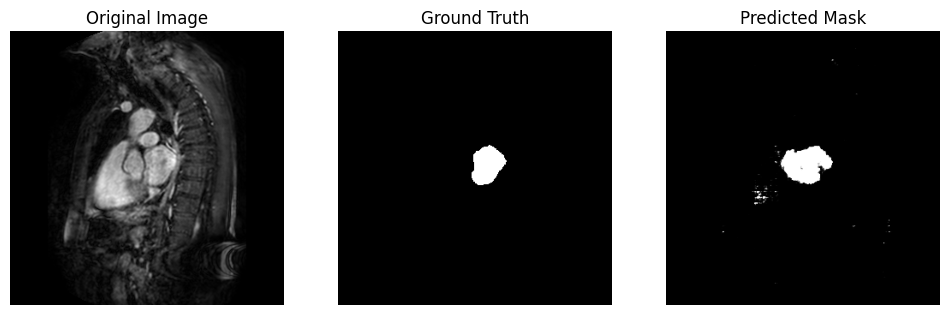

62


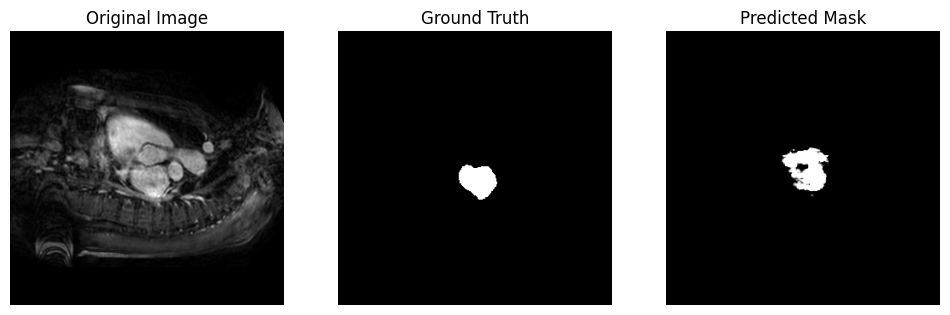

63


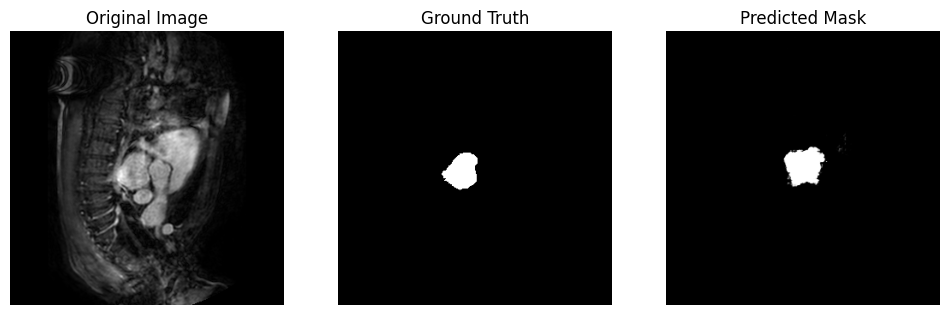

64


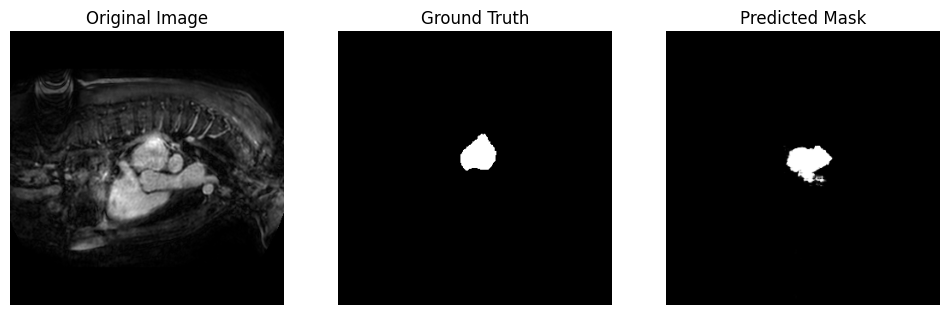

65


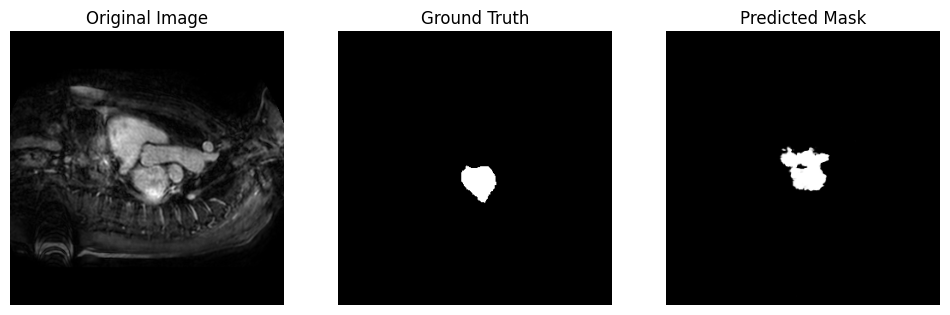

66


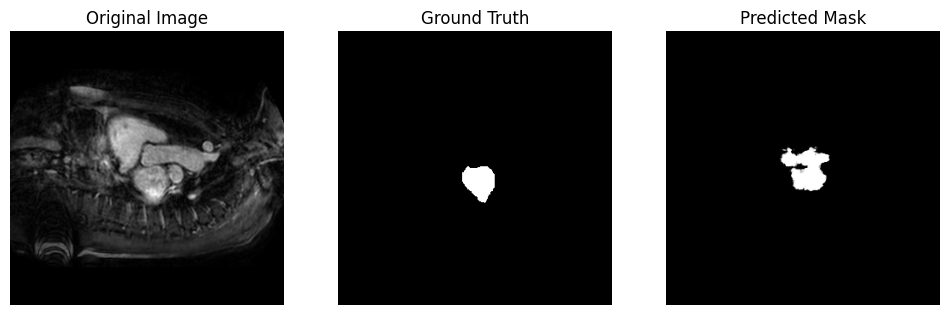

67


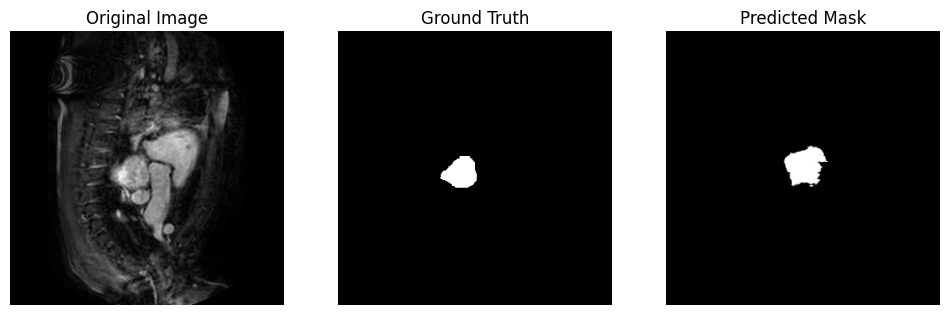

68


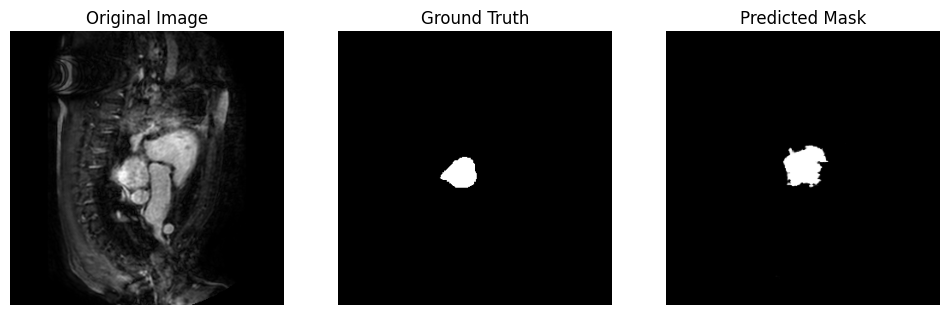

69


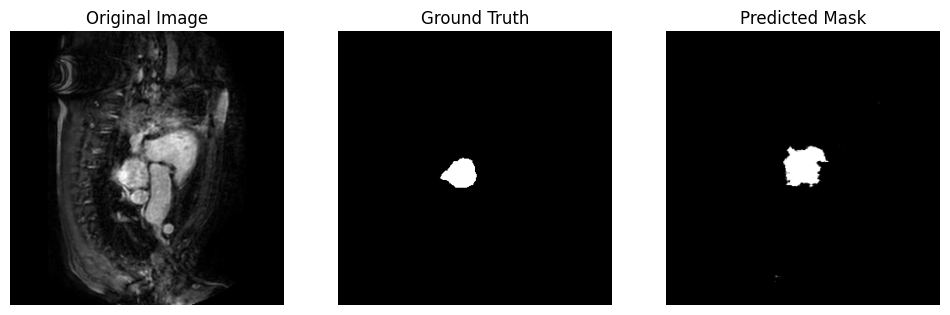

70


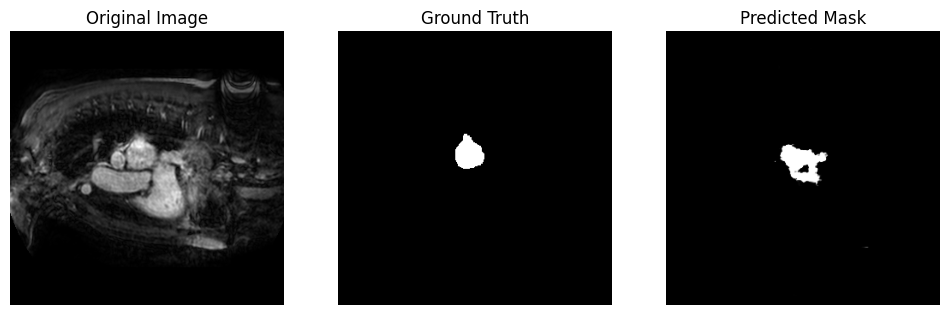

71


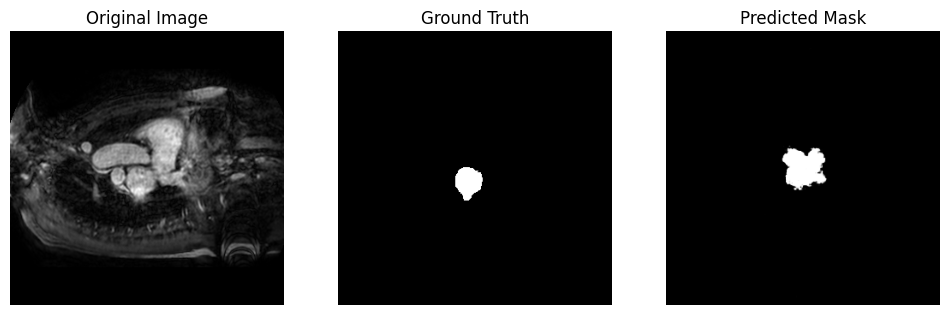

72


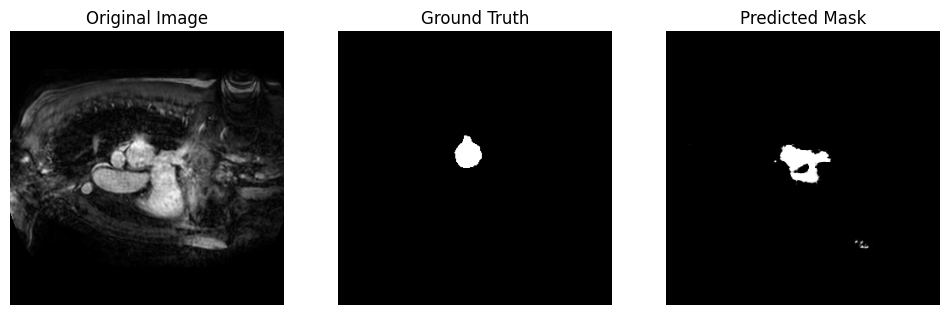

73


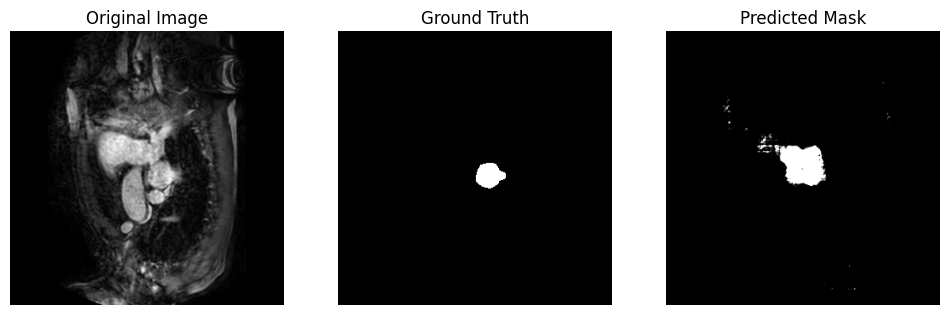

74


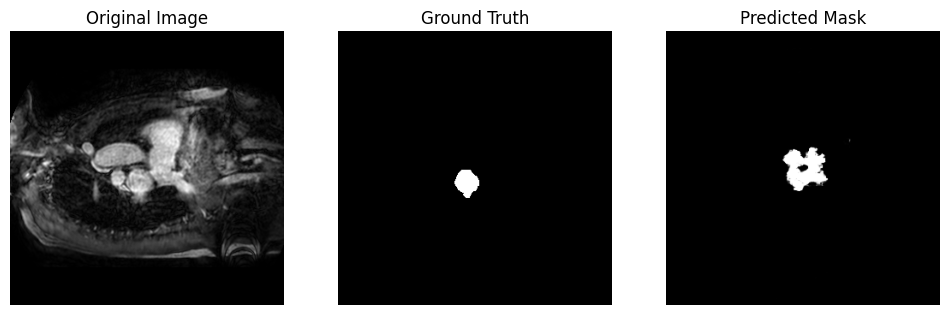

75


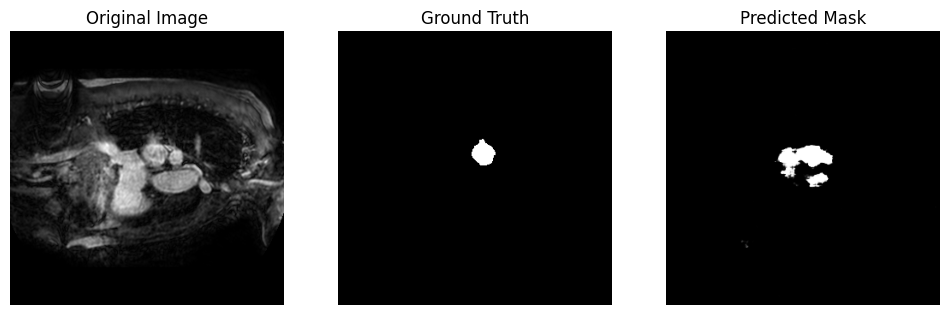

76


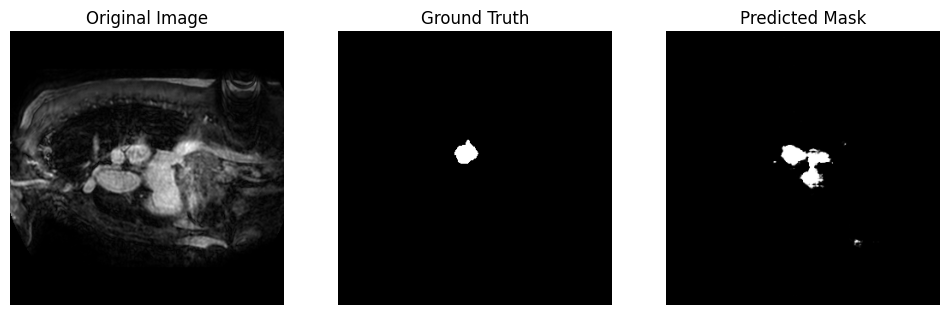

77


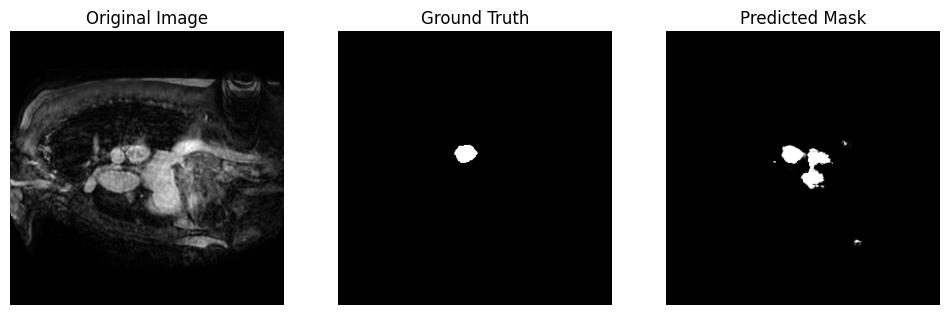

78


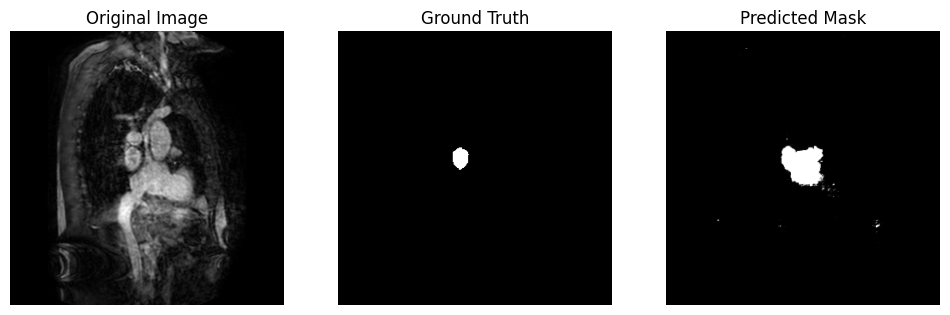

79


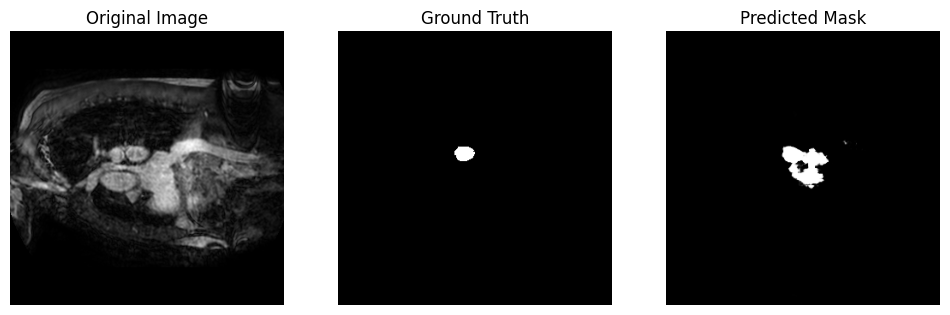

80


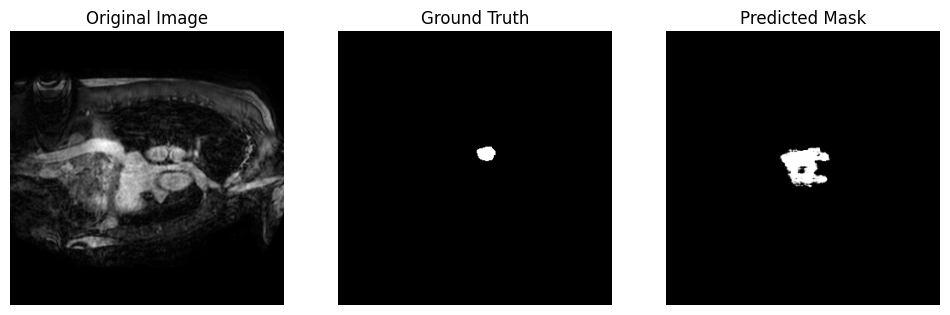

81


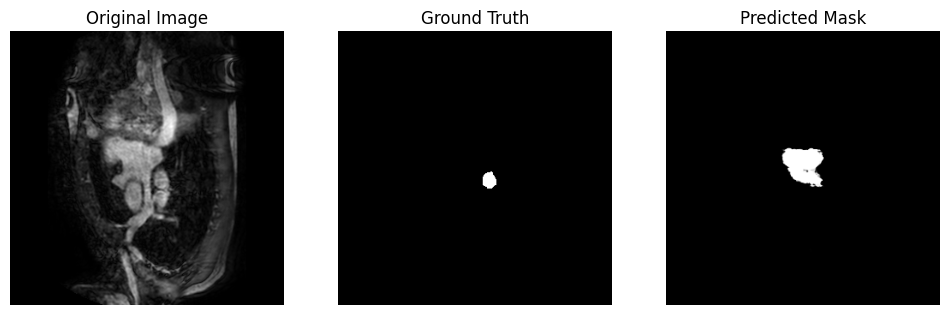

82


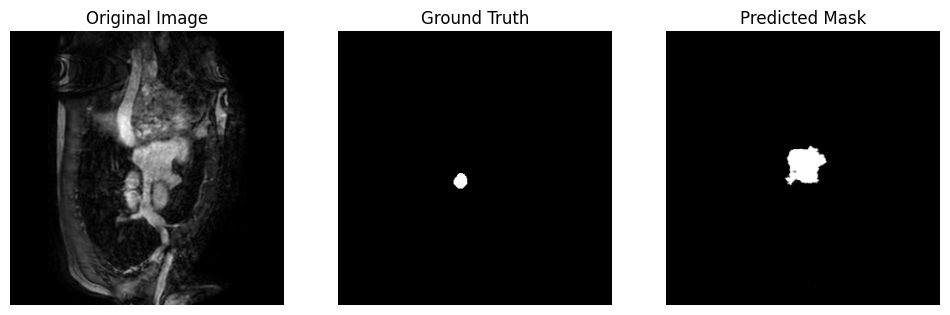

83


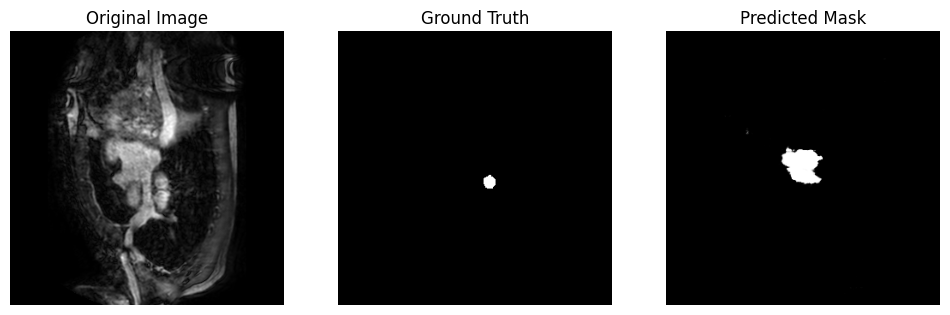

84


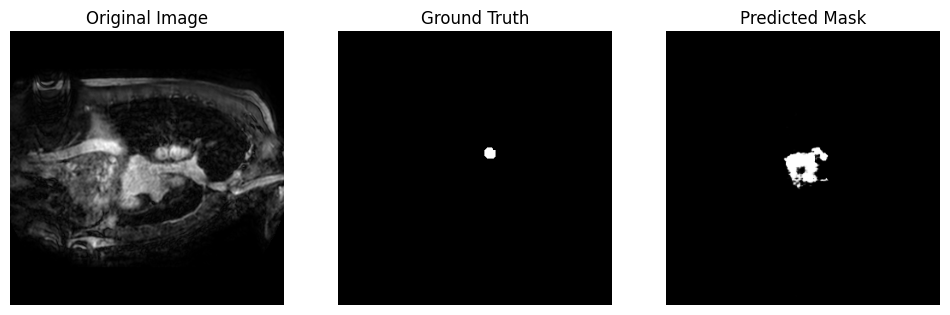

85


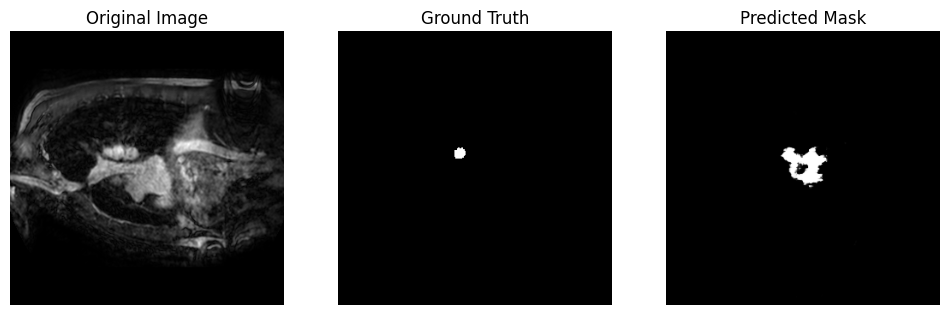

86


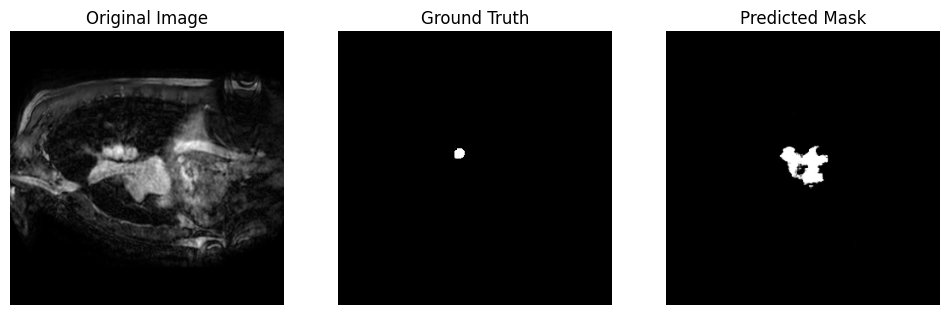

87


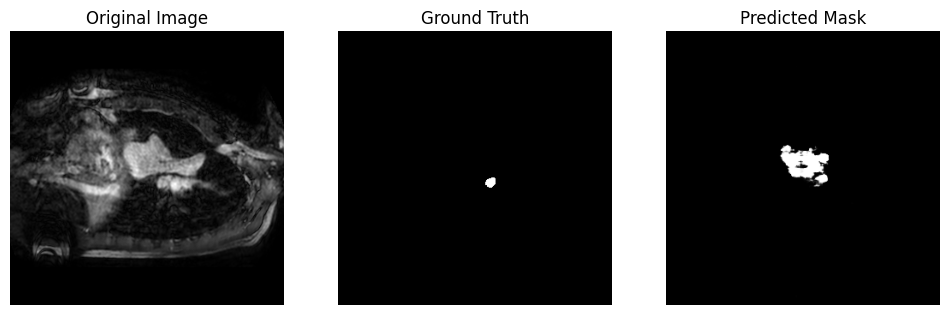

88


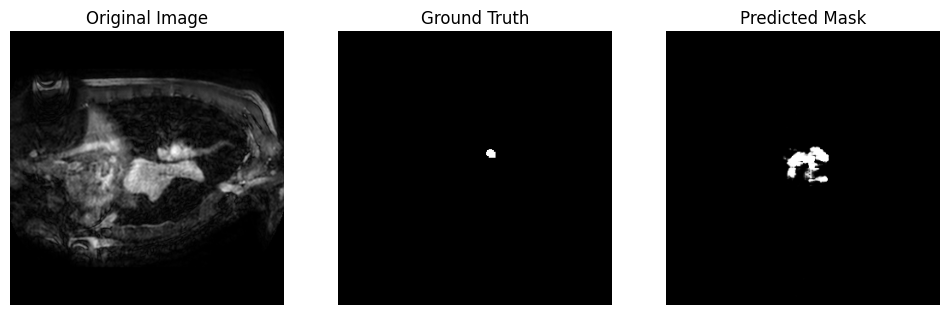

89


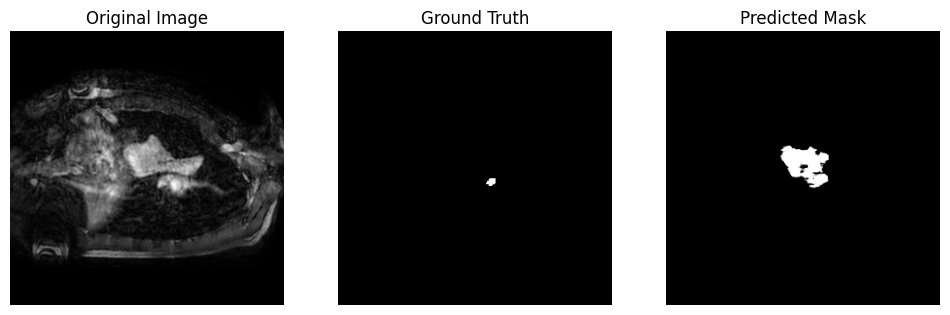

90


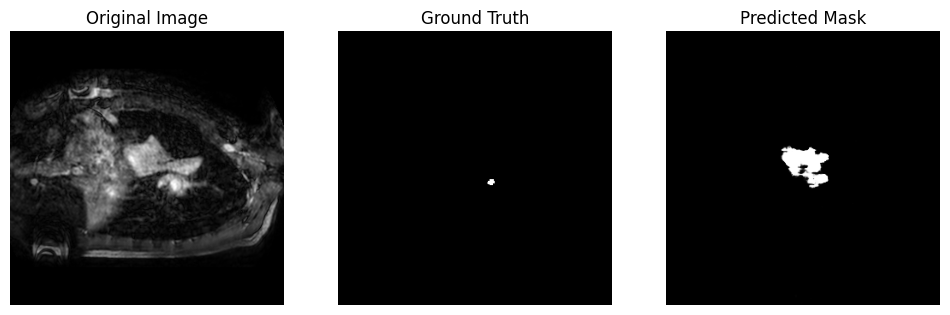

91


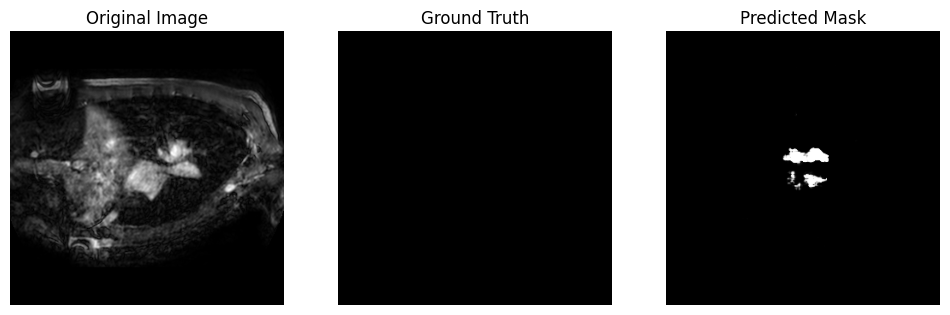

92


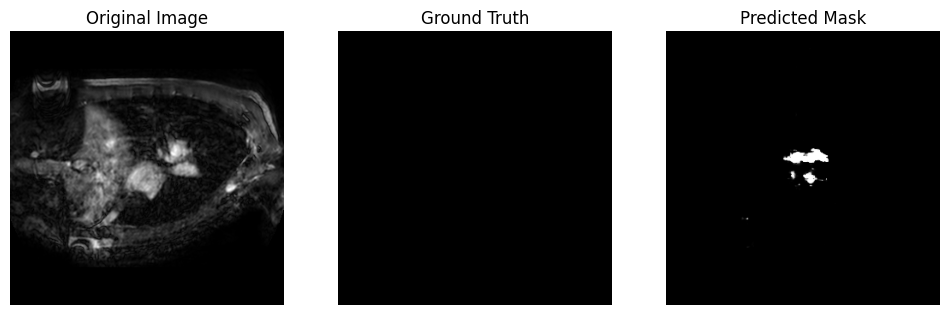

93


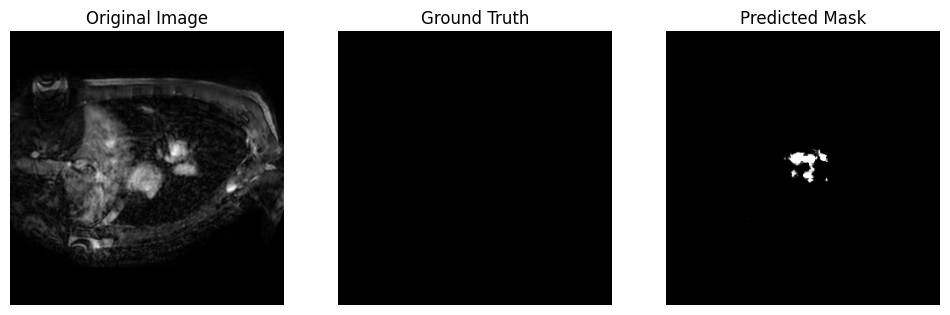

94


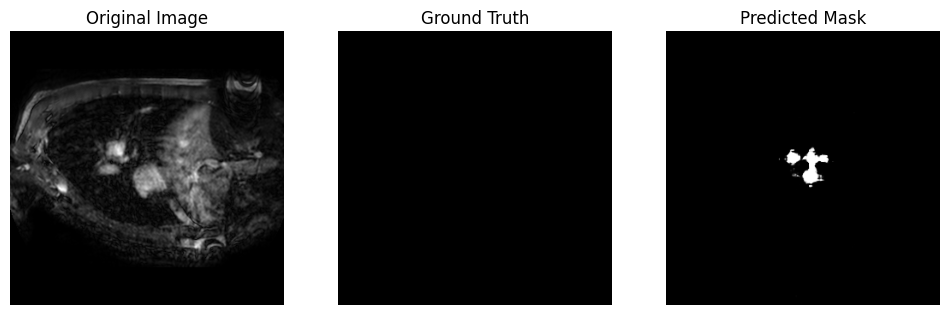

95


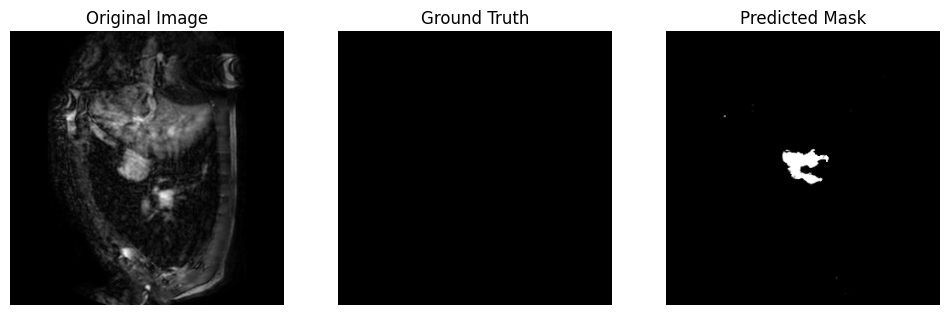

96


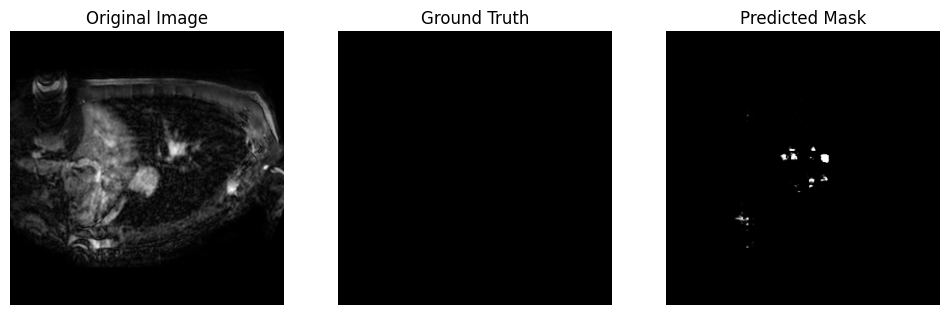

97


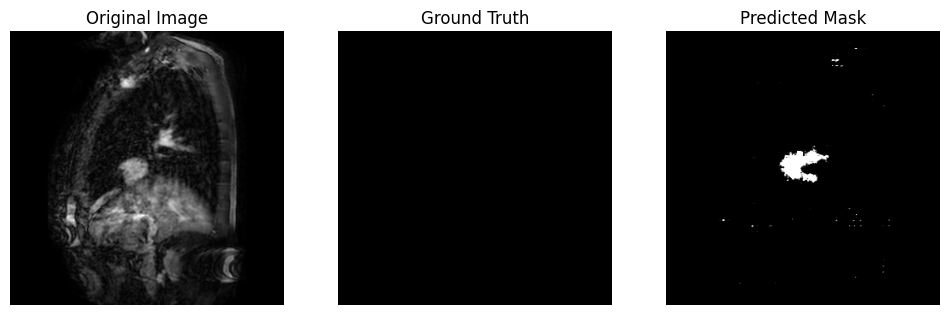

98


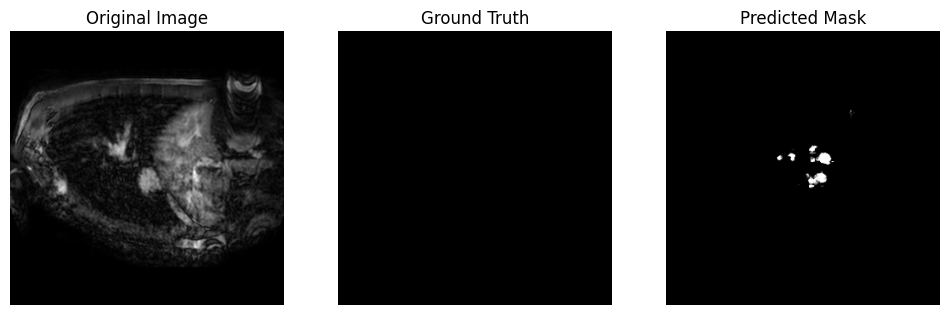

99


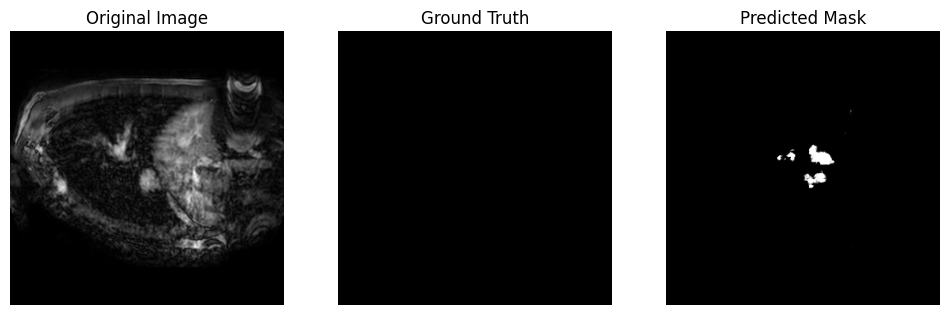

100


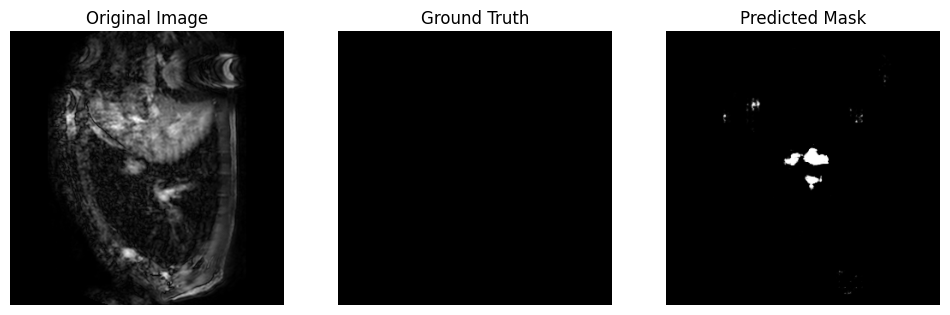

101


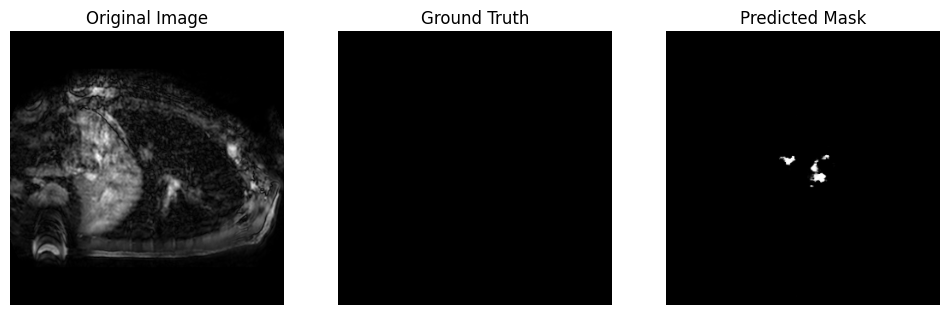

102


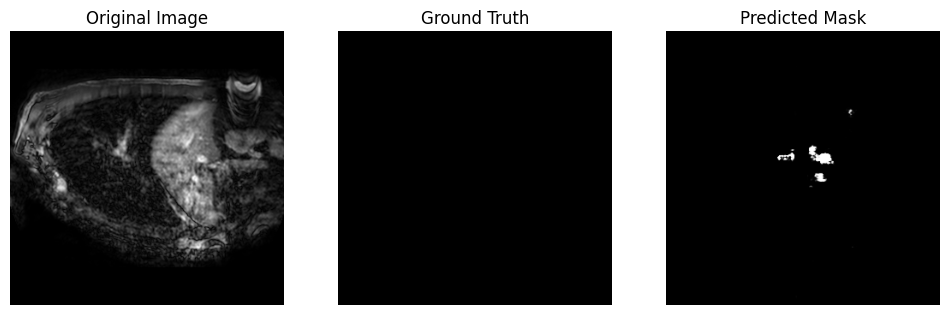

103


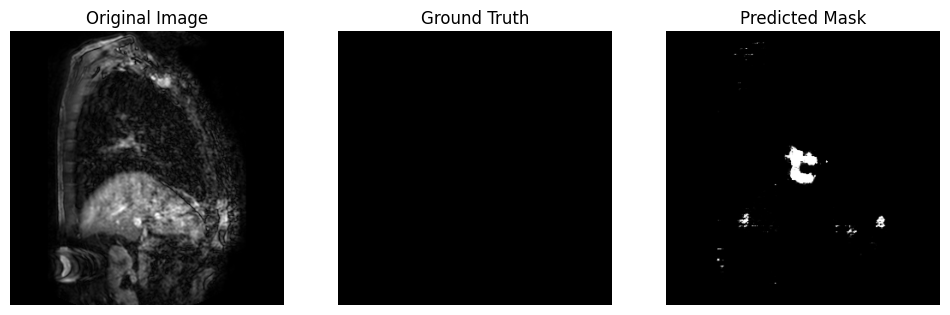

104


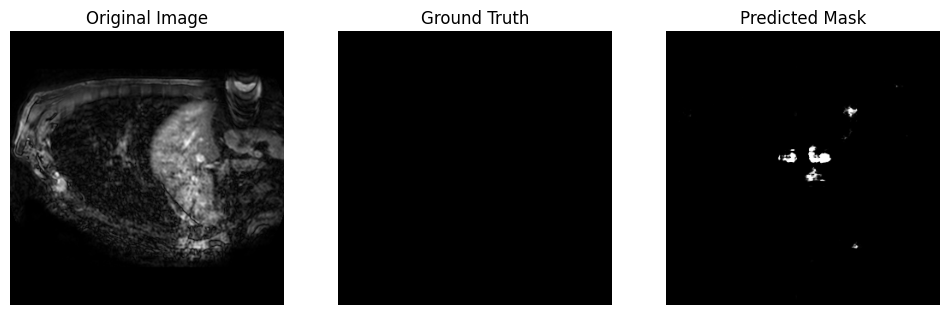

105


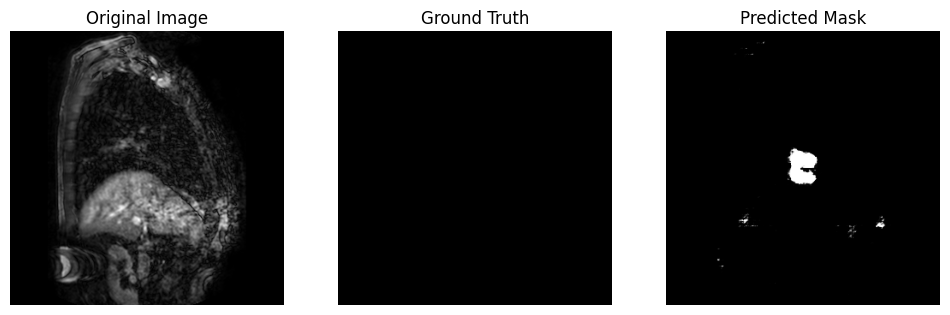

106


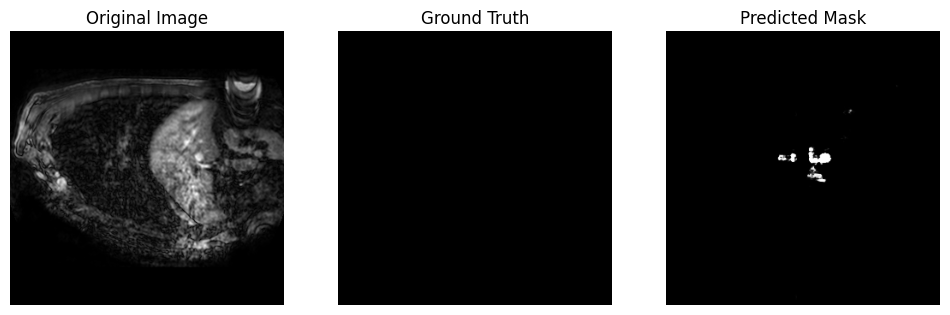

107


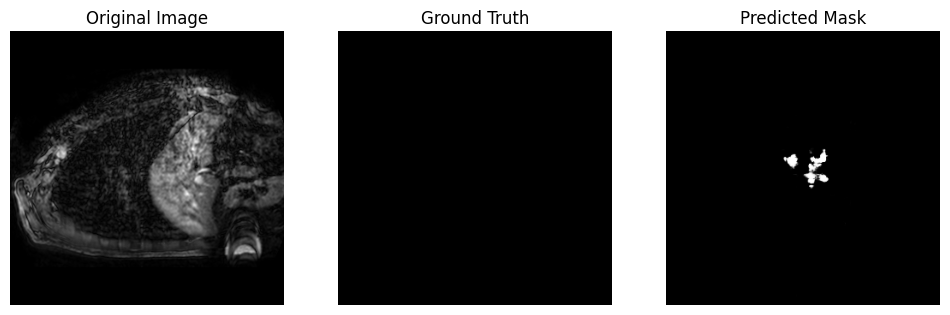

108


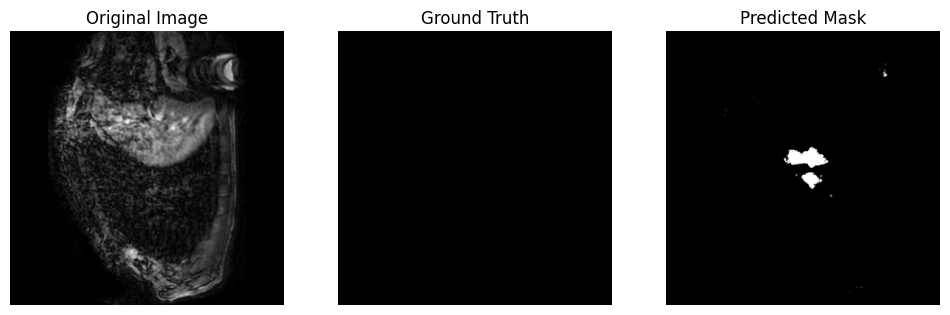

109


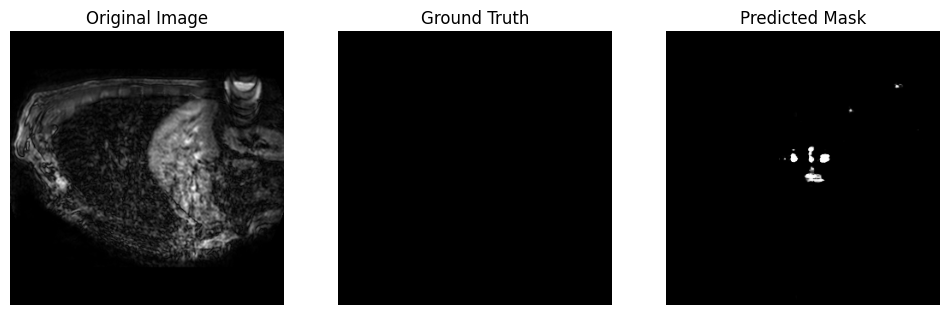

110


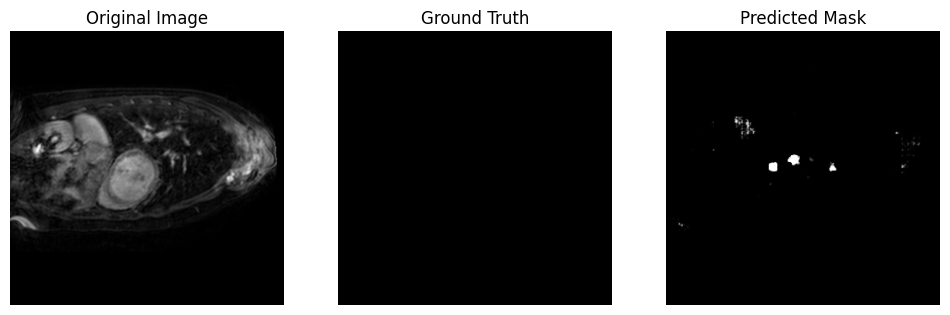

111


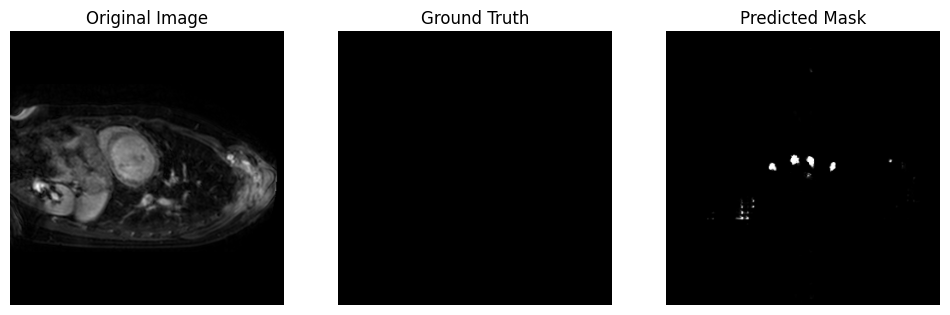

112


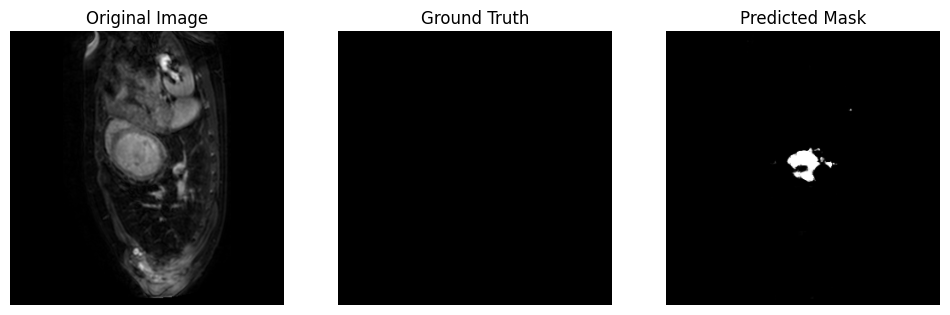

113


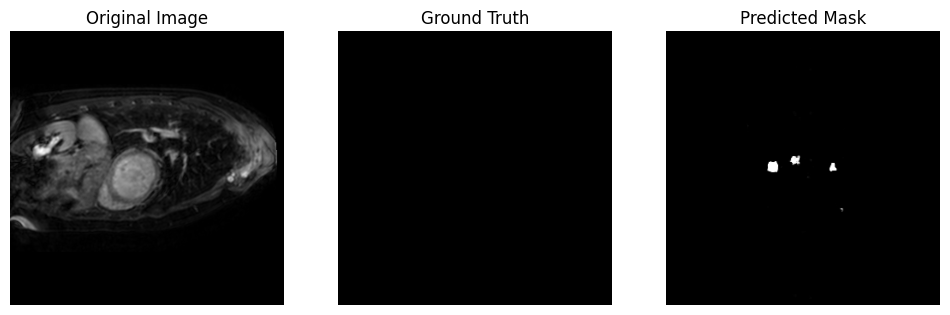

114


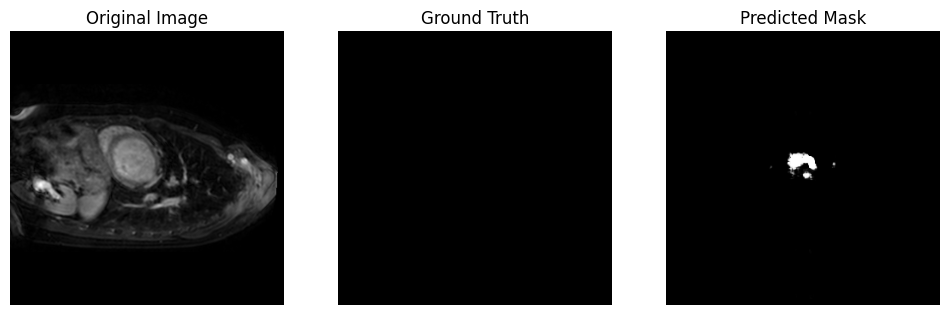

115


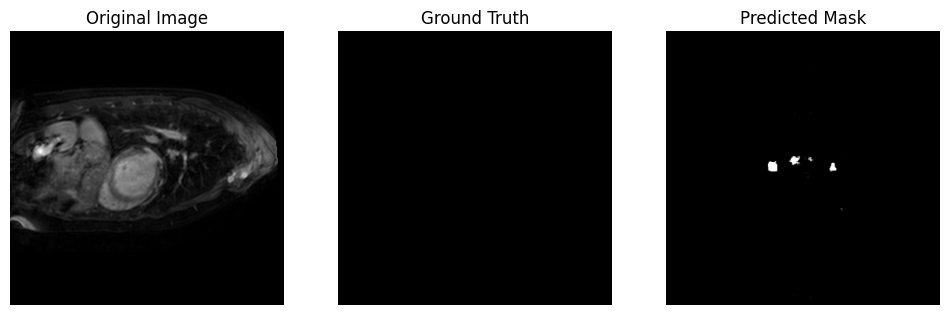

116


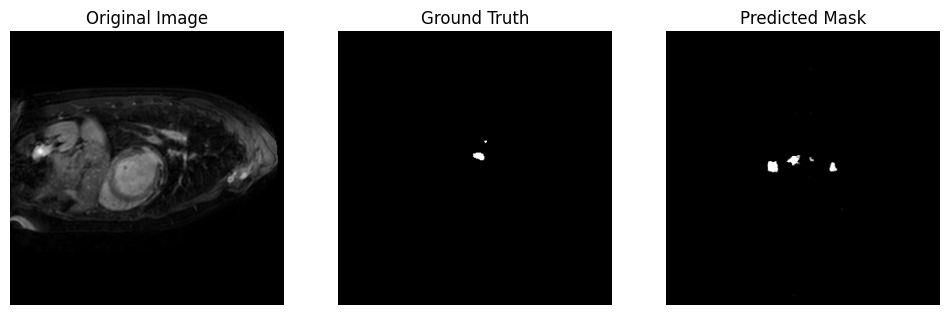

117


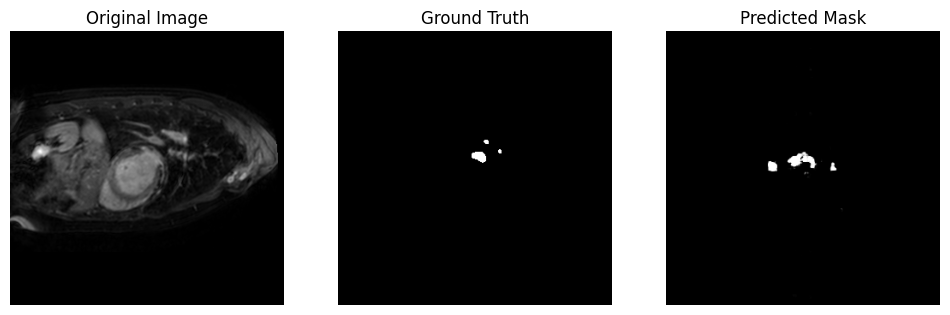

118


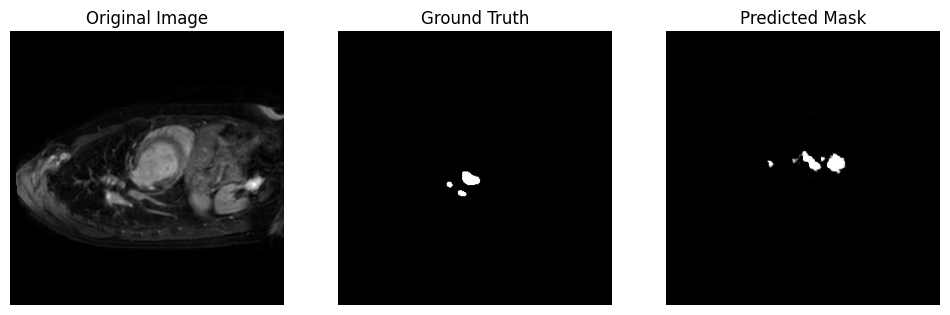

119


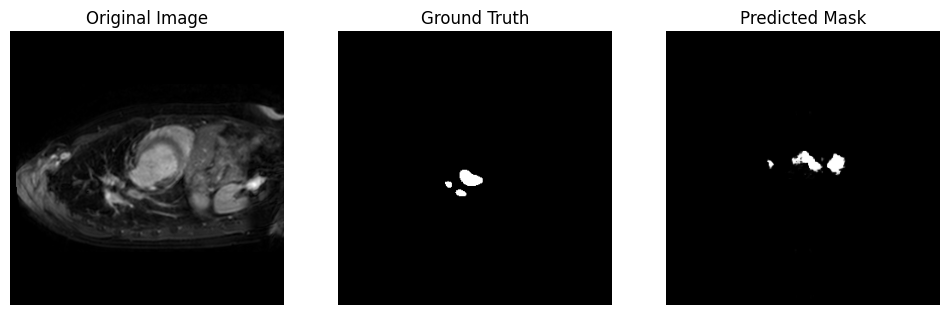

120


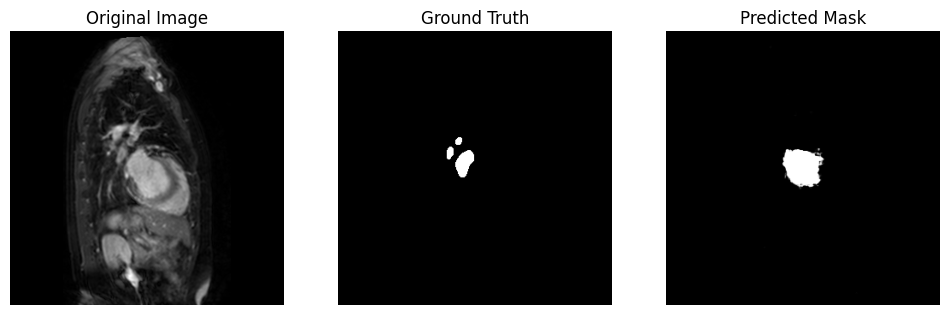

121


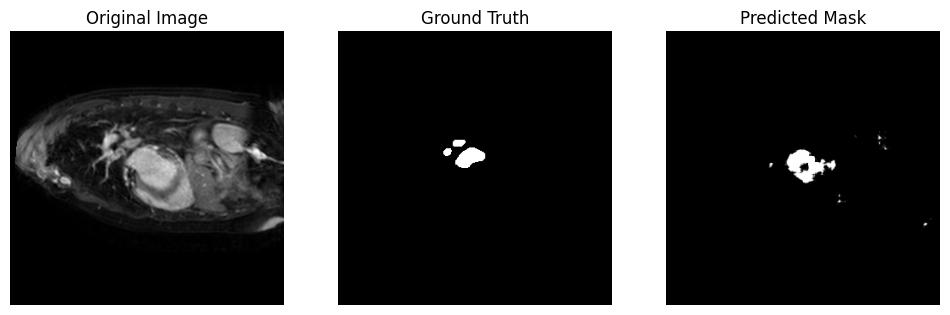

122


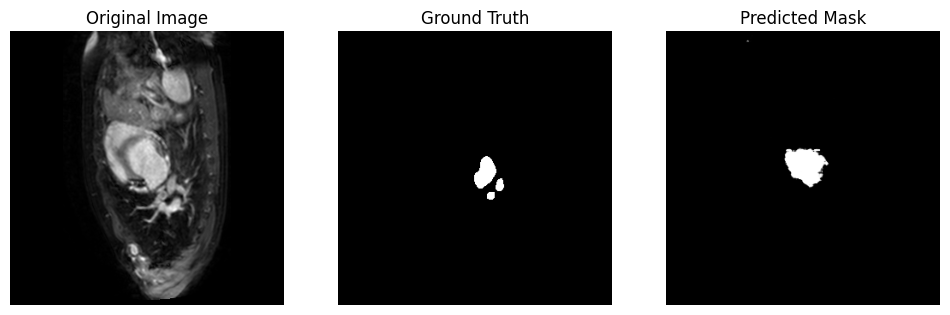

123


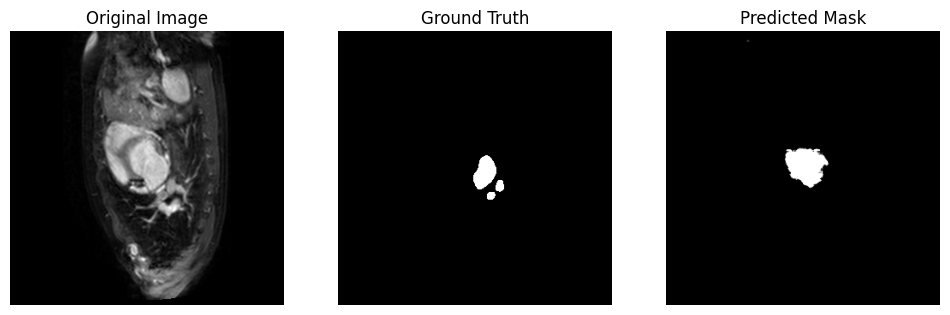

124


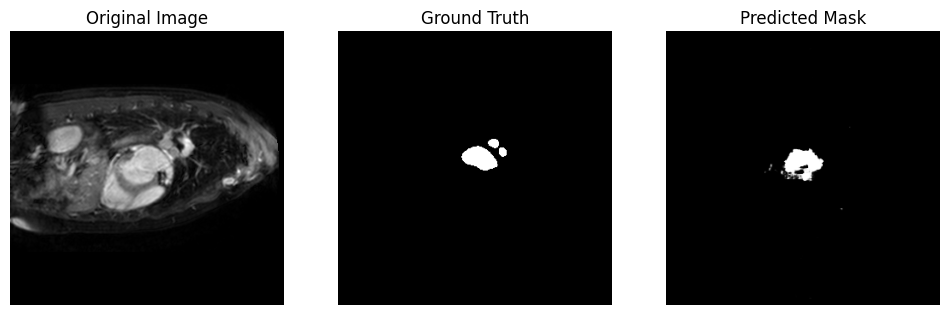

125


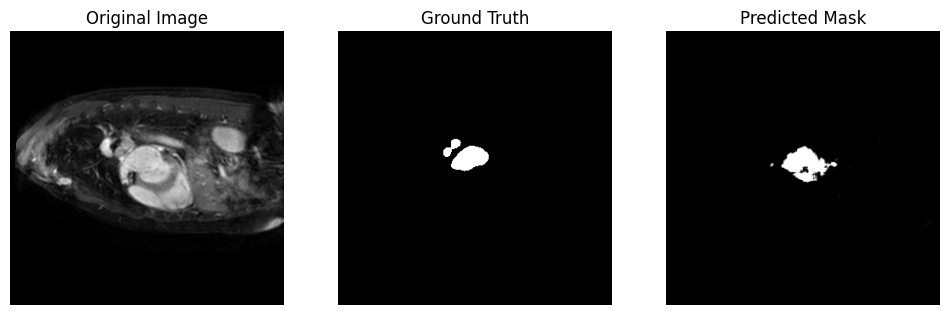

126


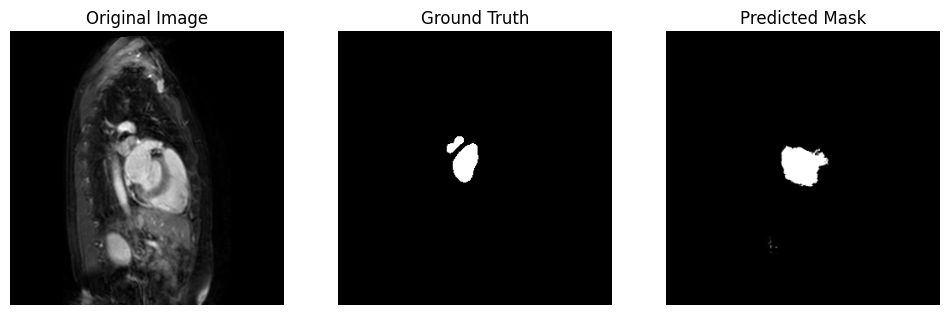

127


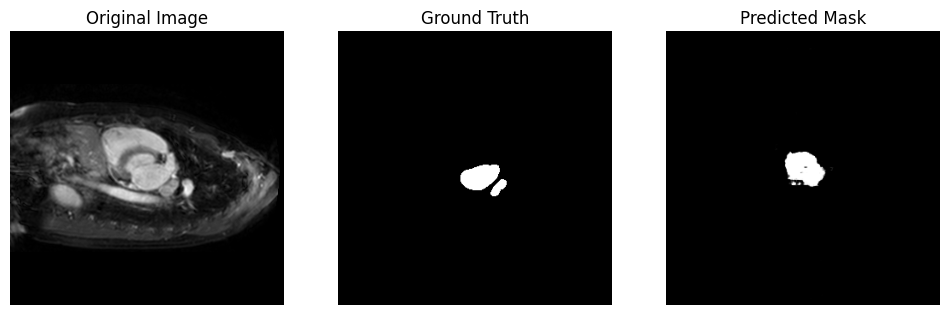

128


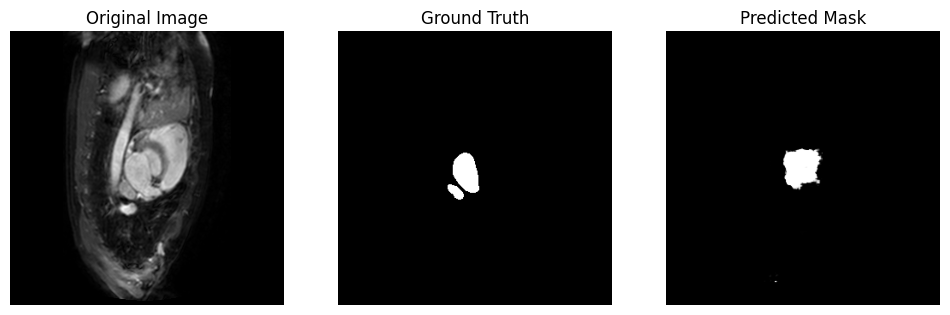

129


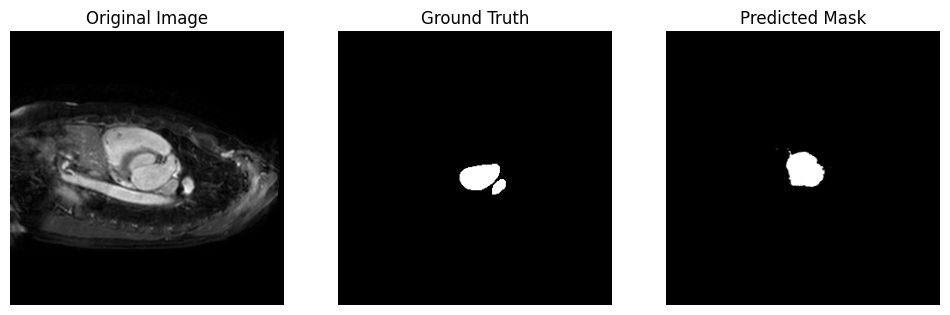

130


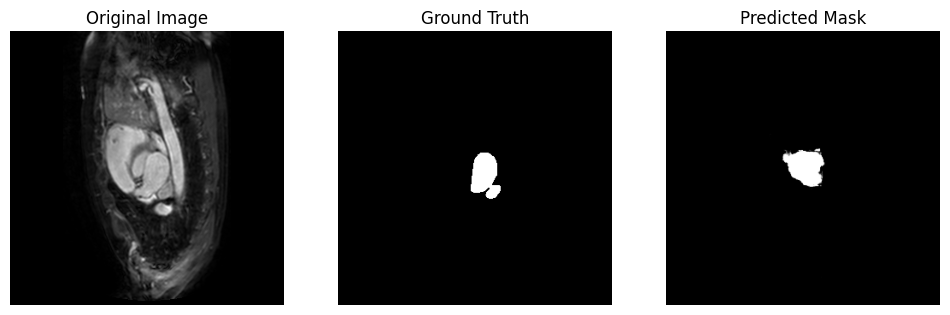

131


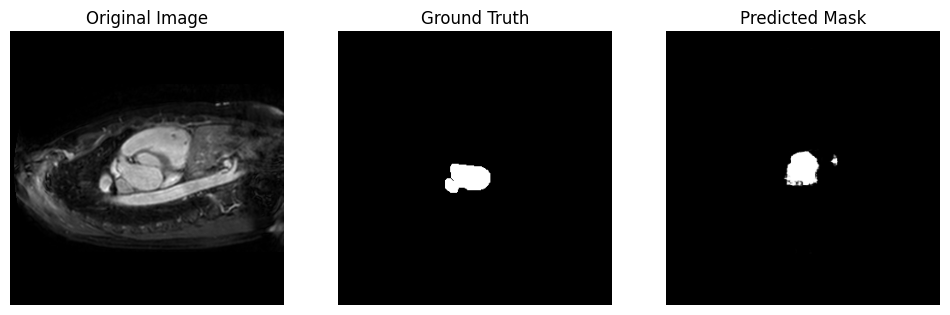

132


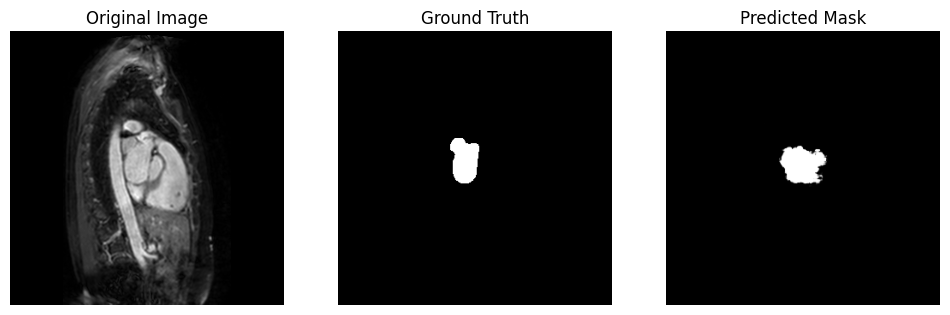

133


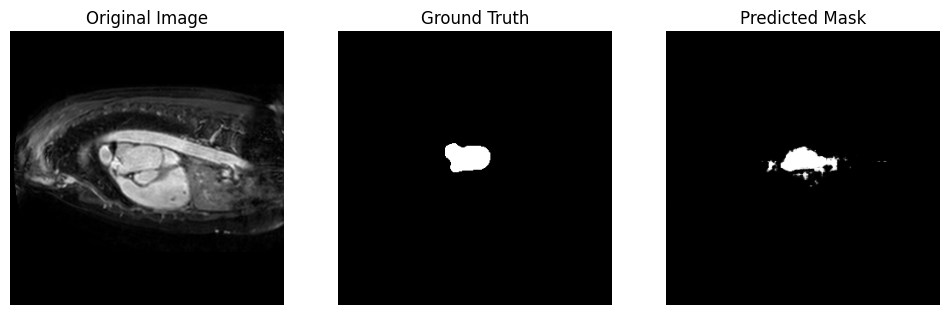

134


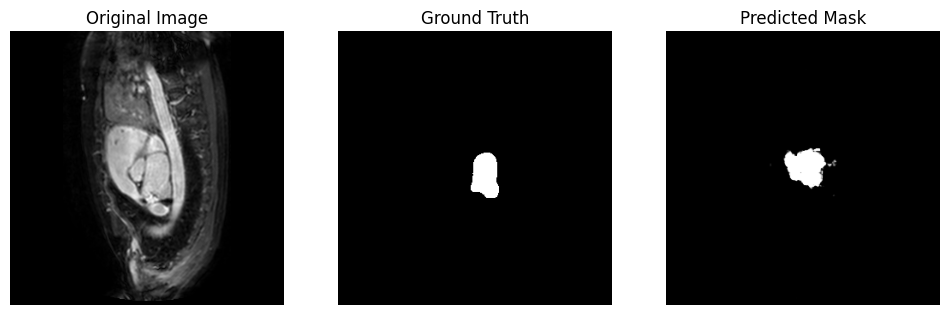

135


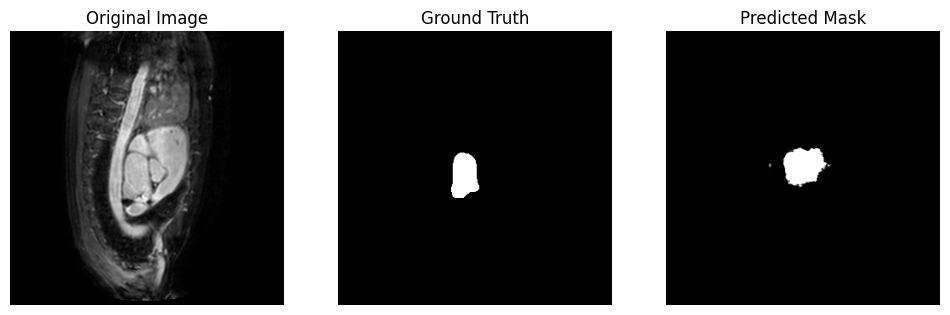

136


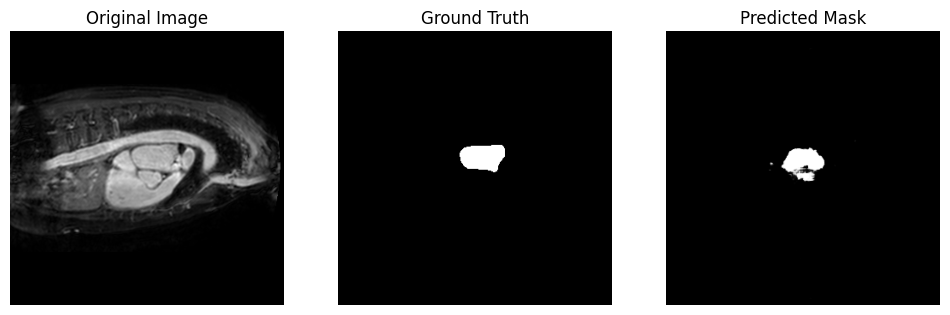

137


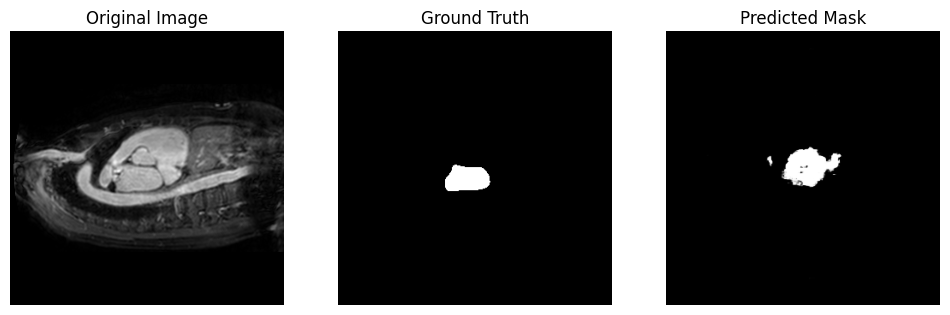

138


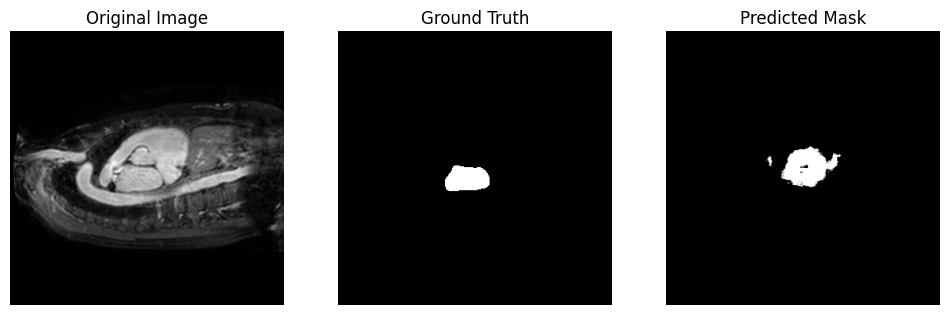

139


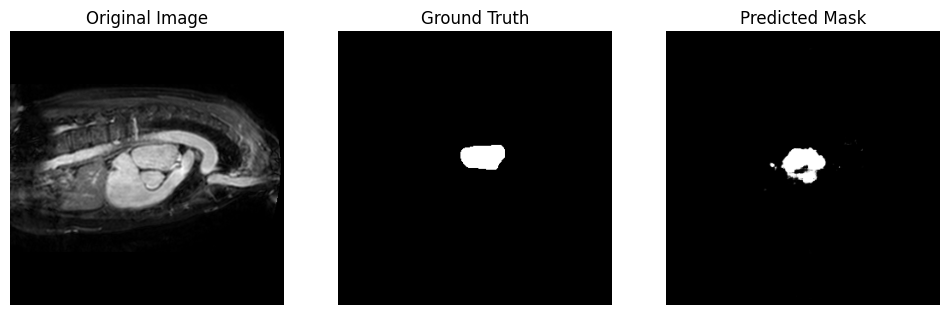

140


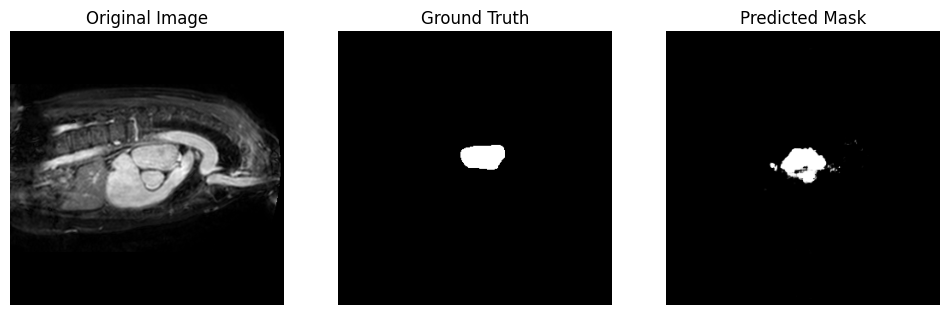

141


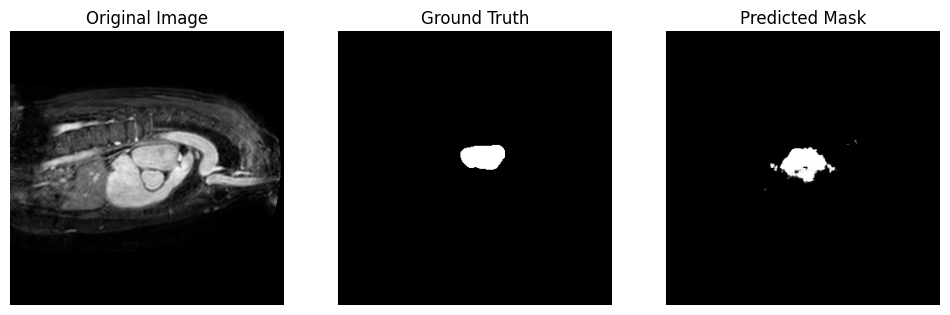

142


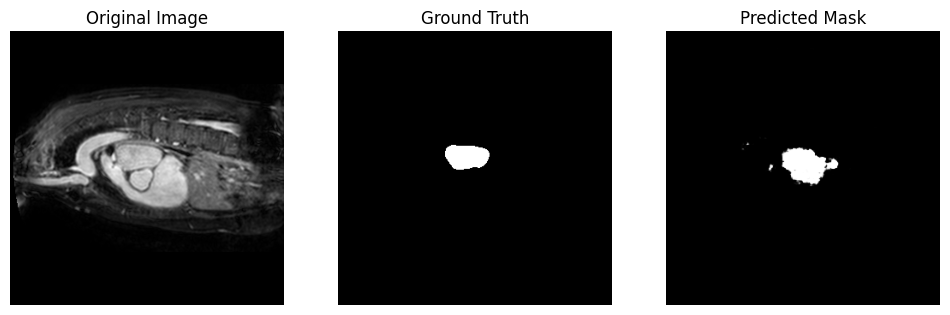

143


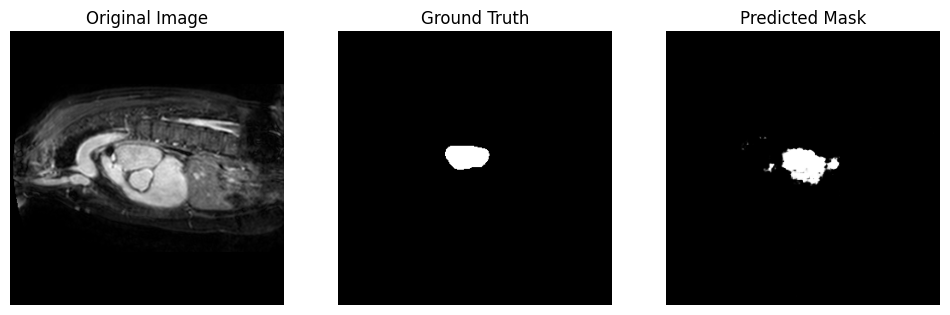

144


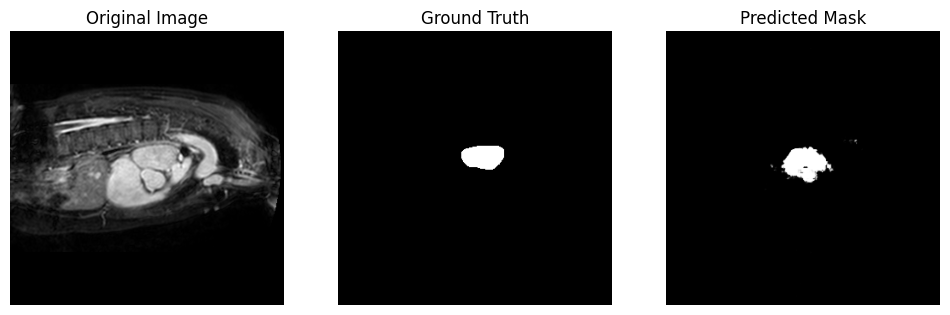

145


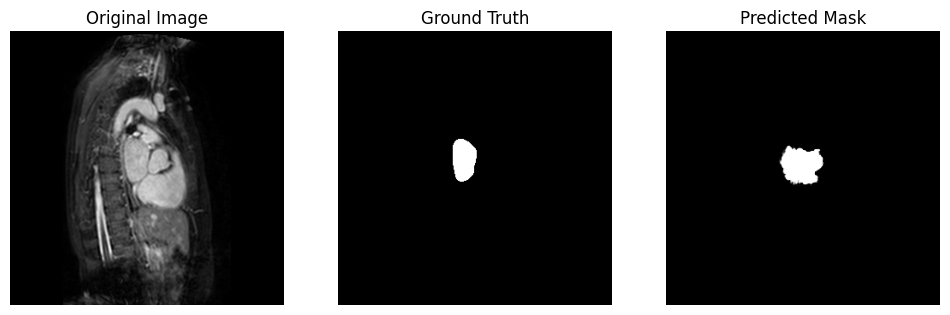

146


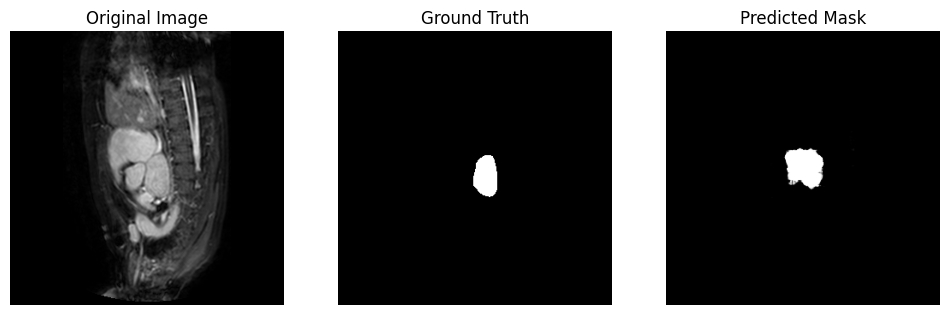

147


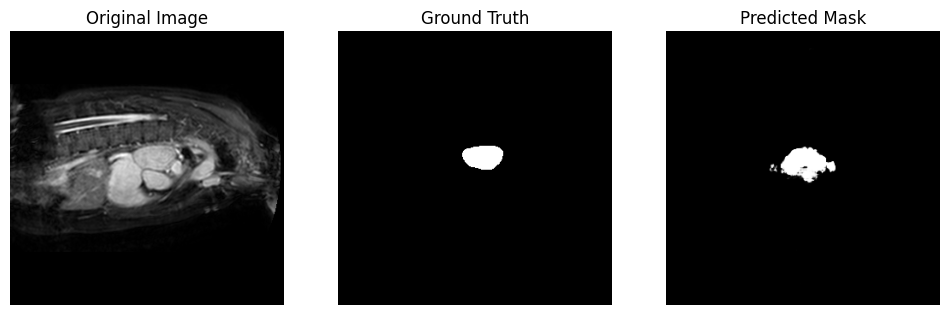

148


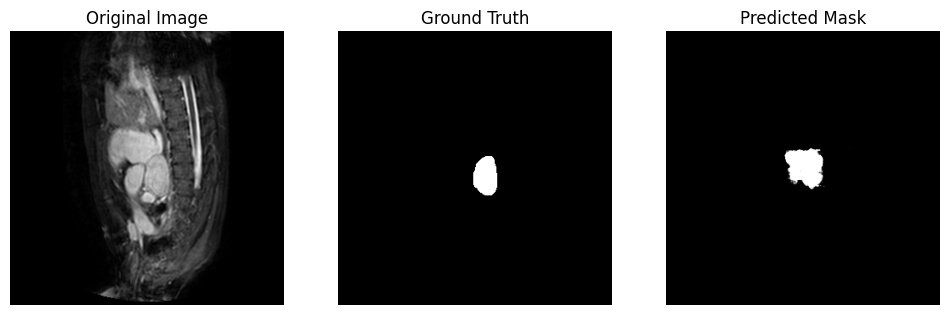

149


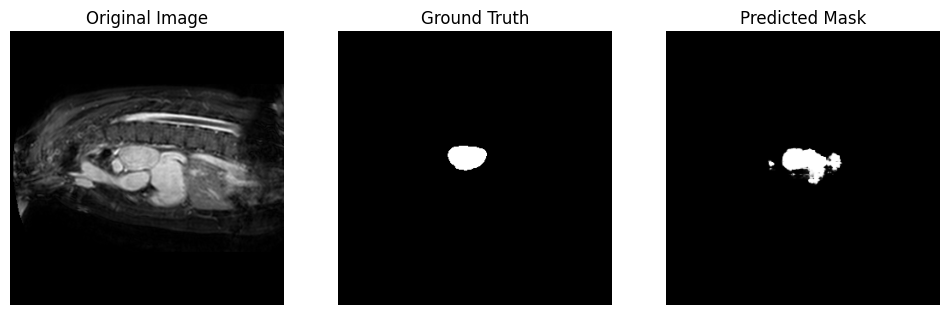

150


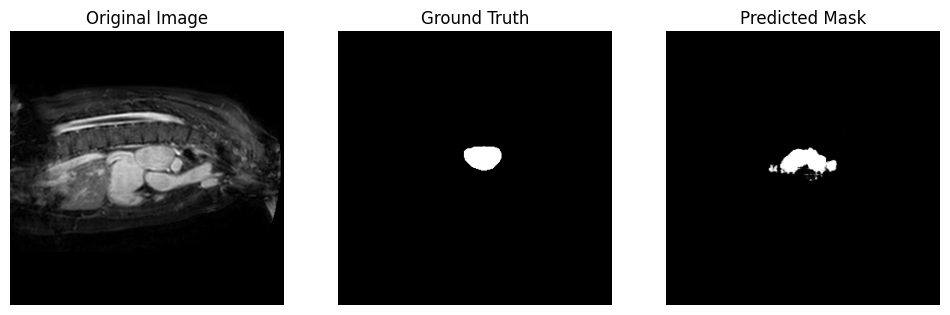

151


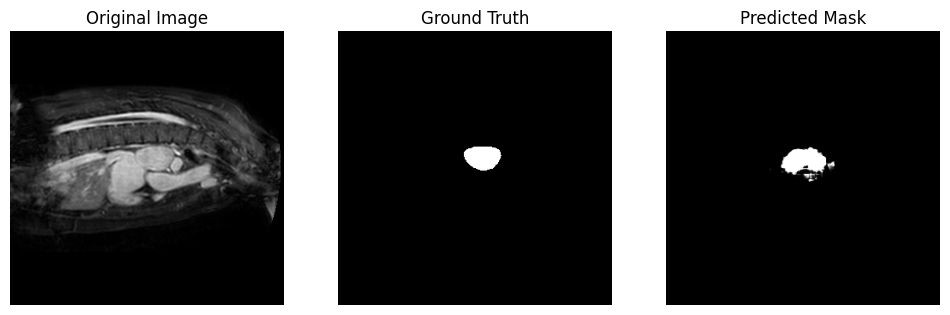

152


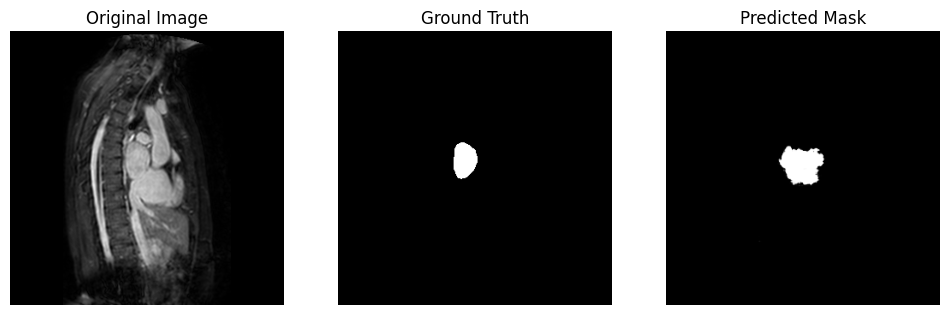

153


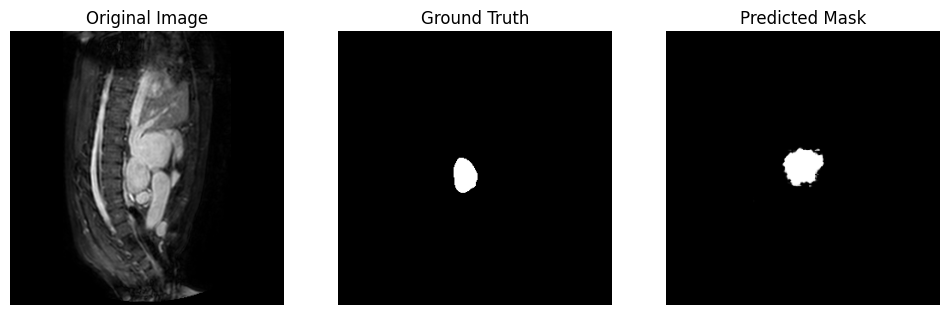

154


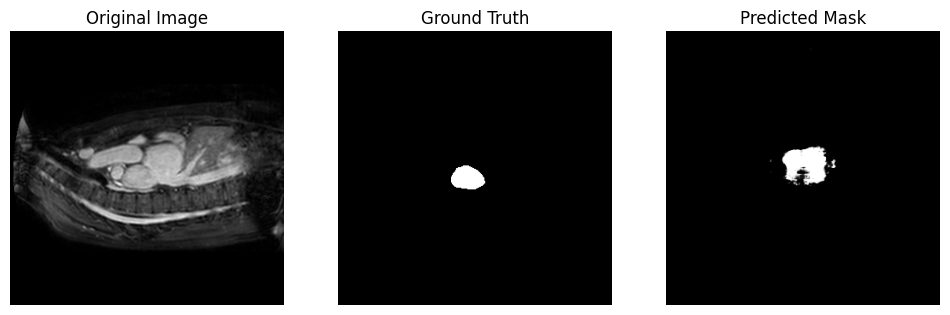

155


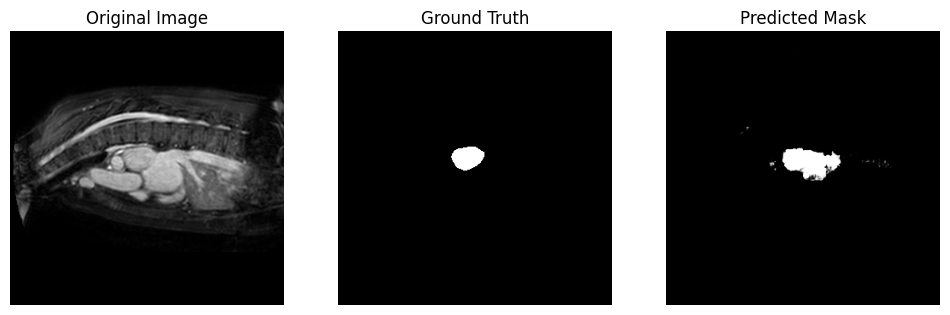

156


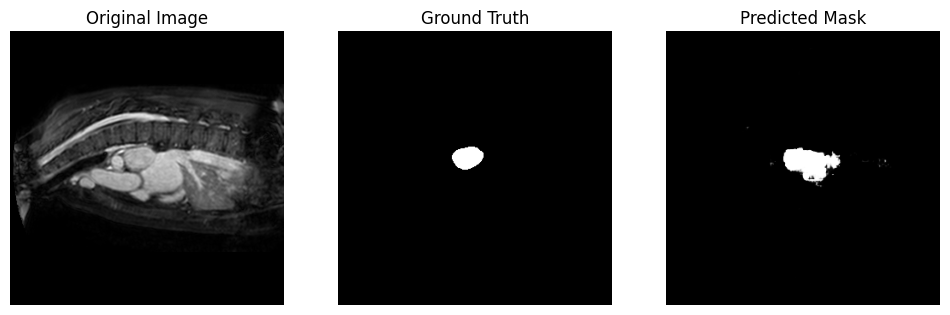

157


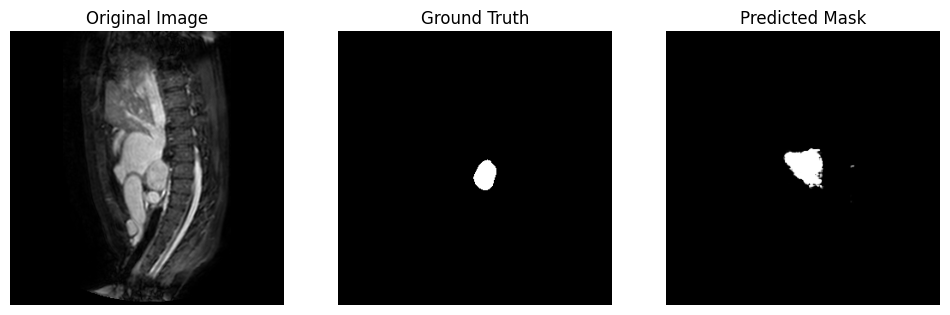

158


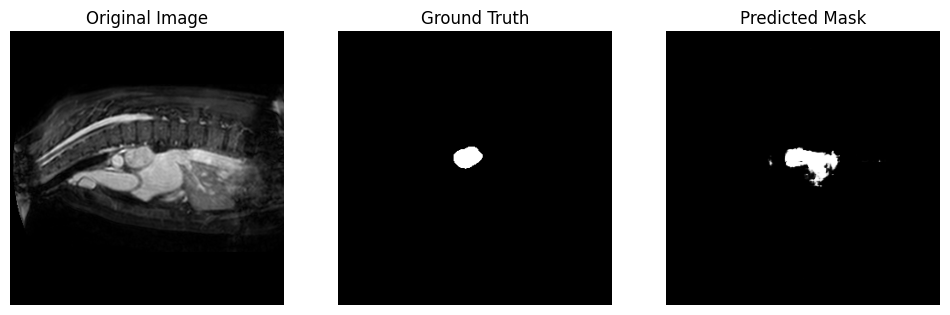

159


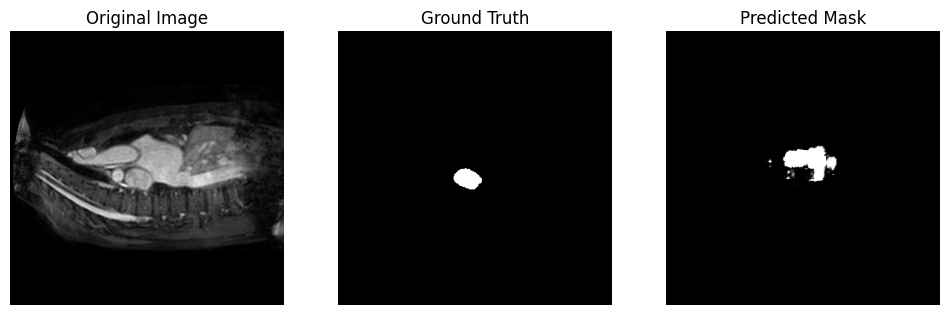

160


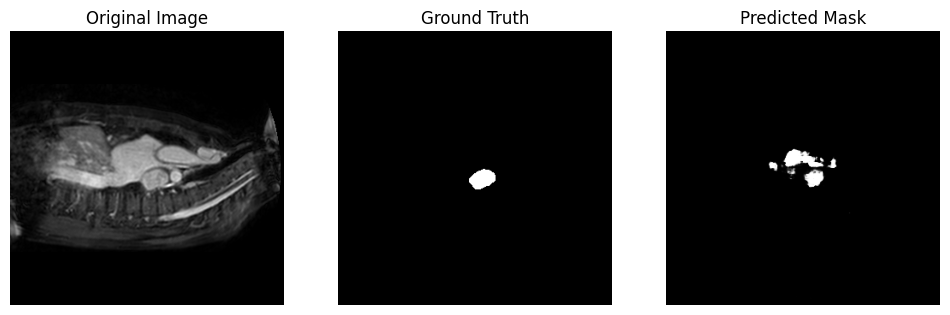

161


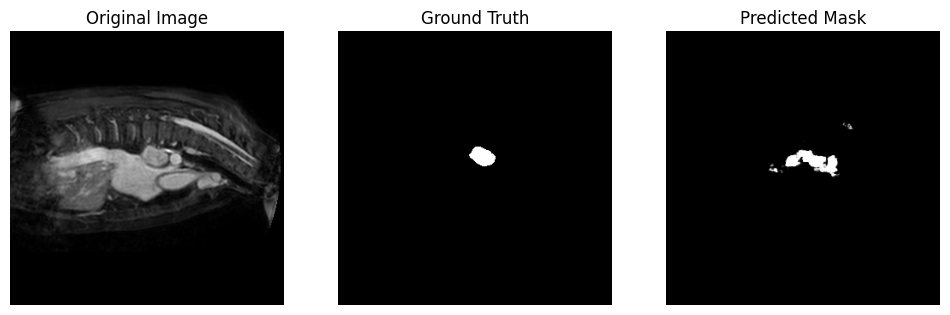

162


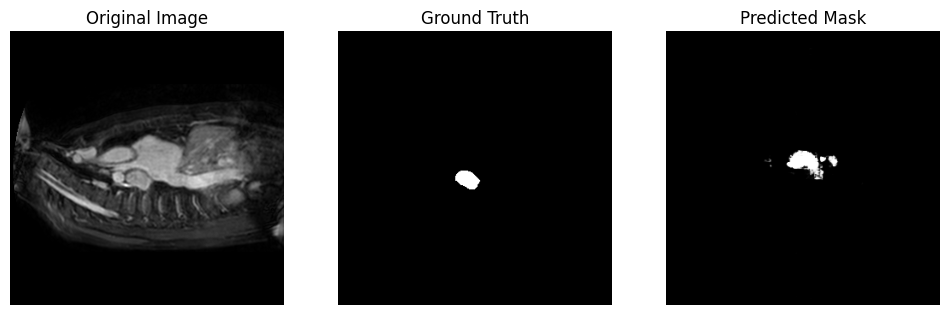

163


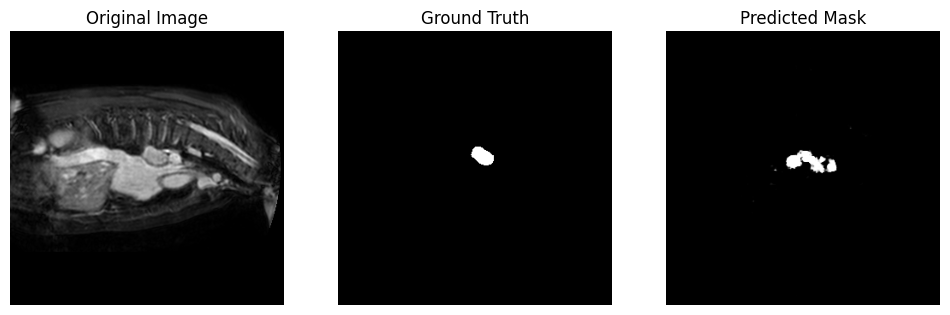

164


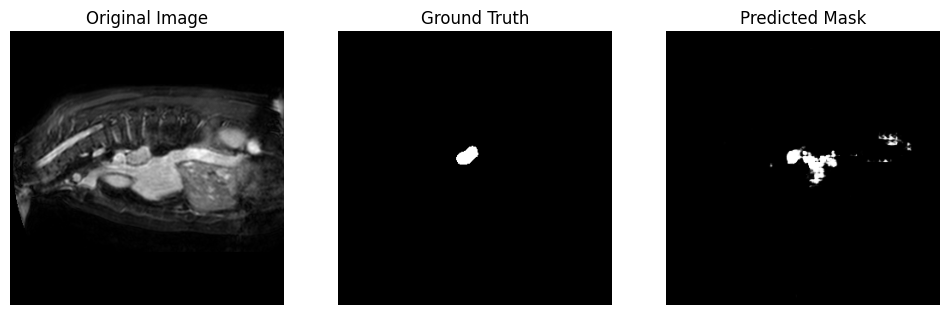

165


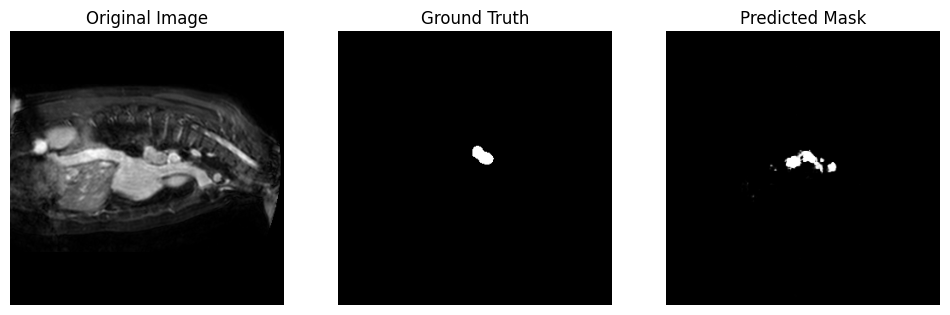

166


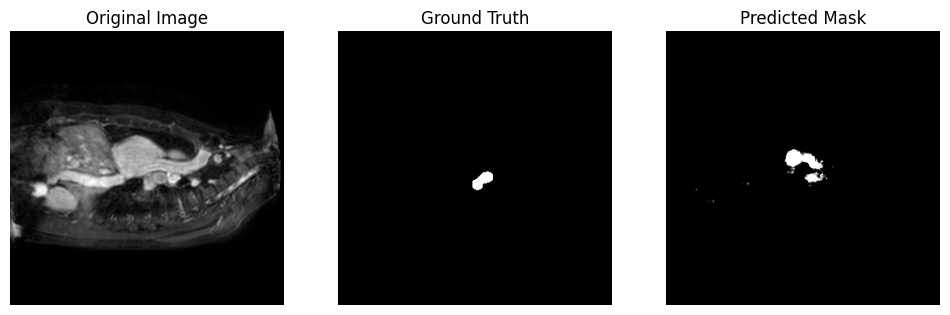

167


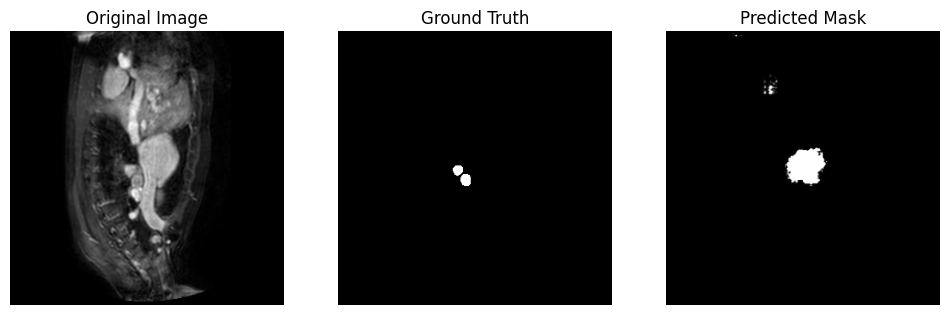

168


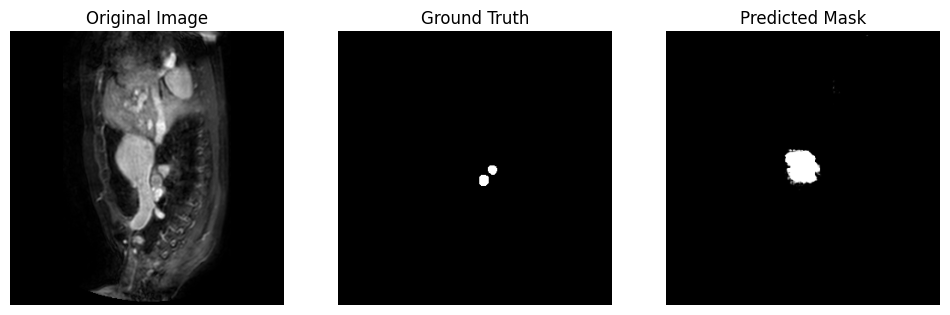

169


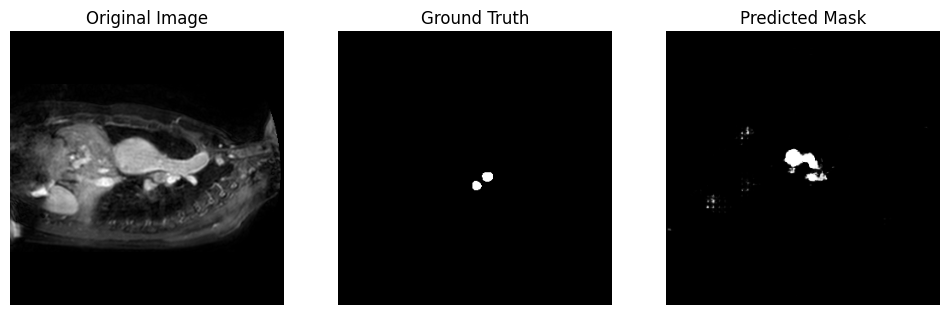

170


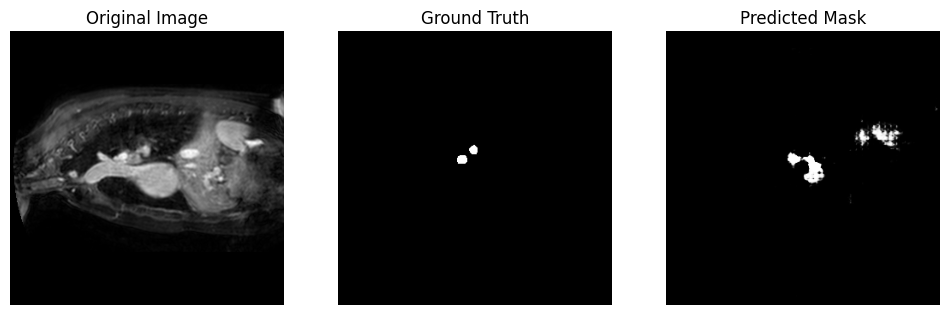

171


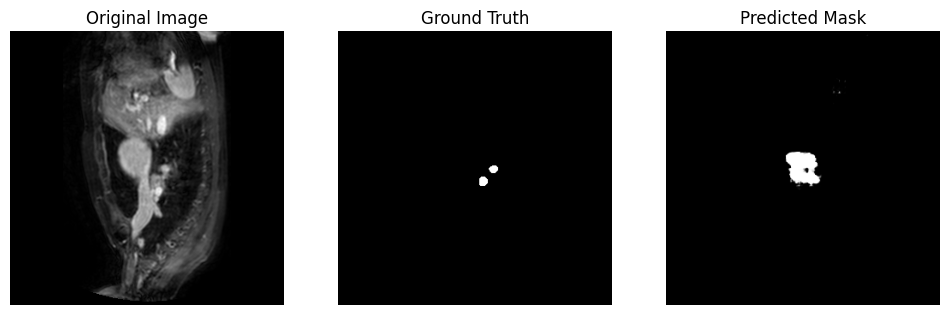

172


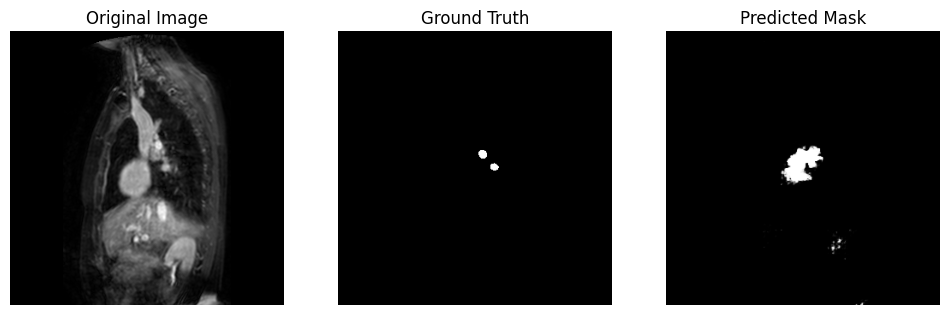

173


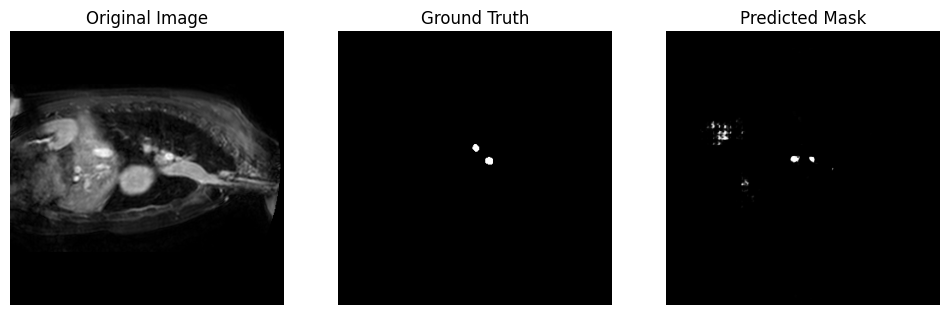

174


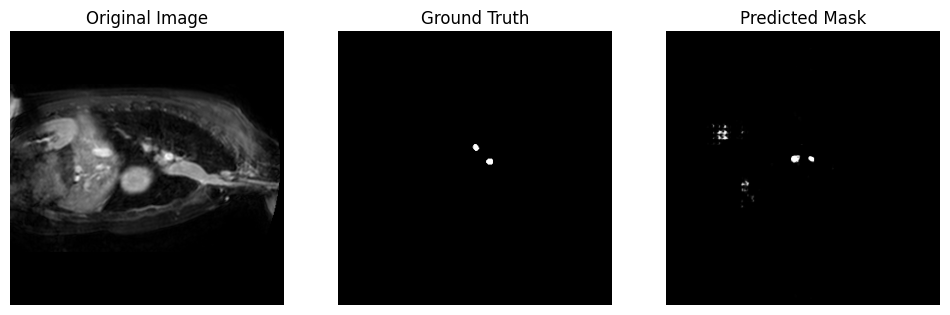

175


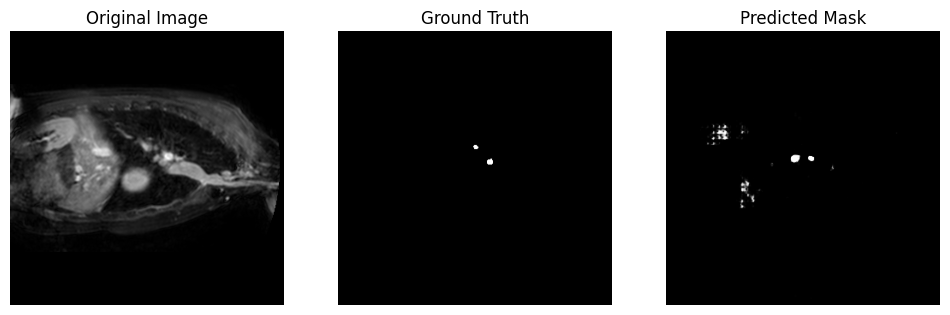

176


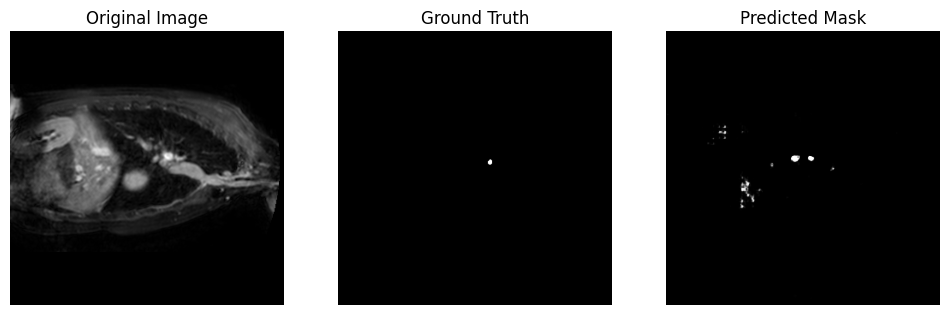

177


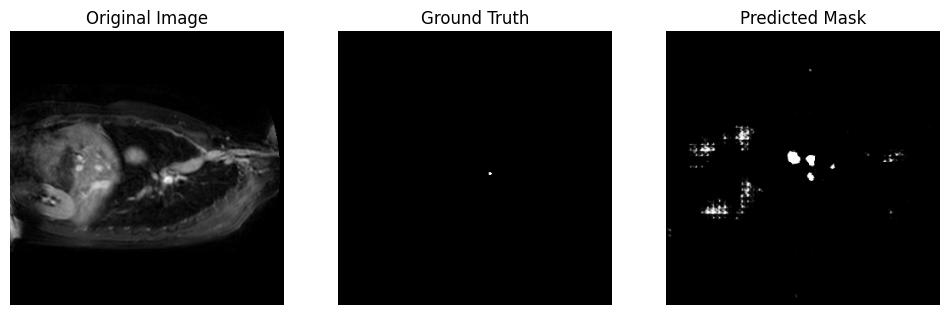

178


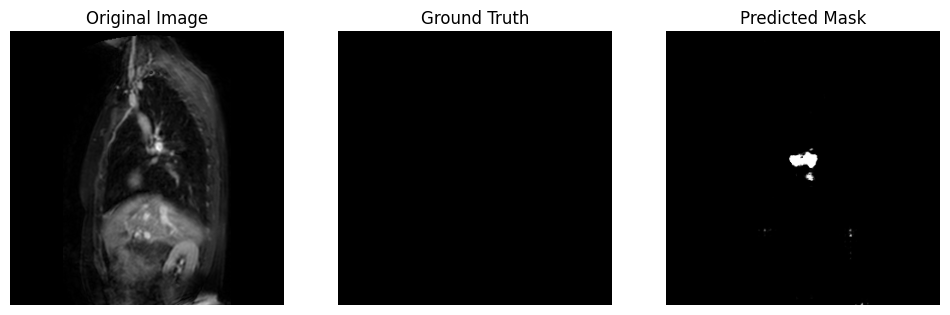

179


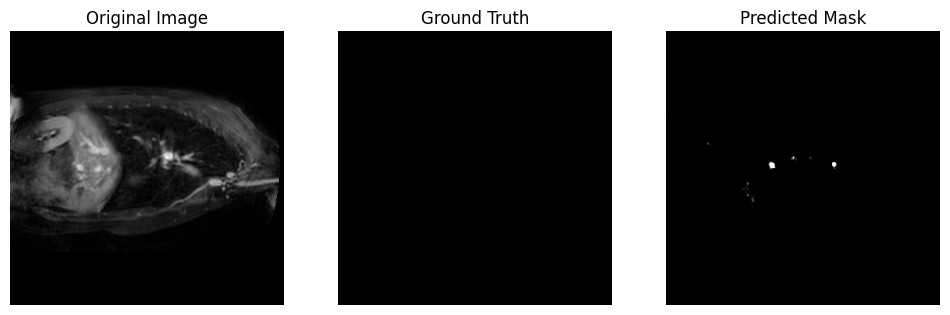

180


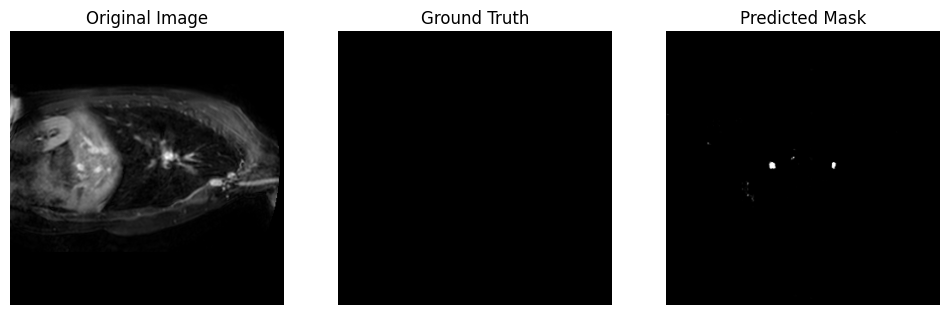

181


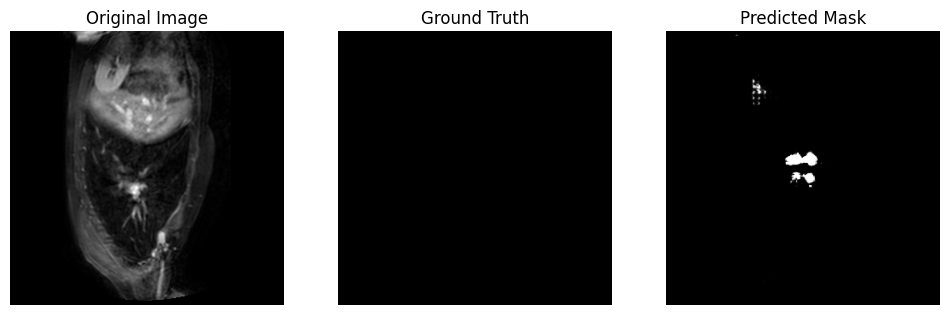

182


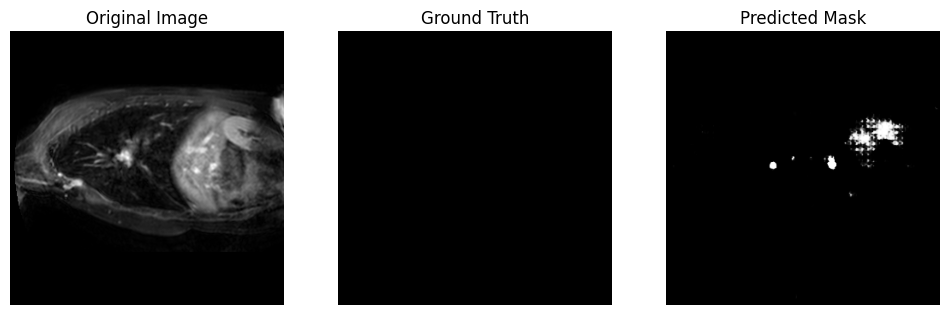

183


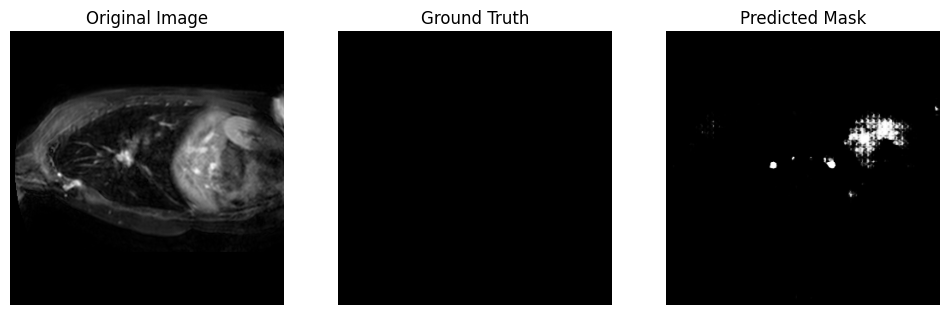

184


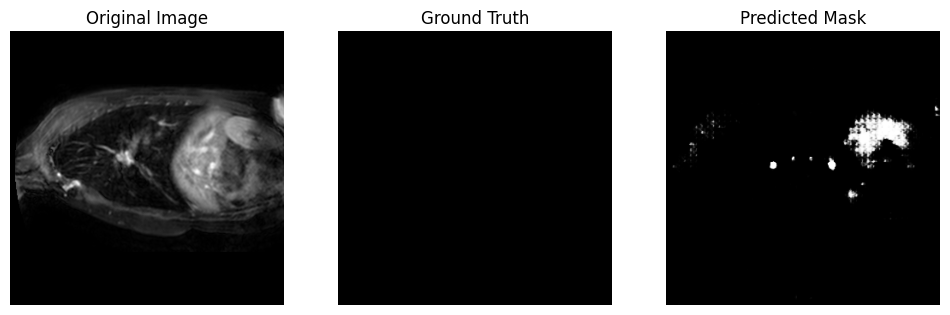

185


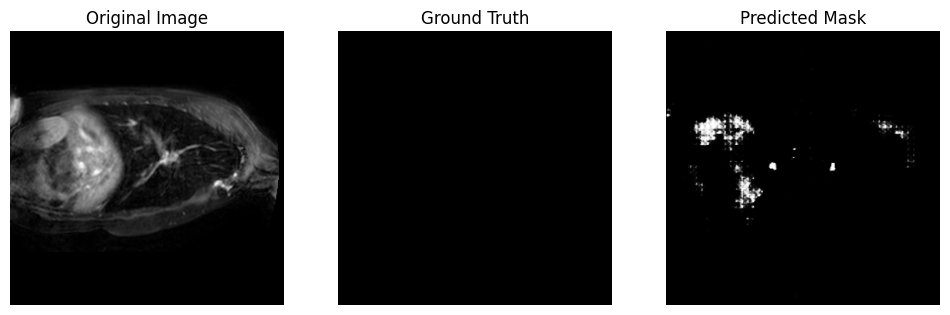

186


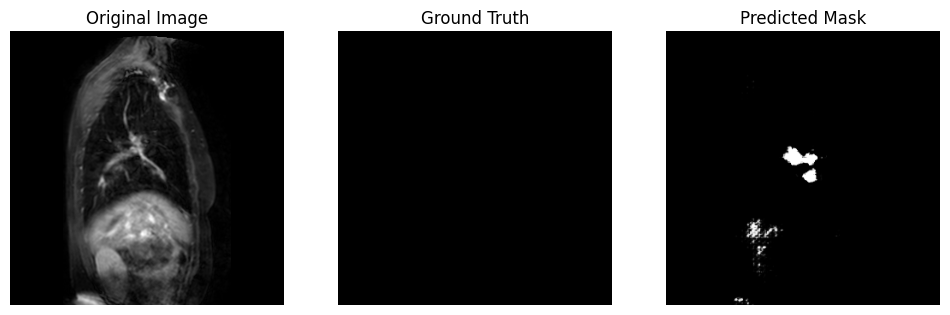

187


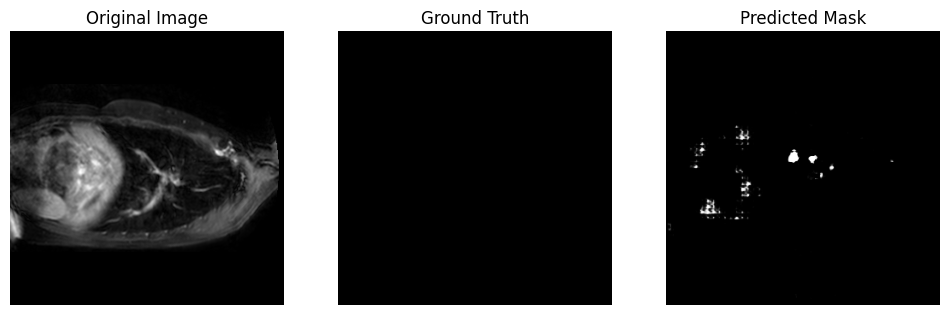

188


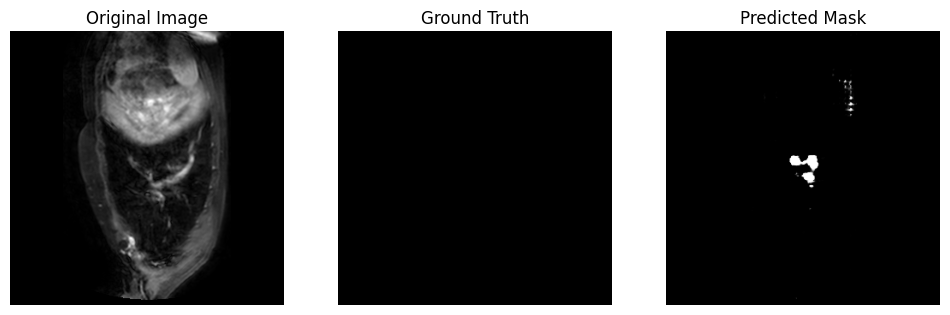

189


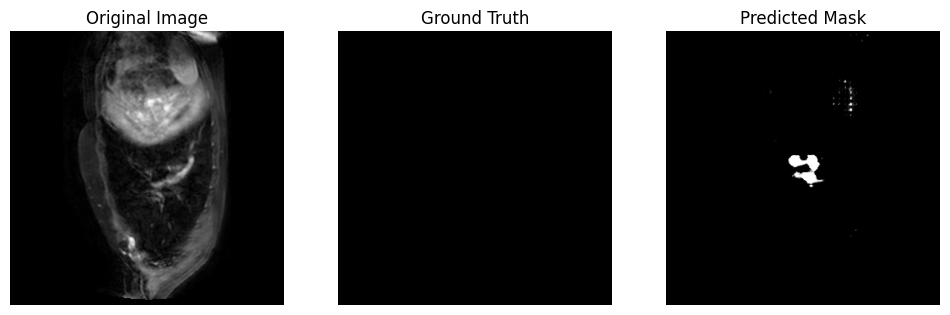

190


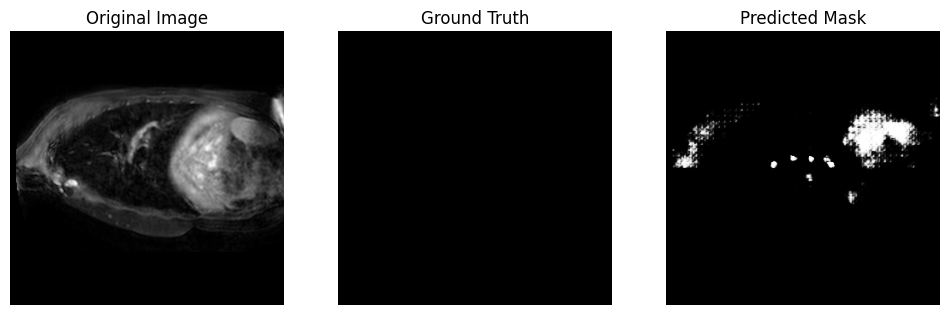

191


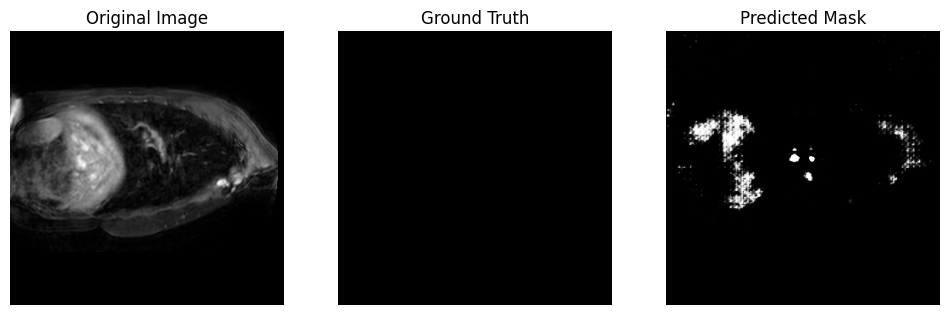

192


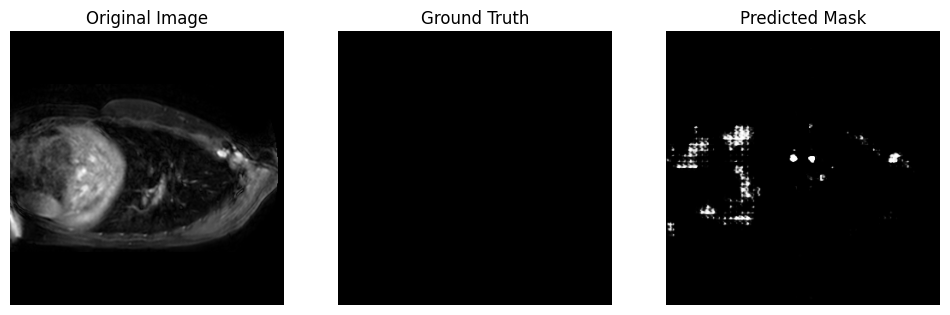

193


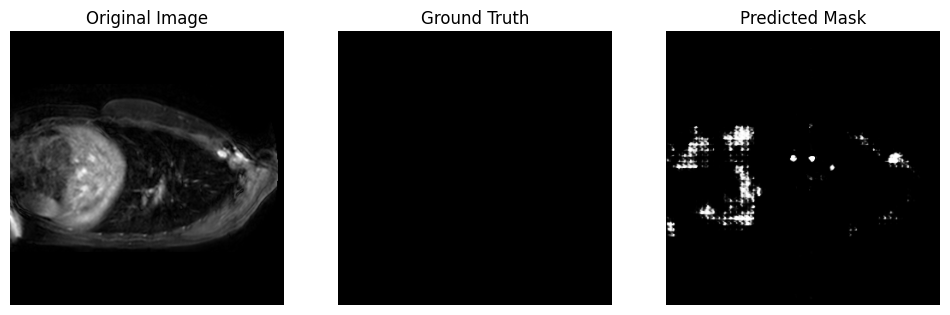

194


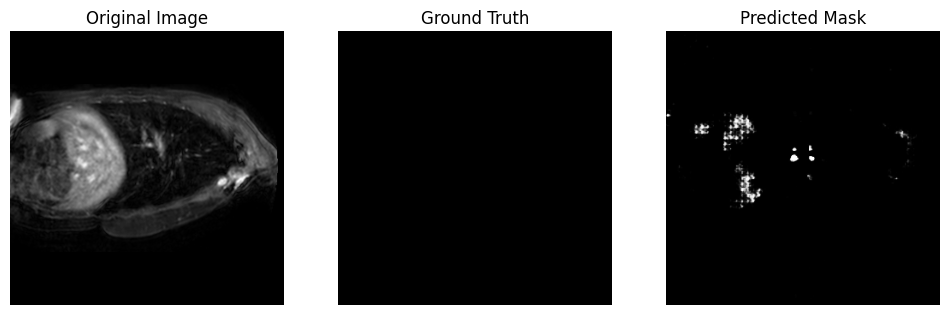

195


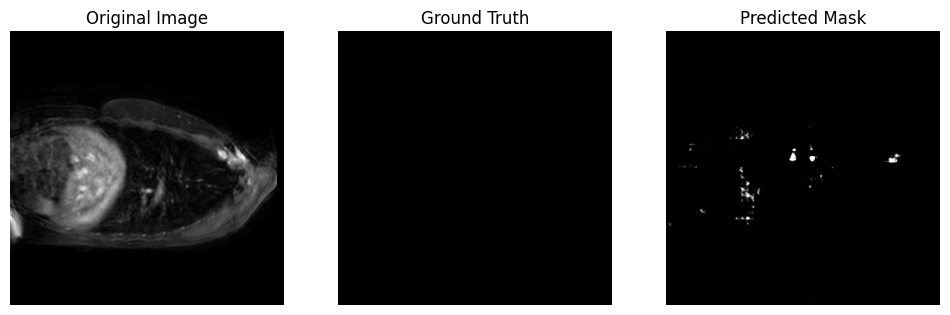

196


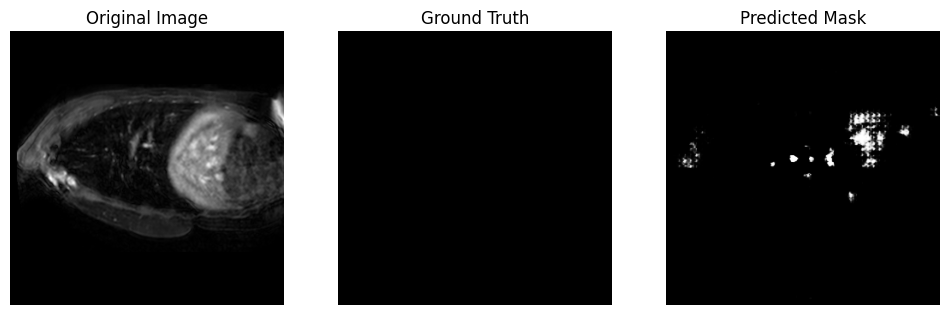

197


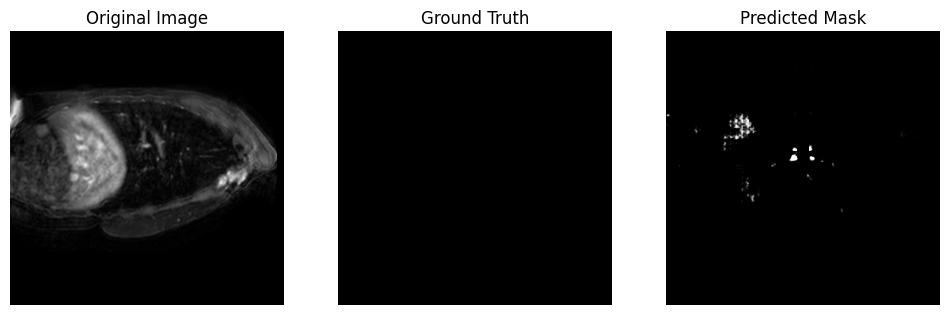

198


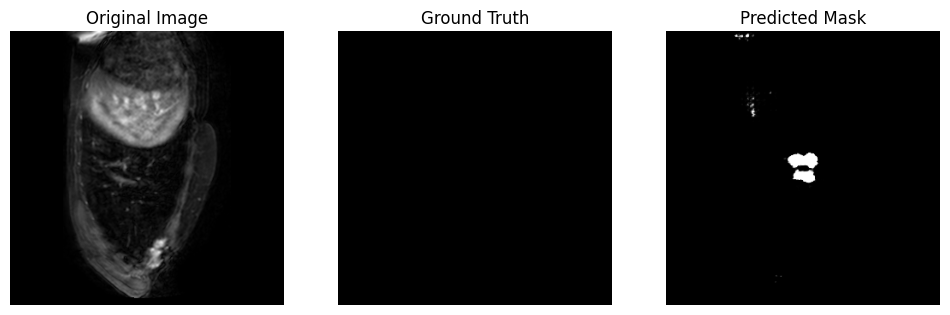

199


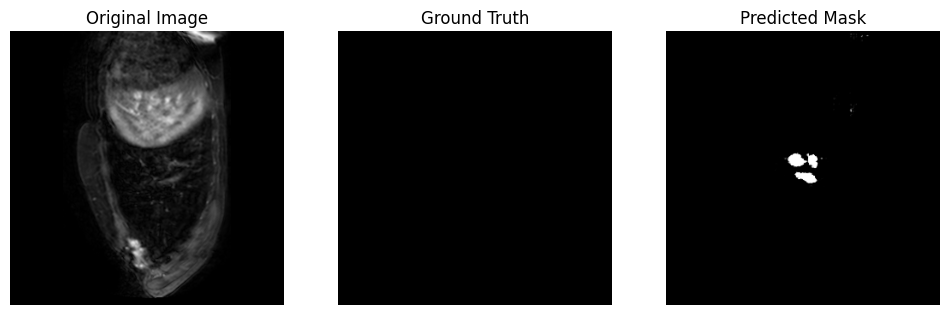

200


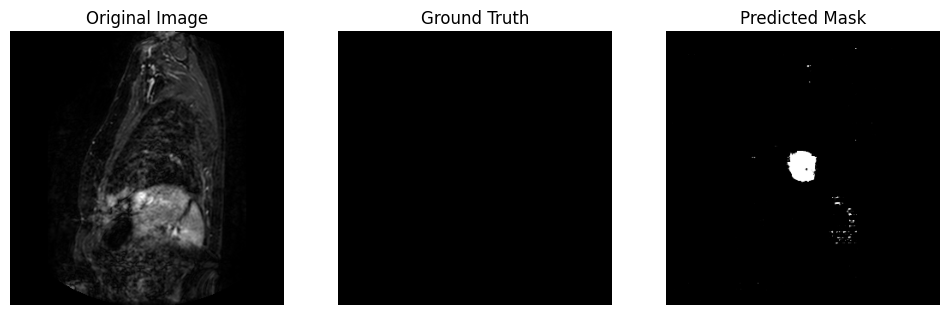

201


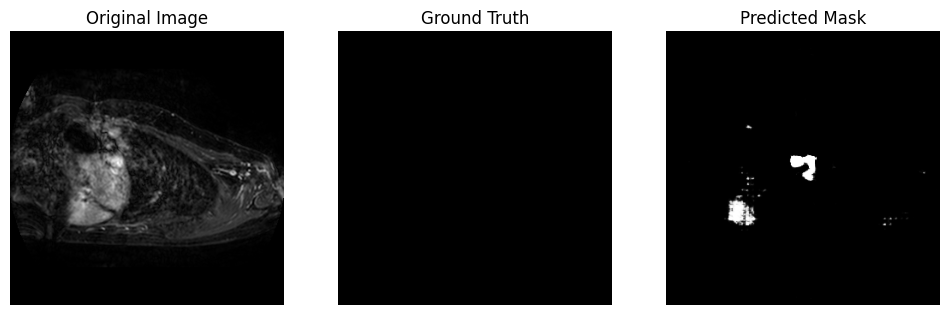

202


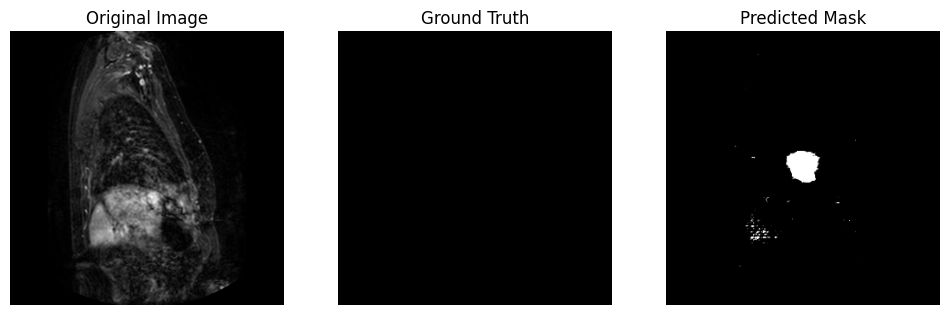

203


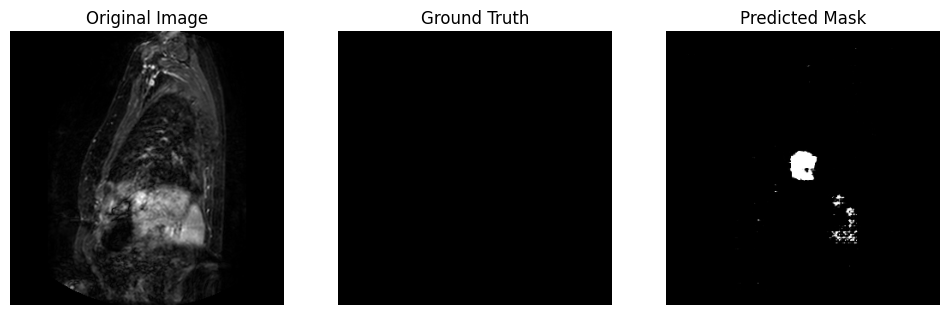

204


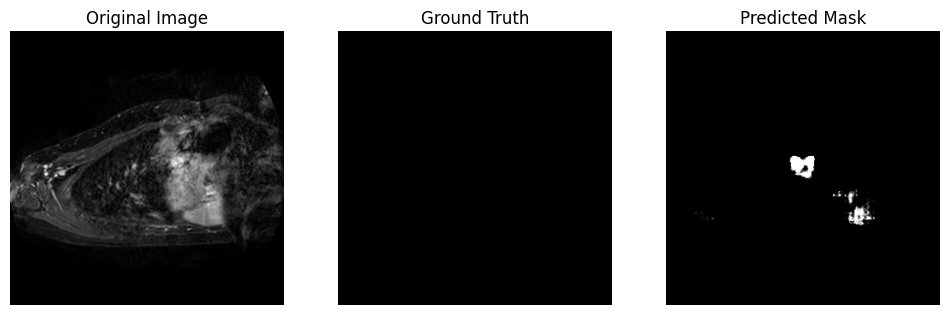

205


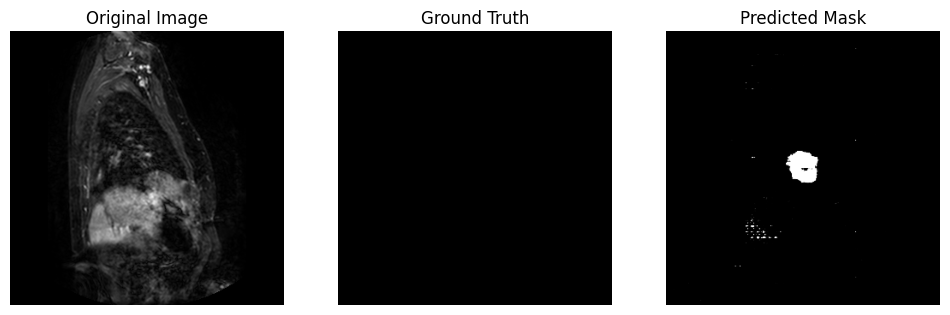

206


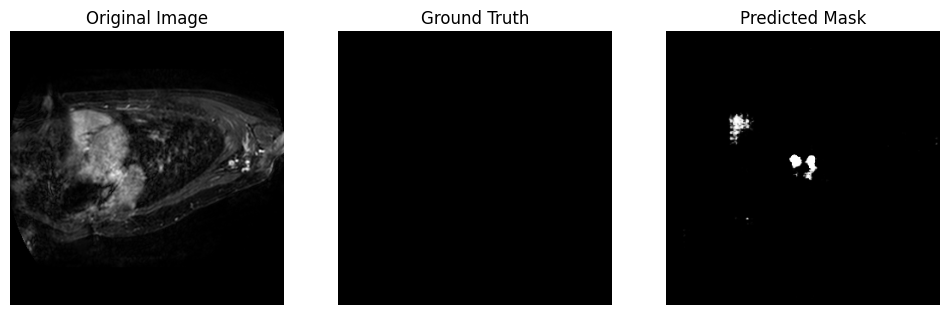

207


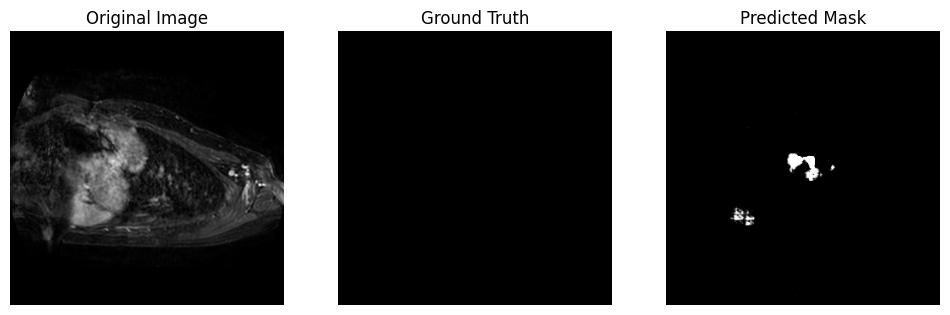

208


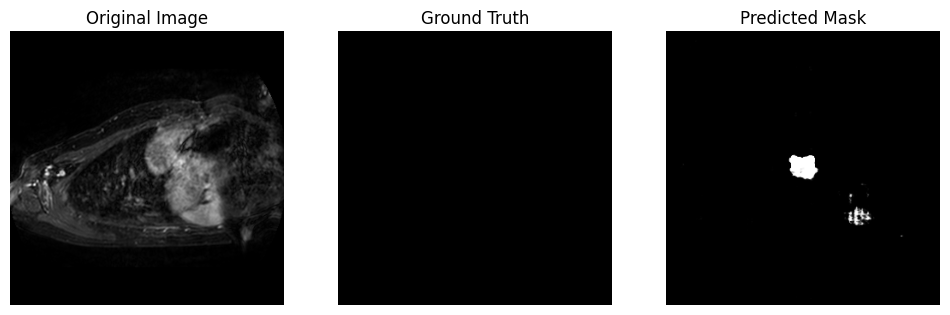

209


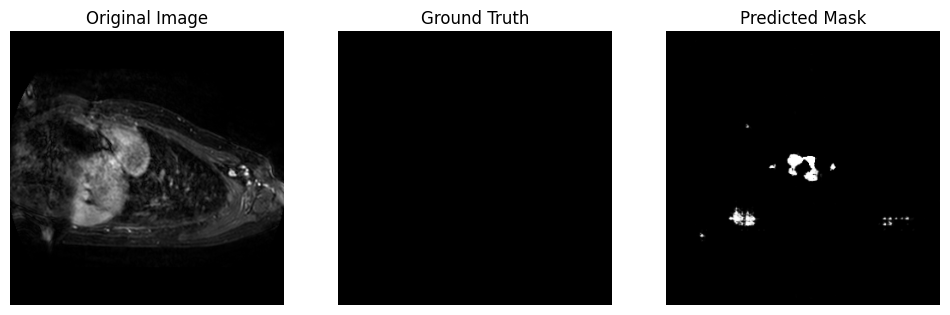

210


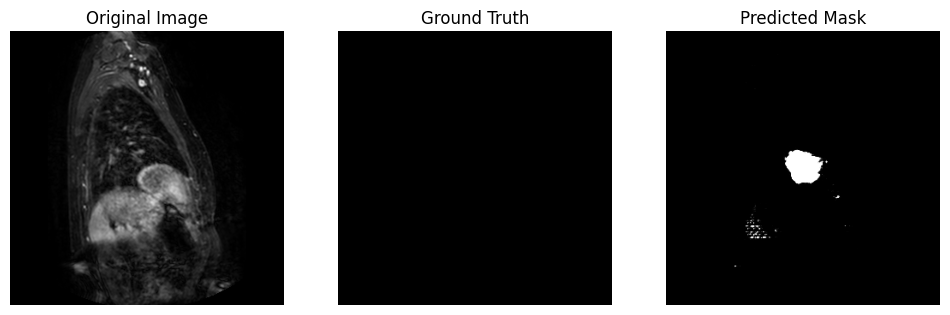

211


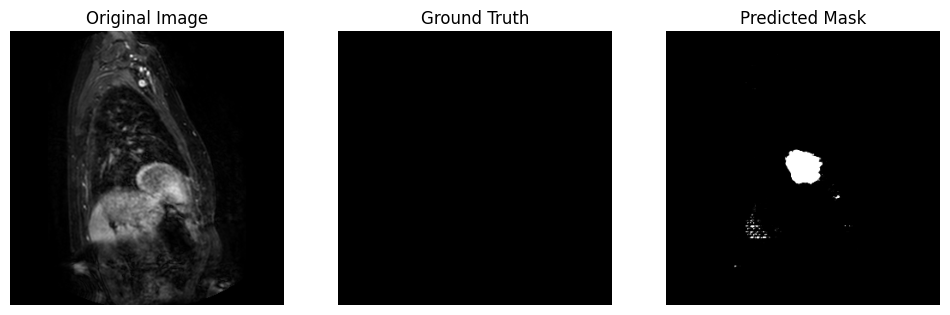

212


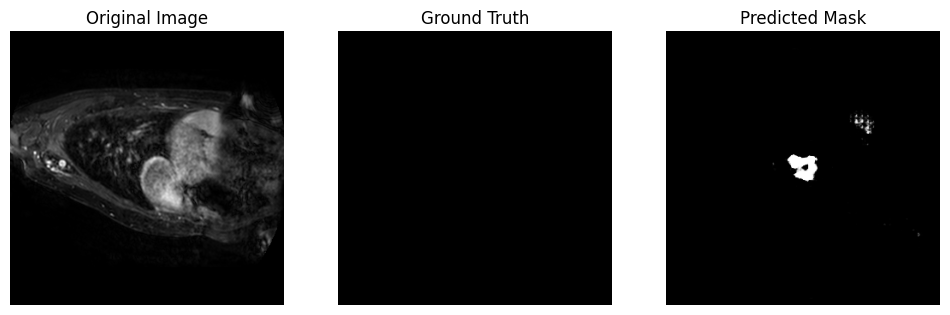

213


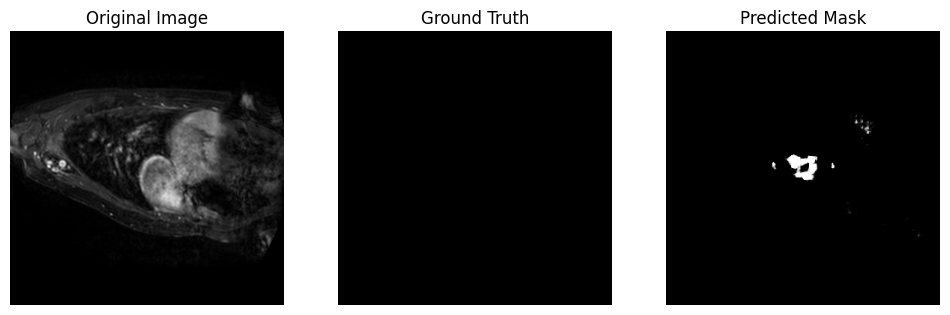

214


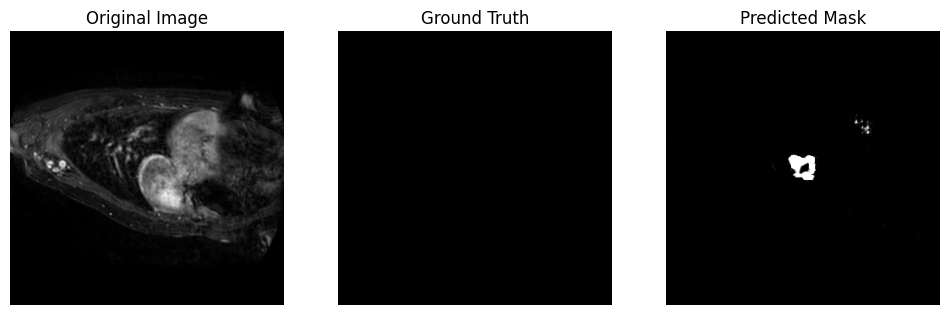

215


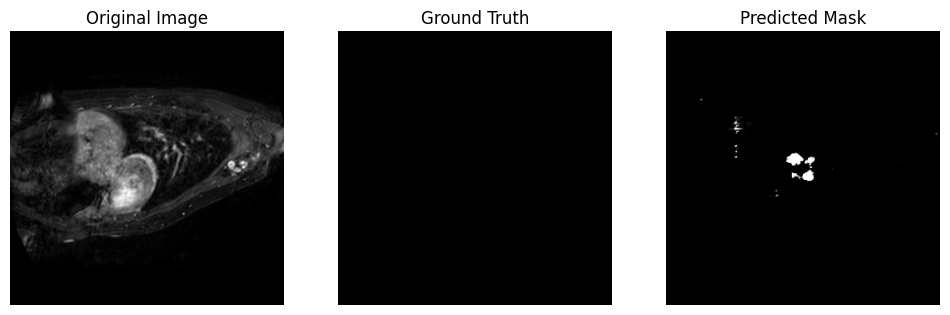

216


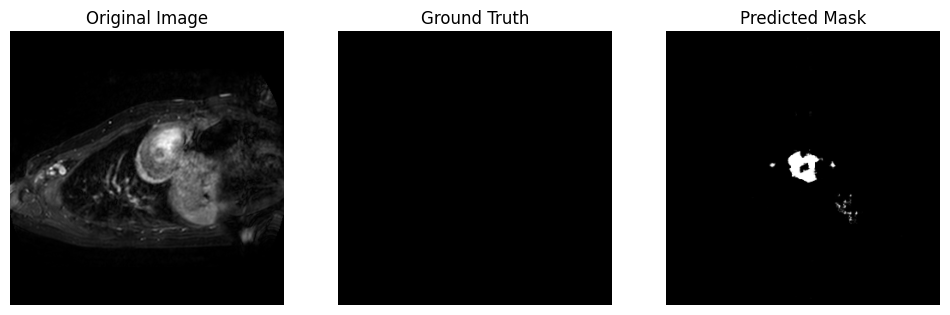

217


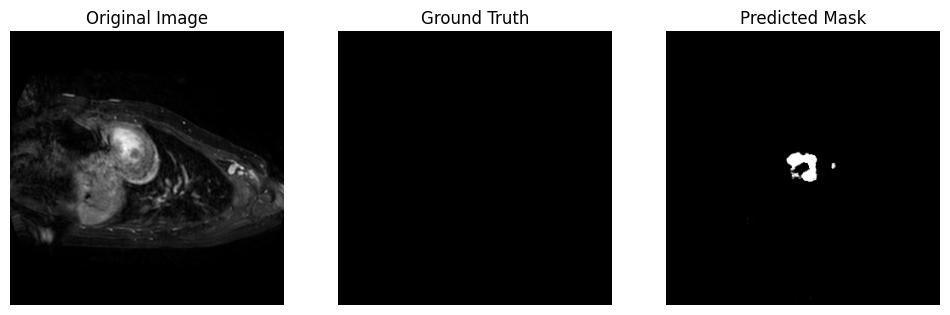

218


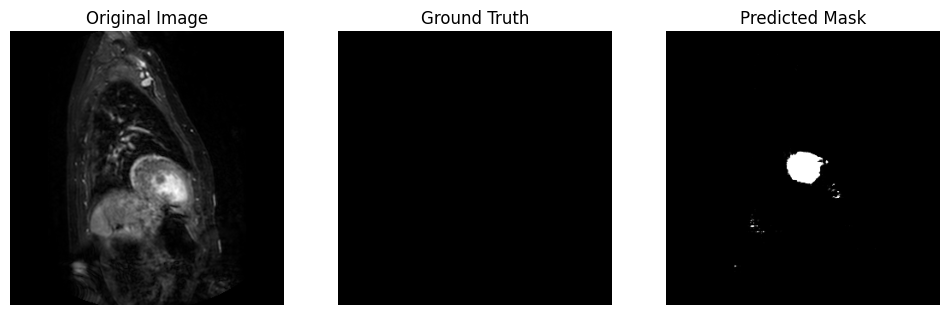

219


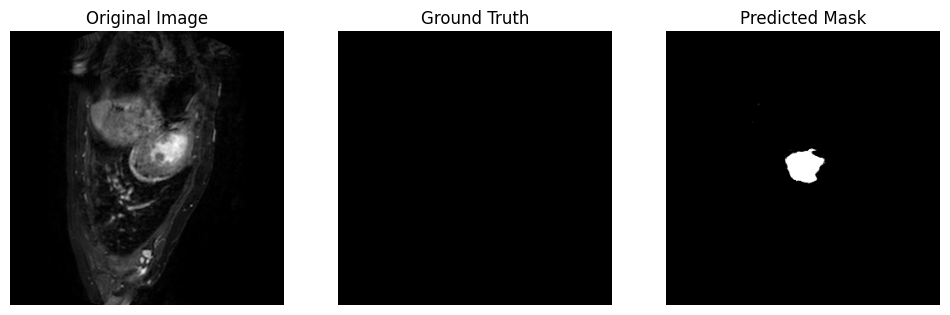

220


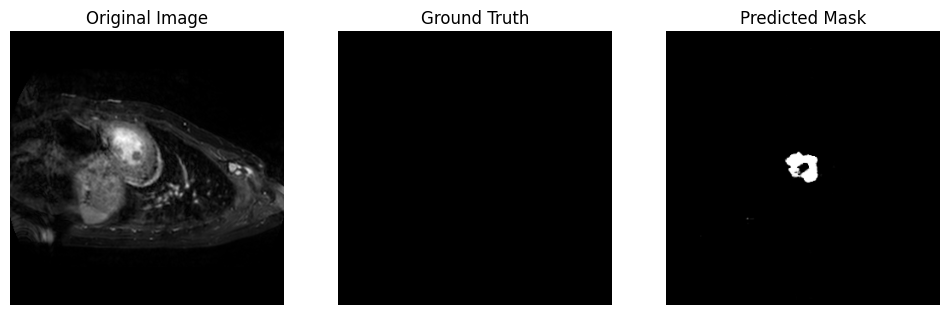

221


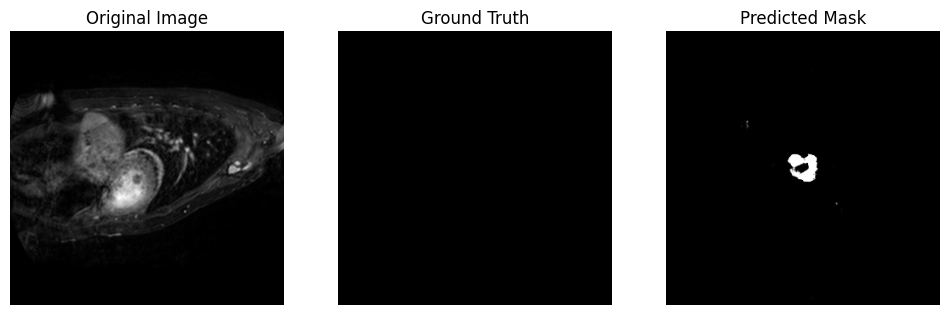

222


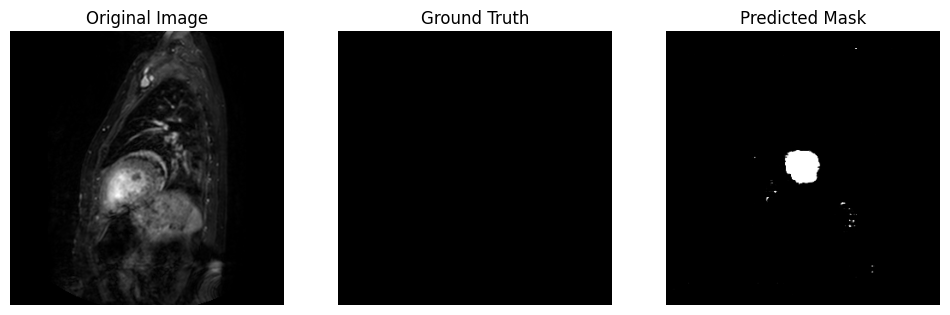

223


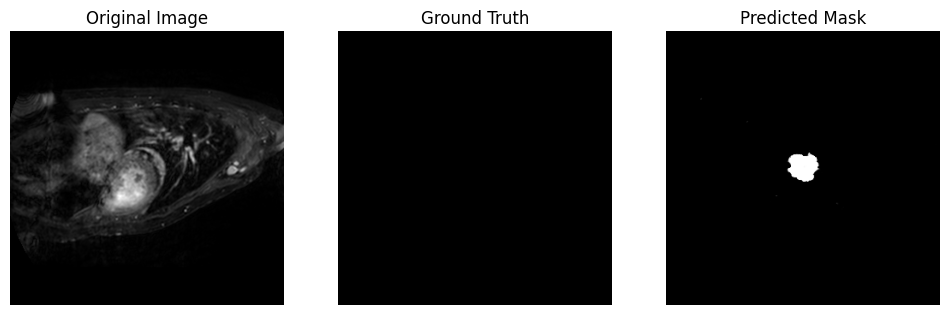

224


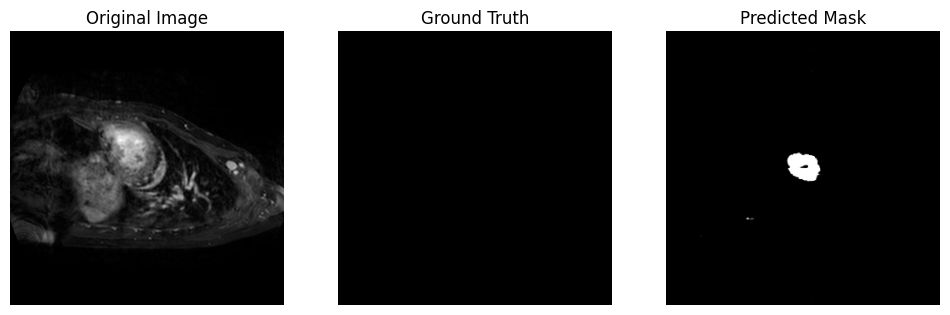

225


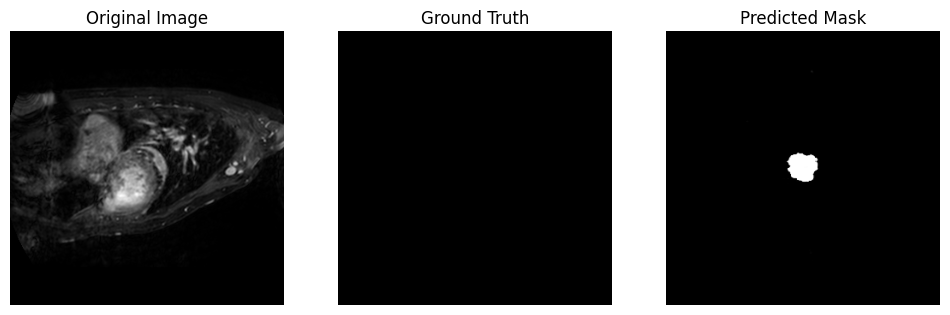

226


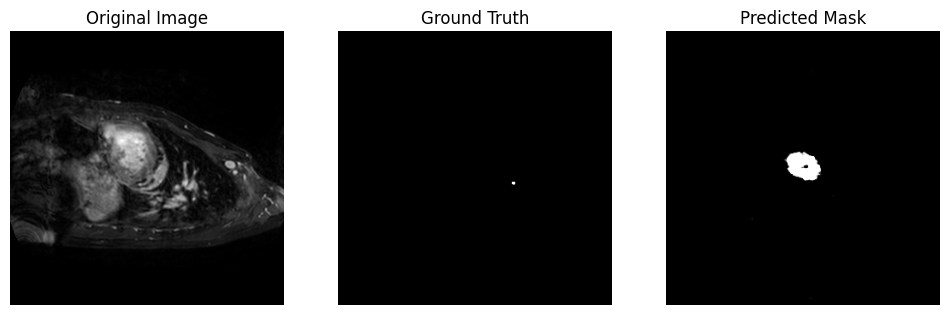

227


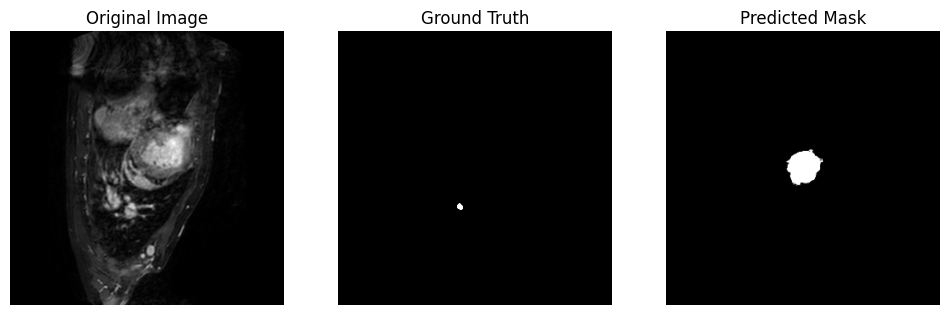

228


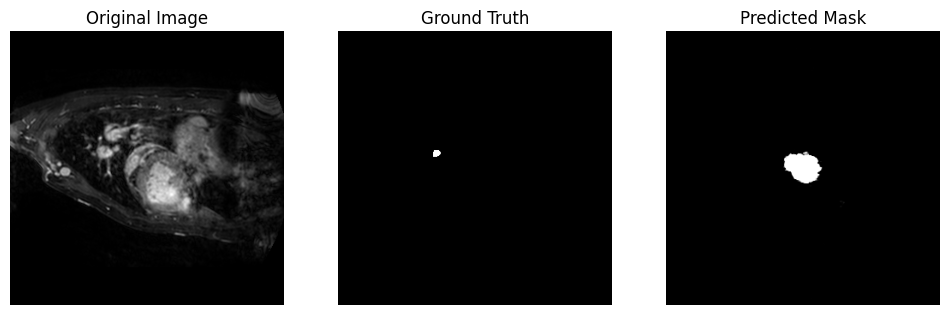

229


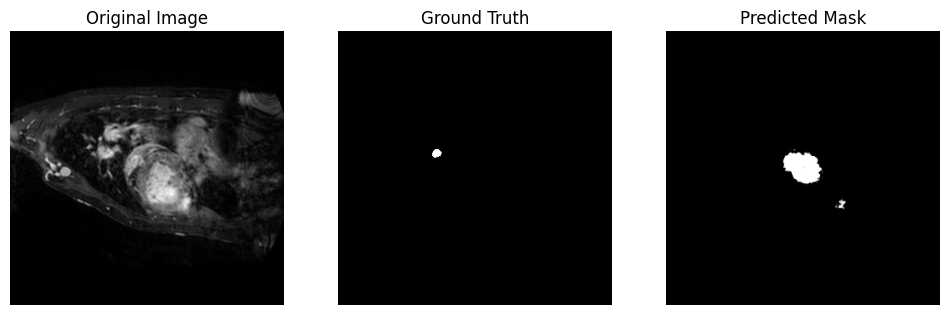

230


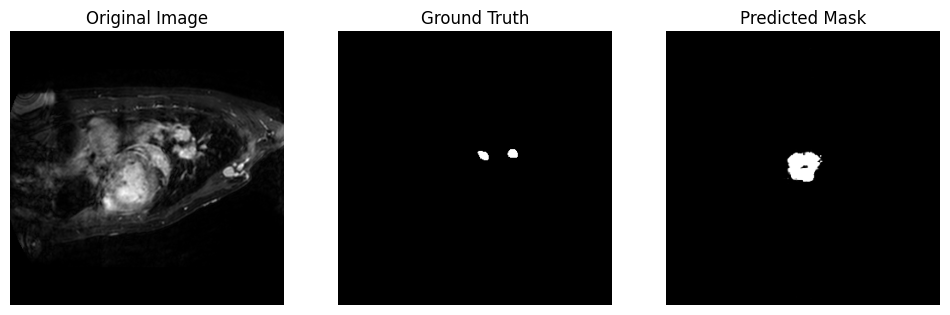

231


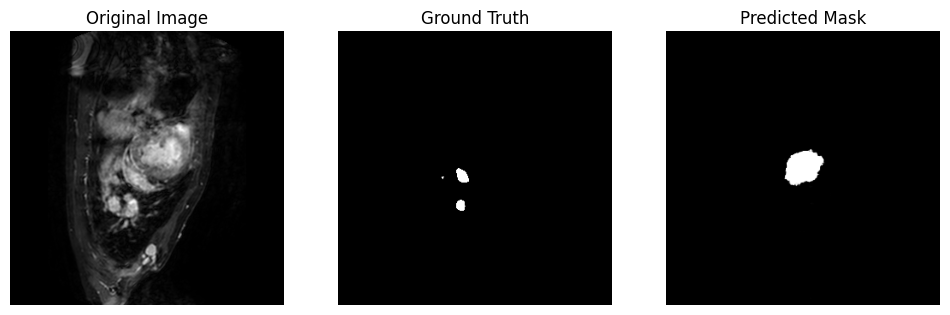

232


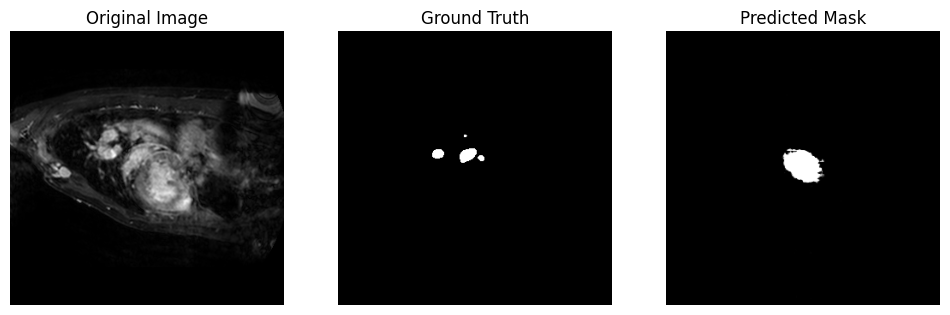

233


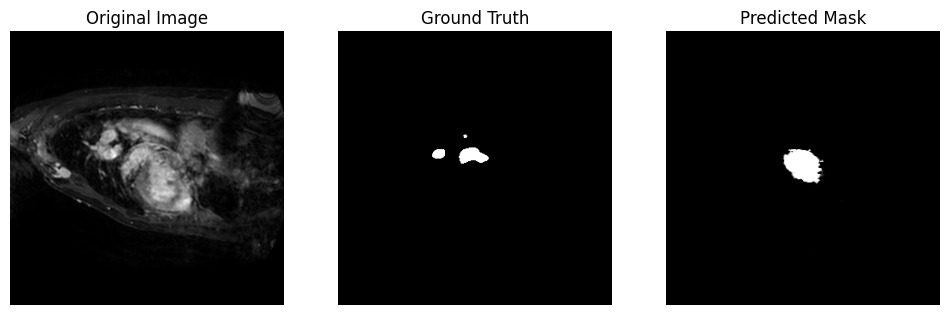

234


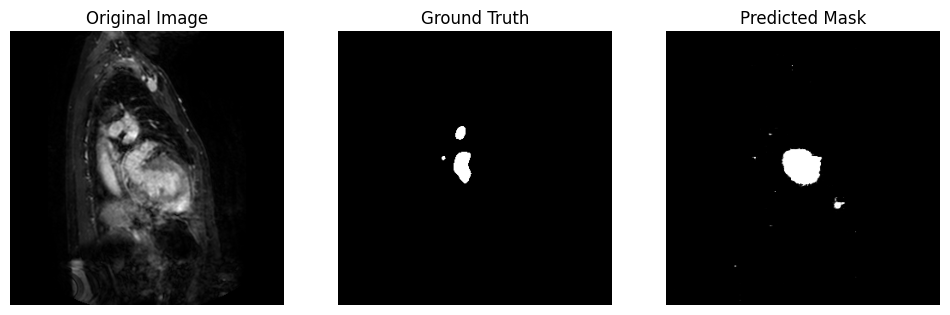

235


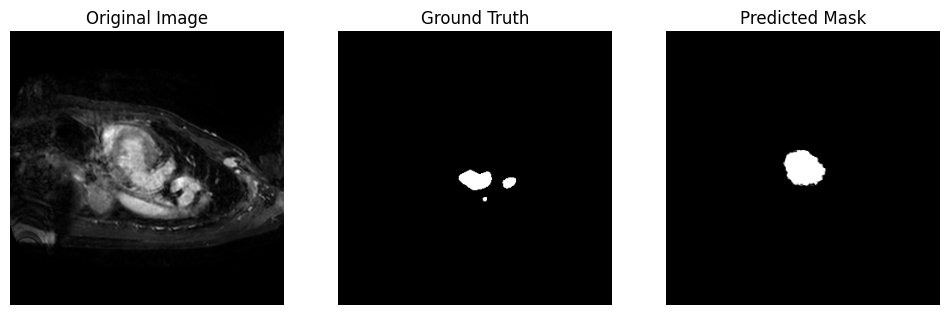

236


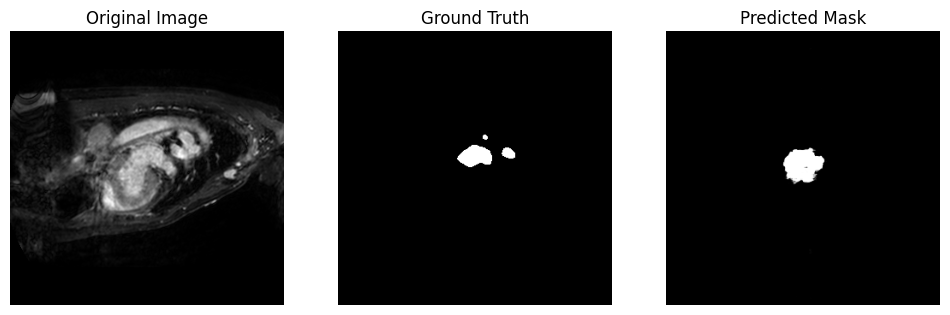

237


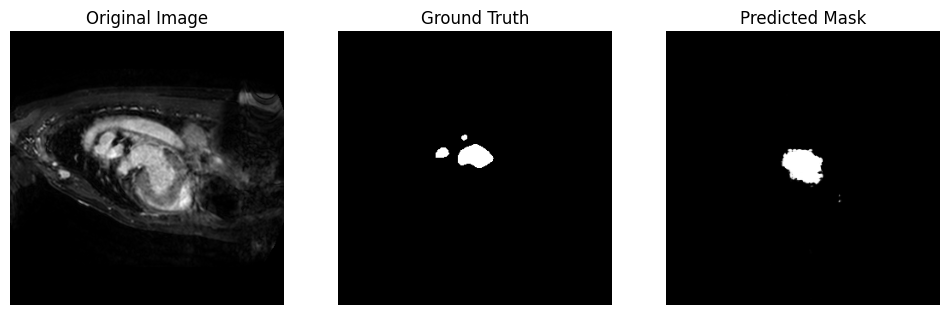

238


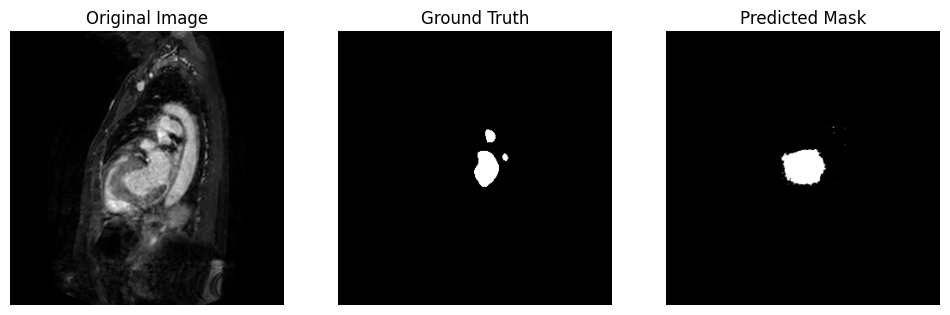

239


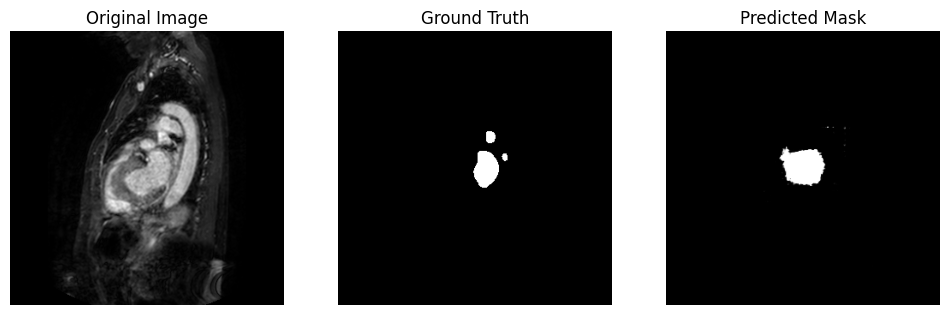

240


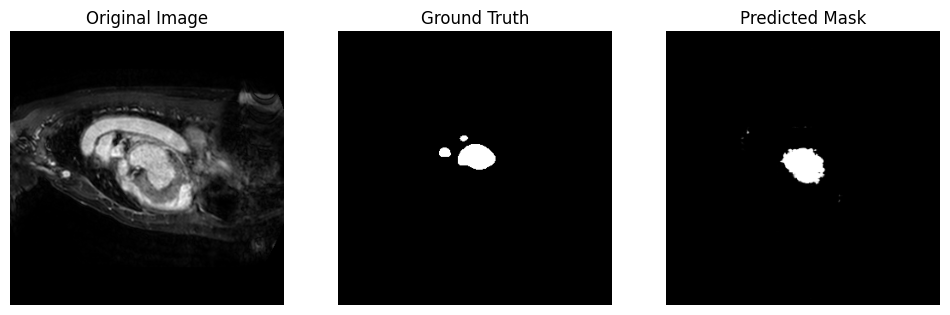

241


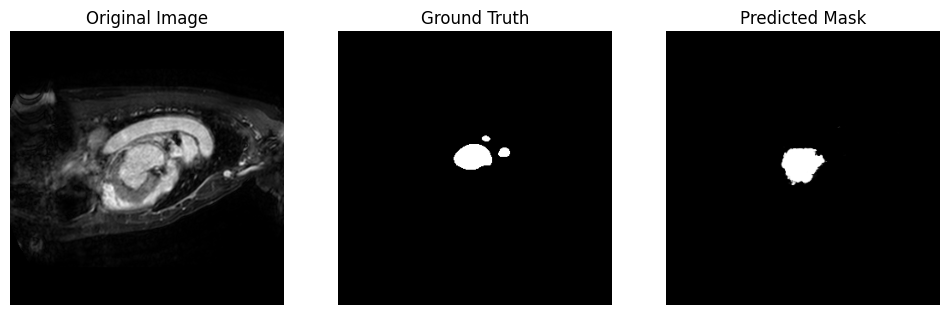

242


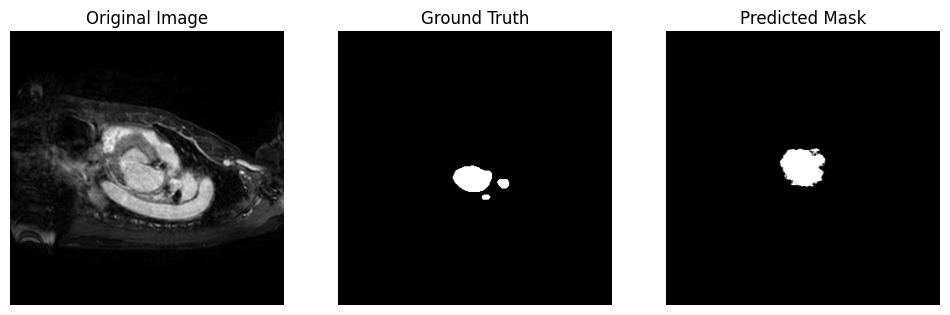

243


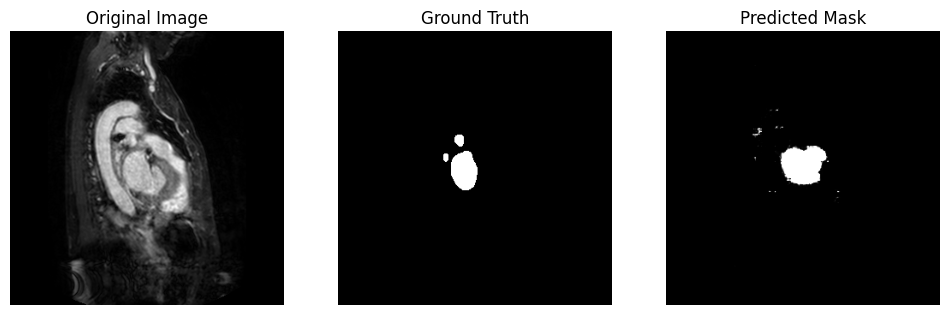

244


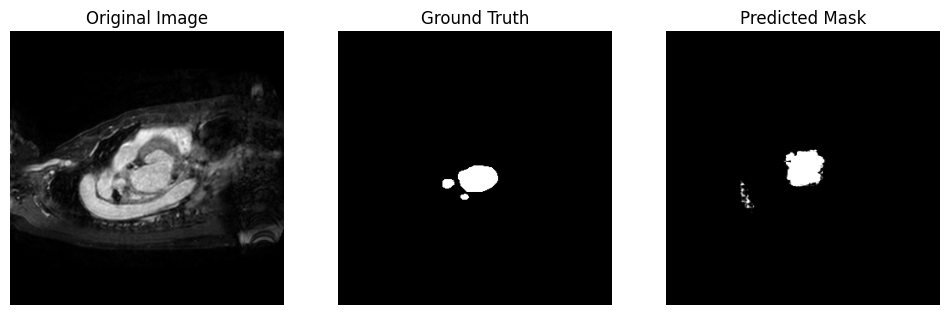

245


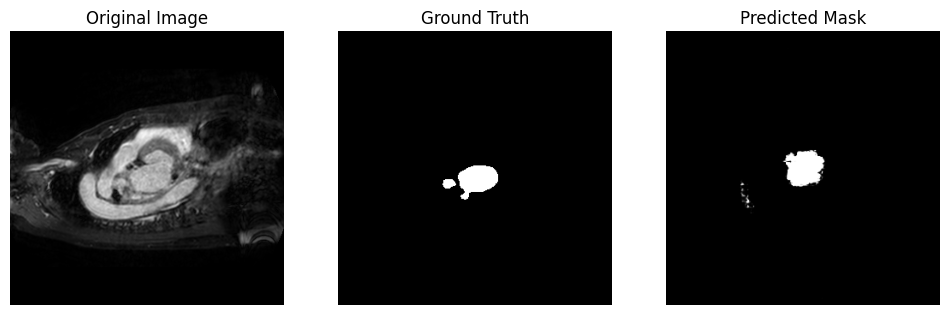

246


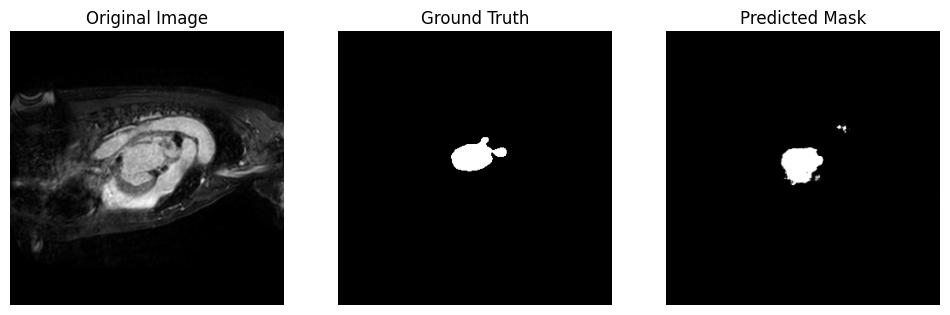

247


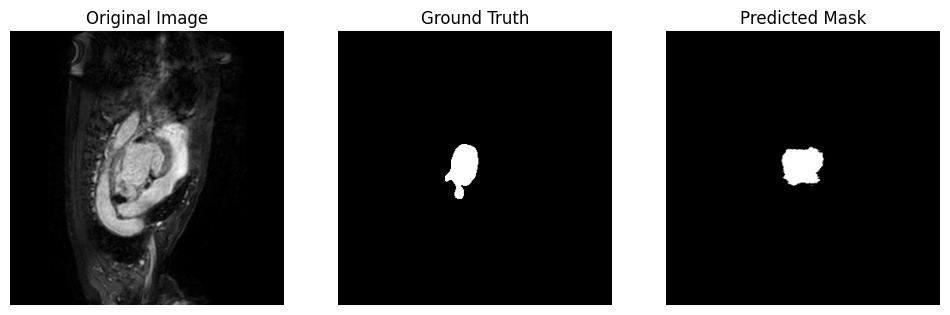

248


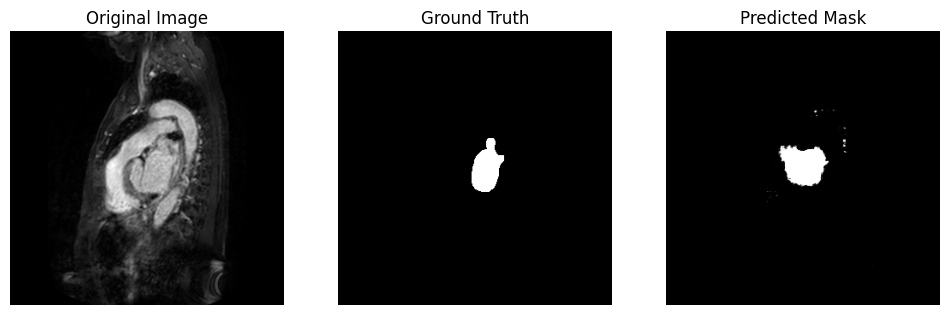

249


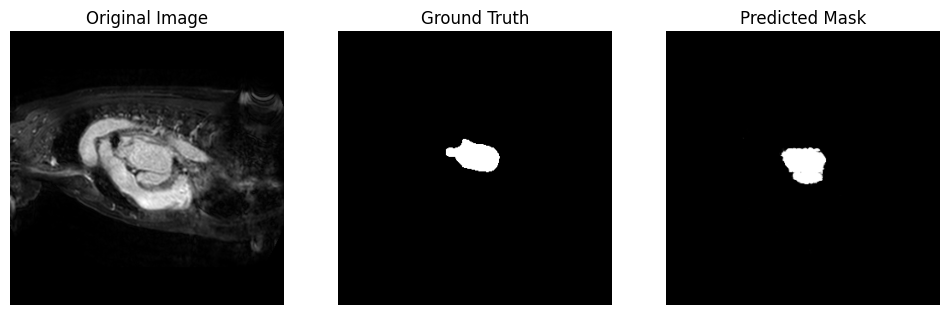

250


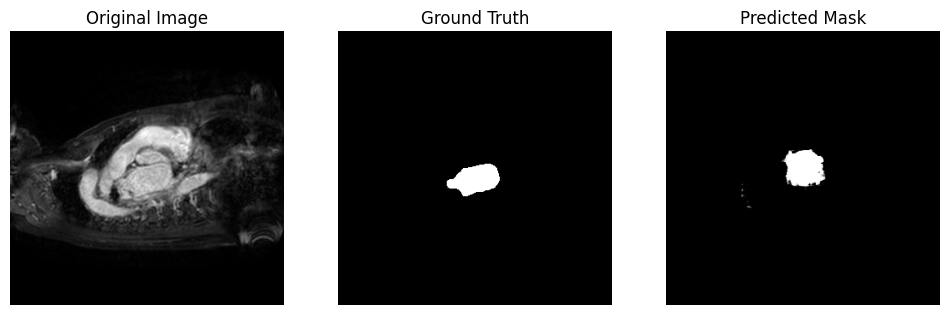

251


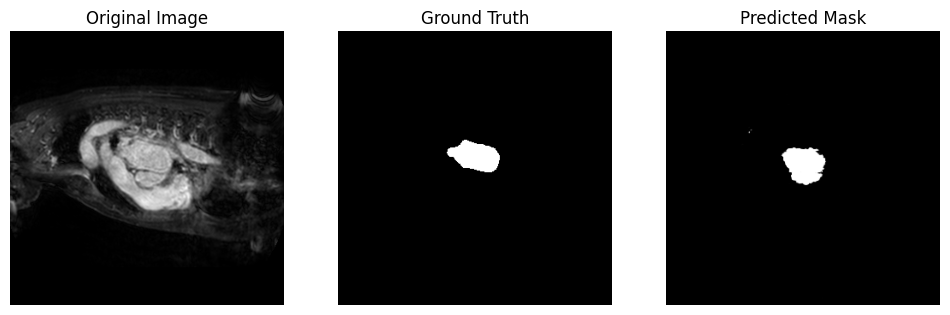

252


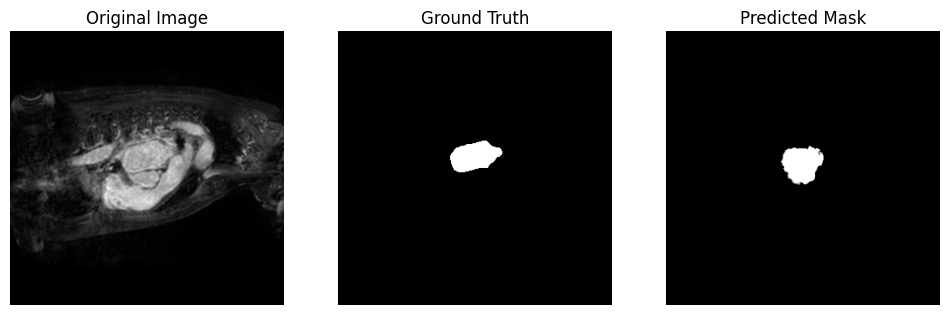

253


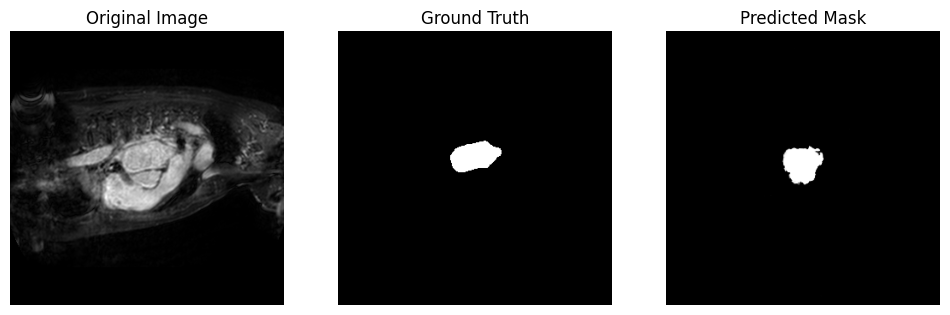

254


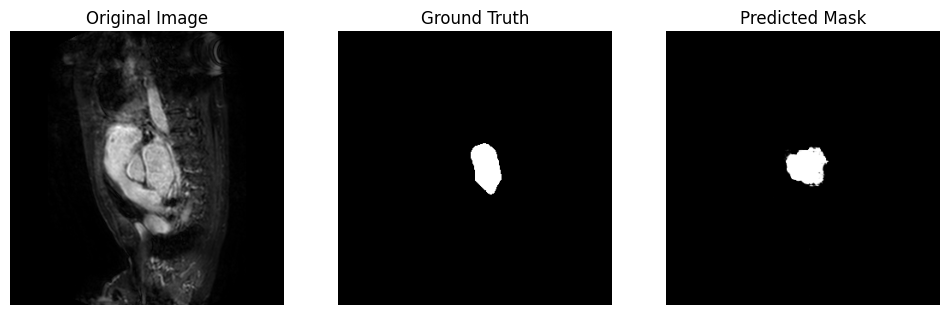

255


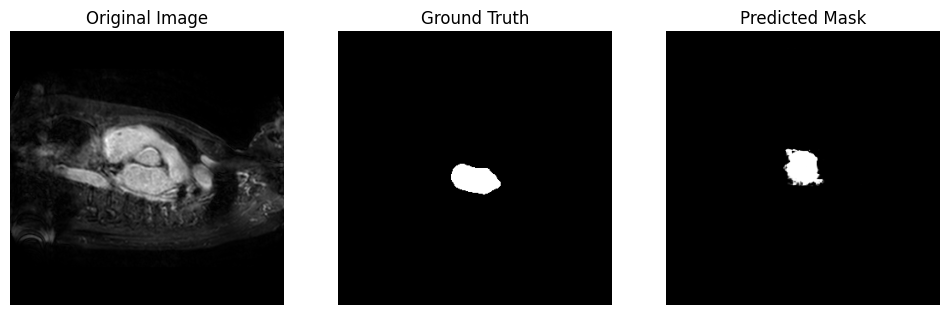

256


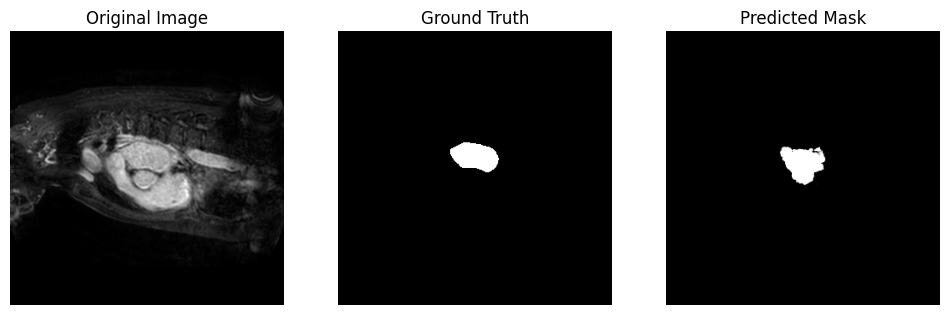

257


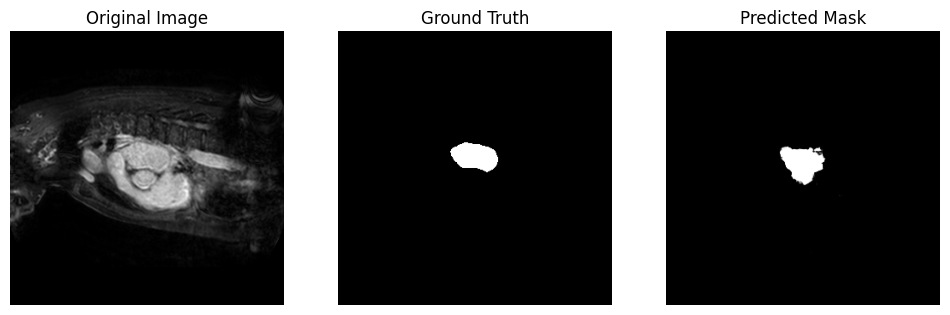

258


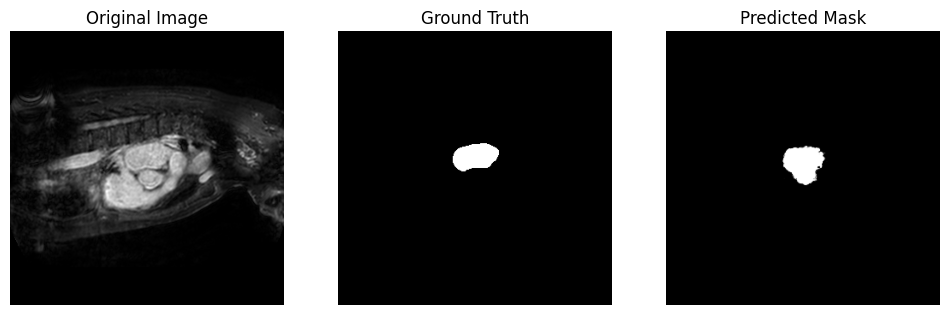

259


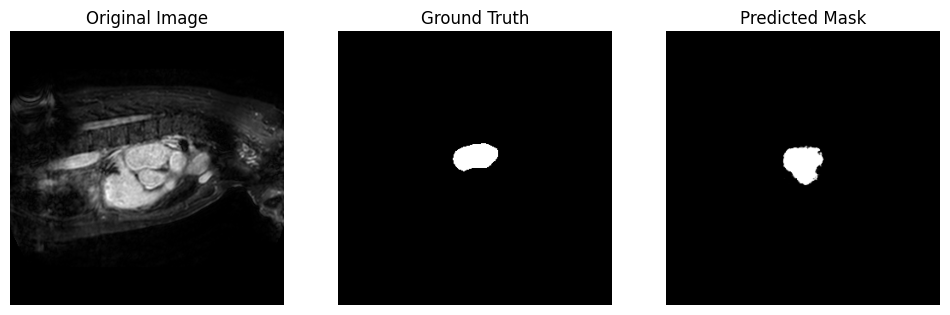

260


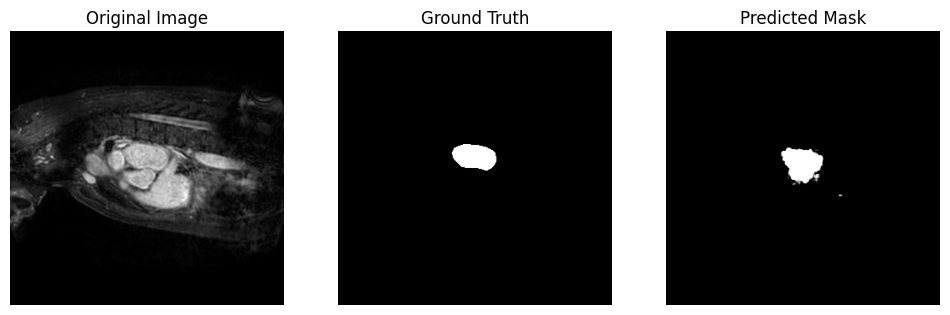

261


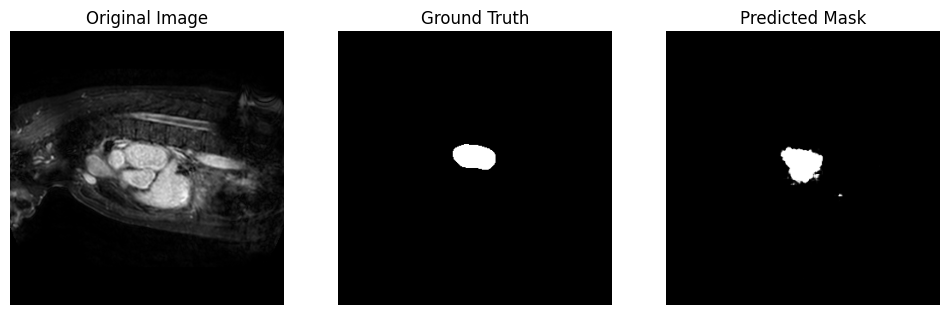

262


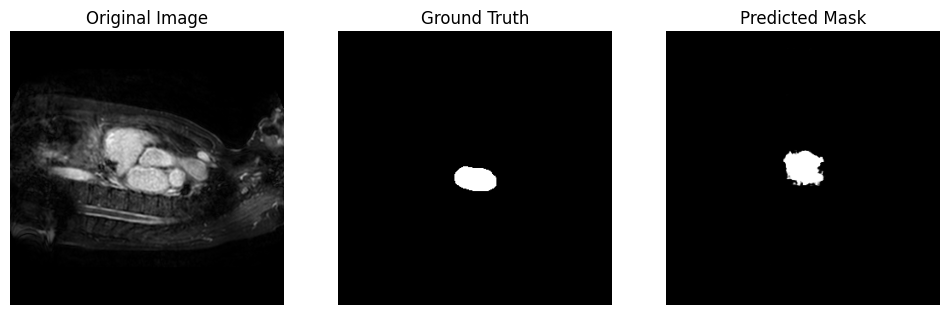

263


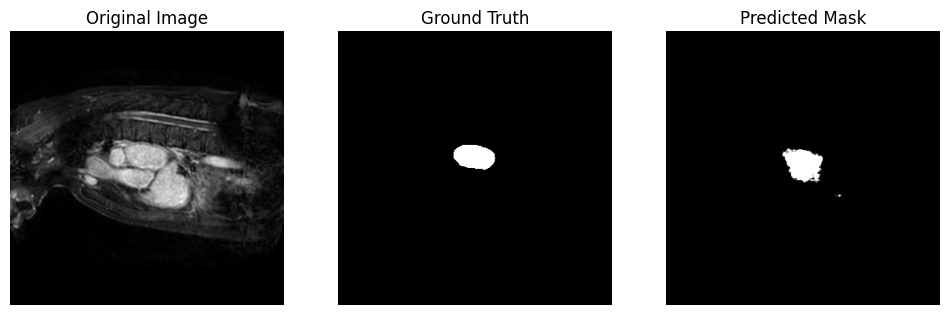

264


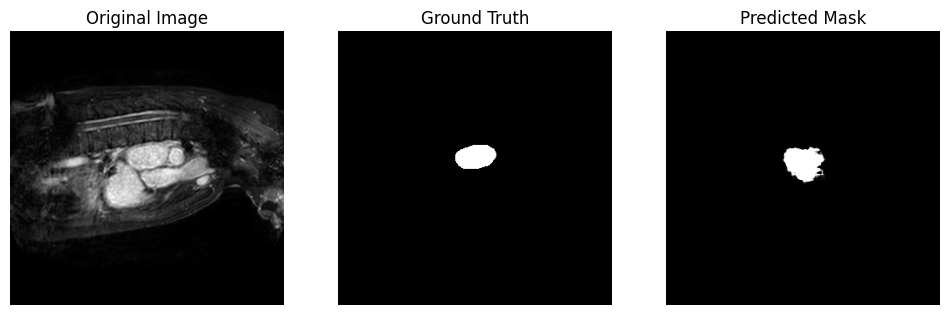

265


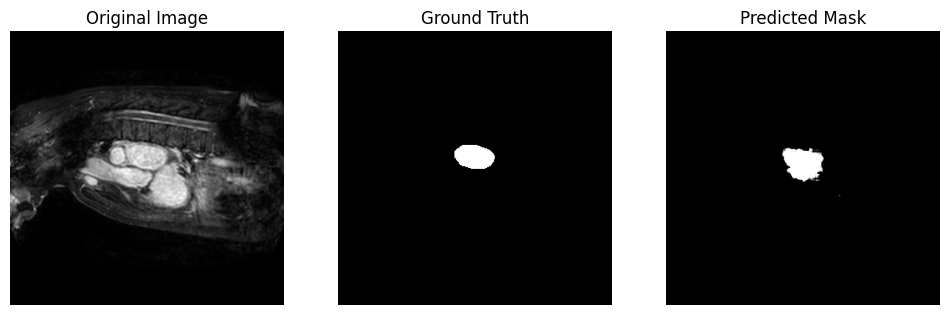

266


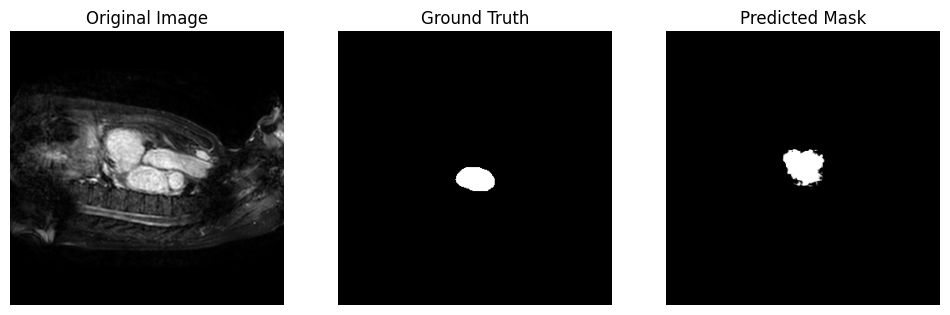

267


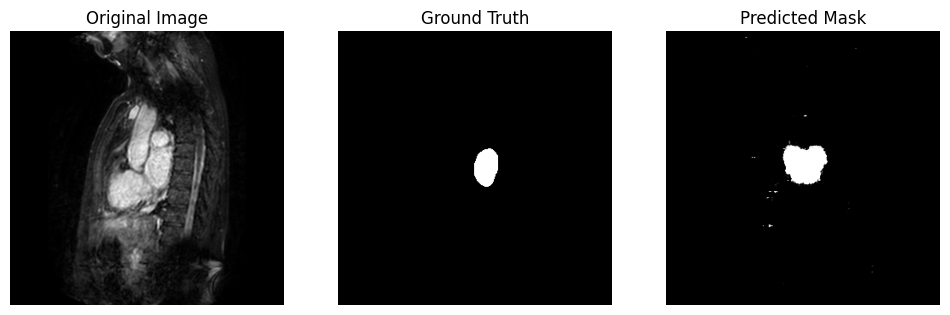

268


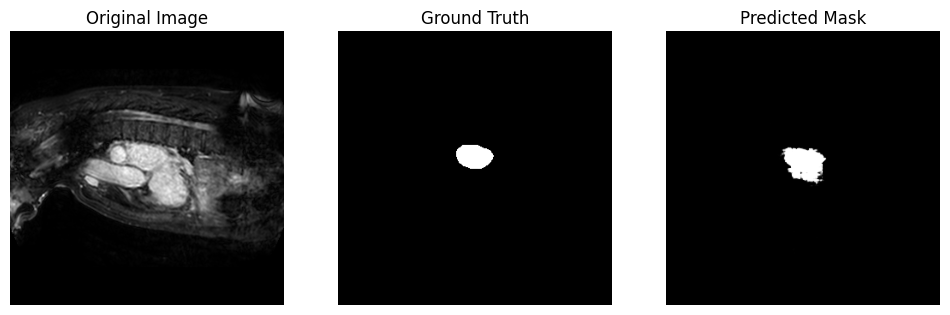

269


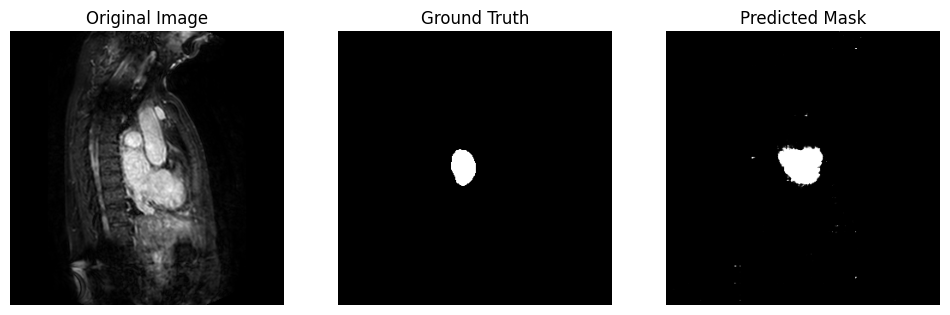

270


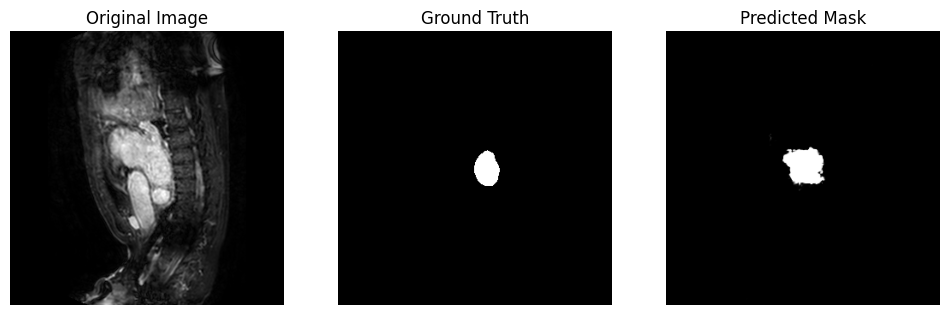

271


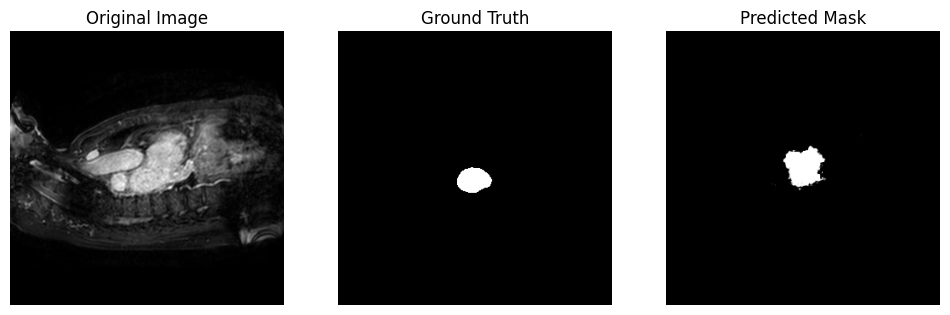

272


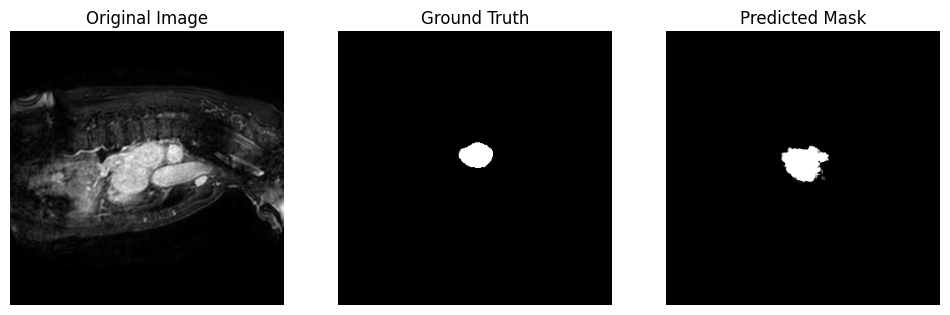

273


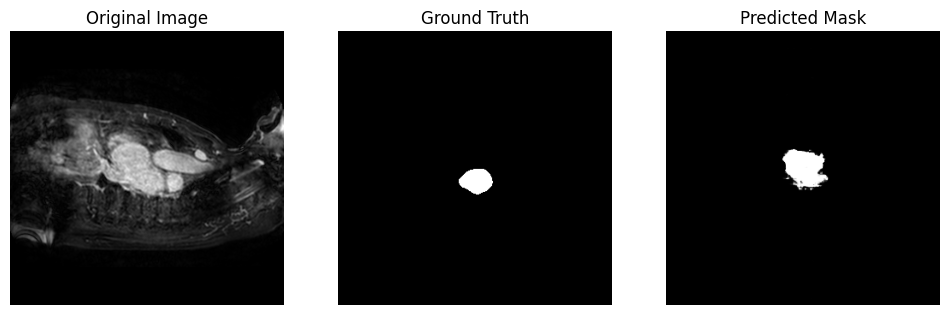

274


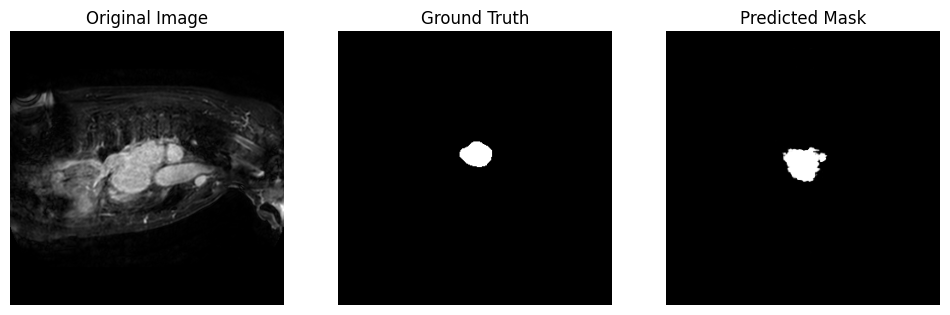

275


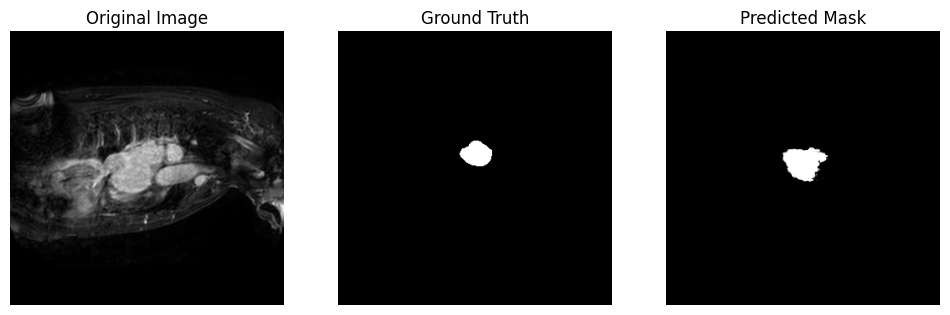

276


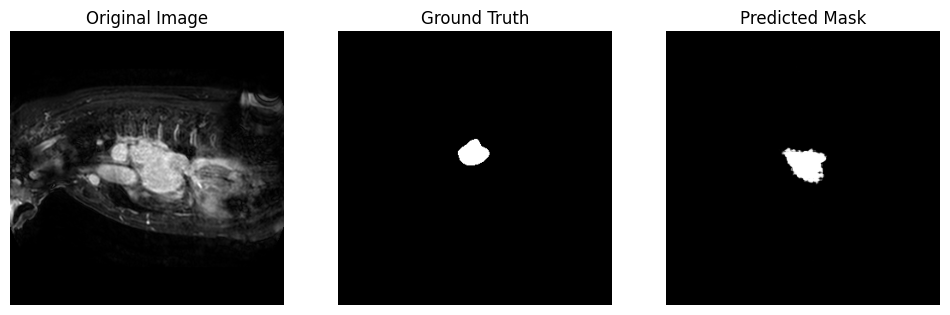

277


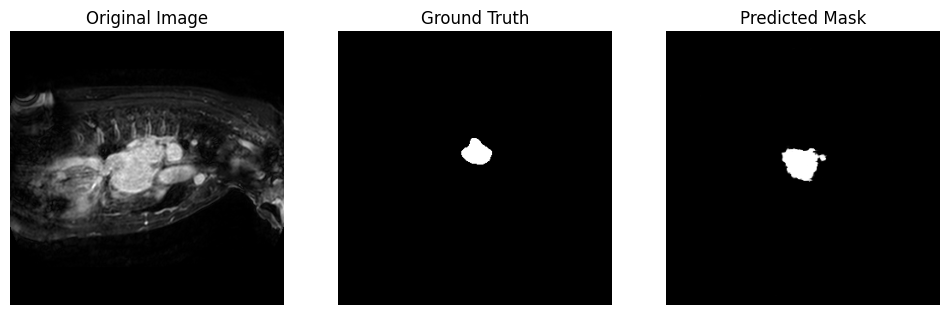

278


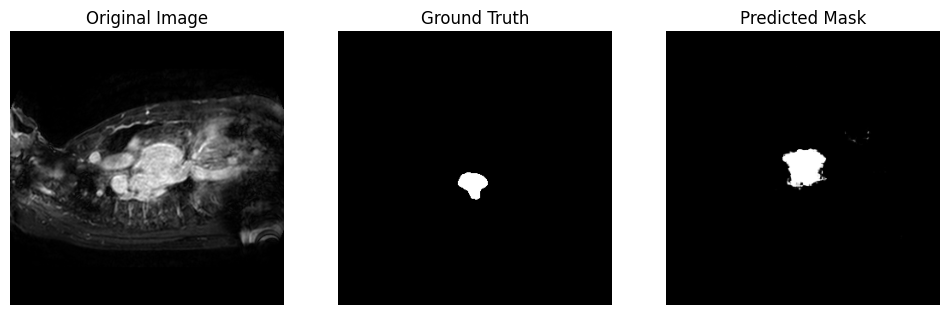

279


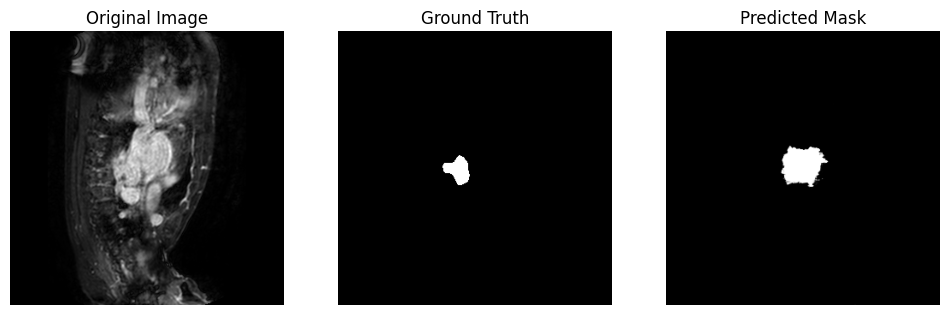

280


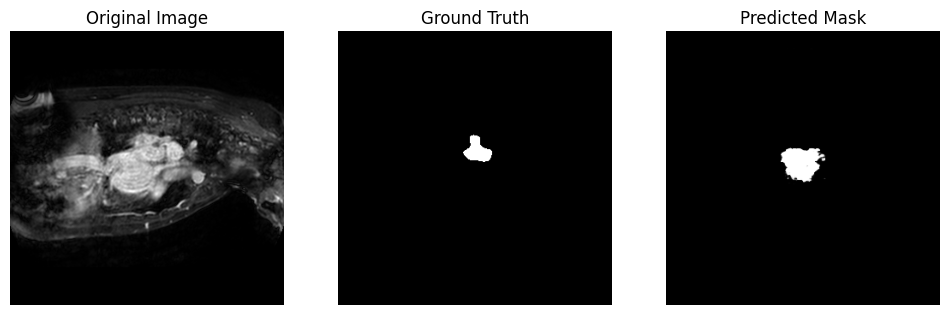

281


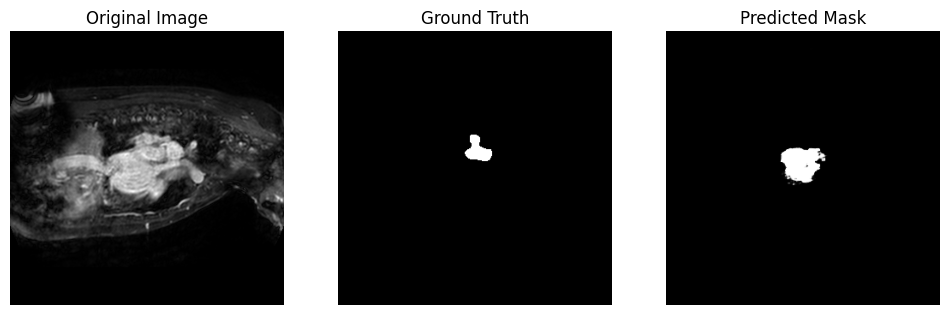

282


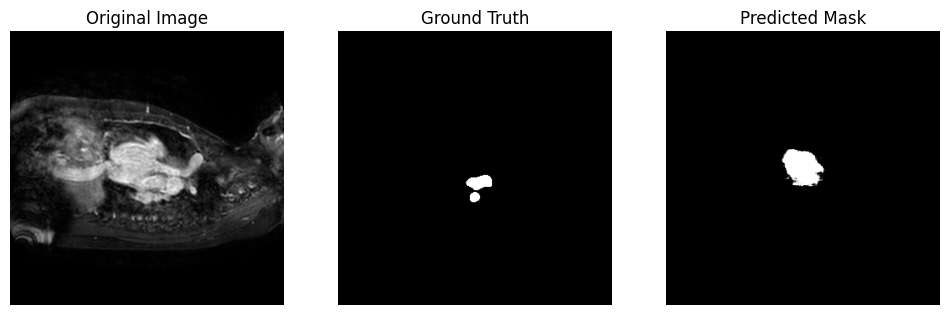

283


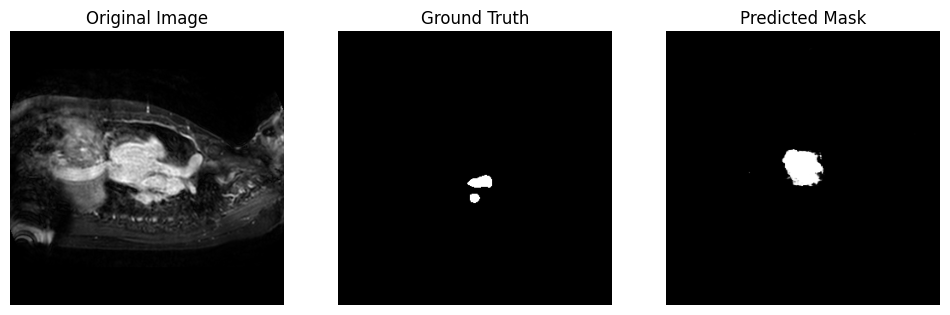

284


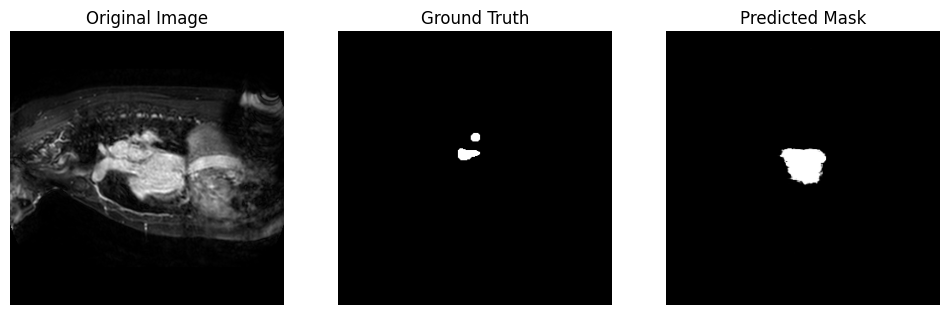

285


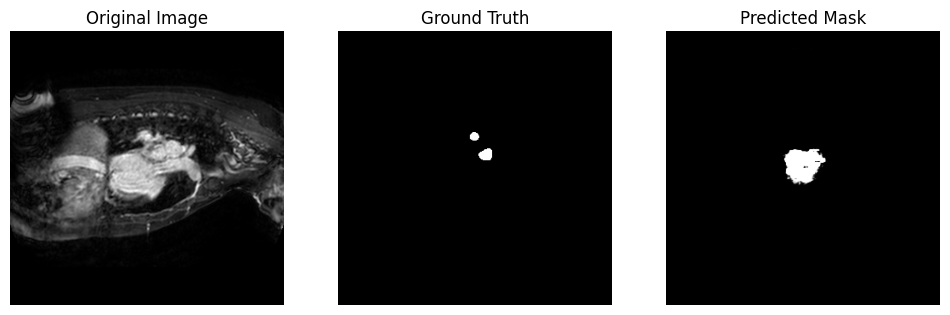

286


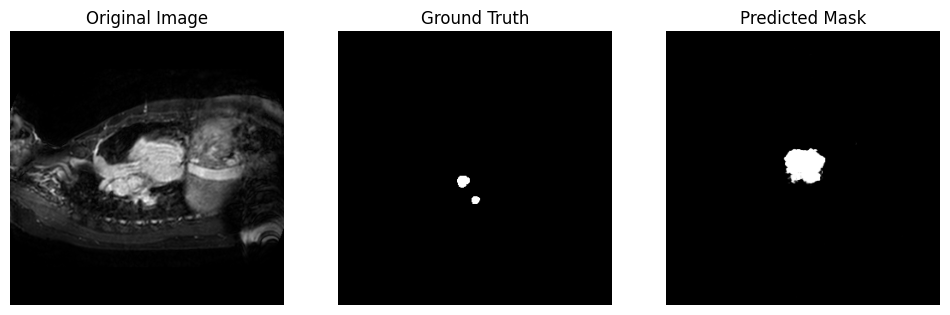

287


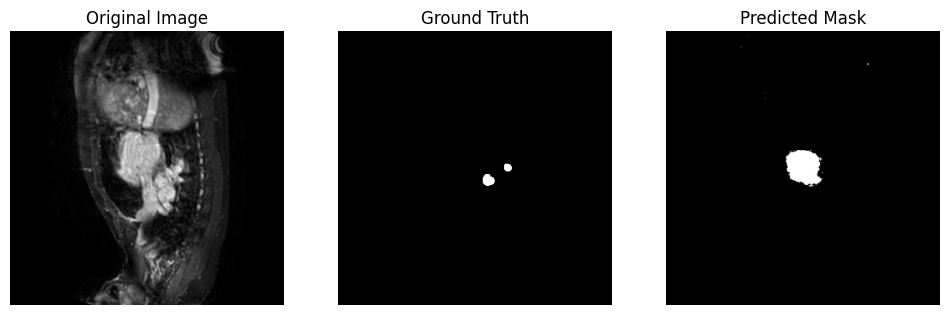

288


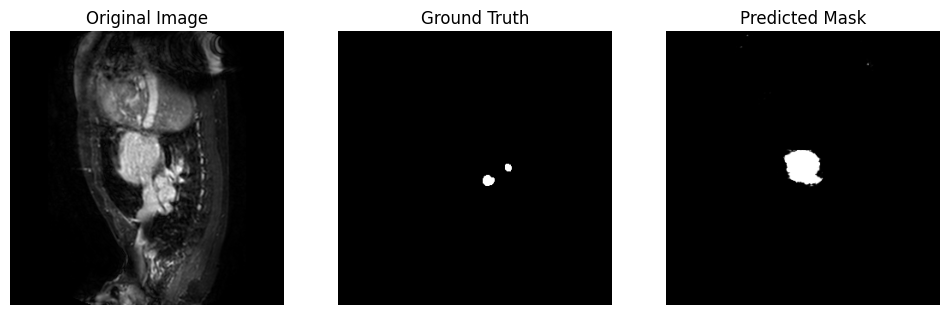

289


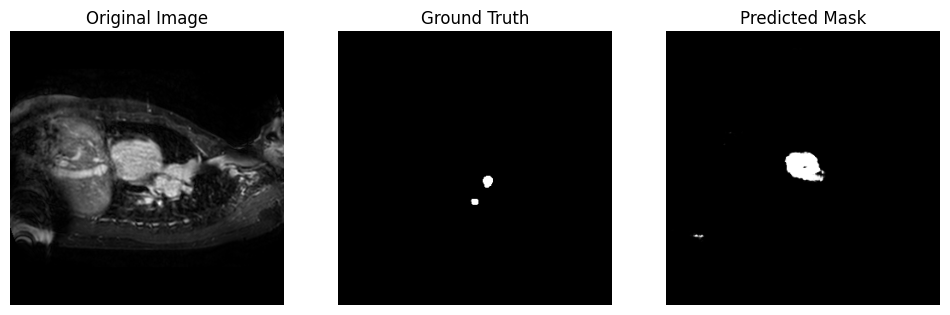

290


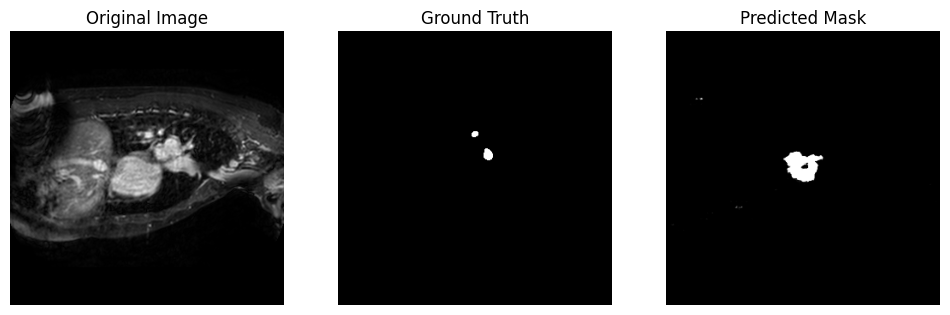

291


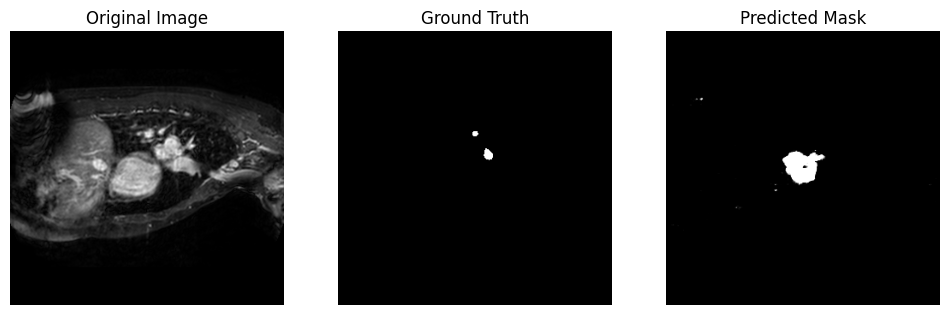

292


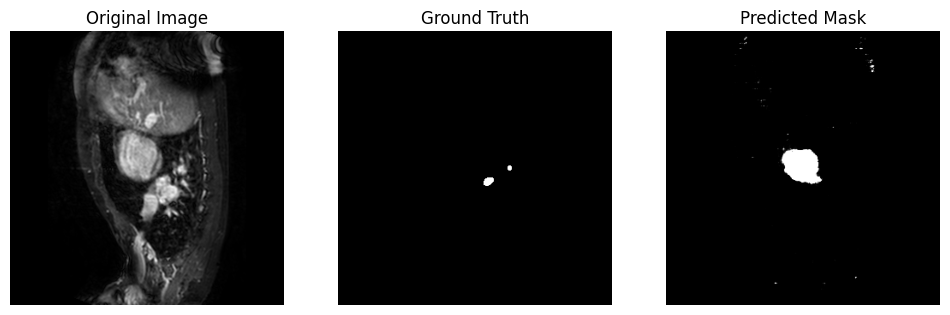

293


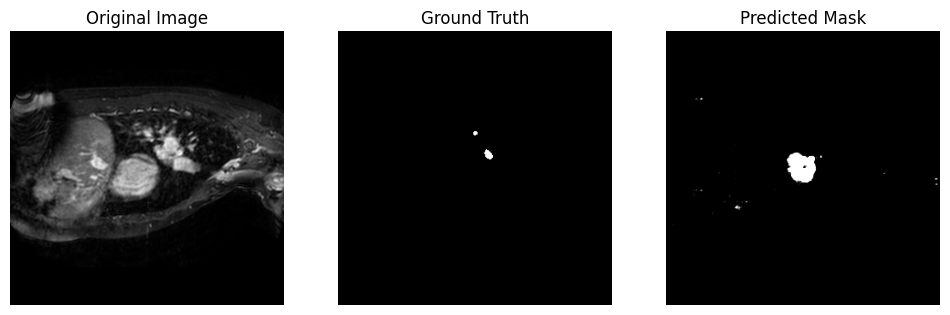

294


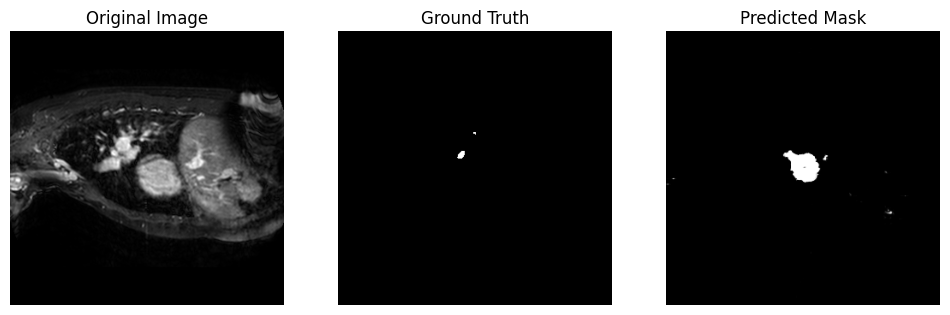

295


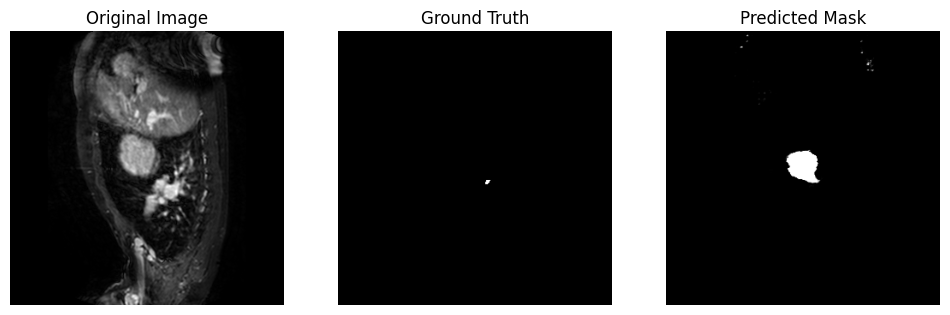

296


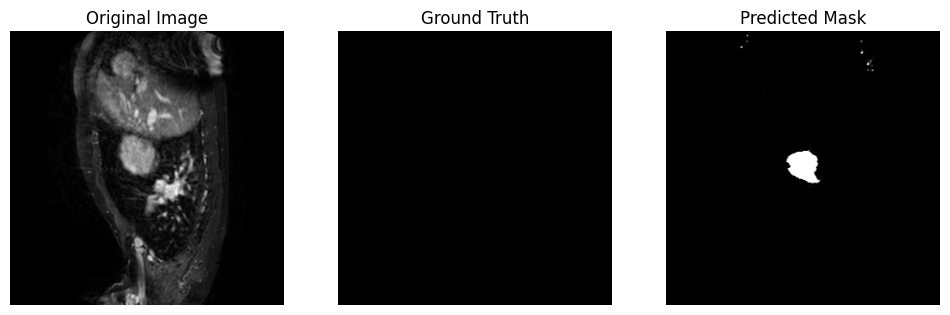

297


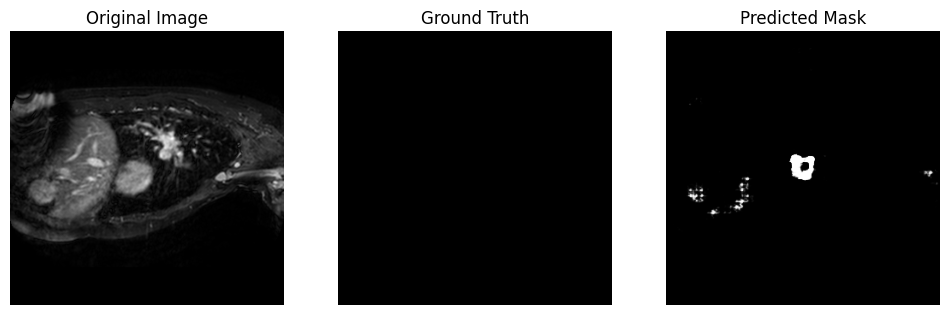

298


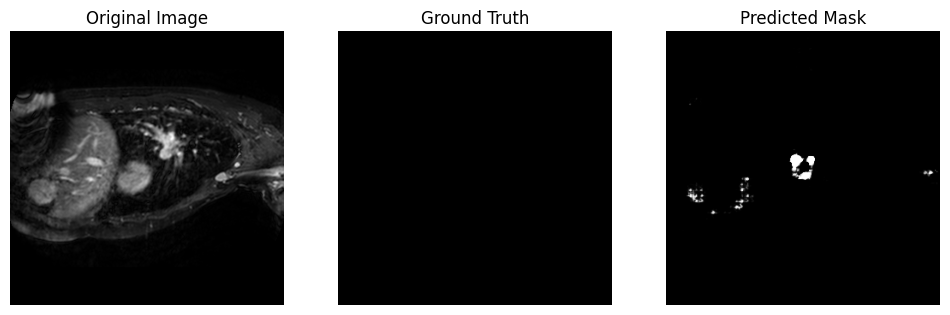

299


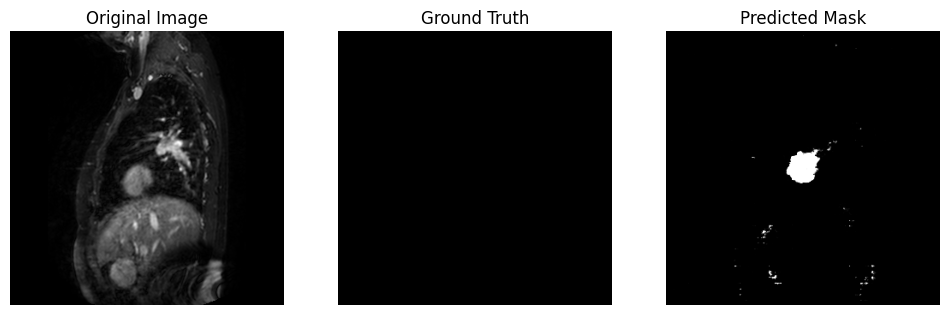

300


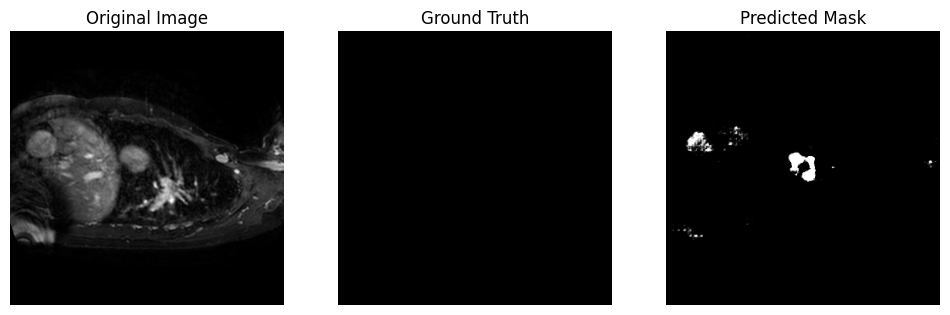

301


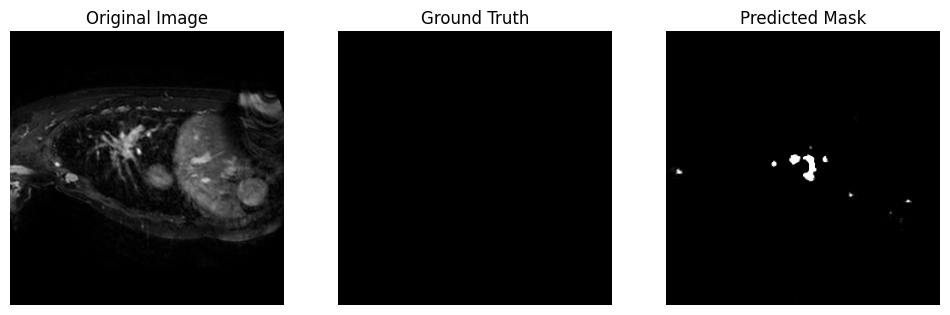

302


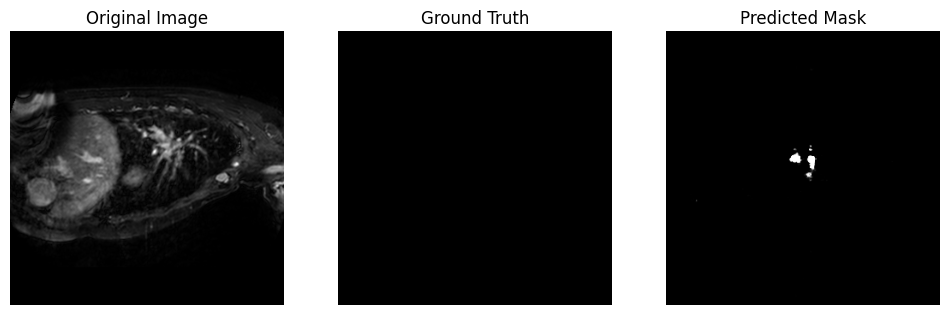

303


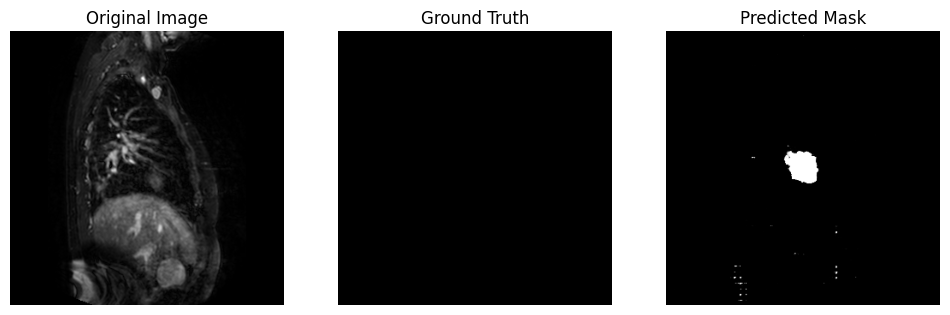

304


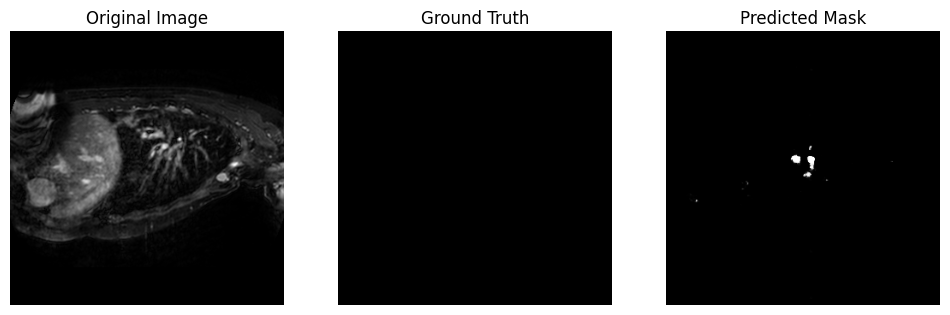

305


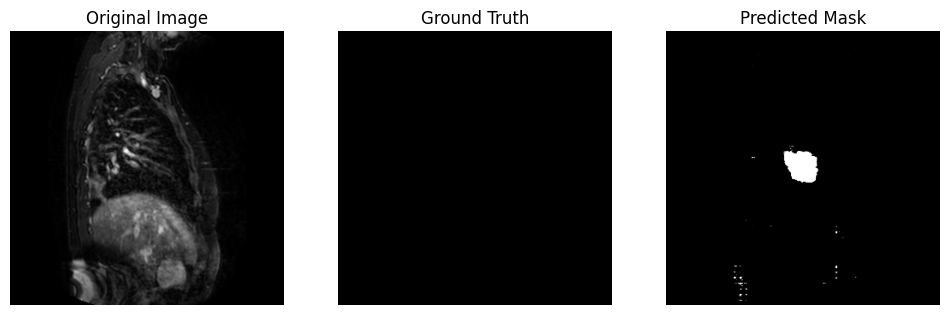

306


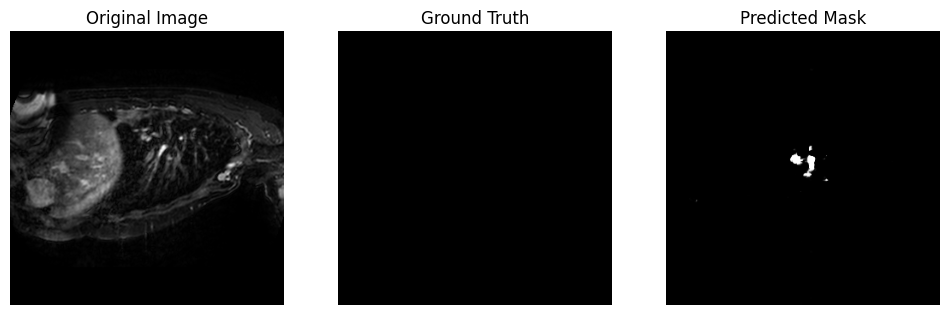

307


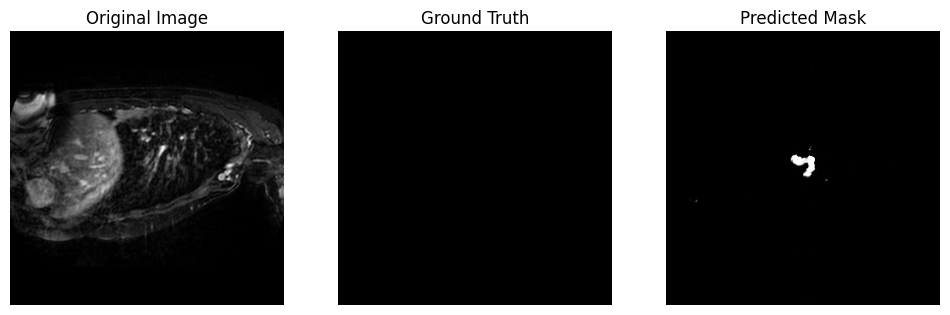

308


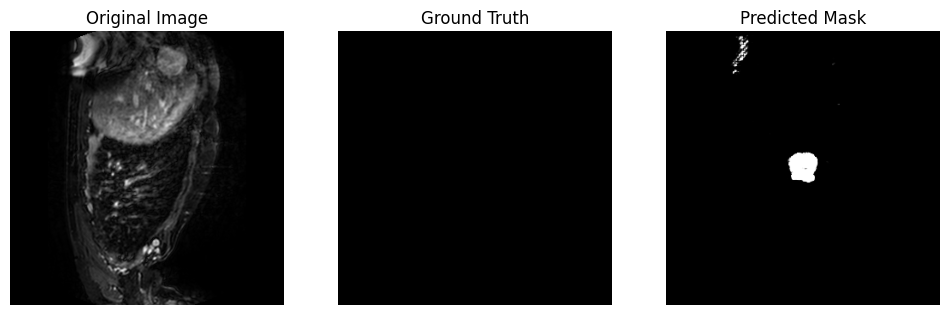

309


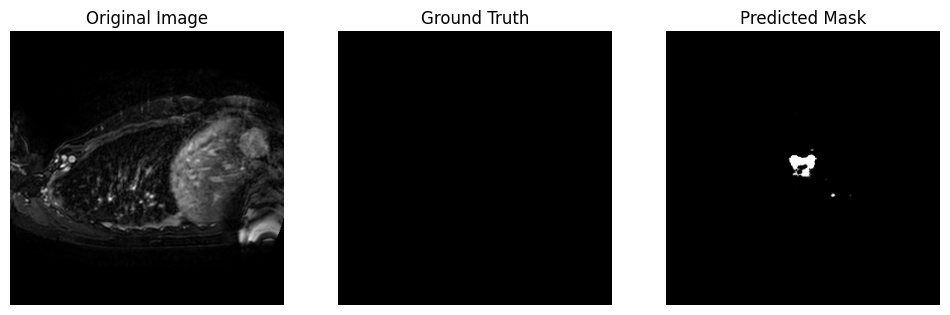

310


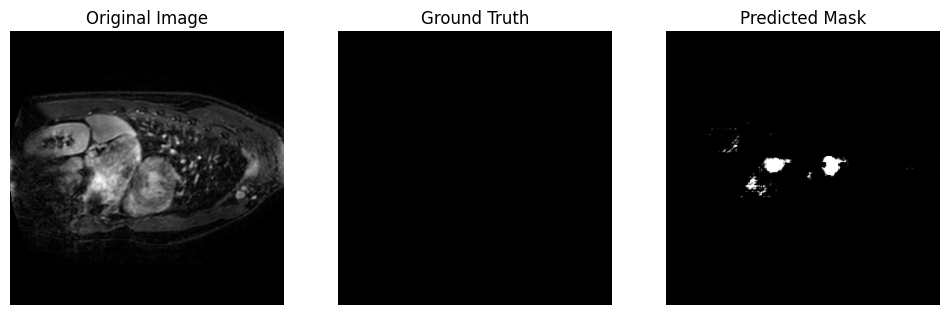

311


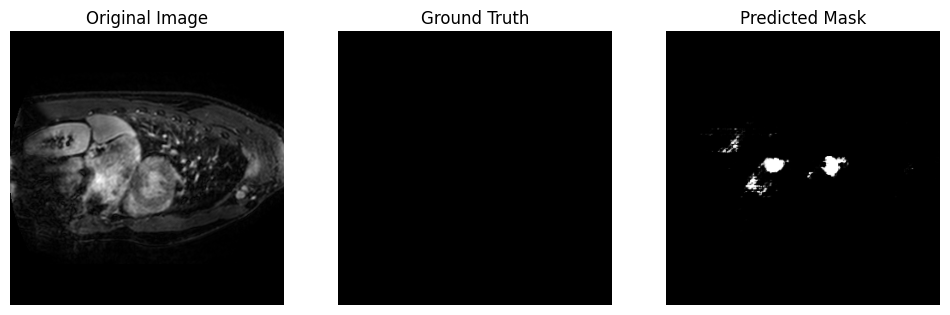

312


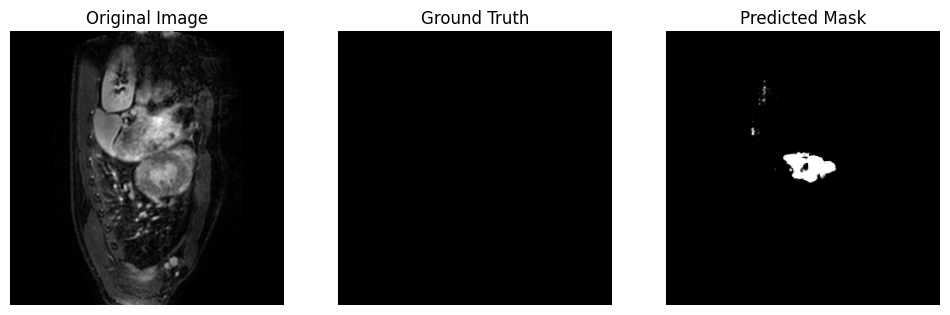

313


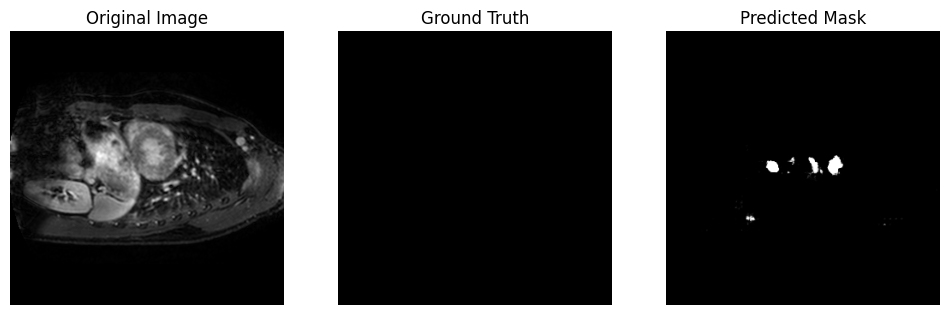

314


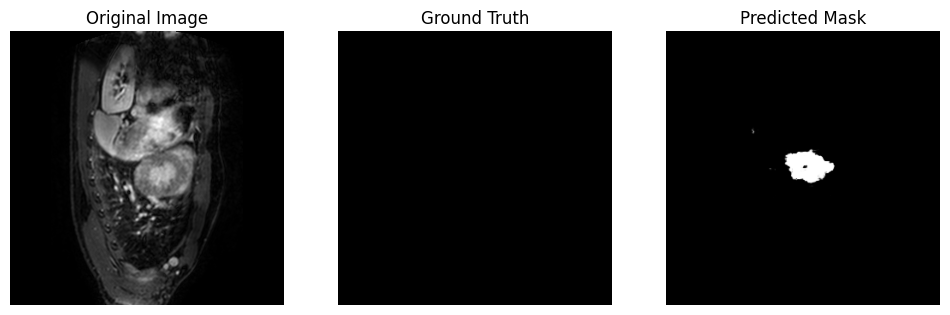

315


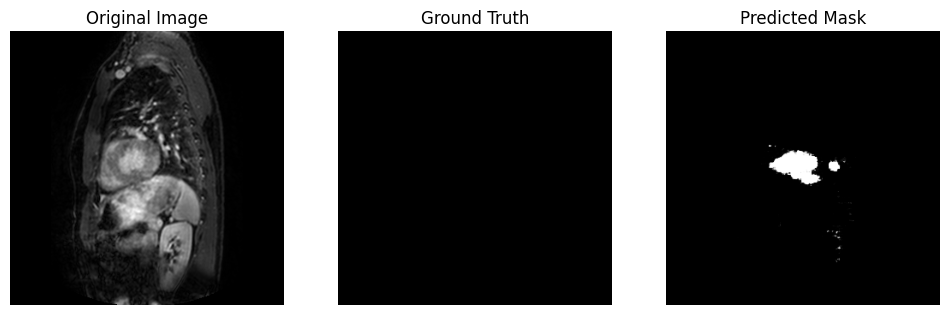

316


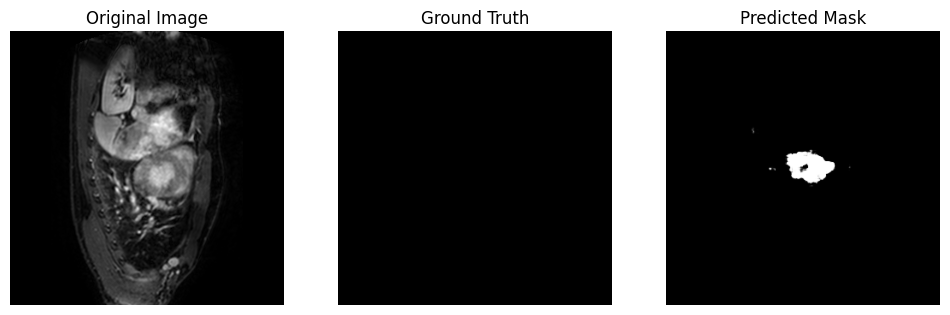

317


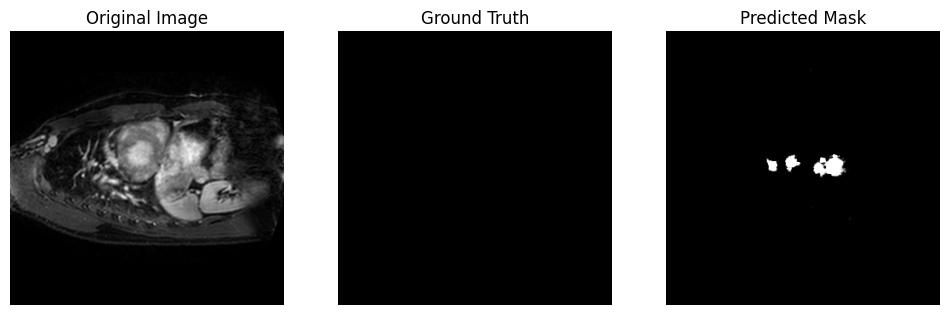

318


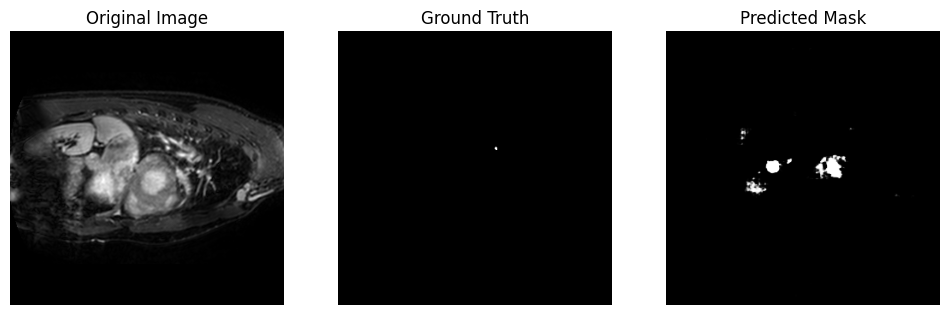

319


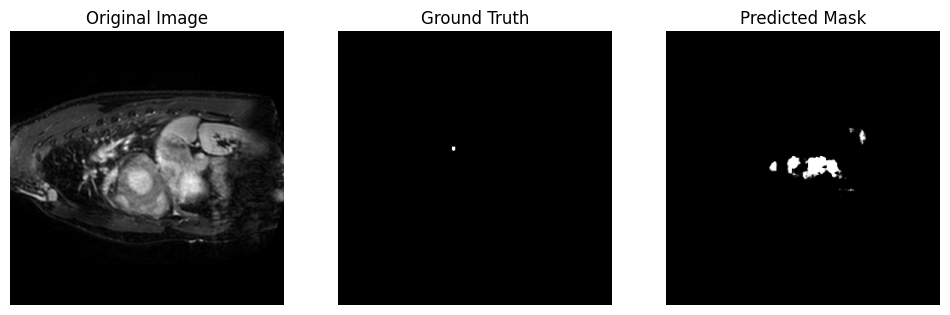

320


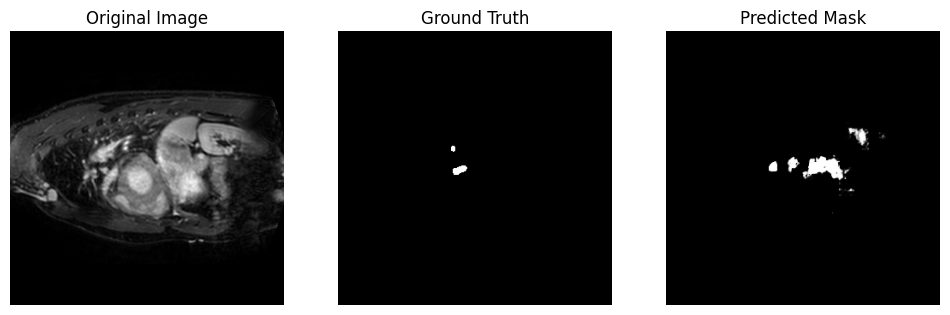

321


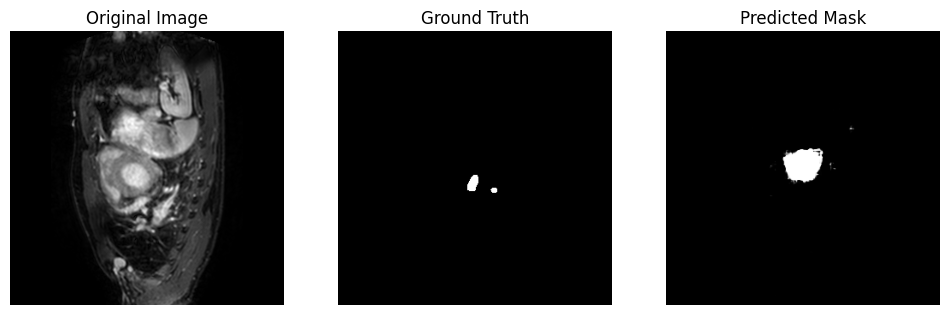

322


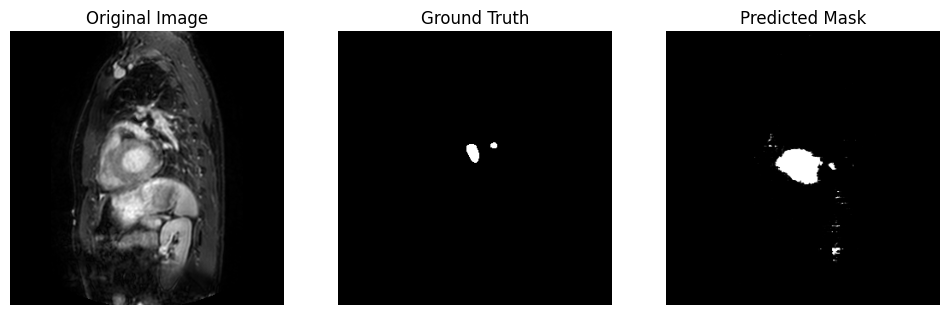

323


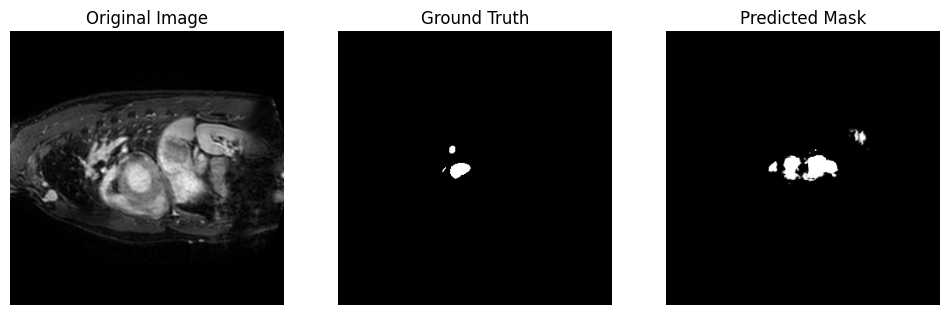

324


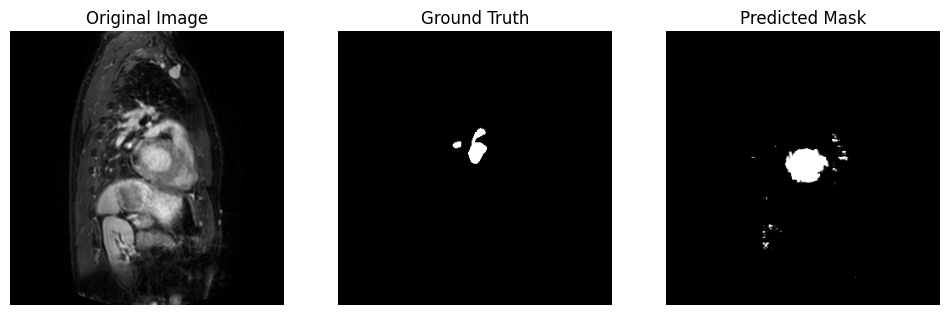

325


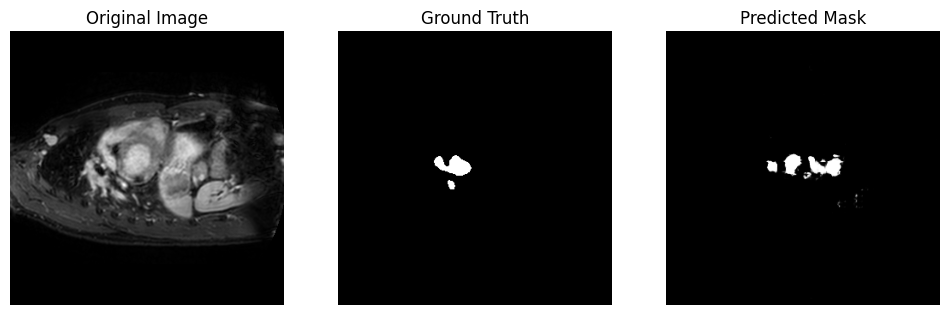

326


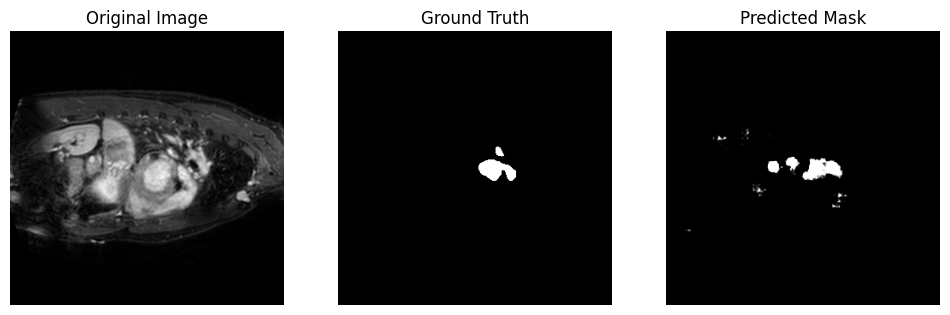

327


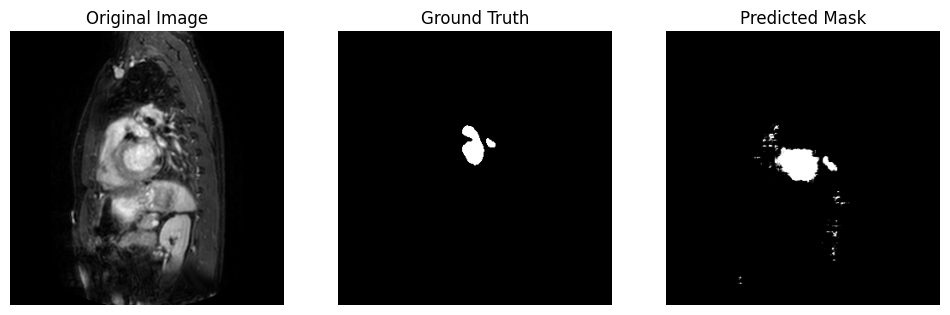

328


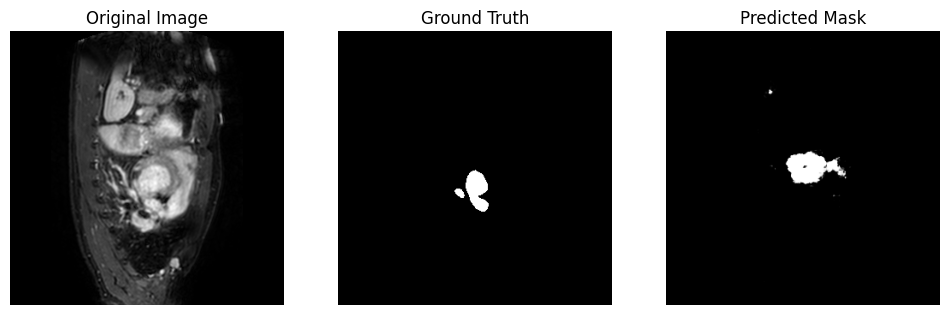

329


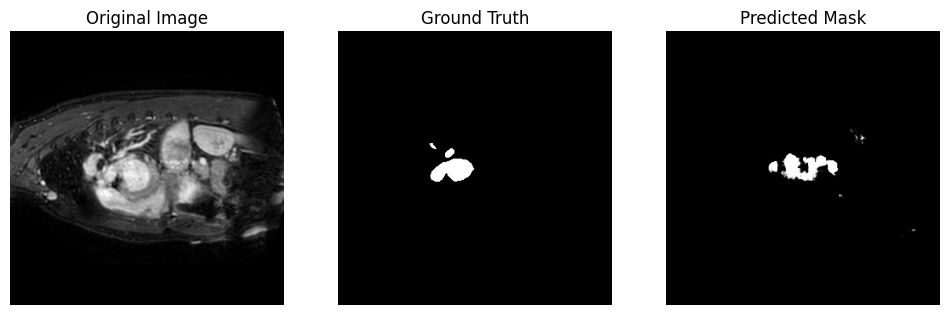

330


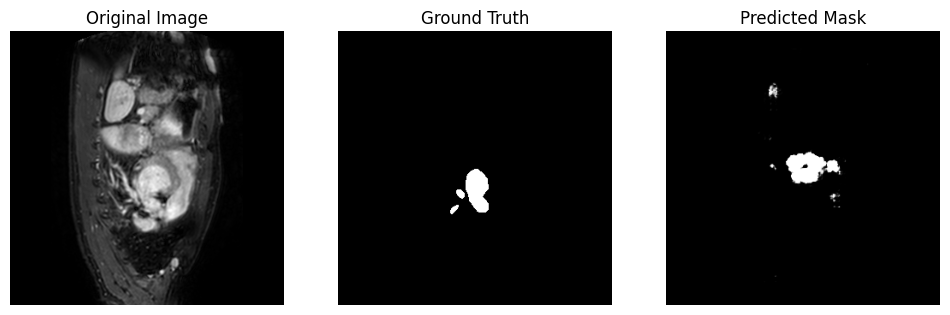

331


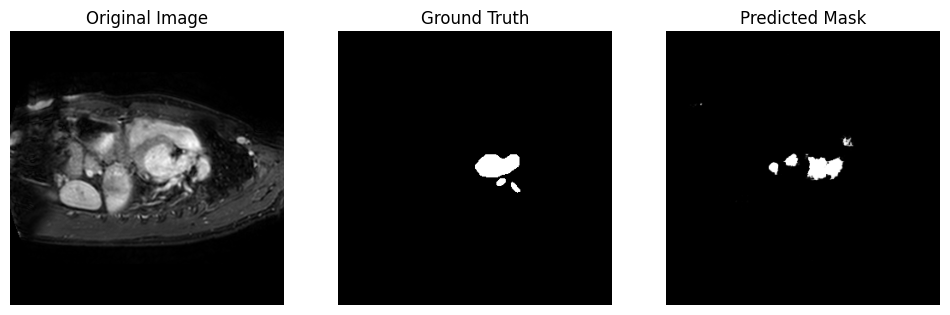

332


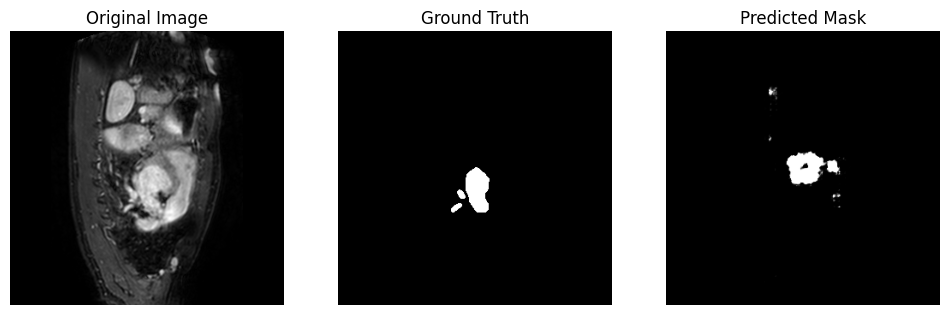

333


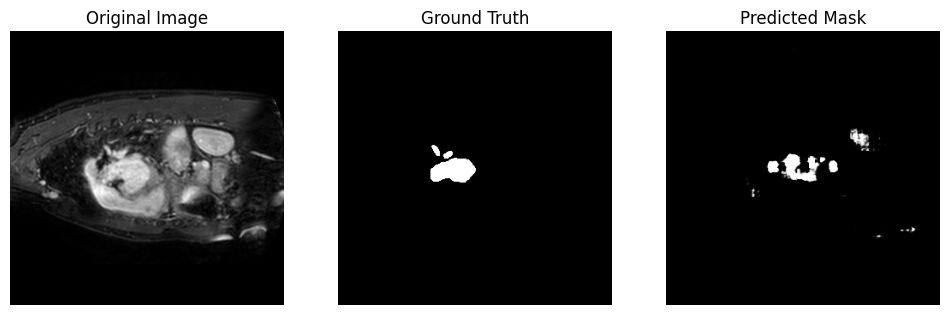

334


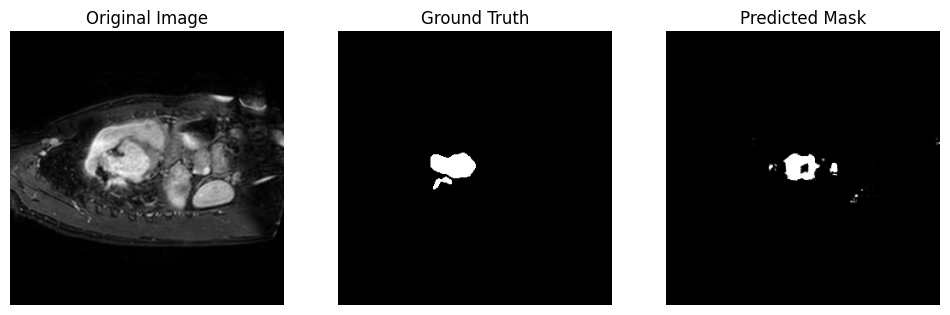

335


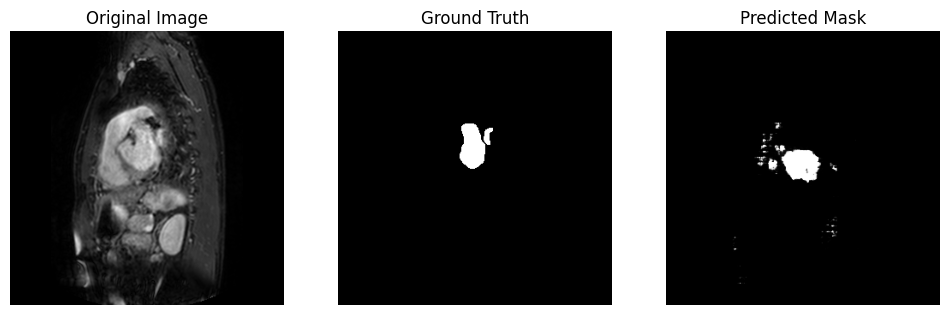

336


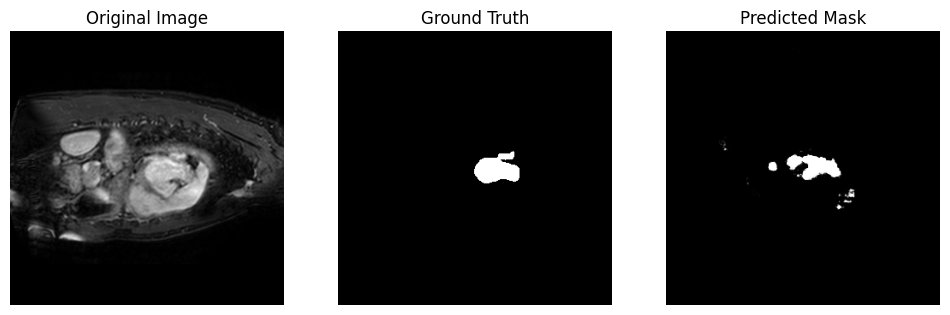

337


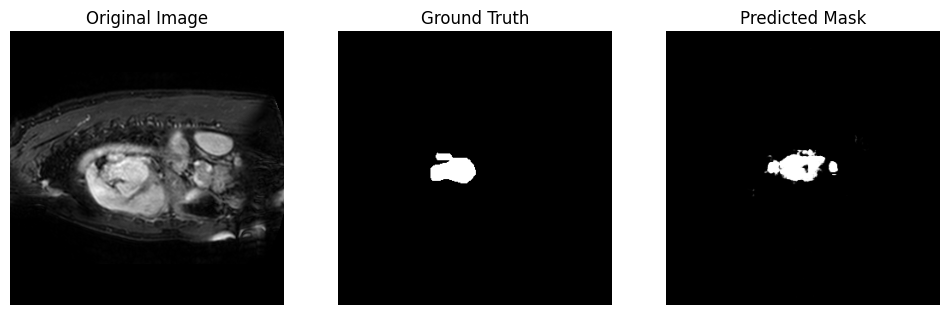

338


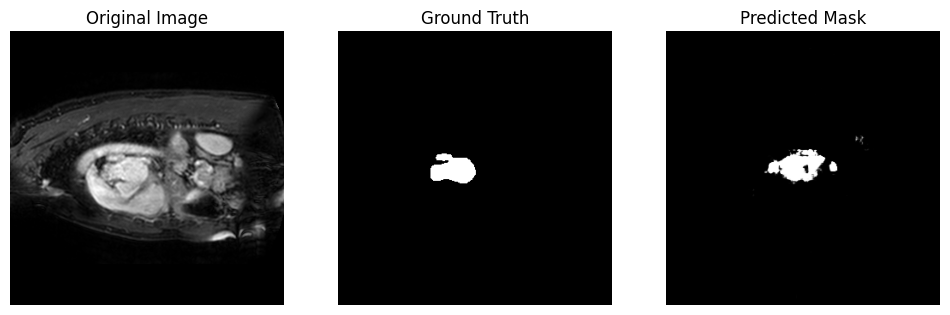

339


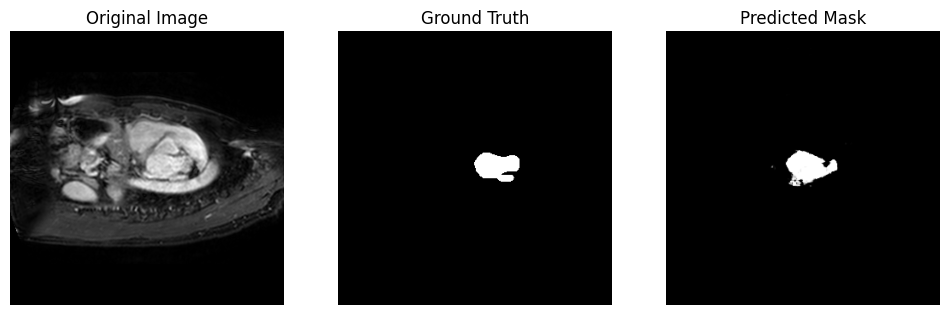

340


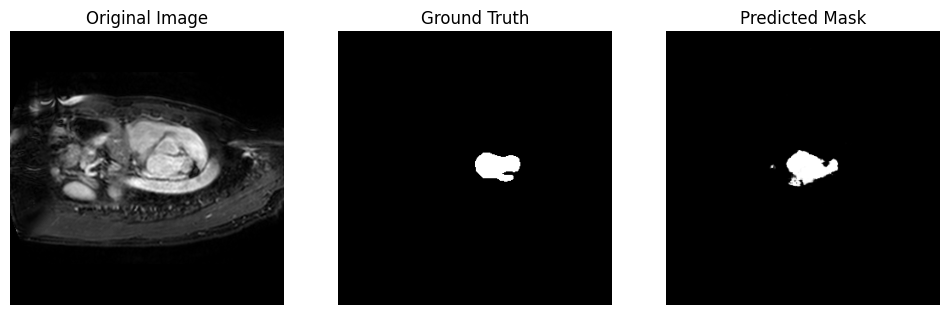

341


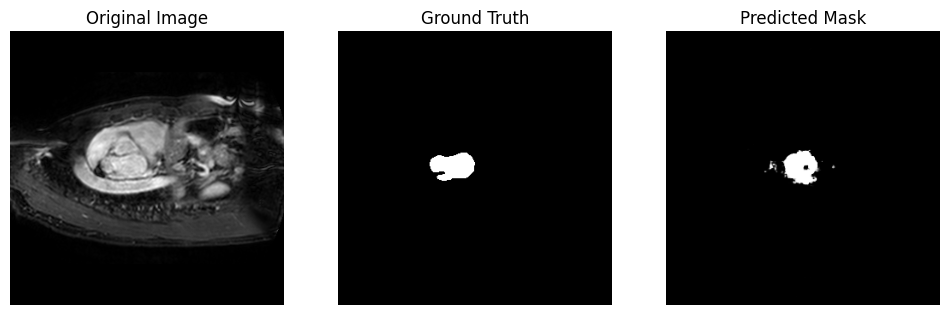

342


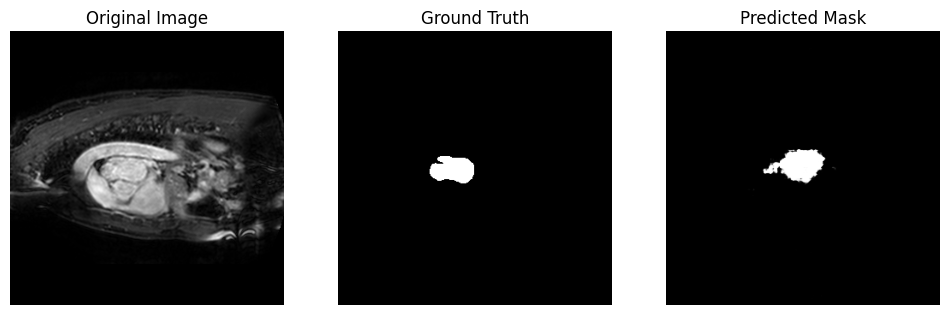

343


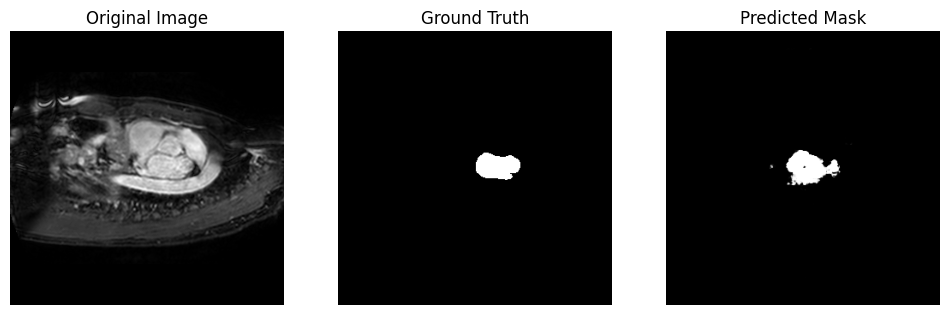

344


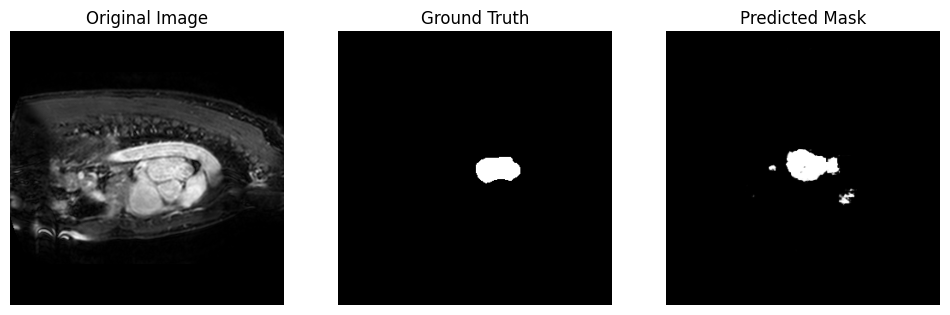

345


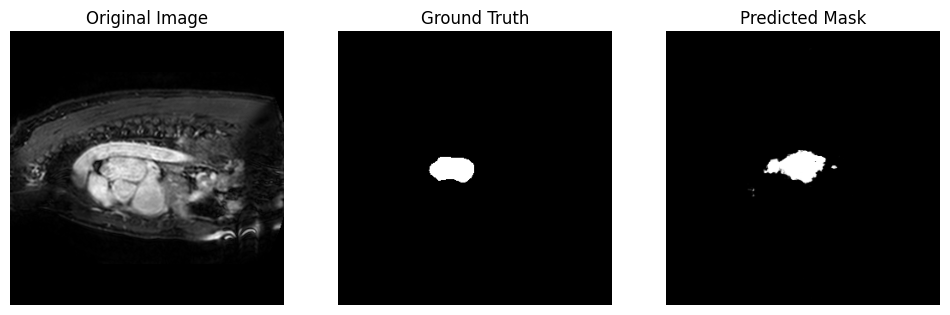

346


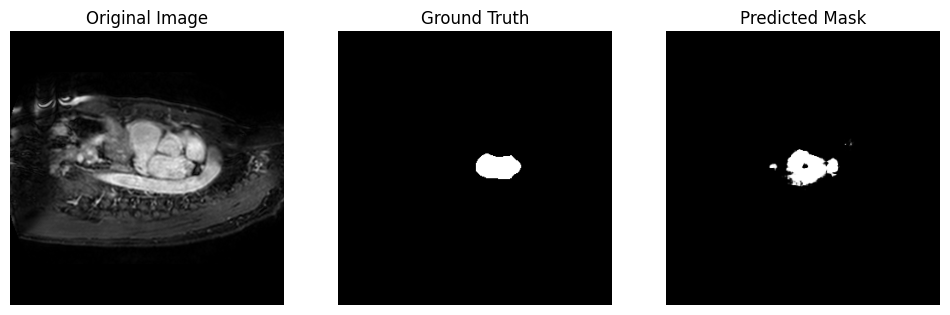

347


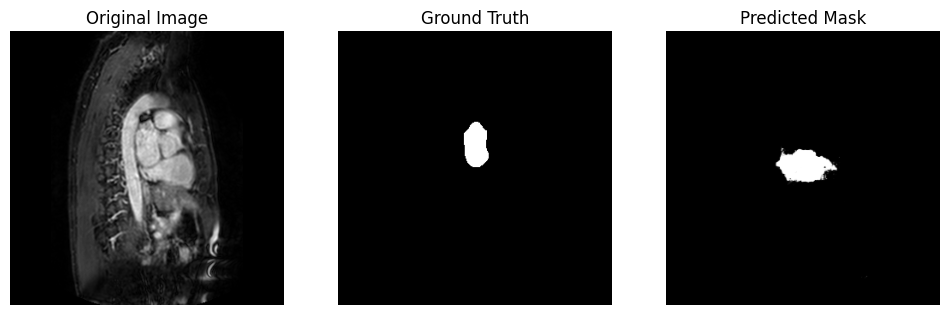

348


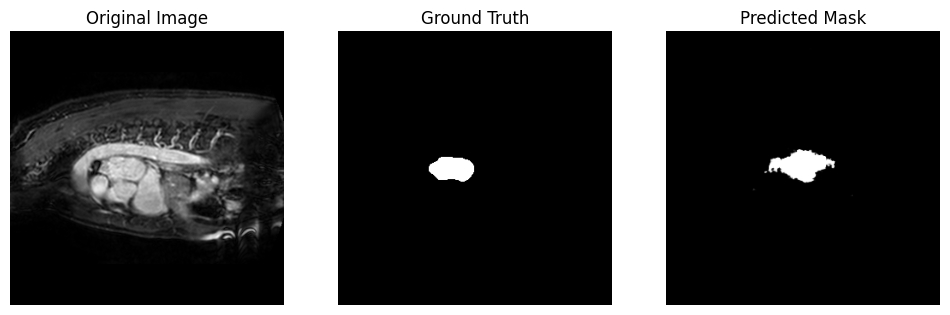

349


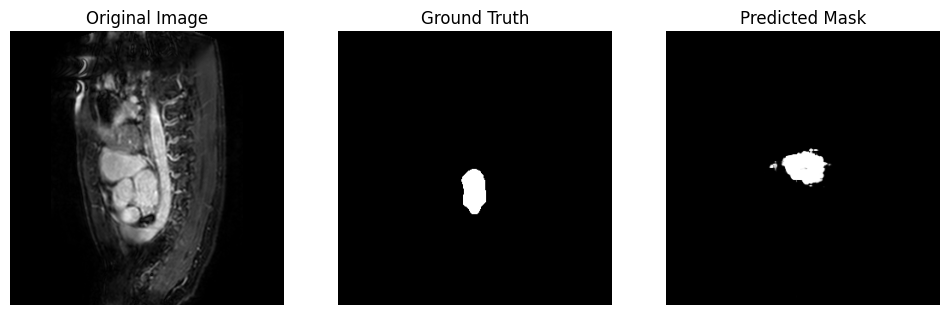

350


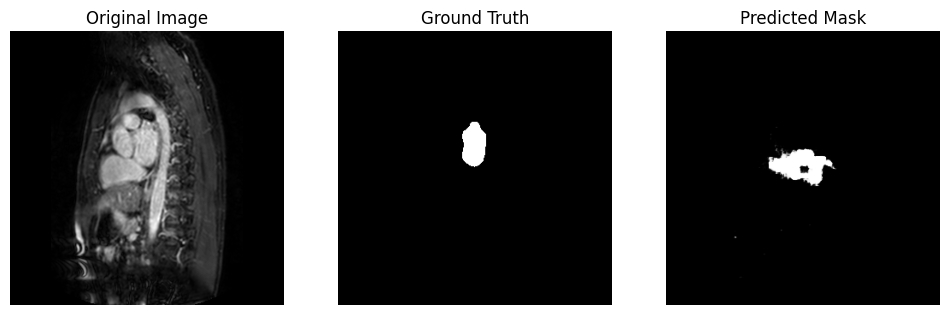

351


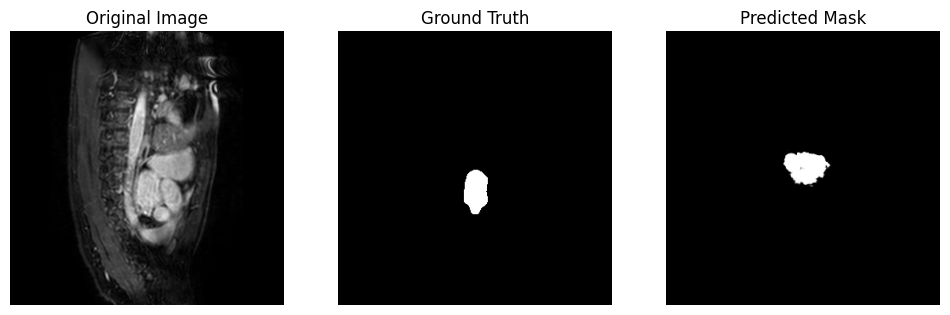

352


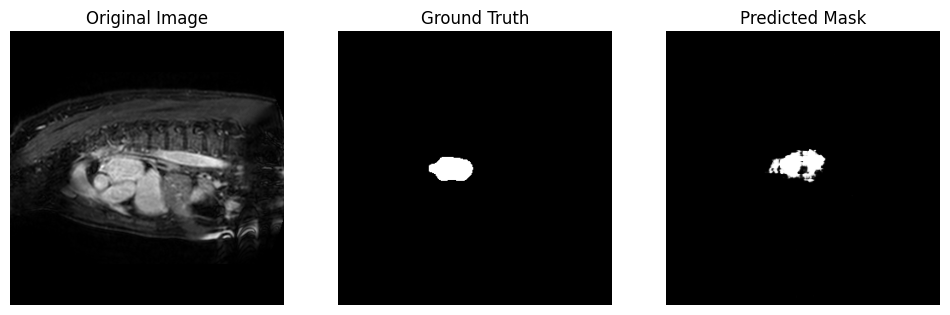

353


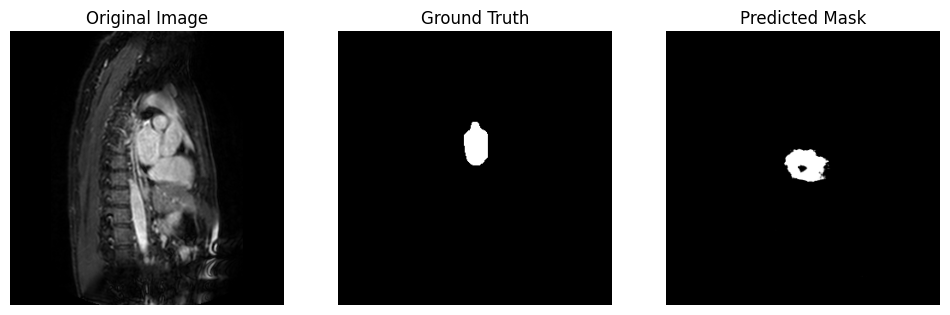

354


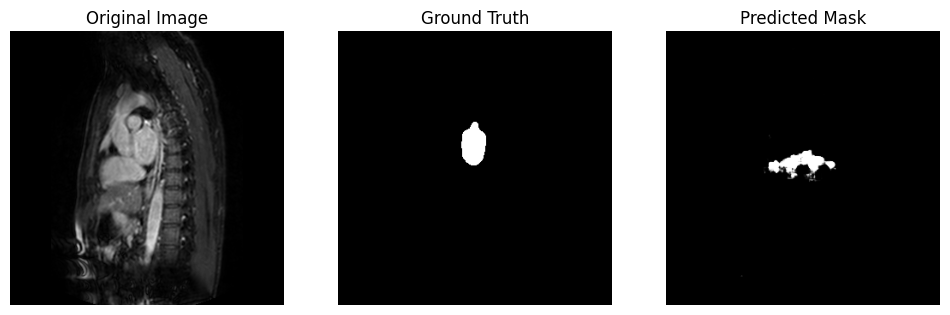

355


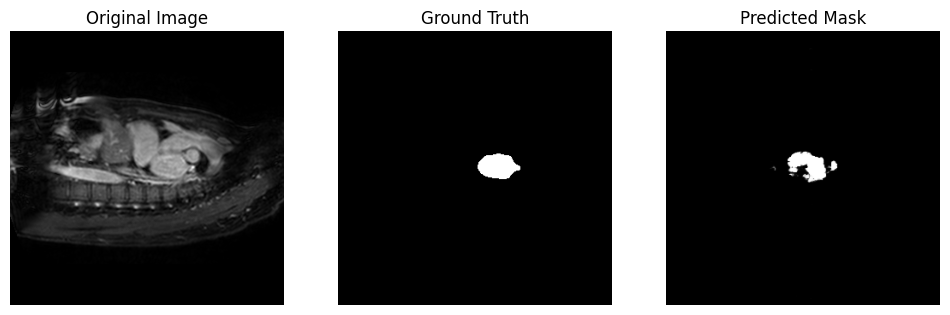

356


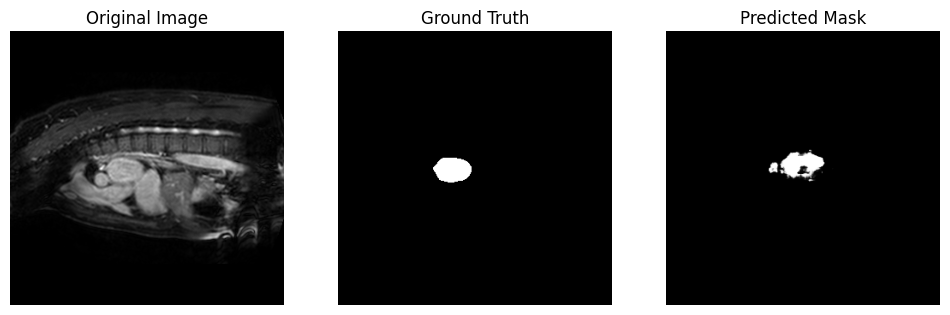

357


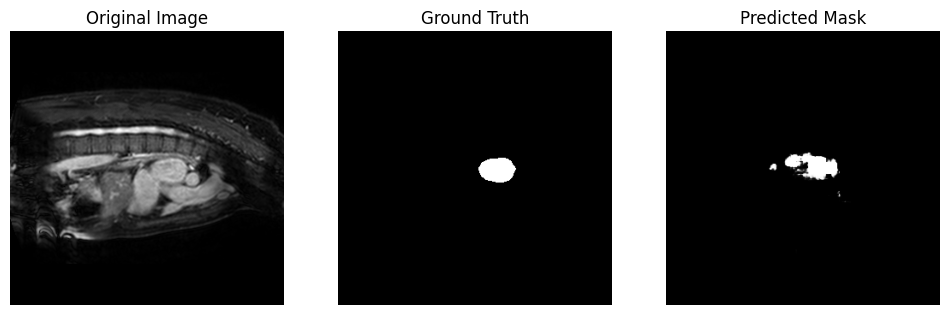

358


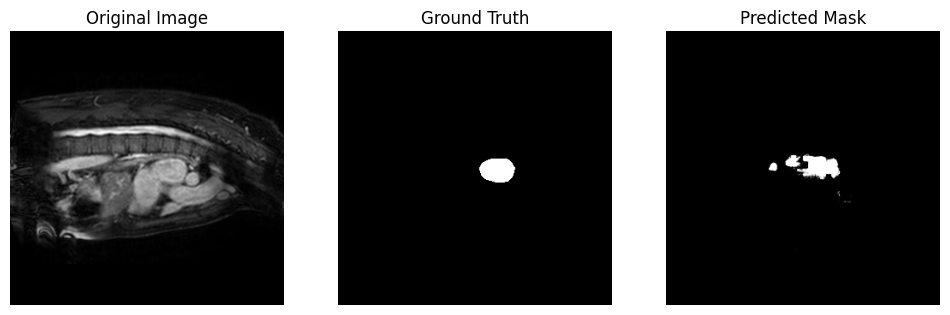

359


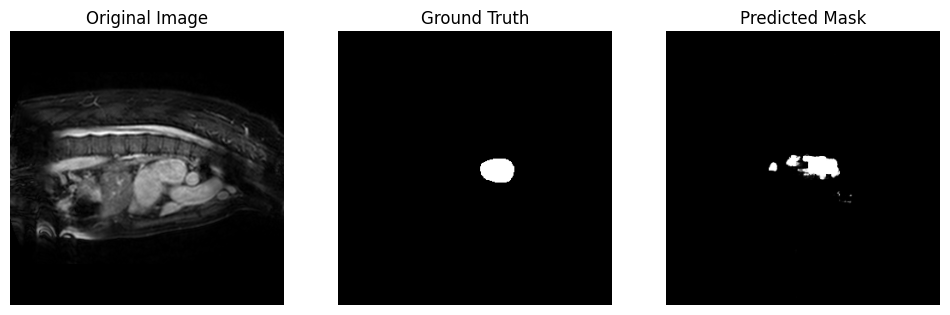

360


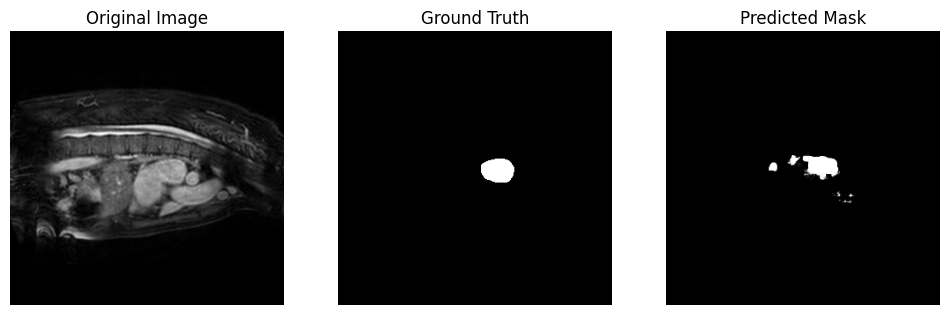

361


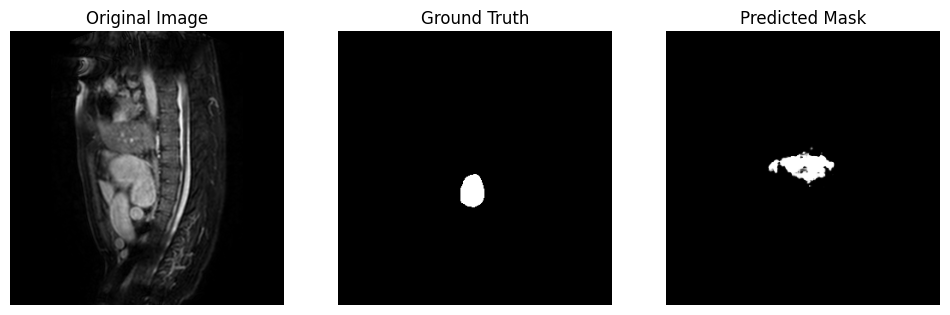

362


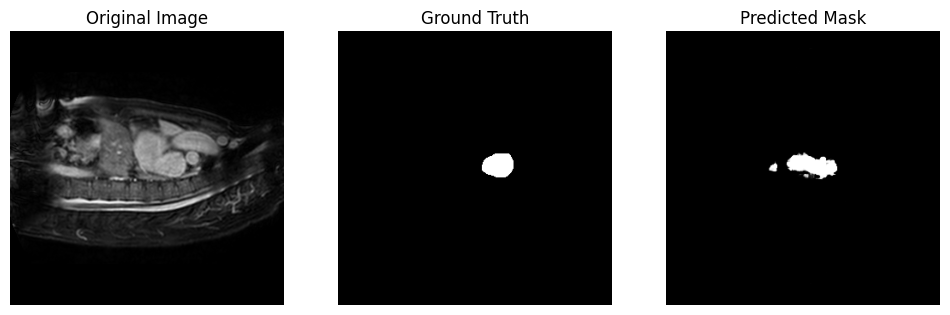

363


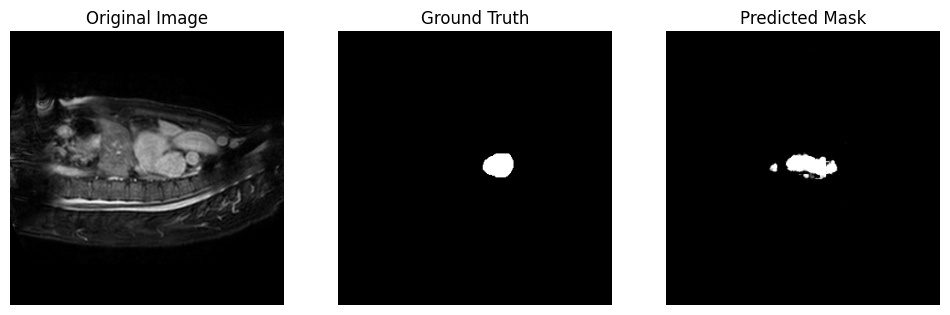

364


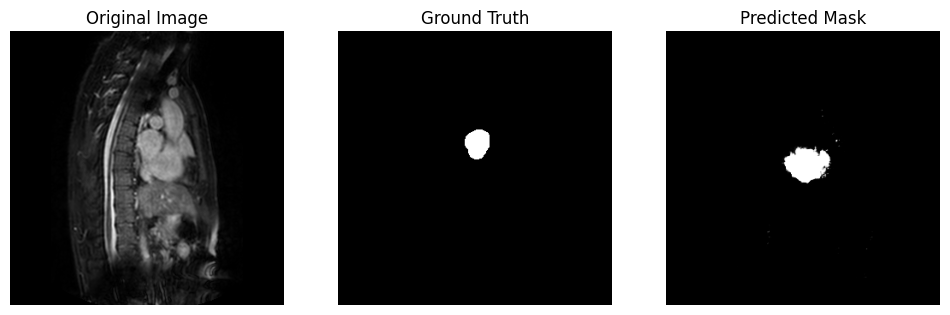

365


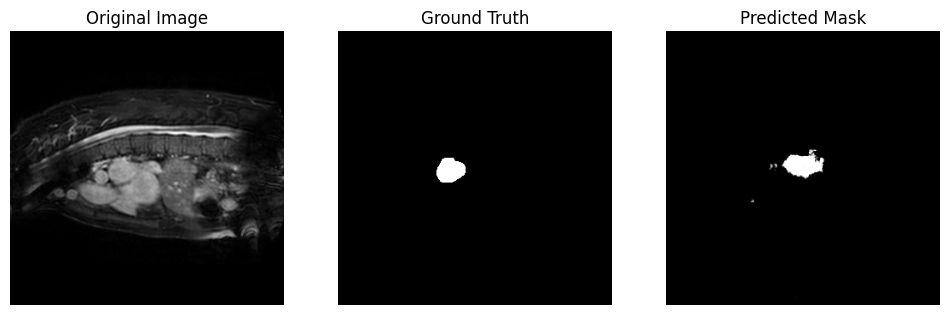

366


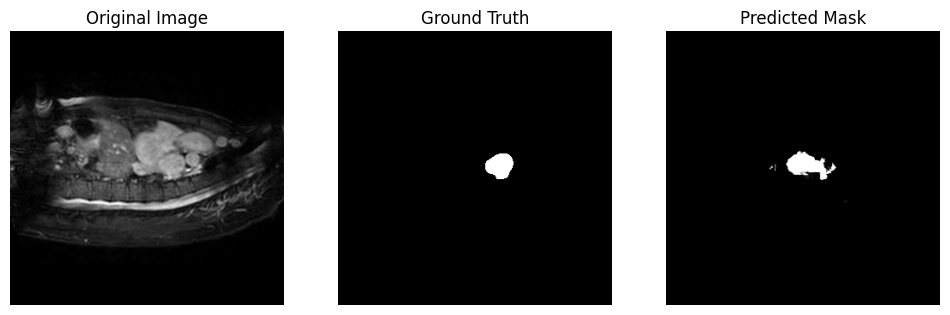

367


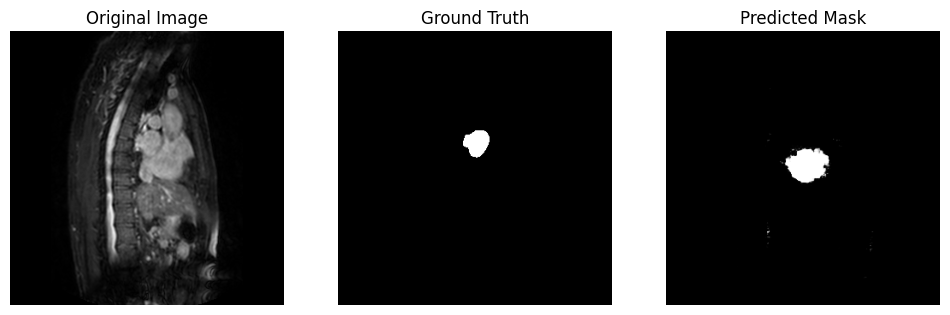

368


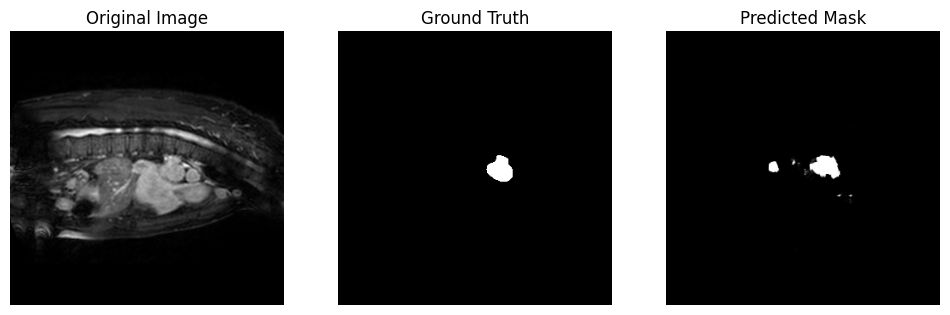

369


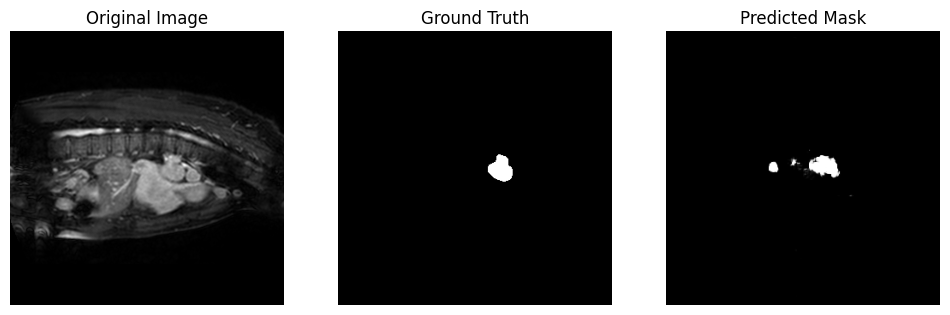

370


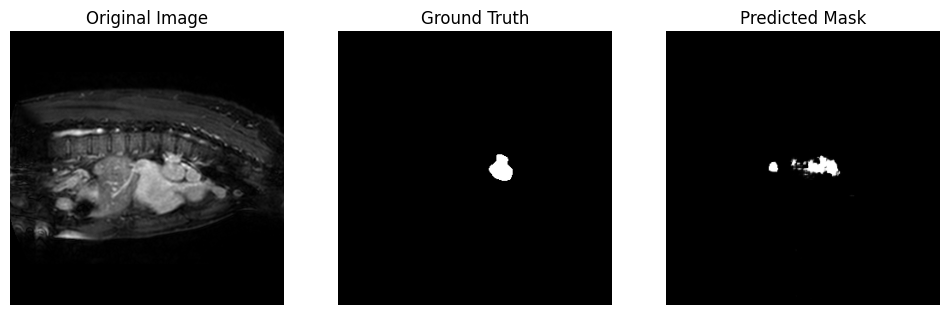

371


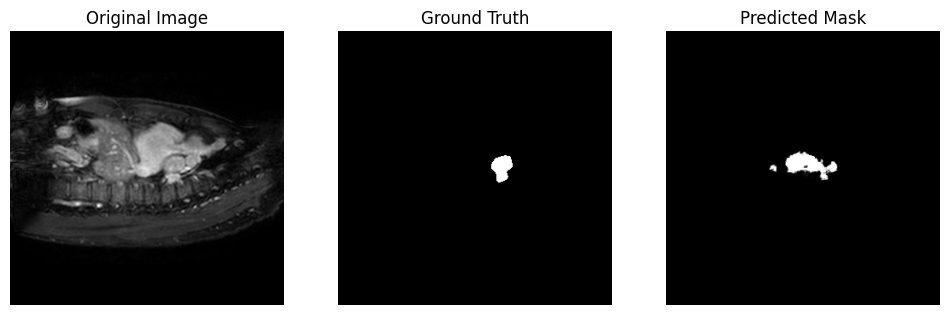

372


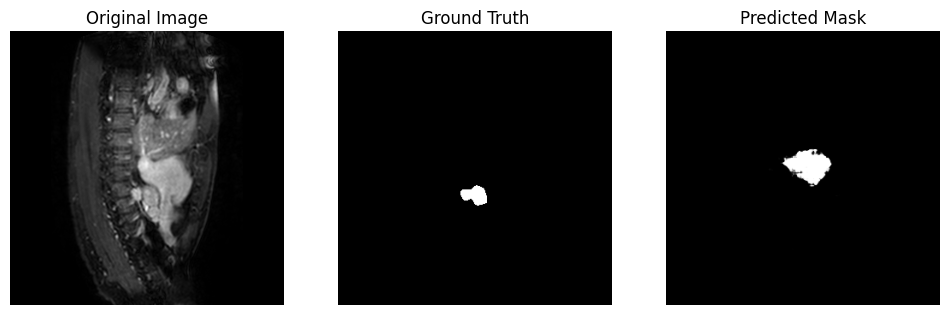

373


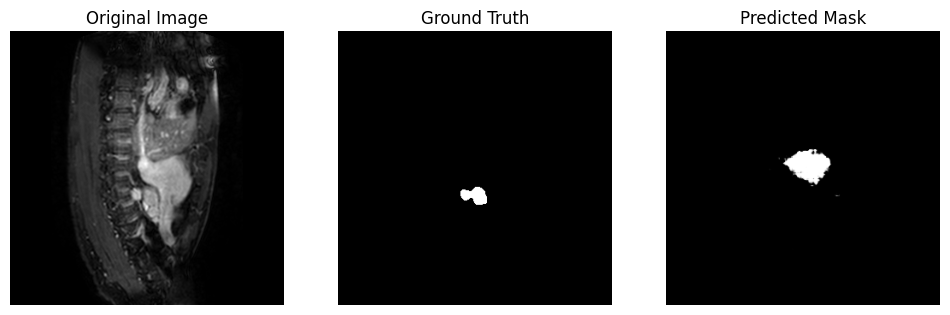

374


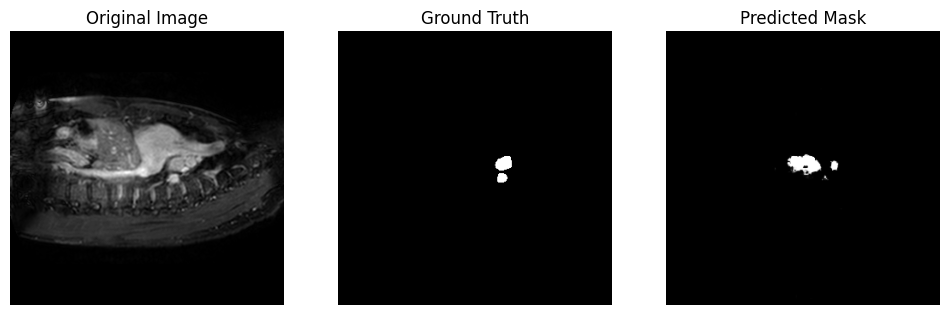

375


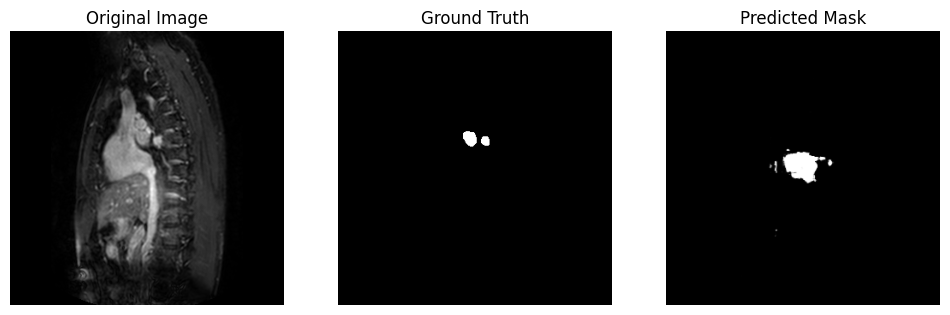

376


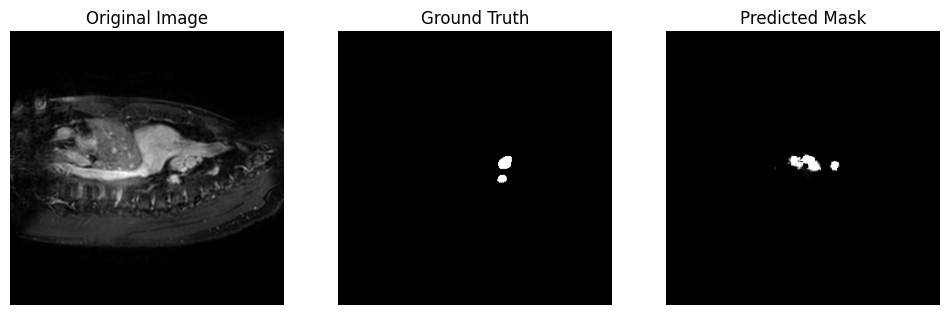

377


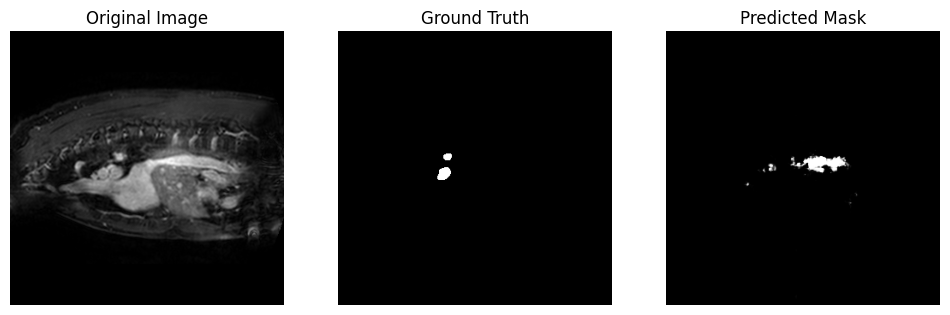

378


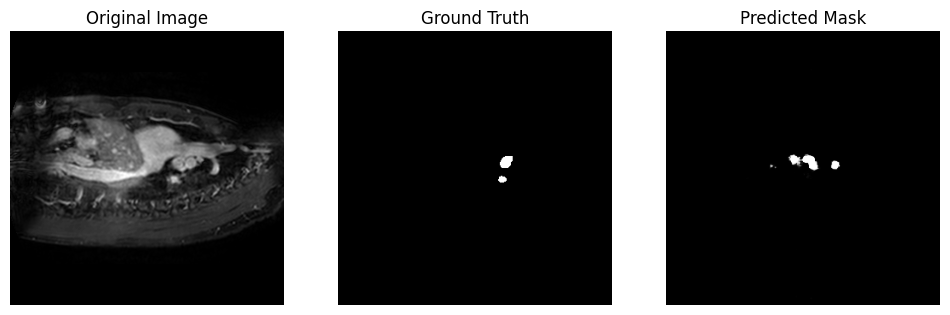

379


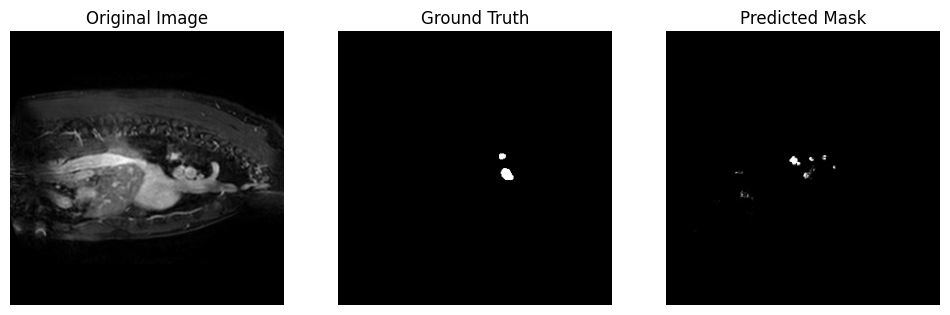

380


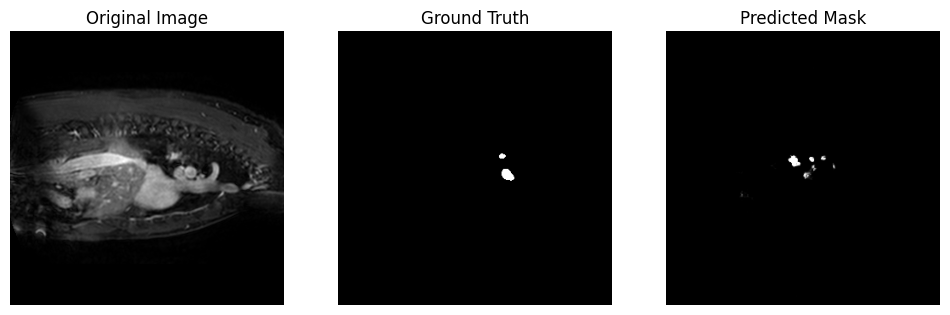

381


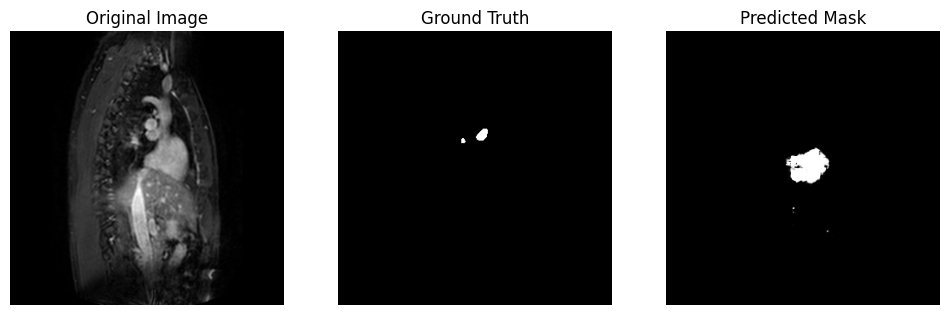

382


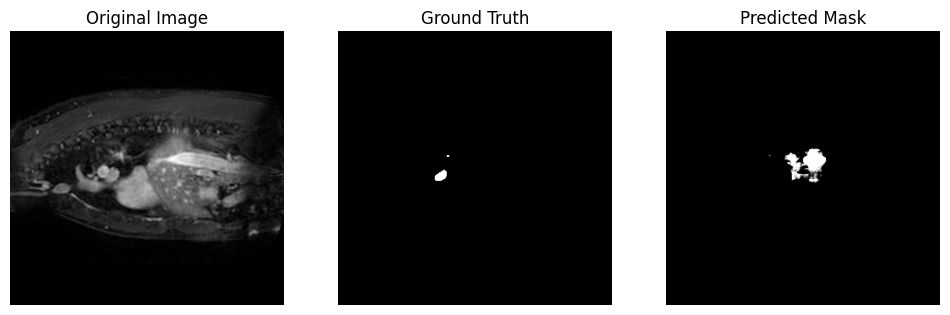

383


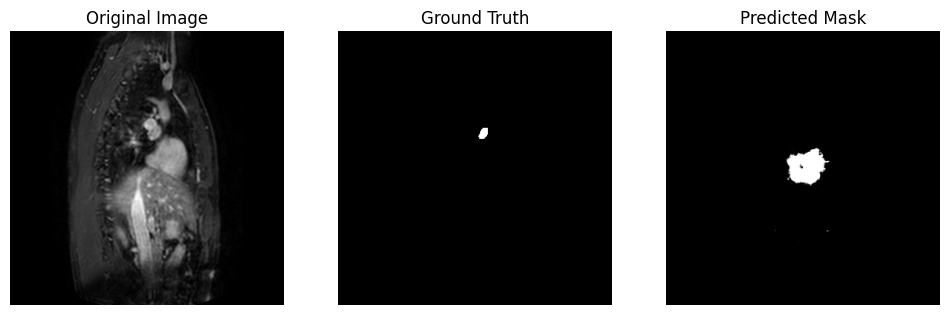

384


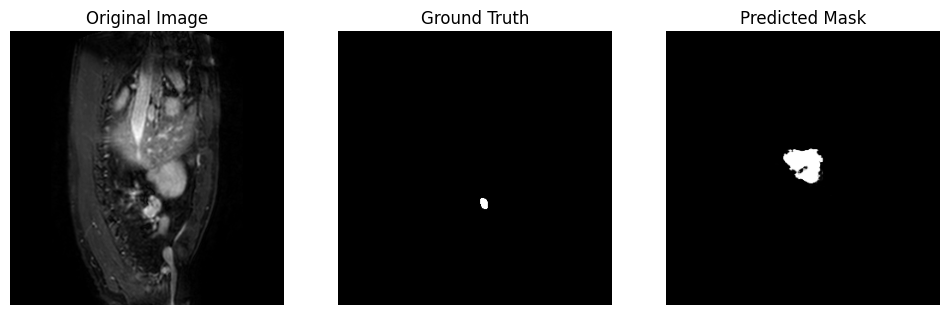

385


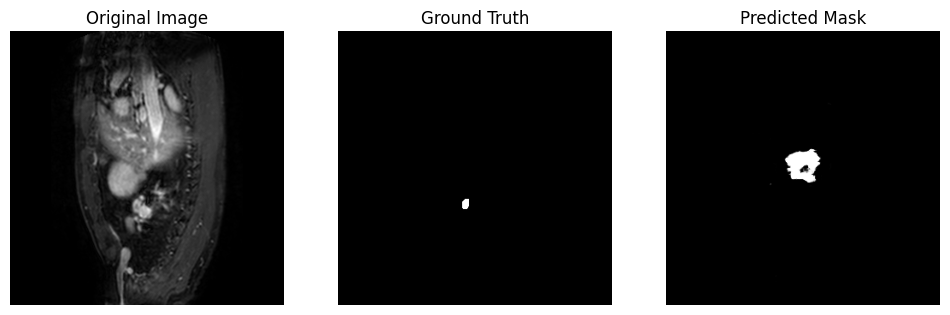

386


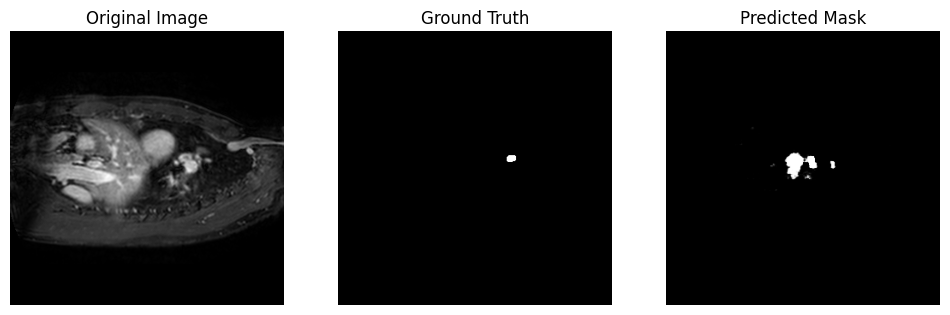

387


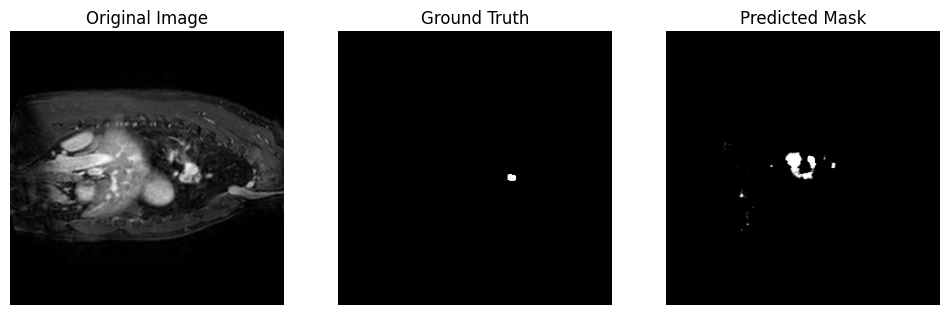

388


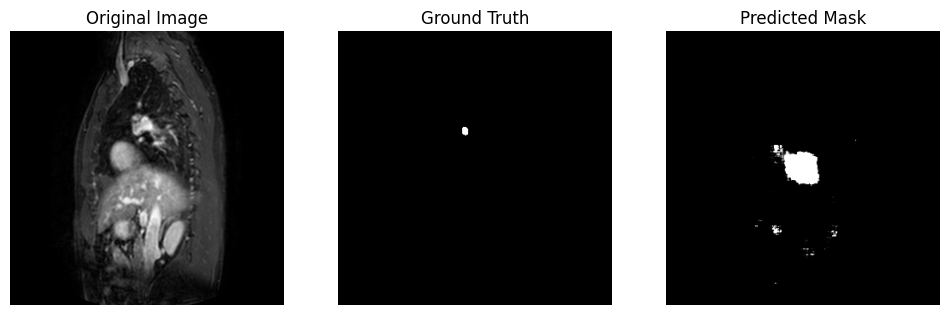

389


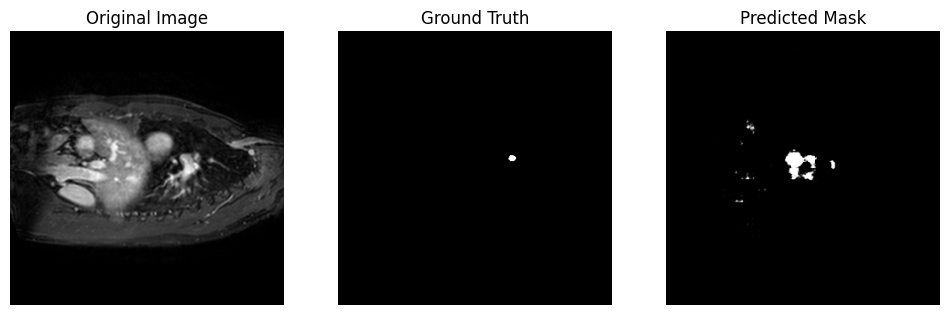

390


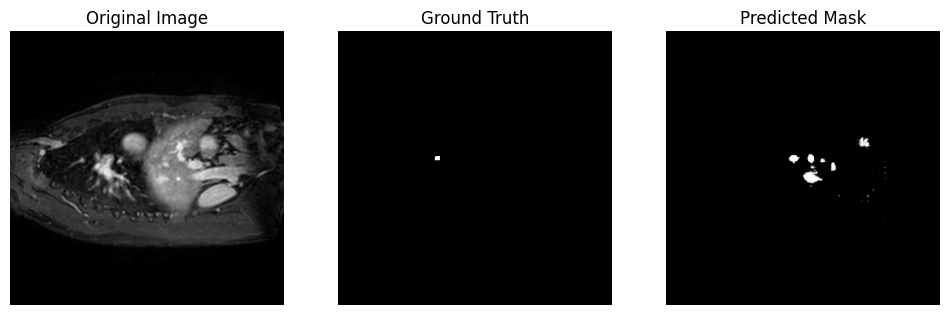

391


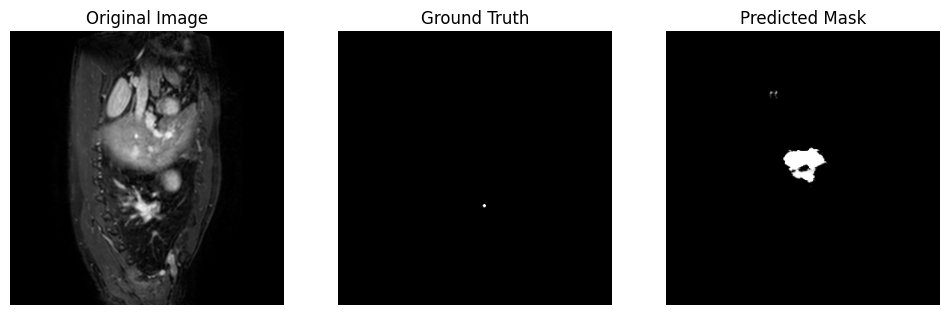

392


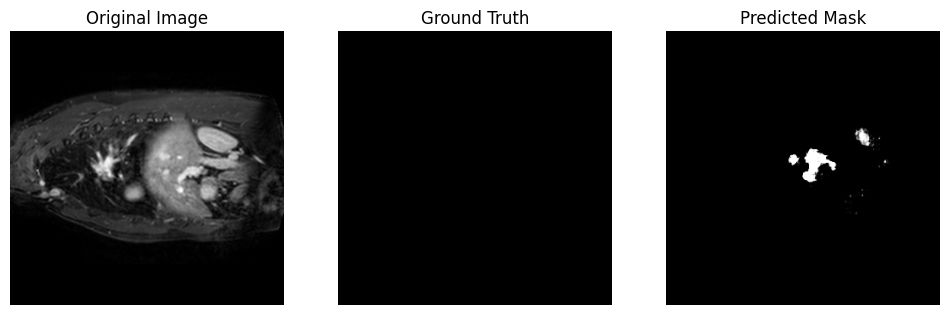

393


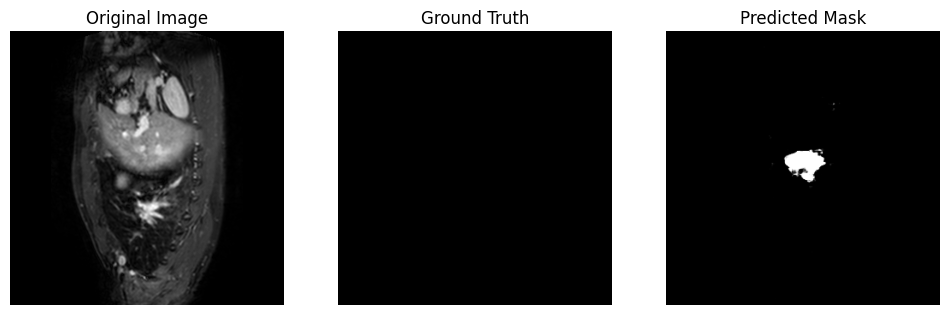

394


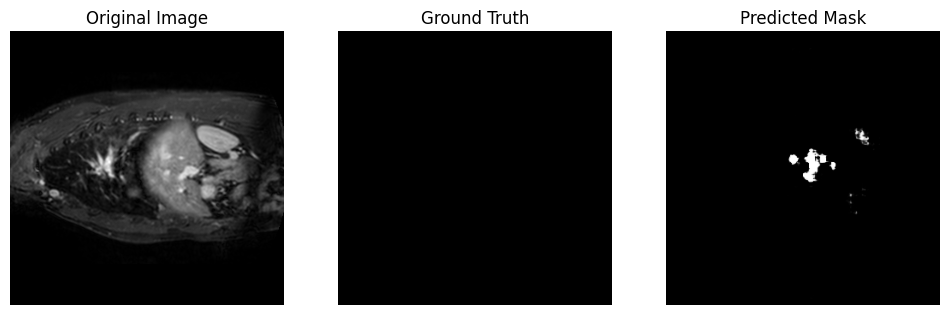

395


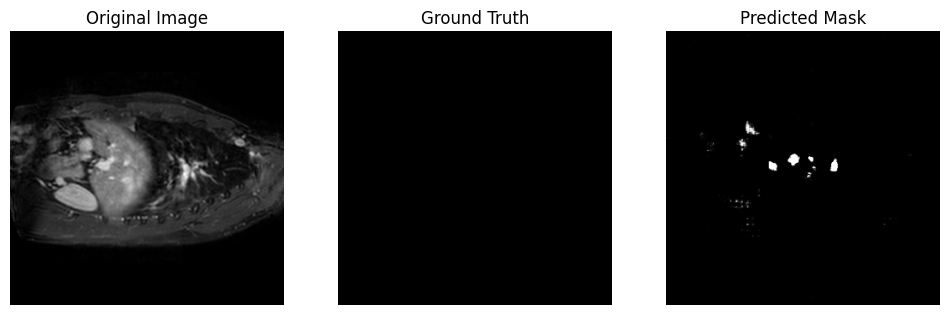

396


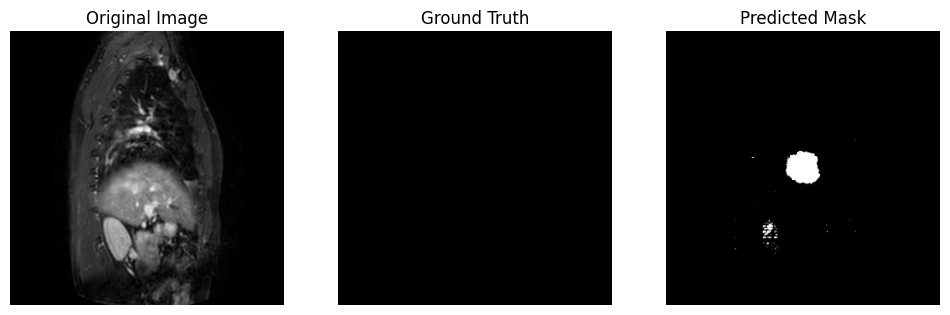

397


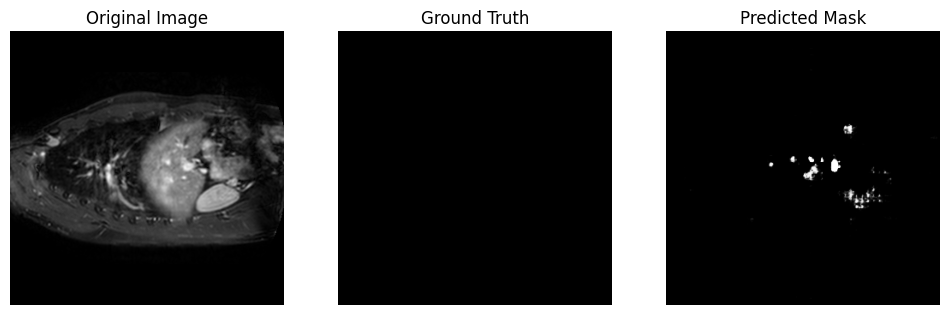

398


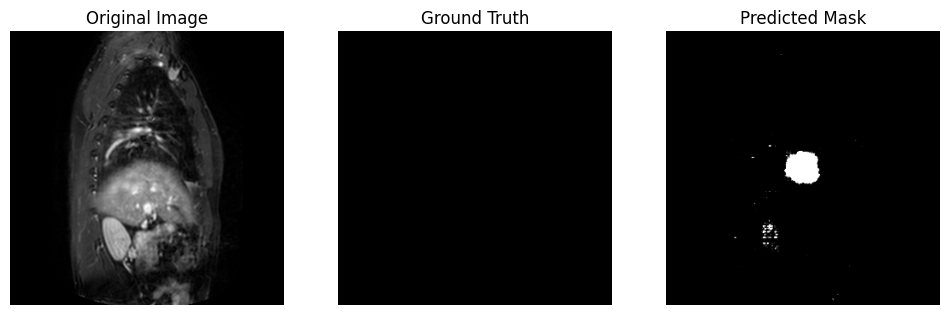

399


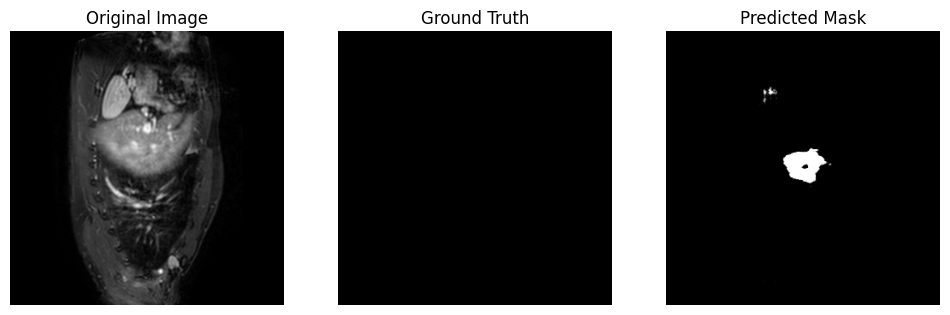

400


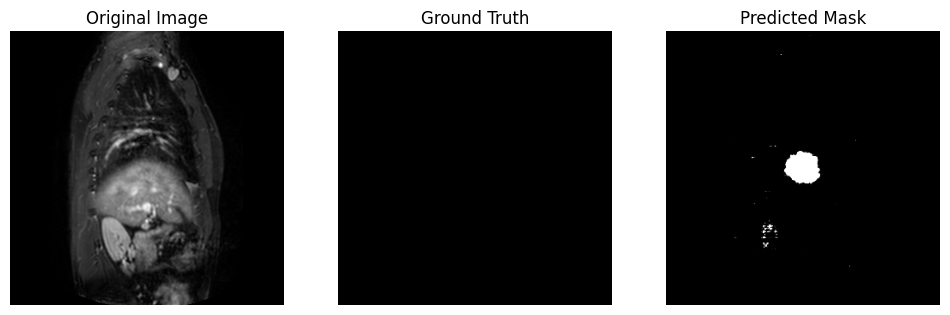

401


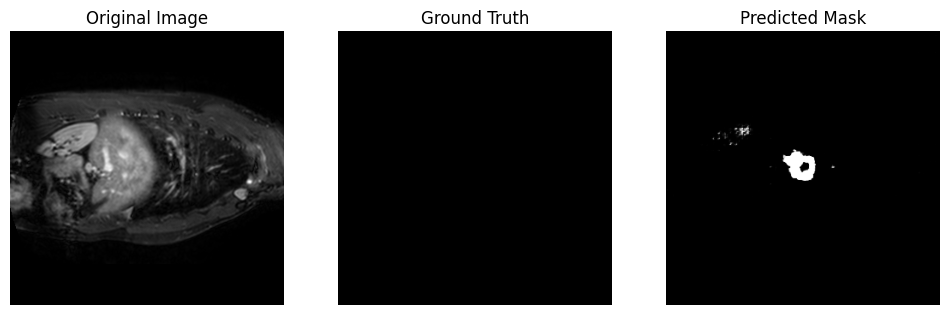

402


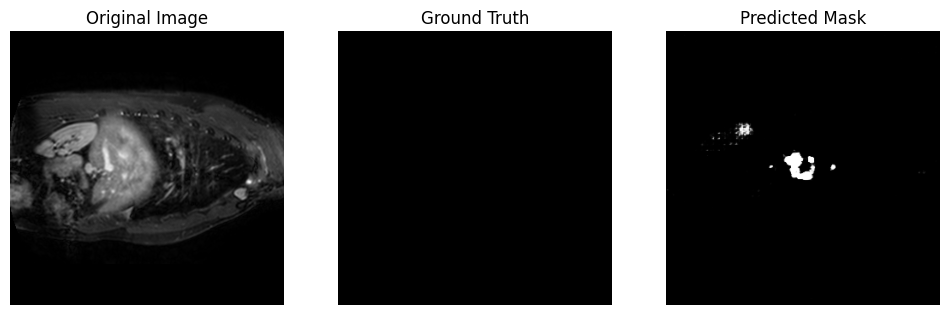

403


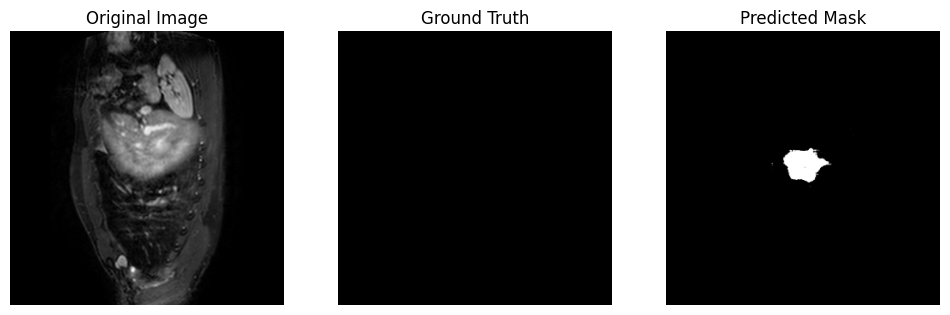

404


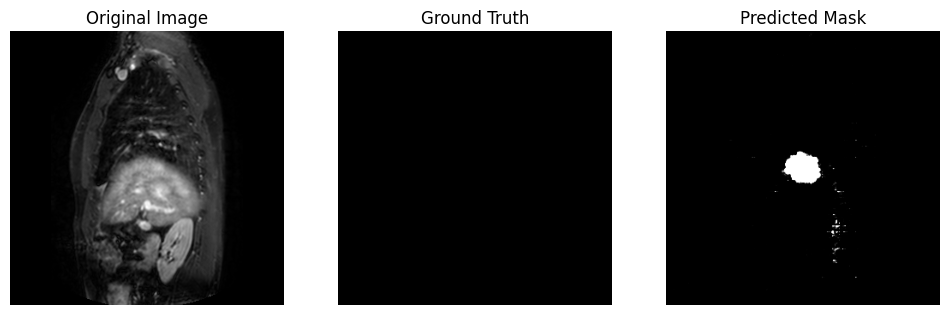

405


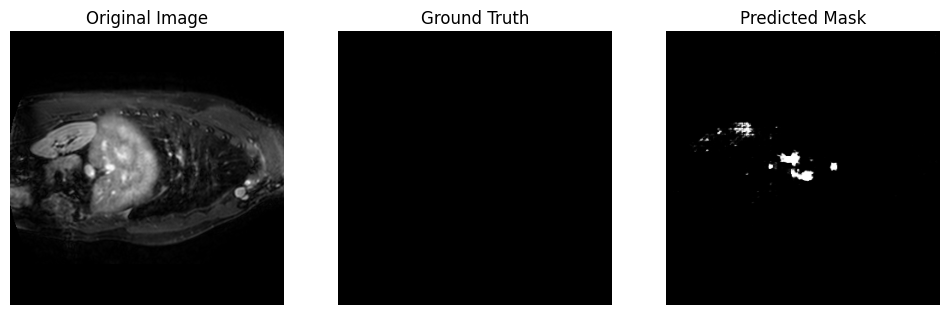

406


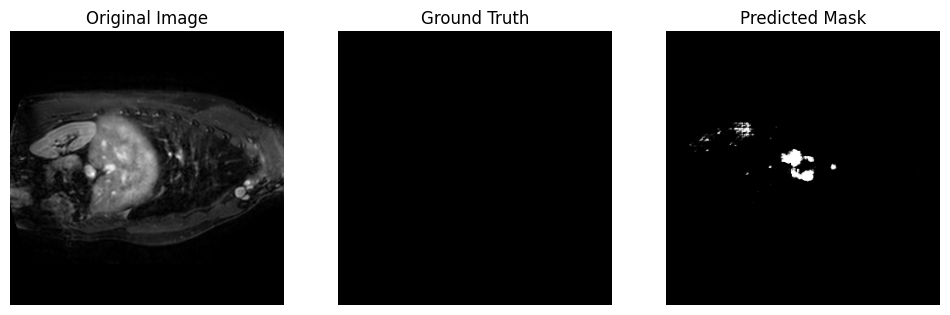

407


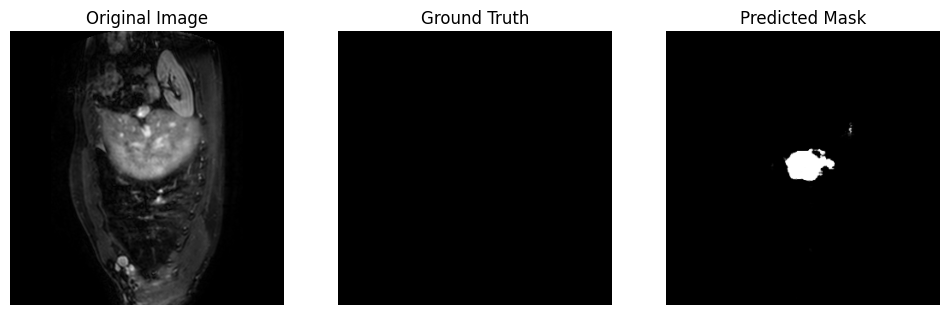

408


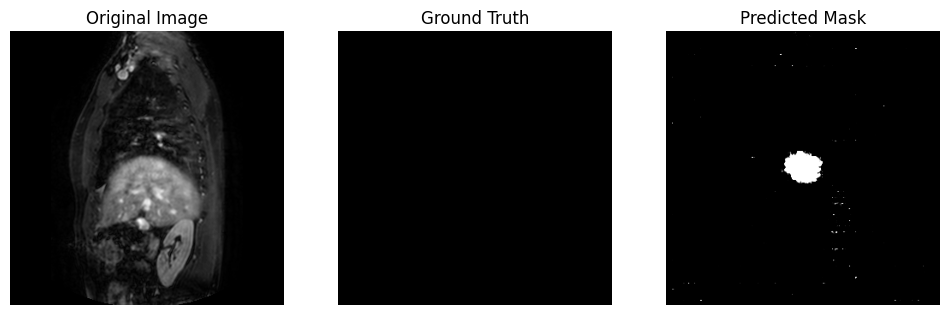

409


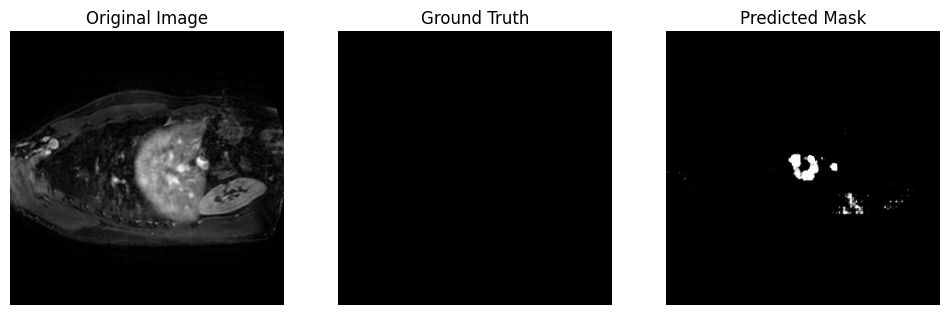

In [31]:
net.eval()  # Set the model to evaluation mode

inferences = 0
dice_threshold = 0.0

i = 0
for img, lb in test_dataset:
    lb = lb.to(device)
    img_single = img
    lb_single = lb

    img_single_rgb = make_3_channel(img_single)
    x0, x1, x2, x3, x4 = preprocess(img_single_rgb, device)
    with torch.no_grad():
        pred = torch.sigmoid(net(x0, x1, x2, x3, x4))
    print(i)
    # Visualize the results
    plt.figure(figsize=(12, 6))

    # Display original image
    plt.subplot(1, 3, 1)
    plt.imshow(img_single.squeeze().cpu().numpy(), cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    # Display ground truth
    plt.subplot(1, 3, 2)
    plt.imshow(lb_single.squeeze().cpu().numpy(), cmap='gray')
    plt.title('Ground Truth')
    plt.axis('off')

    # Display predicted mask
    plt.subplot(1, 3, 3)
    plt.imshow(pred.squeeze().cpu().numpy(), cmap='gray')
    plt.title('Predicted Mask')
    plt.axis('off')

    plt.show()
    i += 1


In [32]:
with torch.no_grad():
  print(get_dice_score(net, train_dataset, device))
  print(get_dice_score(net, val_dataset, device))
  print(get_dice_score(net, test_dataset, device))

tensor(0.2241, device='cuda:0')
tensor(0.1241, device='cuda:0')
tensor(0.1997, device='cuda:0')
